In [1]:
import warnings
warnings.filterwarnings('ignore')
import json, os
import numpy as np
from monty.json import MontyDecoder, MontyEncoder
from copy import deepcopy
from scipy.spatial import distance_matrix
import sys
sys.path.append('..')

from phasemapy.dataio import InstanceData
from phasemapy.parser import ICDDEntry
from phasemapy.solver import Phase, Sample

chemsys = ['Li', 'Sr', 'Al']
oxide_system = True
photon_e = 13e3
max_q_shift = 0.01
resample_density = 1000
initial_alphagamma = 0.1
SUM_NORM = 6000
loss_weight = {'xrd_loss': 6.0, 'comp_loss': 2.0, 'entropy_loss': 0.01}


Bad key text.latex.preview in file C:\Users\dell\anaconda3\envs\myPymatgen\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle, line 123 ('text.latex.preview : False')
You probably need to get an updated matplotlibrc file from
https://github.com/matplotlib/matplotlib/blob/v3.5.2/matplotlibrc.template
or from the matplotlib source distribution

Bad key mathtext.fallback_to_cm in file C:\Users\dell\anaconda3\envs\myPymatgen\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle, line 155 ('mathtext.fallback_to_cm : True  # When True, use symbols from the Computer Modern')
You probably need to get an updated matplotlibrc file from
https://github.com/matplotlib/matplotlib/blob/v3.5.2/matplotlibrc.template
or from the matplotlib source distribution

Bad key savefig.jpeg_quality in file C:\Users\dell\anaconda3\envs\myPymatgen\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle, line 418 ('savefig.jpeg_quality: 95       # when a jpeg is save

In [2]:
#load instance data:50 instances
instance_data = InstanceData.from_json('./data/Instance_data', chemsys, photon_e)
instance_data = instance_data.resample_xrd(resample_density)
instance_data.renormalize(norm=SUM_NORM)
instance_data.normalize()
#load entry pool: 20 ICDD entries
with open('./data/entries_dft.json') as f:
    entries = json.load(f, cls=MontyDecoder)
Phase.theta_to_q(entries)


x tensor([[0.3487, 0.3000, 0.3513]], grad_fn=<SumBackward1>)
entropy tensor([1.0961], grad_fn=<NegBackward0>) tensor(1.0961, grad_fn=<MeanBackward0>)
loss tensor(230.4372, grad_fn=<DivBackward0>) tensor(1.0961, grad_fn=<MeanBackward0>) tensor(0.2038, grad_fn=<MseLossBackward0>)
0 1383.0417 tensor(230.4372) tensor(0.2038) tensor(1.0961)
x tensor([[0.3691, 0.2827, 0.3482]], grad_fn=<SumBackward1>)
entropy tensor([1.0924], grad_fn=<NegBackward0>) tensor(1.0924, grad_fn=<MeanBackward0>)
loss tensor(193.2993, grad_fn=<DivBackward0>) tensor(1.0924, grad_fn=<MeanBackward0>) tensor(0.2135, grad_fn=<MseLossBackward0>)
x tensor([[0.3929, 0.2631, 0.3440]], grad_fn=<SumBackward1>)
entropy tensor([1.0854], grad_fn=<NegBackward0>) tensor(1.0854, grad_fn=<MeanBackward0>)
loss tensor(181.8084, grad_fn=<DivBackward0>) tensor(1.0854, grad_fn=<MeanBackward0>) tensor(0.2255, grad_fn=<MseLossBackward0>)
x tensor([[0.3872, 0.2505, 0.3624]], grad_fn=<SumBackward1>)
entropy tensor([1.0820], grad_fn=<NegBackwa

x tensor([[0.1148, 0.1657, 0.7195]], grad_fn=<SumBackward1>)
entropy tensor([0.7832], grad_fn=<NegBackward0>) tensor(0.7832, grad_fn=<MeanBackward0>)
loss tensor(71.5305, grad_fn=<DivBackward0>) tensor(0.7832, grad_fn=<MeanBackward0>) tensor(0.6346, grad_fn=<MseLossBackward0>)
x tensor([[0.1142, 0.1663, 0.7196]], grad_fn=<SumBackward1>)
entropy tensor([0.7829], grad_fn=<NegBackward0>) tensor(0.7829, grad_fn=<MeanBackward0>)
loss tensor(71.5312, grad_fn=<DivBackward0>) tensor(0.7829, grad_fn=<MeanBackward0>) tensor(0.6354, grad_fn=<MseLossBackward0>)
x tensor([[0.1138, 0.1666, 0.7197]], grad_fn=<SumBackward1>)
entropy tensor([0.7825], grad_fn=<NegBackward0>) tensor(0.7825, grad_fn=<MeanBackward0>)
loss tensor(71.5317, grad_fn=<DivBackward0>) tensor(0.7825, grad_fn=<MeanBackward0>) tensor(0.6362, grad_fn=<MseLossBackward0>)
x tensor([[0.1135, 0.1666, 0.7199]], grad_fn=<SumBackward1>)
entropy tensor([0.7822], grad_fn=<NegBackward0>) tensor(0.7822, grad_fn=<MeanBackward0>)
loss tensor(71.5

x tensor([[0.1173, 0.1628, 0.7199]], grad_fn=<SumBackward1>)
entropy tensor([0.7834], grad_fn=<NegBackward0>) tensor(0.7834, grad_fn=<MeanBackward0>)
loss tensor(71.5245, grad_fn=<DivBackward0>) tensor(0.7834, grad_fn=<MeanBackward0>) tensor(0.6320, grad_fn=<MseLossBackward0>)
x tensor([[0.1173, 0.1626, 0.7201]], grad_fn=<SumBackward1>)
entropy tensor([0.7832], grad_fn=<NegBackward0>) tensor(0.7832, grad_fn=<MeanBackward0>)
loss tensor(71.5244, grad_fn=<DivBackward0>) tensor(0.7832, grad_fn=<MeanBackward0>) tensor(0.6321, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1624, 0.7202]], grad_fn=<SumBackward1>)
entropy tensor([0.7830], grad_fn=<NegBackward0>) tensor(0.7830, grad_fn=<MeanBackward0>)
loss tensor(71.5243, grad_fn=<DivBackward0>) tensor(0.7830, grad_fn=<MeanBackward0>) tensor(0.6322, grad_fn=<MseLossBackward0>)
x tensor([[0.1175, 0.1622, 0.7204]], grad_fn=<SumBackward1>)
entropy tensor([0.7829], grad_fn=<NegBackward0>) tensor(0.7829, grad_fn=<MeanBackward0>)
loss tensor(71.5

entropy tensor([0.7828], grad_fn=<NegBackward0>) tensor(0.7828, grad_fn=<MeanBackward0>)
loss tensor(71.5242, grad_fn=<DivBackward0>) tensor(0.7828, grad_fn=<MeanBackward0>) tensor(0.6324, grad_fn=<MseLossBackward0>)
x tensor([[0.1175, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7827], grad_fn=<NegBackward0>) tensor(0.7827, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7827, grad_fn=<MeanBackward0>) tensor(0.6325, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7827], grad_fn=<NegBackward0>) tensor(0.7827, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7827, grad_fn=<MeanBackward0>) tensor(0.6326, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBack

x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6326, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6326, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5

x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5

entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBack

x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5

entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBack

x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5

x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5

x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5

x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5241, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.6327, grad_fn=<MseLossBackward0>)
x tensor([[0.1174, 0.1621, 0.7205]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(71.5

x tensor([[0.3116, 0.1811, 0.2491, 0.2582]], grad_fn=<SumBackward1>)
entropy tensor([1.3686], grad_fn=<NegBackward0>) tensor(1.3686, grad_fn=<MeanBackward0>)
loss tensor(176.6142, grad_fn=<DivBackward0>) tensor(1.3686, grad_fn=<MeanBackward0>) tensor(0.0406, grad_fn=<MseLossBackward0>)
0 1059.7803 tensor(176.6142) tensor(0.0406) tensor(1.3686)
x tensor([[0.2146, 0.2252, 0.2011, 0.3591]], grad_fn=<SumBackward1>)
entropy tensor([1.3563], grad_fn=<NegBackward0>) tensor(1.3563, grad_fn=<MeanBackward0>)
loss tensor(148.3750, grad_fn=<DivBackward0>) tensor(1.3563, grad_fn=<MeanBackward0>) tensor(0.0795, grad_fn=<MseLossBackward0>)
x tensor([[0.1829, 0.2330, 0.2032, 0.3809]], grad_fn=<SumBackward1>)
entropy tensor([1.3416], grad_fn=<NegBackward0>) tensor(1.3416, grad_fn=<MeanBackward0>)
loss tensor(134.9497, grad_fn=<DivBackward0>) tensor(1.3416, grad_fn=<MeanBackward0>) tensor(0.0903, grad_fn=<MseLossBackward0>)
x tensor([[0.1990, 0.2504, 0.1986, 0.3519]], grad_fn=<SumBackward1>)
entropy ten

x tensor([[0.0000, 0.3692, 0.1105, 0.5203]], grad_fn=<SumBackward1>)
entropy tensor([0.9512], grad_fn=<NegBackward0>) tensor(0.9512, grad_fn=<MeanBackward0>)
loss tensor(56.2923, grad_fn=<DivBackward0>) tensor(0.9512, grad_fn=<MeanBackward0>) tensor(0.1616, grad_fn=<MseLossBackward0>)
x tensor([[1.5935e-04, 3.6874e-01, 1.1082e-01, 5.2028e-01]],
       grad_fn=<SumBackward1>)
entropy tensor([0.9530], grad_fn=<NegBackward0>) tensor(0.9530, grad_fn=<MeanBackward0>)
loss tensor(56.1009, grad_fn=<DivBackward0>) tensor(0.9530, grad_fn=<MeanBackward0>) tensor(0.1617, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3681, 0.1114, 0.5204]], grad_fn=<SumBackward1>)
entropy tensor([0.9523], grad_fn=<NegBackward0>) tensor(0.9523, grad_fn=<MeanBackward0>)
loss tensor(55.9169, grad_fn=<DivBackward0>) tensor(0.9523, grad_fn=<MeanBackward0>) tensor(0.1619, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3672, 0.1122, 0.5206]], grad_fn=<SumBackward1>)
entropy tensor([0.9531], grad_fn=<NegBackward0>) t

x tensor([[0.0000, 0.3543, 0.1250, 0.5208]], grad_fn=<SumBackward1>)
entropy tensor([0.9673], grad_fn=<NegBackward0>) tensor(0.9673, grad_fn=<MeanBackward0>)
loss tensor(54.4295, grad_fn=<DivBackward0>) tensor(0.9673, grad_fn=<MeanBackward0>) tensor(0.1657, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3543, 0.1248, 0.5209]], grad_fn=<SumBackward1>)
entropy tensor([0.9671], grad_fn=<NegBackward0>) tensor(0.9671, grad_fn=<MeanBackward0>)
loss tensor(54.4258, grad_fn=<DivBackward0>) tensor(0.9671, grad_fn=<MeanBackward0>) tensor(0.1658, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3542, 0.1247, 0.5211]], grad_fn=<SumBackward1>)
entropy tensor([0.9669], grad_fn=<NegBackward0>) tensor(0.9669, grad_fn=<MeanBackward0>)
loss tensor(54.4225, grad_fn=<DivBackward0>) tensor(0.9669, grad_fn=<MeanBackward0>) tensor(0.1659, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3540, 0.1246, 0.5214]], grad_fn=<SumBackward1>)
entropy tensor([0.9667], grad_fn=<NegBackward0>) tensor(0.9667, grad_fn=<

x tensor([[0.0000, 0.3550, 0.1239, 0.5212]], grad_fn=<SumBackward1>)
entropy tensor([0.9660], grad_fn=<NegBackward0>) tensor(0.9660, grad_fn=<MeanBackward0>)
loss tensor(54.4146, grad_fn=<DivBackward0>) tensor(0.9660, grad_fn=<MeanBackward0>) tensor(0.1657, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3550, 0.1239, 0.5211]], grad_fn=<SumBackward1>)
entropy tensor([0.9661], grad_fn=<NegBackward0>) tensor(0.9661, grad_fn=<MeanBackward0>)
loss tensor(54.4144, grad_fn=<DivBackward0>) tensor(0.9661, grad_fn=<MeanBackward0>) tensor(0.1657, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3551, 0.1239, 0.5210]], grad_fn=<SumBackward1>)
entropy tensor([0.9661], grad_fn=<NegBackward0>) tensor(0.9661, grad_fn=<MeanBackward0>)
loss tensor(54.4142, grad_fn=<DivBackward0>) tensor(0.9661, grad_fn=<MeanBackward0>) tensor(0.1656, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3551, 0.1240, 0.5209]], grad_fn=<SumBackward1>)
entropy tensor([0.9662], grad_fn=<NegBackward0>) tensor(0.9662, grad_fn=<

loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9657, grad_fn=<MeanBackward0>) tensor(0.1666, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3540, 0.1240, 0.5220]], grad_fn=<SumBackward1>)
entropy tensor([0.9658], grad_fn=<NegBackward0>) tensor(0.9658, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9658, grad_fn=<MeanBackward0>) tensor(0.1666, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3539, 0.1240, 0.5221]], grad_fn=<SumBackward1>)
entropy tensor([0.9658], grad_fn=<NegBackward0>) tensor(0.9658, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9658, grad_fn=<MeanBackward0>) tensor(0.1666, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3539, 0.1240, 0.5221]], grad_fn=<SumBackward1>)
entropy tensor([0.9658], grad_fn=<NegBackward0>) tensor(0.9658, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9658, grad_fn=<MeanBackward0>) tensor(0.1667, grad_fn=<MseLossBackward0>)
x tensor([[0.0

x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9658], grad_fn=<NegBackward0>) tensor(0.9658, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9658, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9658], grad_fn=<NegBackward0>) tensor(0.9658, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9658, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9658], grad_fn=<NegBackward0>) tensor(0.9658, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9658, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9658], grad_fn=<NegBackward0>) tensor(0.9658, grad_fn=<

x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<

loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0

x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<

loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0

x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<

x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<

x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<

x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>)
loss tensor(54.4132, grad_fn=<DivBackward0>) tensor(0.9659, grad_fn=<MeanBackward0>) tensor(0.1665, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.3541, 0.1240, 0.5219]], grad_fn=<SumBackward1>)
entropy tensor([0.9659], grad_fn=<NegBackward0>) tensor(0.9659, grad_fn=<

entropy tensor([0.7807], grad_fn=<NegBackward0>) tensor(0.7807, grad_fn=<MeanBackward0>)
loss tensor(95.9531, grad_fn=<DivBackward0>) tensor(0.7807, grad_fn=<MeanBackward0>) tensor(0.1790, grad_fn=<MseLossBackward0>)
x tensor([[0.3674, 0.0256, 0.6070]], grad_fn=<SumBackward1>)
entropy tensor([0.7648], grad_fn=<NegBackward0>) tensor(0.7648, grad_fn=<MeanBackward0>)
loss tensor(95.6727, grad_fn=<DivBackward0>) tensor(0.7648, grad_fn=<MeanBackward0>) tensor(0.1832, grad_fn=<MseLossBackward0>)
x tensor([[0.3653, 0.0214, 0.6133]], grad_fn=<SumBackward1>)
entropy tensor([0.7500], grad_fn=<NegBackward0>) tensor(0.7500, grad_fn=<MeanBackward0>)
loss tensor(95.5120, grad_fn=<DivBackward0>) tensor(0.7500, grad_fn=<MeanBackward0>) tensor(0.1873, grad_fn=<MseLossBackward0>)
x tensor([[0.3630, 0.0180, 0.6190]], grad_fn=<SumBackward1>)
entropy tensor([0.7371], grad_fn=<NegBackward0>) tensor(0.7371, grad_fn=<MeanBackward0>)
loss tensor(95.4229, grad_fn=<DivBackward0>) tensor(0.7371, grad_fn=<MeanBack

entropy tensor([0.7738], grad_fn=<NegBackward0>) tensor(0.7738, grad_fn=<MeanBackward0>)
loss tensor(95.1696, grad_fn=<DivBackward0>) tensor(0.7738, grad_fn=<MeanBackward0>) tensor(0.1912, grad_fn=<MseLossBackward0>)
x tensor([[0.3501, 0.0320, 0.6178]], grad_fn=<SumBackward1>)
entropy tensor([0.7752], grad_fn=<NegBackward0>) tensor(0.7752, grad_fn=<MeanBackward0>)
loss tensor(95.1709, grad_fn=<DivBackward0>) tensor(0.7752, grad_fn=<MeanBackward0>) tensor(0.1908, grad_fn=<MseLossBackward0>)
x tensor([[0.3505, 0.0322, 0.6173]], grad_fn=<SumBackward1>)
entropy tensor([0.7758], grad_fn=<NegBackward0>) tensor(0.7758, grad_fn=<MeanBackward0>)
loss tensor(95.1719, grad_fn=<DivBackward0>) tensor(0.7758, grad_fn=<MeanBackward0>) tensor(0.1904, grad_fn=<MseLossBackward0>)
x tensor([[0.3510, 0.0320, 0.6170]], grad_fn=<SumBackward1>)
entropy tensor([0.7757], grad_fn=<NegBackward0>) tensor(0.7757, grad_fn=<MeanBackward0>)
loss tensor(95.1726, grad_fn=<DivBackward0>) tensor(0.7757, grad_fn=<MeanBack

loss tensor(95.1590, grad_fn=<DivBackward0>) tensor(0.7666, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.3520, 0.0290, 0.6190]], grad_fn=<SumBackward1>)
entropy tensor([0.7671], grad_fn=<NegBackward0>) tensor(0.7671, grad_fn=<MeanBackward0>)
loss tensor(95.1590, grad_fn=<DivBackward0>) tensor(0.7671, grad_fn=<MeanBackward0>) tensor(0.1914, grad_fn=<MseLossBackward0>)
x tensor([[0.3520, 0.0291, 0.6189]], grad_fn=<SumBackward1>)
entropy tensor([0.7676], grad_fn=<NegBackward0>) tensor(0.7676, grad_fn=<MeanBackward0>)
loss tensor(95.1590, grad_fn=<DivBackward0>) tensor(0.7676, grad_fn=<MeanBackward0>) tensor(0.1914, grad_fn=<MseLossBackward0>)
x tensor([[0.3519, 0.0293, 0.6188]], grad_fn=<SumBackward1>)
entropy tensor([0.7679], grad_fn=<NegBackward0>) tensor(0.7679, grad_fn=<MeanBackward0>)
loss tensor(95.1591, grad_fn=<DivBackward0>) tensor(0.7679, grad_fn=<MeanBackward0>) tensor(0.1914, grad_fn=<MseLossBackward0>)
x tensor([[0.3518, 0.0294, 0.6188]], g

loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1917, grad_fn=<MseLossBackward0>)
x tensor([[0.3515, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1917, grad_fn=<MseLossBackward0>)
x tensor([[0.3515, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1917, grad_fn=<MseLossBackward0>)
x tensor([[0.3515, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1917, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], g

loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], g

x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1

entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBack

x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1

loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], g

x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1

x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1

x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1

x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1588, grad_fn=<DivBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.3514, 0.0292, 0.6194]], grad_fn=<SumBackward1>)
entropy tensor([0.7673], grad_fn=<NegBackward0>) tensor(0.7673, grad_fn=<MeanBackward0>)
loss tensor(95.1

loss tensor(43.5730, grad_fn=<DivBackward0>) tensor(0.6903, grad_fn=<MeanBackward0>) tensor(0.1218, grad_fn=<MseLossBackward0>)
x tensor([[0.0385, 0.2327, 0.7288]], grad_fn=<SumBackward1>)
entropy tensor([0.6953], grad_fn=<NegBackward0>) tensor(0.6953, grad_fn=<MeanBackward0>)
loss tensor(43.4771, grad_fn=<DivBackward0>) tensor(0.6953, grad_fn=<MeanBackward0>) tensor(0.1202, grad_fn=<MseLossBackward0>)
x tensor([[0.0404, 0.2349, 0.7248]], grad_fn=<SumBackward1>)
entropy tensor([0.7031], grad_fn=<NegBackward0>) tensor(0.7031, grad_fn=<MeanBackward0>)
loss tensor(43.3885, grad_fn=<DivBackward0>) tensor(0.7031, grad_fn=<MeanBackward0>) tensor(0.1191, grad_fn=<MseLossBackward0>)
x tensor([[0.0424, 0.2377, 0.7199]], grad_fn=<SumBackward1>)
entropy tensor([0.7121], grad_fn=<NegBackward0>) tensor(0.7121, grad_fn=<MeanBackward0>)
loss tensor(43.3112, grad_fn=<DivBackward0>) tensor(0.7121, grad_fn=<MeanBackward0>) tensor(0.1184, grad_fn=<MseLossBackward0>)
x tensor([[0.0445, 0.2409, 0.7146]], g

x tensor([[0.0462, 0.2469, 0.7069]], grad_fn=<SumBackward1>)
entropy tensor([0.7326], grad_fn=<NegBackward0>) tensor(0.7326, grad_fn=<MeanBackward0>)
loss tensor(43.0402, grad_fn=<DivBackward0>) tensor(0.7326, grad_fn=<MeanBackward0>) tensor(0.1204, grad_fn=<MseLossBackward0>)
x tensor([[0.0463, 0.2469, 0.7068]], grad_fn=<SumBackward1>)
entropy tensor([0.7328], grad_fn=<NegBackward0>) tensor(0.7328, grad_fn=<MeanBackward0>)
loss tensor(43.0389, grad_fn=<DivBackward0>) tensor(0.7328, grad_fn=<MeanBackward0>) tensor(0.1203, grad_fn=<MseLossBackward0>)
x tensor([[0.0465, 0.2468, 0.7067]], grad_fn=<SumBackward1>)
entropy tensor([0.7333], grad_fn=<NegBackward0>) tensor(0.7333, grad_fn=<MeanBackward0>)
loss tensor(43.0377, grad_fn=<DivBackward0>) tensor(0.7333, grad_fn=<MeanBackward0>) tensor(0.1200, grad_fn=<MseLossBackward0>)
x tensor([[0.0468, 0.2467, 0.7066]], grad_fn=<SumBackward1>)
entropy tensor([0.7339], grad_fn=<NegBackward0>) tensor(0.7339, grad_fn=<MeanBackward0>)
loss tensor(43.0

loss tensor(43.0353, grad_fn=<DivBackward0>) tensor(0.7355, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2472, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7356], grad_fn=<NegBackward0>) tensor(0.7356, grad_fn=<MeanBackward0>)
loss tensor(43.0354, grad_fn=<DivBackward0>) tensor(0.7356, grad_fn=<MeanBackward0>) tensor(0.1194, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2472, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0354, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1194, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2472, 0.7055]], grad_fn=<SumBackward1>)
entropy tensor([0.7358], grad_fn=<NegBackward0>) tensor(0.7358, grad_fn=<MeanBackward0>)
loss tensor(43.0354, grad_fn=<DivBackward0>) tensor(0.7358, grad_fn=<MeanBackward0>) tensor(0.1194, grad_fn=<MseLossBackward0>)
x tensor([[0.0473, 0.2473, 0.7055]], g

x tensor([[0.0472, 0.2472, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0353, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2472, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7356], grad_fn=<NegBackward0>) tensor(0.7356, grad_fn=<MeanBackward0>)
loss tensor(43.0353, grad_fn=<DivBackward0>) tensor(0.7356, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2472, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7356], grad_fn=<NegBackward0>) tensor(0.7356, grad_fn=<MeanBackward0>)
loss tensor(43.0353, grad_fn=<DivBackward0>) tensor(0.7356, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2472, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7356], grad_fn=<NegBackward0>) tensor(0.7356, grad_fn=<MeanBackward0>)
loss tensor(43.0

x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0352, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0353, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0353, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0

loss tensor(43.0353, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0353, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0353, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0352, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], g

x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0353, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0353, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0352, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0

x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0353, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0353, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0353, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0

x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0353, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0353, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0352, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0

x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0352, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0352, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0352, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0

x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0353, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0353, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0352, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0

x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0352, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0352, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0352, grad_fn=<DivBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>) tensor(0.1195, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.2473, 0.7056]], grad_fn=<SumBackward1>)
entropy tensor([0.7357], grad_fn=<NegBackward0>) tensor(0.7357, grad_fn=<MeanBackward0>)
loss tensor(43.0

x tensor([[0.5715, 0.4285]], grad_fn=<SumBackward1>)
entropy tensor([0.6829], grad_fn=<NegBackward0>) tensor(0.6829, grad_fn=<MeanBackward0>)
loss tensor(204.4349, grad_fn=<DivBackward0>) tensor(0.6829, grad_fn=<MeanBackward0>) tensor(0.5375, grad_fn=<MseLossBackward0>)
0 1227.6909 tensor(204.4349) tensor(0.5375) tensor(0.6829)
x tensor([[0.4719, 0.5281]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(186.7906, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.6158, grad_fn=<MseLossBackward0>)
x tensor([[0.4069, 0.5931]], grad_fn=<SumBackward1>)
entropy tensor([0.6757], grad_fn=<NegBackward0>) tensor(0.6757, grad_fn=<MeanBackward0>)
loss tensor(172.8579, grad_fn=<DivBackward0>) tensor(0.6757, grad_fn=<MeanBackward0>) tensor(0.6808, grad_fn=<MseLossBackward0>)
x tensor([[0.3851, 0.6149]], grad_fn=<SumBackward1>)
entropy tensor([0.6665], grad_fn=<NegBackward0>) tensor(0.6665, grad_fn=<Me

loss tensor(76.7813, grad_fn=<DivBackward0>) tensor(0.6929, grad_fn=<MeanBackward0>) tensor(0.5819, grad_fn=<MseLossBackward0>)
x tensor([[0.5214, 0.4786]], grad_fn=<SumBackward1>)
entropy tensor([0.6922], grad_fn=<NegBackward0>) tensor(0.6922, grad_fn=<MeanBackward0>)
loss tensor(76.2176, grad_fn=<DivBackward0>) tensor(0.6922, grad_fn=<MeanBackward0>) tensor(0.5732, grad_fn=<MseLossBackward0>)
x tensor([[0.5329, 0.4671]], grad_fn=<SumBackward1>)
entropy tensor([0.6910], grad_fn=<NegBackward0>) tensor(0.6910, grad_fn=<MeanBackward0>)
loss tensor(75.6207, grad_fn=<DivBackward0>) tensor(0.6910, grad_fn=<MeanBackward0>) tensor(0.5643, grad_fn=<MseLossBackward0>)
x tensor([[0.5443, 0.4557]], grad_fn=<SumBackward1>)
entropy tensor([0.6892], grad_fn=<NegBackward0>) tensor(0.6892, grad_fn=<MeanBackward0>)
loss tensor(75.0578, grad_fn=<DivBackward0>) tensor(0.6892, grad_fn=<MeanBackward0>) tensor(0.5559, grad_fn=<MseLossBackward0>)
x tensor([[0.5568, 0.4432]], grad_fn=<SumBackward1>)
entropy t

x tensor([[0.5955, 0.4045]], grad_fn=<SumBackward1>)
entropy tensor([0.6748], grad_fn=<NegBackward0>) tensor(0.6748, grad_fn=<MeanBackward0>)
loss tensor(73.1205, grad_fn=<DivBackward0>) tensor(0.6748, grad_fn=<MeanBackward0>) tensor(0.5234, grad_fn=<MseLossBackward0>)
x tensor([[0.5951, 0.4049]], grad_fn=<SumBackward1>)
entropy tensor([0.6749], grad_fn=<NegBackward0>) tensor(0.6749, grad_fn=<MeanBackward0>)
loss tensor(73.1182, grad_fn=<DivBackward0>) tensor(0.6749, grad_fn=<MeanBackward0>) tensor(0.5236, grad_fn=<MseLossBackward0>)
x tensor([[0.5947, 0.4053]], grad_fn=<SumBackward1>)
entropy tensor([0.6751], grad_fn=<NegBackward0>) tensor(0.6751, grad_fn=<MeanBackward0>)
loss tensor(73.1159, grad_fn=<DivBackward0>) tensor(0.6751, grad_fn=<MeanBackward0>) tensor(0.5238, grad_fn=<MseLossBackward0>)
x tensor([[0.5941, 0.4059]], grad_fn=<SumBackward1>)
entropy tensor([0.6753], grad_fn=<NegBackward0>) tensor(0.6753, grad_fn=<MeanBackward0>)
loss tensor(73.1136, grad_fn=<DivBackward0>) ten

loss tensor(73.1044, grad_fn=<DivBackward0>) tensor(0.6764, grad_fn=<MeanBackward0>) tensor(0.5257, grad_fn=<MseLossBackward0>)
x tensor([[0.5913, 0.4087]], grad_fn=<SumBackward1>)
entropy tensor([0.6764], grad_fn=<NegBackward0>) tensor(0.6764, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6764, grad_fn=<MeanBackward0>) tensor(0.5257, grad_fn=<MseLossBackward0>)
x tensor([[0.5913, 0.4087]], grad_fn=<SumBackward1>)
entropy tensor([0.6764], grad_fn=<NegBackward0>) tensor(0.6764, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6764, grad_fn=<MeanBackward0>) tensor(0.5257, grad_fn=<MseLossBackward0>)
x tensor([[0.5913, 0.4087]], grad_fn=<SumBackward1>)
entropy tensor([0.6764], grad_fn=<NegBackward0>) tensor(0.6764, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6764, grad_fn=<MeanBackward0>) tensor(0.5257, grad_fn=<MseLossBackward0>)
x tensor([[0.5913, 0.4087]], grad_fn=<SumBackward1>)
entropy t

x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5254, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5254, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5254, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) ten

loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5255, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5255, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5255, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5255, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy t

x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5255, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5255, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5255, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) ten

x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5255, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5255, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5255, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) ten

x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5255, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5255, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5255, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) ten

x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5255, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5255, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5255, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) ten

entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5255, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5255, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5255, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5255, g

loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5255, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5255, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5255, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy tensor([0.6762], grad_fn=<NegBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>)
loss tensor(73.1043, grad_fn=<DivBackward0>) tensor(0.6762, grad_fn=<MeanBackward0>) tensor(0.5255, grad_fn=<MseLossBackward0>)
x tensor([[0.5918, 0.4082]], grad_fn=<SumBackward1>)
entropy t

x tensor([[0.3121, 0.3281, 0.3598]], grad_fn=<SumBackward1>)
entropy tensor([1.0969], grad_fn=<NegBackward0>) tensor(1.0969, grad_fn=<MeanBackward0>)
loss tensor(256.0440, grad_fn=<DivBackward0>) tensor(1.0969, grad_fn=<MeanBackward0>) tensor(0.1578, grad_fn=<MseLossBackward0>)
0 1536.5905 tensor(256.0440) tensor(0.1578) tensor(1.0969)
x tensor([[0.3200, 0.3350, 0.3450]], grad_fn=<SumBackward1>)
entropy tensor([1.0981], grad_fn=<NegBackward0>) tensor(1.0981, grad_fn=<MeanBackward0>)
loss tensor(230.6738, grad_fn=<DivBackward0>) tensor(1.0981, grad_fn=<MeanBackward0>) tensor(0.1547, grad_fn=<MseLossBackward0>)
x tensor([[0.3331, 0.3274, 0.3395]], grad_fn=<SumBackward1>)
entropy tensor([1.0985], grad_fn=<NegBackward0>) tensor(1.0985, grad_fn=<MeanBackward0>)
loss tensor(217.0534, grad_fn=<DivBackward0>) tensor(1.0985, grad_fn=<MeanBackward0>) tensor(0.1610, grad_fn=<MseLossBackward0>)
x tensor([[0.3496, 0.3008, 0.3496]], grad_fn=<SumBackward1>)
entropy tensor([1.0962], grad_fn=<NegBackwa

x tensor([[0.1113, 0.2261, 0.6626]], grad_fn=<SumBackward1>)
entropy tensor([0.8532], grad_fn=<NegBackward0>) tensor(0.8532, grad_fn=<MeanBackward0>)
loss tensor(83.0747, grad_fn=<DivBackward0>) tensor(0.8532, grad_fn=<MeanBackward0>) tensor(0.4221, grad_fn=<MseLossBackward0>)
x tensor([[0.0993, 0.2335, 0.6672]], grad_fn=<SumBackward1>)
entropy tensor([0.8390], grad_fn=<NegBackward0>) tensor(0.8390, grad_fn=<MeanBackward0>)
loss tensor(82.9132, grad_fn=<DivBackward0>) tensor(0.8390, grad_fn=<MeanBackward0>) tensor(0.4392, grad_fn=<MseLossBackward0>)
x tensor([[0.0978, 0.2377, 0.6644]], grad_fn=<SumBackward1>)
entropy tensor([0.8406], grad_fn=<NegBackward0>) tensor(0.8406, grad_fn=<MeanBackward0>)
loss tensor(82.9082, grad_fn=<DivBackward0>) tensor(0.8406, grad_fn=<MeanBackward0>) tensor(0.4372, grad_fn=<MseLossBackward0>)
x tensor([[0.0975, 0.2404, 0.6621]], grad_fn=<SumBackward1>)
entropy tensor([0.8427], grad_fn=<NegBackward0>) tensor(0.8427, grad_fn=<MeanBackward0>)
loss tensor(82.7

x tensor([[0.1249, 0.2436, 0.6314]], grad_fn=<SumBackward1>)
entropy tensor([0.8942], grad_fn=<NegBackward0>) tensor(0.8942, grad_fn=<MeanBackward0>)
loss tensor(82.3251, grad_fn=<DivBackward0>) tensor(0.8942, grad_fn=<MeanBackward0>) tensor(0.3735, grad_fn=<MseLossBackward0>)
x tensor([[0.1246, 0.2425, 0.6329]], grad_fn=<SumBackward1>)
entropy tensor([0.8926], grad_fn=<NegBackward0>) tensor(0.8926, grad_fn=<MeanBackward0>)
loss tensor(82.3226, grad_fn=<DivBackward0>) tensor(0.8926, grad_fn=<MeanBackward0>) tensor(0.3755, grad_fn=<MseLossBackward0>)
x tensor([[0.1240, 0.2416, 0.6344]], grad_fn=<SumBackward1>)
entropy tensor([0.8908], grad_fn=<NegBackward0>) tensor(0.8908, grad_fn=<MeanBackward0>)
loss tensor(82.3199, grad_fn=<DivBackward0>) tensor(0.8908, grad_fn=<MeanBackward0>) tensor(0.3776, grad_fn=<MseLossBackward0>)
x tensor([[0.1232, 0.2410, 0.6358]], grad_fn=<SumBackward1>)
entropy tensor([0.8889], grad_fn=<NegBackward0>) tensor(0.8889, grad_fn=<MeanBackward0>)
loss tensor(82.3

entropy tensor([0.8803], grad_fn=<NegBackward0>) tensor(0.8803, grad_fn=<MeanBackward0>)
loss tensor(82.3019, grad_fn=<DivBackward0>) tensor(0.8803, grad_fn=<MeanBackward0>) tensor(0.3897, grad_fn=<MseLossBackward0>)
x tensor([[0.1171, 0.2428, 0.6401]], grad_fn=<SumBackward1>)
entropy tensor([0.8804], grad_fn=<NegBackward0>) tensor(0.8804, grad_fn=<MeanBackward0>)
loss tensor(82.3020, grad_fn=<DivBackward0>) tensor(0.8804, grad_fn=<MeanBackward0>) tensor(0.3896, grad_fn=<MseLossBackward0>)
x tensor([[0.1171, 0.2429, 0.6400]], grad_fn=<SumBackward1>)
entropy tensor([0.8804], grad_fn=<NegBackward0>) tensor(0.8804, grad_fn=<MeanBackward0>)
loss tensor(82.3020, grad_fn=<DivBackward0>) tensor(0.8804, grad_fn=<MeanBackward0>) tensor(0.3896, grad_fn=<MseLossBackward0>)
x tensor([[0.1171, 0.2429, 0.6400]], grad_fn=<SumBackward1>)
entropy tensor([0.8805], grad_fn=<NegBackward0>) tensor(0.8805, grad_fn=<MeanBackward0>)
loss tensor(82.3020, grad_fn=<DivBackward0>) tensor(0.8805, grad_fn=<MeanBack

x tensor([[0.1168, 0.2430, 0.6401]], grad_fn=<SumBackward1>)
entropy tensor([0.8802], grad_fn=<NegBackward0>) tensor(0.8802, grad_fn=<MeanBackward0>)
loss tensor(82.3019, grad_fn=<DivBackward0>) tensor(0.8802, grad_fn=<MeanBackward0>) tensor(0.3898, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8802], grad_fn=<NegBackward0>) tensor(0.8802, grad_fn=<MeanBackward0>)
loss tensor(82.3019, grad_fn=<DivBackward0>) tensor(0.8802, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8802], grad_fn=<NegBackward0>) tensor(0.8802, grad_fn=<MeanBackward0>)
loss tensor(82.3019, grad_fn=<DivBackward0>) tensor(0.8802, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3

loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], g

x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3019, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3019, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3

x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3

entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBack

entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBack

x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3

x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3019, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3

x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3019, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3

loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3019, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], grad_fn=<SumBackward1>)
entropy tensor([0.8801], grad_fn=<NegBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>)
loss tensor(82.3018, grad_fn=<DivBackward0>) tensor(0.8801, grad_fn=<MeanBackward0>) tensor(0.3899, grad_fn=<MseLossBackward0>)
x tensor([[0.1168, 0.2430, 0.6402]], g

x tensor([[0.3425, 0.2122, 0.4453]], grad_fn=<SumBackward1>)
entropy tensor([1.0562], grad_fn=<NegBackward0>) tensor(1.0562, grad_fn=<MeanBackward0>)
loss tensor(84.3843, grad_fn=<DivBackward0>) tensor(1.0562, grad_fn=<MeanBackward0>) tensor(0.1091, grad_fn=<MseLossBackward0>)
x tensor([[0.3490, 0.1984, 0.4526]], grad_fn=<SumBackward1>)
entropy tensor([1.0471], grad_fn=<NegBackward0>) tensor(1.0471, grad_fn=<MeanBackward0>)
loss tensor(82.5717, grad_fn=<DivBackward0>) tensor(1.0471, grad_fn=<MeanBackward0>) tensor(0.1129, grad_fn=<MseLossBackward0>)
x tensor([[0.3556, 0.1837, 0.4607]], grad_fn=<SumBackward1>)
entropy tensor([1.0360], grad_fn=<NegBackward0>) tensor(1.0360, grad_fn=<MeanBackward0>)
loss tensor(80.9514, grad_fn=<DivBackward0>) tensor(1.0360, grad_fn=<MeanBackward0>) tensor(0.1174, grad_fn=<MseLossBackward0>)
x tensor([[0.3619, 0.1693, 0.4688]], grad_fn=<SumBackward1>)
entropy tensor([1.0237], grad_fn=<NegBackward0>) tensor(1.0237, grad_fn=<MeanBackward0>)
loss tensor(79.4

entropy tensor([0.9575], grad_fn=<NegBackward0>) tensor(0.9575, grad_fn=<MeanBackward0>)
loss tensor(65.0236, grad_fn=<DivBackward0>) tensor(0.9575, grad_fn=<MeanBackward0>) tensor(0.1620, grad_fn=<MseLossBackward0>)
x tensor([[0.3461, 0.1192, 0.5347]], grad_fn=<SumBackward1>)
entropy tensor([0.9555], grad_fn=<NegBackward0>) tensor(0.9555, grad_fn=<MeanBackward0>)
loss tensor(64.8647, grad_fn=<DivBackward0>) tensor(0.9555, grad_fn=<MeanBackward0>) tensor(0.1647, grad_fn=<MseLossBackward0>)
x tensor([[0.3433, 0.1186, 0.5381]], grad_fn=<SumBackward1>)
entropy tensor([0.9534], grad_fn=<NegBackward0>) tensor(0.9534, grad_fn=<MeanBackward0>)
loss tensor(64.7165, grad_fn=<DivBackward0>) tensor(0.9534, grad_fn=<MeanBackward0>) tensor(0.1674, grad_fn=<MseLossBackward0>)
x tensor([[0.3407, 0.1182, 0.5411]], grad_fn=<SumBackward1>)
entropy tensor([0.9516], grad_fn=<NegBackward0>) tensor(0.9516, grad_fn=<MeanBackward0>)
loss tensor(64.6156, grad_fn=<DivBackward0>) tensor(0.9516, grad_fn=<MeanBack

entropy tensor([0.9306], grad_fn=<NegBackward0>) tensor(0.9306, grad_fn=<MeanBackward0>)
loss tensor(63.7721, grad_fn=<DivBackward0>) tensor(0.9306, grad_fn=<MeanBackward0>) tensor(0.1879, grad_fn=<MseLossBackward0>)
x tensor([[0.3274, 0.1093, 0.5633]], grad_fn=<SumBackward1>)
entropy tensor([0.9308], grad_fn=<NegBackward0>) tensor(0.9308, grad_fn=<MeanBackward0>)
loss tensor(63.7715, grad_fn=<DivBackward0>) tensor(0.9308, grad_fn=<MeanBackward0>) tensor(0.1880, grad_fn=<MseLossBackward0>)
x tensor([[0.3273, 0.1093, 0.5634]], grad_fn=<SumBackward1>)
entropy tensor([0.9308], grad_fn=<NegBackward0>) tensor(0.9308, grad_fn=<MeanBackward0>)
loss tensor(63.7706, grad_fn=<DivBackward0>) tensor(0.9308, grad_fn=<MeanBackward0>) tensor(0.1880, grad_fn=<MseLossBackward0>)
x tensor([[0.3274, 0.1092, 0.5634]], grad_fn=<SumBackward1>)
entropy tensor([0.9307], grad_fn=<NegBackward0>) tensor(0.9307, grad_fn=<MeanBackward0>)
loss tensor(63.7694, grad_fn=<DivBackward0>) tensor(0.9307, grad_fn=<MeanBack

x tensor([[0.3323, 0.1078, 0.5599]], grad_fn=<SumBackward1>)
entropy tensor([0.9310], grad_fn=<NegBackward0>) tensor(0.9310, grad_fn=<MeanBackward0>)
loss tensor(63.7591, grad_fn=<DivBackward0>) tensor(0.9310, grad_fn=<MeanBackward0>) tensor(0.1845, grad_fn=<MseLossBackward0>)
x tensor([[0.3323, 0.1078, 0.5599]], grad_fn=<SumBackward1>)
entropy tensor([0.9309], grad_fn=<NegBackward0>) tensor(0.9309, grad_fn=<MeanBackward0>)
loss tensor(63.7590, grad_fn=<DivBackward0>) tensor(0.9309, grad_fn=<MeanBackward0>) tensor(0.1845, grad_fn=<MseLossBackward0>)
x tensor([[0.3323, 0.1077, 0.5600]], grad_fn=<SumBackward1>)
entropy tensor([0.9308], grad_fn=<NegBackward0>) tensor(0.9308, grad_fn=<MeanBackward0>)
loss tensor(63.7589, grad_fn=<DivBackward0>) tensor(0.9308, grad_fn=<MeanBackward0>) tensor(0.1845, grad_fn=<MseLossBackward0>)
x tensor([[0.3323, 0.1077, 0.5600]], grad_fn=<SumBackward1>)
entropy tensor([0.9307], grad_fn=<NegBackward0>) tensor(0.9307, grad_fn=<MeanBackward0>)
loss tensor(63.7

x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5605]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3321, 0.1074, 0.5605]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7

x tensor([[0.3319, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1851, grad_fn=<MseLossBackward0>)
x tensor([[0.3319, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1851, grad_fn=<MseLossBackward0>)
x tensor([[0.3319, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1851, grad_fn=<MseLossBackward0>)
x tensor([[0.3319, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7

loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], g

x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7

x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7

entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBack

x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7

x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7

x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7

entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBack

x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7584, grad_fn=<DivBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>) tensor(0.1850, grad_fn=<MseLossBackward0>)
x tensor([[0.3320, 0.1074, 0.5606]], grad_fn=<SumBackward1>)
entropy tensor([0.9302], grad_fn=<NegBackward0>) tensor(0.9302, grad_fn=<MeanBackward0>)
loss tensor(63.7

x tensor([[0.1040, 0.3124, 0.5836]], grad_fn=<SumBackward1>)
entropy tensor([0.9131], grad_fn=<NegBackward0>) tensor(0.9131, grad_fn=<MeanBackward0>)
loss tensor(77.2715, grad_fn=<DivBackward0>) tensor(0.9131, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.0969, 0.3156, 0.5875]], grad_fn=<SumBackward1>)
entropy tensor([0.9026], grad_fn=<NegBackward0>) tensor(0.9026, grad_fn=<MeanBackward0>)
loss tensor(77.1901, grad_fn=<DivBackward0>) tensor(0.9026, grad_fn=<MeanBackward0>) tensor(0.4507, grad_fn=<MseLossBackward0>)
x tensor([[0.0907, 0.3187, 0.5906]], grad_fn=<SumBackward1>)
entropy tensor([0.8932], grad_fn=<NegBackward0>) tensor(0.8932, grad_fn=<MeanBackward0>)
loss tensor(77.1177, grad_fn=<DivBackward0>) tensor(0.8932, grad_fn=<MeanBackward0>) tensor(0.4599, grad_fn=<MseLossBackward0>)
x tensor([[0.0878, 0.3207, 0.5916]], grad_fn=<SumBackward1>)
entropy tensor([0.8888], grad_fn=<NegBackward0>) tensor(0.8888, grad_fn=<MeanBackward0>)
loss tensor(77.0

x tensor([[0.0905, 0.3439, 0.5656]], grad_fn=<SumBackward1>)
entropy tensor([0.9068], grad_fn=<NegBackward0>) tensor(0.9068, grad_fn=<MeanBackward0>)
loss tensor(76.7148, grad_fn=<DivBackward0>) tensor(0.9068, grad_fn=<MeanBackward0>) tensor(0.4251, grad_fn=<MseLossBackward0>)
x tensor([[0.0906, 0.3434, 0.5659]], grad_fn=<SumBackward1>)
entropy tensor([0.9068], grad_fn=<NegBackward0>) tensor(0.9068, grad_fn=<MeanBackward0>)
loss tensor(76.7134, grad_fn=<DivBackward0>) tensor(0.9068, grad_fn=<MeanBackward0>) tensor(0.4255, grad_fn=<MseLossBackward0>)
x tensor([[0.0909, 0.3428, 0.5663]], grad_fn=<SumBackward1>)
entropy tensor([0.9070], grad_fn=<NegBackward0>) tensor(0.9070, grad_fn=<MeanBackward0>)
loss tensor(76.7115, grad_fn=<DivBackward0>) tensor(0.9070, grad_fn=<MeanBackward0>) tensor(0.4257, grad_fn=<MseLossBackward0>)
x tensor([[0.0912, 0.3421, 0.5667]], grad_fn=<SumBackward1>)
entropy tensor([0.9073], grad_fn=<NegBackward0>) tensor(0.9073, grad_fn=<MeanBackward0>)
loss tensor(76.7

x tensor([[0.0946, 0.3362, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.9102], grad_fn=<NegBackward0>) tensor(0.9102, grad_fn=<MeanBackward0>)
loss tensor(76.6945, grad_fn=<DivBackward0>) tensor(0.9102, grad_fn=<MeanBackward0>) tensor(0.4270, grad_fn=<MseLossBackward0>)
x tensor([[0.0947, 0.3361, 0.5692]], grad_fn=<SumBackward1>)
entropy tensor([0.9104], grad_fn=<NegBackward0>) tensor(0.9104, grad_fn=<MeanBackward0>)
loss tensor(76.6945, grad_fn=<DivBackward0>) tensor(0.9104, grad_fn=<MeanBackward0>) tensor(0.4269, grad_fn=<MseLossBackward0>)
x tensor([[0.0948, 0.3361, 0.5691]], grad_fn=<SumBackward1>)
entropy tensor([0.9106], grad_fn=<NegBackward0>) tensor(0.9106, grad_fn=<MeanBackward0>)
loss tensor(76.6945, grad_fn=<DivBackward0>) tensor(0.9106, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0949, 0.3361, 0.5690]], grad_fn=<SumBackward1>)
entropy tensor([0.9108], grad_fn=<NegBackward0>) tensor(0.9108, grad_fn=<MeanBackward0>)
loss tensor(76.6

loss tensor(76.6941, grad_fn=<DivBackward0>) tensor(0.9100, grad_fn=<MeanBackward0>) tensor(0.4270, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3366, 0.5690]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6941, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4269, grad_fn=<MseLossBackward0>)
x tensor([[0.0944, 0.3366, 0.5690]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6941, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4268, grad_fn=<MseLossBackward0>)
x tensor([[0.0944, 0.3366, 0.5690]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6941, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4268, grad_fn=<MseLossBackward0>)
x tensor([[0.0944, 0.3367, 0.5689]], g

x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6941, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6941, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6941, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6

x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9102], grad_fn=<NegBackward0>) tensor(0.9102, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9102, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9102], grad_fn=<NegBackward0>) tensor(0.9102, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9102, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9102], grad_fn=<NegBackward0>) tensor(0.9102, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9102, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0944, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9102], grad_fn=<NegBackward0>) tensor(0.9102, grad_fn=<MeanBackward0>)
loss tensor(76.6

x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6941, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6

loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], g

x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6

entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBack

x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6

x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6

x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6

x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6942, grad_fn=<DivBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>) tensor(0.4267, grad_fn=<MseLossBackward0>)
x tensor([[0.0943, 0.3368, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.9101], grad_fn=<NegBackward0>) tensor(0.9101, grad_fn=<MeanBackward0>)
loss tensor(76.6

x tensor([[0.0000, 0.1725, 0.8275]], grad_fn=<SumBackward1>)
entropy tensor([0.4598], grad_fn=<NegBackward0>) tensor(0.4598, grad_fn=<MeanBackward0>)
loss tensor(84.2340, grad_fn=<DivBackward0>) tensor(0.4598, grad_fn=<MeanBackward0>) tensor(0.1967, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1693, 0.8307]], grad_fn=<SumBackward1>)
entropy tensor([0.4548], grad_fn=<NegBackward0>) tensor(0.4548, grad_fn=<MeanBackward0>)
loss tensor(83.8190, grad_fn=<DivBackward0>) tensor(0.4548, grad_fn=<MeanBackward0>) tensor(0.1960, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1754, 0.8246]], grad_fn=<SumBackward1>)
entropy tensor([0.4643], grad_fn=<NegBackward0>) tensor(0.4643, grad_fn=<MeanBackward0>)
loss tensor(83.5361, grad_fn=<DivBackward0>) tensor(0.4643, grad_fn=<MeanBackward0>) tensor(0.1973, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1827, 0.8173]], grad_fn=<SumBackward1>)
entropy tensor([0.4755], grad_fn=<NegBackward0>) tensor(0.4755, grad_fn=<MeanBackward0>)
loss tensor(83.3

x tensor([[0.0000, 0.1942, 0.8058]], grad_fn=<SumBackward1>)
entropy tensor([0.4923], grad_fn=<NegBackward0>) tensor(0.4923, grad_fn=<MeanBackward0>)
loss tensor(82.9826, grad_fn=<DivBackward0>) tensor(0.4923, grad_fn=<MeanBackward0>) tensor(0.2031, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1942, 0.8058]], grad_fn=<SumBackward1>)
entropy tensor([0.4923], grad_fn=<NegBackward0>) tensor(0.4923, grad_fn=<MeanBackward0>)
loss tensor(82.9826, grad_fn=<DivBackward0>) tensor(0.4923, grad_fn=<MeanBackward0>) tensor(0.2031, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1942, 0.8058]], grad_fn=<SumBackward1>)
entropy tensor([0.4923], grad_fn=<NegBackward0>) tensor(0.4923, grad_fn=<MeanBackward0>)
loss tensor(82.9826, grad_fn=<DivBackward0>) tensor(0.4923, grad_fn=<MeanBackward0>) tensor(0.2031, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1942, 0.8058]], grad_fn=<SumBackward1>)
entropy tensor([0.4923], grad_fn=<NegBackward0>) tensor(0.4923, grad_fn=<MeanBackward0>)
loss tensor(82.9

x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4923], grad_fn=<NegBackward0>) tensor(0.4923, grad_fn=<MeanBackward0>)
loss tensor(82.9

x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4923], grad_fn=<NegBackward0>) tensor(0.4923, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4923, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4923], grad_fn=<NegBackward0>) tensor(0.4923, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4923, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9

x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9

x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9

x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9

loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], g

entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBack

x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9

x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9

entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBack

x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9816, grad_fn=<DivBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>) tensor(0.2032, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1943, 0.8057]], grad_fn=<SumBackward1>)
entropy tensor([0.4924], grad_fn=<NegBackward0>) tensor(0.4924, grad_fn=<MeanBackward0>)
loss tensor(82.9

entropy tensor([0.6892], grad_fn=<NegBackward0>) tensor(0.6892, grad_fn=<MeanBackward0>)
loss tensor(79.9455, grad_fn=<DivBackward0>) tensor(0.6892, grad_fn=<MeanBackward0>) tensor(0.2752, grad_fn=<MseLossBackward0>)
x tensor([[0.0161, 0.2932, 0.6908]], grad_fn=<SumBackward1>)
entropy tensor([0.6816], grad_fn=<NegBackward0>) tensor(0.6816, grad_fn=<MeanBackward0>)
loss tensor(79.0174, grad_fn=<DivBackward0>) tensor(0.6816, grad_fn=<MeanBackward0>) tensor(0.2712, grad_fn=<MseLossBackward0>)
x tensor([[0.0163, 0.2862, 0.6975]], grad_fn=<SumBackward1>)
entropy tensor([0.6764], grad_fn=<NegBackward0>) tensor(0.6764, grad_fn=<MeanBackward0>)
loss tensor(78.0481, grad_fn=<DivBackward0>) tensor(0.6764, grad_fn=<MeanBackward0>) tensor(0.2653, grad_fn=<MseLossBackward0>)
x tensor([[0.0172, 0.2799, 0.7029]], grad_fn=<SumBackward1>)
entropy tensor([0.6739], grad_fn=<NegBackward0>) tensor(0.6739, grad_fn=<MeanBackward0>)
loss tensor(77.1994, grad_fn=<DivBackward0>) tensor(0.6739, grad_fn=<MeanBack

x tensor([[0.0305, 0.2678, 0.7016]], grad_fn=<SumBackward1>)
entropy tensor([0.7080], grad_fn=<NegBackward0>) tensor(0.7080, grad_fn=<MeanBackward0>)
loss tensor(70.7988, grad_fn=<DivBackward0>) tensor(0.7080, grad_fn=<MeanBackward0>) tensor(0.2182, grad_fn=<MseLossBackward0>)
x tensor([[0.0313, 0.2689, 0.6998]], grad_fn=<SumBackward1>)
entropy tensor([0.7115], grad_fn=<NegBackward0>) tensor(0.7115, grad_fn=<MeanBackward0>)
loss tensor(70.7955, grad_fn=<DivBackward0>) tensor(0.7115, grad_fn=<MeanBackward0>) tensor(0.2172, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2697, 0.6980]], grad_fn=<SumBackward1>)
entropy tensor([0.7151], grad_fn=<NegBackward0>) tensor(0.7151, grad_fn=<MeanBackward0>)
loss tensor(70.7865, grad_fn=<DivBackward0>) tensor(0.7151, grad_fn=<MeanBackward0>) tensor(0.2159, grad_fn=<MseLossBackward0>)
x tensor([[0.0330, 0.2703, 0.6967]], grad_fn=<SumBackward1>)
entropy tensor([0.7180], grad_fn=<NegBackward0>) tensor(0.7180, grad_fn=<MeanBackward0>)
loss tensor(70.7

x tensor([[0.0329, 0.2600, 0.7071]], grad_fn=<SumBackward1>)
entropy tensor([0.7077], grad_fn=<NegBackward0>) tensor(0.7077, grad_fn=<MeanBackward0>)
loss tensor(70.6740, grad_fn=<DivBackward0>) tensor(0.7077, grad_fn=<MeanBackward0>) tensor(0.2076, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.2596, 0.7075]], grad_fn=<SumBackward1>)
entropy tensor([0.7073], grad_fn=<NegBackward0>) tensor(0.7073, grad_fn=<MeanBackward0>)
loss tensor(70.6740, grad_fn=<DivBackward0>) tensor(0.7073, grad_fn=<MeanBackward0>) tensor(0.2073, grad_fn=<MseLossBackward0>)
x tensor([[0.0328, 0.2593, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.7065], grad_fn=<NegBackward0>) tensor(0.7065, grad_fn=<MeanBackward0>)
loss tensor(70.6738, grad_fn=<DivBackward0>) tensor(0.7065, grad_fn=<MeanBackward0>) tensor(0.2075, grad_fn=<MseLossBackward0>)
x tensor([[0.0325, 0.2591, 0.7084]], grad_fn=<SumBackward1>)
entropy tensor([0.7056], grad_fn=<NegBackward0>) tensor(0.7056, grad_fn=<MeanBackward0>)
loss tensor(70.6

x tensor([[0.0322, 0.2586, 0.7092]], grad_fn=<SumBackward1>)
entropy tensor([0.7041], grad_fn=<NegBackward0>) tensor(0.7041, grad_fn=<MeanBackward0>)
loss tensor(70.6706, grad_fn=<DivBackward0>) tensor(0.7041, grad_fn=<MeanBackward0>) tensor(0.2082, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2585, 0.7092]], grad_fn=<SumBackward1>)
entropy tensor([0.7042], grad_fn=<NegBackward0>) tensor(0.7042, grad_fn=<MeanBackward0>)
loss tensor(70.6706, grad_fn=<DivBackward0>) tensor(0.7042, grad_fn=<MeanBackward0>) tensor(0.2080, grad_fn=<MseLossBackward0>)
x tensor([[0.0324, 0.2584, 0.7092]], grad_fn=<SumBackward1>)
entropy tensor([0.7044], grad_fn=<NegBackward0>) tensor(0.7044, grad_fn=<MeanBackward0>)
loss tensor(70.6706, grad_fn=<DivBackward0>) tensor(0.7044, grad_fn=<MeanBackward0>) tensor(0.2077, grad_fn=<MseLossBackward0>)
x tensor([[0.0324, 0.2584, 0.7092]], grad_fn=<SumBackward1>)
entropy tensor([0.7045], grad_fn=<NegBackward0>) tensor(0.7045, grad_fn=<MeanBackward0>)
loss tensor(70.6

x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0324, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0324, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0324, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6

x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6

x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6

x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6

x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6

loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], g

x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6

entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBack

entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBack

x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6705, grad_fn=<DivBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.0323, 0.2586, 0.7090]], grad_fn=<SumBackward1>)
entropy tensor([0.7046], grad_fn=<NegBackward0>) tensor(0.7046, grad_fn=<MeanBackward0>)
loss tensor(70.6

x tensor([[0.2334, 0.0647, 0.7019]], grad_fn=<SumBackward1>)
entropy tensor([0.7652], grad_fn=<NegBackward0>) tensor(0.7652, grad_fn=<MeanBackward0>)
loss tensor(108.5936, grad_fn=<DivBackward0>) tensor(0.7652, grad_fn=<MeanBackward0>) tensor(0.3269, grad_fn=<MseLossBackward0>)
x tensor([[0.2186, 0.0558, 0.7257]], grad_fn=<SumBackward1>)
entropy tensor([0.7260], grad_fn=<NegBackward0>) tensor(0.7260, grad_fn=<MeanBackward0>)
loss tensor(107.3572, grad_fn=<DivBackward0>) tensor(0.7260, grad_fn=<MeanBackward0>) tensor(0.3510, grad_fn=<MseLossBackward0>)
x tensor([[0.2040, 0.0467, 0.7492]], grad_fn=<SumBackward1>)
entropy tensor([0.6838], grad_fn=<NegBackward0>) tensor(0.6838, grad_fn=<MeanBackward0>)
loss tensor(106.2719, grad_fn=<DivBackward0>) tensor(0.6838, grad_fn=<MeanBackward0>) tensor(0.3797, grad_fn=<MseLossBackward0>)
x tensor([[0.1893, 0.0386, 0.7721]], grad_fn=<SumBackward1>)
entropy tensor([0.6404], grad_fn=<NegBackward0>) tensor(0.6404, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(102.3581, grad_fn=<DivBackward0>) tensor(0.5484, grad_fn=<MeanBackward0>) tensor(0.4866, grad_fn=<MseLossBackward0>)
x tensor([[0.1641, 0.0230, 0.8129]], grad_fn=<SumBackward1>)
entropy tensor([0.5516], grad_fn=<NegBackward0>) tensor(0.5516, grad_fn=<MeanBackward0>)
loss tensor(102.3388, grad_fn=<DivBackward0>) tensor(0.5516, grad_fn=<MeanBackward0>) tensor(0.4813, grad_fn=<MseLossBackward0>)
x tensor([[0.1635, 0.0241, 0.8125]], grad_fn=<SumBackward1>)
entropy tensor([0.5545], grad_fn=<NegBackward0>) tensor(0.5545, grad_fn=<MeanBackward0>)
loss tensor(102.3225, grad_fn=<DivBackward0>) tensor(0.5545, grad_fn=<MeanBackward0>) tensor(0.4763, grad_fn=<MseLossBackward0>)
x tensor([[0.1628, 0.0250, 0.8122]], grad_fn=<SumBackward1>)
entropy tensor([0.5567], grad_fn=<NegBackward0>) tensor(0.5567, grad_fn=<MeanBackward0>)
loss tensor(102.3089, grad_fn=<DivBackward0>) tensor(0.5567, grad_fn=<MeanBackward0>) tensor(0.4721, grad_fn=<MseLossBackward0>)
x tensor([[0.1622, 0.0257, 0.8121]

x tensor([[0.1644, 0.0256, 0.8100]], grad_fn=<SumBackward1>)
entropy tensor([0.5613], grad_fn=<NegBackward0>) tensor(0.5613, grad_fn=<MeanBackward0>)
loss tensor(102.2573, grad_fn=<DivBackward0>) tensor(0.5613, grad_fn=<MeanBackward0>) tensor(0.4687, grad_fn=<MseLossBackward0>)
x tensor([[0.1650, 0.0255, 0.8096]], grad_fn=<SumBackward1>)
entropy tensor([0.5618], grad_fn=<NegBackward0>) tensor(0.5618, grad_fn=<MeanBackward0>)
loss tensor(102.2575, grad_fn=<DivBackward0>) tensor(0.5618, grad_fn=<MeanBackward0>) tensor(0.4693, grad_fn=<MseLossBackward0>)
x tensor([[0.1655, 0.0253, 0.8092]], grad_fn=<SumBackward1>)
entropy tensor([0.5620], grad_fn=<NegBackward0>) tensor(0.5620, grad_fn=<MeanBackward0>)
loss tensor(102.2576, grad_fn=<DivBackward0>) tensor(0.5620, grad_fn=<MeanBackward0>) tensor(0.4700, grad_fn=<MseLossBackward0>)
x tensor([[0.1658, 0.0251, 0.8091]], grad_fn=<SumBackward1>)
entropy tensor([0.5619], grad_fn=<NegBackward0>) tensor(0.5619, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.1631, 0.0250, 0.8118]], grad_fn=<SumBackward1>)
entropy tensor([0.5574], grad_fn=<NegBackward0>) tensor(0.5574, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5574, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.1631, 0.0250, 0.8118]], grad_fn=<SumBackward1>)
entropy tensor([0.5574], grad_fn=<NegBackward0>) tensor(0.5574, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5574, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.1631, 0.0250, 0.8118]], grad_fn=<SumBackward1>)
entropy tensor([0.5574], grad_fn=<NegBackward0>) tensor(0.5574, grad_fn=<MeanBackward0>)
loss tensor(102.2550, grad_fn=<DivBackward0>) tensor(0.5574, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.1631, 0.0250, 0.8118]], grad_fn=<SumBackward1>)
entropy tensor([0.5573], grad_fn=<NegBackward0>) tensor(0.5573, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5571], grad_fn=<NegBackward0>) tensor(0.5571, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5571, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5571], grad_fn=<NegBackward0>) tensor(0.5571, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5571, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]

x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<Mean

x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(102.2549, grad_fn=<DivBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>) tensor(0.4718, grad_fn=<MseLossBackward0>)
x tensor([[0.1630, 0.0250, 0.8120]], grad_fn=<SumBackward1>)
entropy tensor([0.5570], grad_fn=<NegBackward0>) tensor(0.5570, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0414, 0.4542, 0.5044]], grad_fn=<SumBackward1>)
entropy tensor([0.8355], grad_fn=<NegBackward0>) tensor(0.8355, grad_fn=<MeanBackward0>)
loss tensor(126.6903, grad_fn=<DivBackward0>) tensor(0.8355, grad_fn=<MeanBackward0>) tensor(0.3828, grad_fn=<MseLossBackward0>)
x tensor([[0.0428, 0.4487, 0.5085]], grad_fn=<SumBackward1>)
entropy tensor([0.8383], grad_fn=<NegBackward0>) tensor(0.8383, grad_fn=<MeanBackward0>)
loss tensor(126.3880, grad_fn=<DivBackward0>) tensor(0.8383, grad_fn=<MeanBackward0>) tensor(0.3734, grad_fn=<MseLossBackward0>)
x tensor([[0.0414, 0.4444, 0.5142]], grad_fn=<SumBackward1>)
entropy tensor([0.8343], grad_fn=<NegBackward0>) tensor(0.8343, grad_fn=<MeanBackward0>)
loss tensor(126.0942, grad_fn=<DivBackward0>) tensor(0.8343, grad_fn=<MeanBackward0>) tensor(0.3681, grad_fn=<MseLossBackward0>)
x tensor([[0.0396, 0.4391, 0.5213]], grad_fn=<SumBackward1>)
entropy tensor([0.8289], grad_fn=<NegBackward0>) tensor(0.8289, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0336, 0.3976, 0.5689]], grad_fn=<SumBackward1>)
entropy tensor([0.8016], grad_fn=<NegBackward0>) tensor(0.8016, grad_fn=<MeanBackward0>)
loss tensor(125.3950, grad_fn=<DivBackward0>) tensor(0.8016, grad_fn=<MeanBackward0>) tensor(0.3074, grad_fn=<MseLossBackward0>)
x tensor([[0.0334, 0.3979, 0.5687]], grad_fn=<SumBackward1>)
entropy tensor([0.8012], grad_fn=<NegBackward0>) tensor(0.8012, grad_fn=<MeanBackward0>)
loss tensor(125.3949, grad_fn=<DivBackward0>) tensor(0.8012, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.0332, 0.3982, 0.5685]], grad_fn=<SumBackward1>)
entropy tensor([0.8008], grad_fn=<NegBackward0>) tensor(0.8008, grad_fn=<MeanBackward0>)
loss tensor(125.3949, grad_fn=<DivBackward0>) tensor(0.8008, grad_fn=<MeanBackward0>) tensor(0.3087, grad_fn=<MseLossBackward0>)
x tensor([[0.0331, 0.3985, 0.5684]], grad_fn=<SumBackward1>)
entropy tensor([0.8005], grad_fn=<NegBackward0>) tensor(0.8005, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7999, grad_fn=<MeanBackward0>) tensor(0.3085, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3980, 0.5691]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3940, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3087, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3981, 0.5691]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3940, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3088, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3981, 0.5690]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3940, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3089, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3982, 0.5689]

x tensor([[0.0329, 0.3979, 0.5692]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3086, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3979, 0.5692]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3940, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3086, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3979, 0.5692]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3086, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3979, 0.5692]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]

loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]

x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(125.3941, grad_fn=<DivBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>) tensor(0.3084, grad_fn=<MseLossBackward0>)
x tensor([[0.0329, 0.3978, 0.5693]], grad_fn=<SumBackward1>)
entropy tensor([0.7998], grad_fn=<NegBackward0>) tensor(0.7998, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([1.0413], grad_fn=<NegBackward0>) tensor(1.0413, grad_fn=<MeanBackward0>)
loss tensor(93.2609, grad_fn=<DivBackward0>) tensor(1.0413, grad_fn=<MeanBackward0>) tensor(0.3825, grad_fn=<MseLossBackward0>)
x tensor([[0.2068, 0.3091, 0.4840]], grad_fn=<SumBackward1>)
entropy tensor([1.0401], grad_fn=<NegBackward0>) tensor(1.0401, grad_fn=<MeanBackward0>)
loss tensor(92.8109, grad_fn=<DivBackward0>) tensor(1.0401, grad_fn=<MeanBackward0>) tensor(0.3886, grad_fn=<MseLossBackward0>)
x tensor([[0.2075, 0.3029, 0.4896]], grad_fn=<SumBackward1>)
entropy tensor([1.0377], grad_fn=<NegBackward0>) tensor(1.0377, grad_fn=<MeanBackward0>)
loss tensor(92.3159, grad_fn=<DivBackward0>) tensor(1.0377, grad_fn=<MeanBackward0>) tensor(0.3954, grad_fn=<MseLossBackward0>)
x tensor([[0.2070, 0.2977, 0.4953]], grad_fn=<SumBackward1>)
entropy tensor([1.0347], grad_fn=<NegBackward0>) tensor(1.0347, grad_fn=<MeanBackward0>)
loss tensor(91.9241, grad_fn=<DivBackward0>) tensor(1.0347, grad_fn=<MeanBack

x tensor([[0.1377, 0.3212, 0.5411]], grad_fn=<SumBackward1>)
entropy tensor([0.9701], grad_fn=<NegBackward0>) tensor(0.9701, grad_fn=<MeanBackward0>)
loss tensor(90.5367, grad_fn=<DivBackward0>) tensor(0.9701, grad_fn=<MeanBackward0>) tensor(0.4220, grad_fn=<MseLossBackward0>)
x tensor([[0.1379, 0.3206, 0.5415]], grad_fn=<SumBackward1>)
entropy tensor([0.9700], grad_fn=<NegBackward0>) tensor(0.9700, grad_fn=<MeanBackward0>)
loss tensor(90.5330, grad_fn=<DivBackward0>) tensor(0.9700, grad_fn=<MeanBackward0>) tensor(0.4227, grad_fn=<MseLossBackward0>)
x tensor([[0.1380, 0.3199, 0.5421]], grad_fn=<SumBackward1>)
entropy tensor([0.9699], grad_fn=<NegBackward0>) tensor(0.9699, grad_fn=<MeanBackward0>)
loss tensor(90.5303, grad_fn=<DivBackward0>) tensor(0.9699, grad_fn=<MeanBackward0>) tensor(0.4234, grad_fn=<MseLossBackward0>)
x tensor([[0.1381, 0.3192, 0.5428]], grad_fn=<SumBackward1>)
entropy tensor([0.9696], grad_fn=<NegBackward0>) tensor(0.9696, grad_fn=<MeanBackward0>)
loss tensor(90.5

loss tensor(90.5069, grad_fn=<DivBackward0>) tensor(0.9613, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1345, 0.3132, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9613], grad_fn=<NegBackward0>) tensor(0.9613, grad_fn=<MeanBackward0>)
loss tensor(90.5068, grad_fn=<DivBackward0>) tensor(0.9613, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5068, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5068, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], g

x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5

entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBack

x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5

x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5

entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBack

x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5

loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], g

x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5067, grad_fn=<DivBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>) tensor(0.4363, grad_fn=<MseLossBackward0>)
x tensor([[0.1346, 0.3131, 0.5523]], grad_fn=<SumBackward1>)
entropy tensor([0.9614], grad_fn=<NegBackward0>) tensor(0.9614, grad_fn=<MeanBackward0>)
loss tensor(90.5

x tensor([[0.3814, 0.4204, 0.1982]], grad_fn=<SumBackward1>)
entropy tensor([1.0527], grad_fn=<NegBackward0>) tensor(1.0527, grad_fn=<MeanBackward0>)
loss tensor(153.9195, grad_fn=<DivBackward0>) tensor(1.0527, grad_fn=<MeanBackward0>) tensor(0.1766, grad_fn=<MseLossBackward0>)
0 923.88074 tensor(153.9195) tensor(0.1766) tensor(1.0527)
x tensor([[0.3520, 0.4504, 0.1975]], grad_fn=<SumBackward1>)
entropy tensor([1.0471], grad_fn=<NegBackward0>) tensor(1.0471, grad_fn=<MeanBackward0>)
loss tensor(137.3980, grad_fn=<DivBackward0>) tensor(1.0471, grad_fn=<MeanBackward0>) tensor(0.1494, grad_fn=<MseLossBackward0>)
x tensor([[0.3382, 0.4644, 0.1974]], grad_fn=<SumBackward1>)
entropy tensor([1.0431], grad_fn=<NegBackward0>) tensor(1.0431, grad_fn=<MeanBackward0>)
loss tensor(130.8317, grad_fn=<DivBackward0>) tensor(1.0431, grad_fn=<MeanBackward0>) tensor(0.1370, grad_fn=<MseLossBackward0>)
x tensor([[0.3127, 0.4695, 0.2178]], grad_fn=<SumBackward1>)
entropy tensor([1.0505], grad_fn=<NegBackwa

loss tensor(46.2233, grad_fn=<DivBackward0>) tensor(0.7313, grad_fn=<MeanBackward0>) tensor(0.4653, grad_fn=<MseLossBackward0>)
x tensor([[0.0060, 0.4585, 0.5355]], grad_fn=<SumBackward1>)
entropy tensor([0.7227], grad_fn=<NegBackward0>) tensor(0.7227, grad_fn=<MeanBackward0>)
loss tensor(45.7024, grad_fn=<DivBackward0>) tensor(0.7227, grad_fn=<MeanBackward0>) tensor(0.4779, grad_fn=<MseLossBackward0>)
x tensor([[0.0037, 0.4565, 0.5398]], grad_fn=<SumBackward1>)
entropy tensor([0.7115], grad_fn=<NegBackward0>) tensor(0.7115, grad_fn=<MeanBackward0>)
loss tensor(45.2151, grad_fn=<DivBackward0>) tensor(0.7115, grad_fn=<MeanBackward0>) tensor(0.4895, grad_fn=<MseLossBackward0>)
x tensor([[0.0014, 0.4545, 0.5441]], grad_fn=<SumBackward1>)
entropy tensor([0.6986], grad_fn=<NegBackward0>) tensor(0.6986, grad_fn=<MeanBackward0>)
loss tensor(44.7679, grad_fn=<DivBackward0>) tensor(0.6986, grad_fn=<MeanBackward0>) tensor(0.5011, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4526, 0.5474]], g

entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8704, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4941, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4628, 0.5372]], grad_fn=<SumBackward1>)
entropy tensor([0.6904], grad_fn=<NegBackward0>) tensor(0.6904, grad_fn=<MeanBackward0>)
loss tensor(40.8745, grad_fn=<DivBackward0>) tensor(0.6904, grad_fn=<MeanBackward0>) tensor(0.4950, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4622, 0.5378]], grad_fn=<SumBackward1>)
entropy tensor([0.6903], grad_fn=<NegBackward0>) tensor(0.6903, grad_fn=<MeanBackward0>)
loss tensor(40.8789, grad_fn=<DivBackward0>) tensor(0.6903, grad_fn=<MeanBackward0>) tensor(0.4959, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4617, 0.5383]], grad_fn=<SumBackward1>)
entropy tensor([0.6902], grad_fn=<NegBackward0>) tensor(0.6902, grad_fn=<MeanBackward0>)
loss tensor(40.8829, grad_fn=<DivBackward0>) tensor(0.6902, grad_fn=<MeanBack

x tensor([[0.0000, 0.4634, 0.5366]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8578, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4941, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4634, 0.5366]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8579, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4942, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4634, 0.5366]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8580, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4942, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4634, 0.5366]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8

loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4639, 0.5361]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4639, 0.5361]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], g

x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8

x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8

entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBack

entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBack

x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8

x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8

x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8

x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8

x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8

x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8

x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8568, grad_fn=<DivBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>) tensor(0.4934, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.4640, 0.5360]], grad_fn=<SumBackward1>)
entropy tensor([0.6905], grad_fn=<NegBackward0>) tensor(0.6905, grad_fn=<MeanBackward0>)
loss tensor(40.8

x tensor([[0.0523, 0.2372, 0.2252, 0.4853]], grad_fn=<SumBackward1>)
entropy tensor([1.1823], grad_fn=<NegBackward0>) tensor(1.1823, grad_fn=<MeanBackward0>)
loss tensor(57.5204, grad_fn=<DivBackward0>) tensor(1.1823, grad_fn=<MeanBackward0>) tensor(0.1742, grad_fn=<MseLossBackward0>)
x tensor([[0.0467, 0.2322, 0.2274, 0.4936]], grad_fn=<SumBackward1>)
entropy tensor([1.1675], grad_fn=<NegBackward0>) tensor(1.1675, grad_fn=<MeanBackward0>)
loss tensor(57.2416, grad_fn=<DivBackward0>) tensor(1.1675, grad_fn=<MeanBackward0>) tensor(0.1821, grad_fn=<MseLossBackward0>)
x tensor([[0.0409, 0.2275, 0.2295, 0.5020]], grad_fn=<SumBackward1>)
entropy tensor([1.1514], grad_fn=<NegBackward0>) tensor(1.1514, grad_fn=<MeanBackward0>)
loss tensor(56.9838, grad_fn=<DivBackward0>) tensor(1.1514, grad_fn=<MeanBackward0>) tensor(0.1906, grad_fn=<MseLossBackward0>)
x tensor([[0.0350, 0.2243, 0.2320, 0.5087]], grad_fn=<SumBackward1>)
entropy tensor([1.1354], grad_fn=<NegBackward0>) tensor(1.1354, grad_fn=<

x tensor([[0.0000, 0.1432, 0.2098, 0.6470]], grad_fn=<SumBackward1>)
entropy tensor([0.8877], grad_fn=<NegBackward0>) tensor(0.8877, grad_fn=<MeanBackward0>)
loss tensor(54.6214, grad_fn=<DivBackward0>) tensor(0.8877, grad_fn=<MeanBackward0>) tensor(0.4104, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1436, 0.2101, 0.6463]], grad_fn=<SumBackward1>)
entropy tensor([0.8886], grad_fn=<NegBackward0>) tensor(0.8886, grad_fn=<MeanBackward0>)
loss tensor(54.6185, grad_fn=<DivBackward0>) tensor(0.8886, grad_fn=<MeanBackward0>) tensor(0.4091, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1440, 0.2107, 0.6453]], grad_fn=<SumBackward1>)
entropy tensor([0.8899], grad_fn=<NegBackward0>) tensor(0.8899, grad_fn=<MeanBackward0>)
loss tensor(54.6140, grad_fn=<DivBackward0>) tensor(0.8899, grad_fn=<MeanBackward0>) tensor(0.4074, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1445, 0.2114, 0.6441]], grad_fn=<SumBackward1>)
entropy tensor([0.8915], grad_fn=<NegBackward0>) tensor(0.8915, grad_fn=<

loss tensor(54.5714, grad_fn=<DivBackward0>) tensor(0.9089, grad_fn=<MeanBackward0>) tensor(0.3813, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1520, 0.2176, 0.6304]], grad_fn=<SumBackward1>)
entropy tensor([0.9090], grad_fn=<NegBackward0>) tensor(0.9090, grad_fn=<MeanBackward0>)
loss tensor(54.5715, grad_fn=<DivBackward0>) tensor(0.9090, grad_fn=<MeanBackward0>) tensor(0.3811, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1521, 0.2175, 0.6304]], grad_fn=<SumBackward1>)
entropy tensor([0.9091], grad_fn=<NegBackward0>) tensor(0.9091, grad_fn=<MeanBackward0>)
loss tensor(54.5716, grad_fn=<DivBackward0>) tensor(0.9091, grad_fn=<MeanBackward0>) tensor(0.3810, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1522, 0.2174, 0.6304]], grad_fn=<SumBackward1>)
entropy tensor([0.9091], grad_fn=<NegBackward0>) tensor(0.9091, grad_fn=<MeanBackward0>)
loss tensor(54.5716, grad_fn=<DivBackward0>) tensor(0.9091, grad_fn=<MeanBackward0>) tensor(0.3808, grad_fn=<MseLossBackward0>)
x tensor([[0.0

x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3819, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3819, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<

loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0

x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<

x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<

x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<

loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0

x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<

x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<

x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<

x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<

x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>)
loss tensor(54.5712, grad_fn=<DivBackward0>) tensor(0.9085, grad_fn=<MeanBackward0>) tensor(0.3818, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1518, 0.2173, 0.6309]], grad_fn=<SumBackward1>)
entropy tensor([0.9085], grad_fn=<NegBackward0>) tensor(0.9085, grad_fn=<

entropy tensor([1.2276], grad_fn=<NegBackward0>) tensor(1.2276, grad_fn=<MeanBackward0>)
loss tensor(88.2584, grad_fn=<DivBackward0>) tensor(1.2276, grad_fn=<MeanBackward0>) tensor(0.1944, grad_fn=<MseLossBackward0>)
x tensor([[0.0890, 0.1896, 0.2216, 0.4998]], grad_fn=<SumBackward1>)
entropy tensor([1.2112], grad_fn=<NegBackward0>) tensor(1.2112, grad_fn=<MeanBackward0>)
loss tensor(87.4702, grad_fn=<DivBackward0>) tensor(1.2112, grad_fn=<MeanBackward0>) tensor(0.2006, grad_fn=<MseLossBackward0>)
x tensor([[0.0816, 0.1866, 0.2283, 0.5035]], grad_fn=<SumBackward1>)
entropy tensor([1.2004], grad_fn=<NegBackward0>) tensor(1.2004, grad_fn=<MeanBackward0>)
loss tensor(86.9321, grad_fn=<DivBackward0>) tensor(1.2004, grad_fn=<MeanBackward0>) tensor(0.2051, grad_fn=<MseLossBackward0>)
x tensor([[0.0756, 0.1823, 0.2360, 0.5061]], grad_fn=<SumBackward1>)
entropy tensor([1.1910], grad_fn=<NegBackward0>) tensor(1.1910, grad_fn=<MeanBackward0>)
loss tensor(86.5840, grad_fn=<DivBackward0>) tensor(1

loss tensor(83.2150, grad_fn=<DivBackward0>) tensor(1.0297, grad_fn=<MeanBackward0>) tensor(0.3192, grad_fn=<MseLossBackward0>)
x tensor([[0.0228, 0.1475, 0.2482, 0.5816]], grad_fn=<SumBackward1>)
entropy tensor([1.0294], grad_fn=<NegBackward0>) tensor(1.0294, grad_fn=<MeanBackward0>)
loss tensor(83.2144, grad_fn=<DivBackward0>) tensor(1.0294, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0230, 0.1473, 0.2475, 0.5822]], grad_fn=<SumBackward1>)
entropy tensor([1.0293], grad_fn=<NegBackward0>) tensor(1.0293, grad_fn=<MeanBackward0>)
loss tensor(83.2137, grad_fn=<DivBackward0>) tensor(1.0293, grad_fn=<MeanBackward0>) tensor(0.3207, grad_fn=<MseLossBackward0>)
x tensor([[0.0232, 0.1473, 0.2467, 0.5828]], grad_fn=<SumBackward1>)
entropy tensor([1.0294], grad_fn=<NegBackward0>) tensor(1.0294, grad_fn=<MeanBackward0>)
loss tensor(83.2129, grad_fn=<DivBackward0>) tensor(1.0294, grad_fn=<MeanBackward0>) tensor(0.3212, grad_fn=<MseLossBackward0>)
x tensor([[0.0

x tensor([[0.0237, 0.1477, 0.2445, 0.5841]], grad_fn=<SumBackward1>)
entropy tensor([1.0296], grad_fn=<NegBackward0>) tensor(1.0296, grad_fn=<MeanBackward0>)
loss tensor(83.2077, grad_fn=<DivBackward0>) tensor(1.0296, grad_fn=<MeanBackward0>) tensor(0.3220, grad_fn=<MseLossBackward0>)
x tensor([[0.0237, 0.1478, 0.2446, 0.5840]], grad_fn=<SumBackward1>)
entropy tensor([1.0297], grad_fn=<NegBackward0>) tensor(1.0297, grad_fn=<MeanBackward0>)
loss tensor(83.2078, grad_fn=<DivBackward0>) tensor(1.0297, grad_fn=<MeanBackward0>) tensor(0.3217, grad_fn=<MseLossBackward0>)
x tensor([[0.0237, 0.1479, 0.2446, 0.5838]], grad_fn=<SumBackward1>)
entropy tensor([1.0300], grad_fn=<NegBackward0>) tensor(1.0300, grad_fn=<MeanBackward0>)
loss tensor(83.2079, grad_fn=<DivBackward0>) tensor(1.0300, grad_fn=<MeanBackward0>) tensor(0.3214, grad_fn=<MseLossBackward0>)
x tensor([[0.0237, 0.1481, 0.2446, 0.5836]], grad_fn=<SumBackward1>)
entropy tensor([1.0304], grad_fn=<NegBackward0>) tensor(1.0304, grad_fn=<

x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0323], grad_fn=<NegBackward0>) tensor(1.0323, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0323, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0323], grad_fn=<NegBackward0>) tensor(1.0323, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0323, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0323], grad_fn=<NegBackward0>) tensor(1.0323, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0323, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<

x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<

x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<

entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1

x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<

x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<

x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<

x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<

x tensor([[0.0243, 0.1484, 0.2440, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([1.0322], grad_fn=<NegBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>)
loss tensor(83.2081, grad_fn=<DivBackward0>) tensor(1.0322, grad_fn=<MeanBackward0>) tensor(0.3200, grad_fn=<MseLossBackward0>)
x tensor([[0.3628, 0.2341, 0.4031]], grad_fn=<SumBackward1>)
entropy tensor([1.0740], grad_fn=<NegBackward0>) tensor(1.0740, grad_fn=<MeanBackward0>)
loss tensor(176.9620, grad_fn=<DivBackward0>) tensor(1.0740, grad_fn=<MeanBackward0>) tensor(0.2135, grad_fn=<MseLossBackward0>)
0 1062.2098 tensor(176.9620) tensor(0.2135) tensor(1.0740)
x tensor([[0.3029, 0.2757, 0.4214]], grad_fn=<SumBackward1>)
entropy tensor([1.0812], grad_fn=<NegBackward0>) tensor(1.0812, grad_fn=<MeanBackward0>)
loss tensor(165.0883, grad_fn=<DivBackward0>) tensor(1.0812, grad_fn=<MeanBackward0>) tensor(0.1952, grad_fn=<MseLossBackward0>)
x tensor([[0.2608, 0.2809, 0.4584]], grad_fn=<SumBackward1>)
entropy tensor([1.0647], grad_fn=<Ne

entropy tensor([0.8863], grad_fn=<NegBackward0>) tensor(0.8863, grad_fn=<MeanBackward0>)
loss tensor(71.7268, grad_fn=<DivBackward0>) tensor(0.8863, grad_fn=<MeanBackward0>) tensor(0.4304, grad_fn=<MseLossBackward0>)
x tensor([[0.1055, 0.2648, 0.6298]], grad_fn=<SumBackward1>)
entropy tensor([0.8803], grad_fn=<NegBackward0>) tensor(0.8803, grad_fn=<MeanBackward0>)
loss tensor(71.5096, grad_fn=<DivBackward0>) tensor(0.8803, grad_fn=<MeanBackward0>) tensor(0.4383, grad_fn=<MseLossBackward0>)
x tensor([[0.1016, 0.2663, 0.6321]], grad_fn=<SumBackward1>)
entropy tensor([0.8747], grad_fn=<NegBackward0>) tensor(0.8747, grad_fn=<MeanBackward0>)
loss tensor(71.3721, grad_fn=<DivBackward0>) tensor(0.8747, grad_fn=<MeanBackward0>) tensor(0.4456, grad_fn=<MseLossBackward0>)
x tensor([[0.0981, 0.2684, 0.6336]], grad_fn=<SumBackward1>)
entropy tensor([0.8698], grad_fn=<NegBackward0>) tensor(0.8698, grad_fn=<MeanBackward0>)
loss tensor(71.3402, grad_fn=<DivBackward0>) tensor(0.8698, grad_fn=<MeanBack

x tensor([[0.0958, 0.2801, 0.6241]], grad_fn=<SumBackward1>)
entropy tensor([0.8754], grad_fn=<NegBackward0>) tensor(0.8754, grad_fn=<MeanBackward0>)
loss tensor(70.7785, grad_fn=<DivBackward0>) tensor(0.8754, grad_fn=<MeanBackward0>) tensor(0.4421, grad_fn=<MseLossBackward0>)
x tensor([[0.0950, 0.2815, 0.6235]], grad_fn=<SumBackward1>)
entropy tensor([0.8749], grad_fn=<NegBackward0>) tensor(0.8749, grad_fn=<MeanBackward0>)
loss tensor(70.7774, grad_fn=<DivBackward0>) tensor(0.8749, grad_fn=<MeanBackward0>) tensor(0.4424, grad_fn=<MseLossBackward0>)
x tensor([[0.0942, 0.2827, 0.6231]], grad_fn=<SumBackward1>)
entropy tensor([0.8744], grad_fn=<NegBackward0>) tensor(0.8744, grad_fn=<MeanBackward0>)
loss tensor(70.7769, grad_fn=<DivBackward0>) tensor(0.8744, grad_fn=<MeanBackward0>) tensor(0.4429, grad_fn=<MseLossBackward0>)
x tensor([[0.0935, 0.2836, 0.6229]], grad_fn=<SumBackward1>)
entropy tensor([0.8738], grad_fn=<NegBackward0>) tensor(0.8738, grad_fn=<MeanBackward0>)
loss tensor(70.7

x tensor([[0.0941, 0.2804, 0.6255]], grad_fn=<SumBackward1>)
entropy tensor([0.8724], grad_fn=<NegBackward0>) tensor(0.8724, grad_fn=<MeanBackward0>)
loss tensor(70.7707, grad_fn=<DivBackward0>) tensor(0.8724, grad_fn=<MeanBackward0>) tensor(0.4461, grad_fn=<MseLossBackward0>)
x tensor([[0.0941, 0.2803, 0.6257]], grad_fn=<SumBackward1>)
entropy tensor([0.8722], grad_fn=<NegBackward0>) tensor(0.8722, grad_fn=<MeanBackward0>)
loss tensor(70.7706, grad_fn=<DivBackward0>) tensor(0.8722, grad_fn=<MeanBackward0>) tensor(0.4463, grad_fn=<MseLossBackward0>)
x tensor([[0.0940, 0.2802, 0.6258]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7705, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4465, grad_fn=<MseLossBackward0>)
x tensor([[0.0940, 0.2801, 0.6259]], grad_fn=<SumBackward1>)
entropy tensor([0.8720], grad_fn=<NegBackward0>) tensor(0.8720, grad_fn=<MeanBackward0>)
loss tensor(70.7

loss tensor(70.7702, grad_fn=<DivBackward0>) tensor(0.8720, grad_fn=<MeanBackward0>) tensor(0.4465, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2808, 0.6255]], grad_fn=<SumBackward1>)
entropy tensor([0.8720], grad_fn=<NegBackward0>) tensor(0.8720, grad_fn=<MeanBackward0>)
loss tensor(70.7702, grad_fn=<DivBackward0>) tensor(0.8720, grad_fn=<MeanBackward0>) tensor(0.4465, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6255]], grad_fn=<SumBackward1>)
entropy tensor([0.8720], grad_fn=<NegBackward0>) tensor(0.8720, grad_fn=<MeanBackward0>)
loss tensor(70.7702, grad_fn=<DivBackward0>) tensor(0.8720, grad_fn=<MeanBackward0>) tensor(0.4465, grad_fn=<MseLossBackward0>)
x tensor([[0.0936, 0.2809, 0.6255]], grad_fn=<SumBackward1>)
entropy tensor([0.8719], grad_fn=<NegBackward0>) tensor(0.8719, grad_fn=<MeanBackward0>)
loss tensor(70.7702, grad_fn=<DivBackward0>) tensor(0.8719, grad_fn=<MeanBackward0>) tensor(0.4465, grad_fn=<MseLossBackward0>)
x tensor([[0.0936, 0.2809, 0.6255]], g

entropy tensor([0.8720], grad_fn=<NegBackward0>) tensor(0.8720, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8720, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2808, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBack

x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7

loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], g

x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7

x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7

x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7

x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7

entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBack

x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7703, grad_fn=<DivBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>) tensor(0.4464, grad_fn=<MseLossBackward0>)
x tensor([[0.0937, 0.2809, 0.6254]], grad_fn=<SumBackward1>)
entropy tensor([0.8721], grad_fn=<NegBackward0>) tensor(0.8721, grad_fn=<MeanBackward0>)
loss tensor(70.7

x tensor([[0.3191, 0.6809]], grad_fn=<SumBackward1>)
entropy tensor([0.6262], grad_fn=<NegBackward0>) tensor(0.6262, grad_fn=<MeanBackward0>)
loss tensor(76.1957, grad_fn=<DivBackward0>) tensor(0.6262, grad_fn=<MeanBackward0>) tensor(0.8319, grad_fn=<MseLossBackward0>)
x tensor([[0.3084, 0.6916]], grad_fn=<SumBackward1>)
entropy tensor([0.6178], grad_fn=<NegBackward0>) tensor(0.6178, grad_fn=<MeanBackward0>)
loss tensor(75.3050, grad_fn=<DivBackward0>) tensor(0.6178, grad_fn=<MeanBackward0>) tensor(0.8478, grad_fn=<MseLossBackward0>)
x tensor([[0.3016, 0.6984]], grad_fn=<SumBackward1>)
entropy tensor([0.6122], grad_fn=<NegBackward0>) tensor(0.6122, grad_fn=<MeanBackward0>)
loss tensor(74.9263, grad_fn=<DivBackward0>) tensor(0.6122, grad_fn=<MeanBackward0>) tensor(0.8578, grad_fn=<MseLossBackward0>)
x tensor([[0.2977, 0.7023]], grad_fn=<SumBackward1>)
entropy tensor([0.6089], grad_fn=<NegBackward0>) tensor(0.6089, grad_fn=<MeanBackward0>)
loss tensor(74.6118, grad_fn=<DivBackward0>) ten

x tensor([[0.3445, 0.6555]], grad_fn=<SumBackward1>)
entropy tensor([0.6440], grad_fn=<NegBackward0>) tensor(0.6440, grad_fn=<MeanBackward0>)
loss tensor(72.3634, grad_fn=<DivBackward0>) tensor(0.6440, grad_fn=<MeanBackward0>) tensor(0.7950, grad_fn=<MseLossBackward0>)
x tensor([[0.3431, 0.6569]], grad_fn=<SumBackward1>)
entropy tensor([0.6431], grad_fn=<NegBackward0>) tensor(0.6431, grad_fn=<MeanBackward0>)
loss tensor(72.3623, grad_fn=<DivBackward0>) tensor(0.6431, grad_fn=<MeanBackward0>) tensor(0.7970, grad_fn=<MseLossBackward0>)
x tensor([[0.3420, 0.6580]], grad_fn=<SumBackward1>)
entropy tensor([0.6423], grad_fn=<NegBackward0>) tensor(0.6423, grad_fn=<MeanBackward0>)
loss tensor(72.3624, grad_fn=<DivBackward0>) tensor(0.6423, grad_fn=<MeanBackward0>) tensor(0.7987, grad_fn=<MseLossBackward0>)
x tensor([[0.3411, 0.6589]], grad_fn=<SumBackward1>)
entropy tensor([0.6418], grad_fn=<NegBackward0>) tensor(0.6418, grad_fn=<MeanBackward0>)
loss tensor(72.3633, grad_fn=<DivBackward0>) ten

entropy tensor([0.6450], grad_fn=<NegBackward0>) tensor(0.6450, grad_fn=<MeanBackward0>)
loss tensor(72.3547, grad_fn=<DivBackward0>) tensor(0.6450, grad_fn=<MeanBackward0>) tensor(0.7928, grad_fn=<MseLossBackward0>)
x tensor([[0.3458, 0.6542]], grad_fn=<SumBackward1>)
entropy tensor([0.6448], grad_fn=<NegBackward0>) tensor(0.6448, grad_fn=<MeanBackward0>)
loss tensor(72.3545, grad_fn=<DivBackward0>) tensor(0.6448, grad_fn=<MeanBackward0>) tensor(0.7932, grad_fn=<MseLossBackward0>)
x tensor([[0.3456, 0.6544]], grad_fn=<SumBackward1>)
entropy tensor([0.6447], grad_fn=<NegBackward0>) tensor(0.6447, grad_fn=<MeanBackward0>)
loss tensor(72.3544, grad_fn=<DivBackward0>) tensor(0.6447, grad_fn=<MeanBackward0>) tensor(0.7935, grad_fn=<MseLossBackward0>)
x tensor([[0.3454, 0.6546]], grad_fn=<SumBackward1>)
entropy tensor([0.6446], grad_fn=<NegBackward0>) tensor(0.6446, grad_fn=<MeanBackward0>)
loss tensor(72.3543, grad_fn=<DivBackward0>) tensor(0.6446, grad_fn=<MeanBackward0>) tensor(0.7937, g

x tensor([[0.3463, 0.6537]], grad_fn=<SumBackward1>)
entropy tensor([0.6452], grad_fn=<NegBackward0>) tensor(0.6452, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6452, grad_fn=<MeanBackward0>) tensor(0.7924, grad_fn=<MseLossBackward0>)
x tensor([[0.3464, 0.6536]], grad_fn=<SumBackward1>)
entropy tensor([0.6452], grad_fn=<NegBackward0>) tensor(0.6452, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6452, grad_fn=<MeanBackward0>) tensor(0.7923, grad_fn=<MseLossBackward0>)
x tensor([[0.3464, 0.6536]], grad_fn=<SumBackward1>)
entropy tensor([0.6452], grad_fn=<NegBackward0>) tensor(0.6452, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6452, grad_fn=<MeanBackward0>) tensor(0.7923, grad_fn=<MseLossBackward0>)
x tensor([[0.3465, 0.6535]], grad_fn=<SumBackward1>)
entropy tensor([0.6452], grad_fn=<NegBackward0>) tensor(0.6452, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) ten

entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7920, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7920, g

x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) ten

x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) ten

x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) ten

x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) ten

entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, g

x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) ten

loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy t

x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) ten

x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>) tensor(0.7921, grad_fn=<MseLossBackward0>)
x tensor([[0.3466, 0.6534]], grad_fn=<SumBackward1>)
entropy tensor([0.6453], grad_fn=<NegBackward0>) tensor(0.6453, grad_fn=<MeanBackward0>)
loss tensor(72.3542, grad_fn=<DivBackward0>) ten

x tensor([[0.0000, 0.2469, 0.7531]], grad_fn=<SumBackward1>)
entropy tensor([0.5589], grad_fn=<NegBackward0>) tensor(0.5589, grad_fn=<MeanBackward0>)
loss tensor(48.5833, grad_fn=<DivBackward0>) tensor(0.5589, grad_fn=<MeanBackward0>) tensor(0.2484, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2437, 0.7563]], grad_fn=<SumBackward1>)
entropy tensor([0.5553], grad_fn=<NegBackward0>) tensor(0.5553, grad_fn=<MeanBackward0>)
loss tensor(48.5957, grad_fn=<DivBackward0>) tensor(0.5553, grad_fn=<MeanBackward0>) tensor(0.2475, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2409, 0.7591]], grad_fn=<SumBackward1>)
entropy tensor([0.5521], grad_fn=<NegBackward0>) tensor(0.5521, grad_fn=<MeanBackward0>)
loss tensor(48.6157, grad_fn=<DivBackward0>) tensor(0.5521, grad_fn=<MeanBackward0>) tensor(0.2468, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2394, 0.7606]], grad_fn=<SumBackward1>)
entropy tensor([0.5504], grad_fn=<NegBackward0>) tensor(0.5504, grad_fn=<MeanBackward0>)
loss tensor(48.6

entropy tensor([0.5665], grad_fn=<NegBackward0>) tensor(0.5665, grad_fn=<MeanBackward0>)
loss tensor(48.4986, grad_fn=<DivBackward0>) tensor(0.5665, grad_fn=<MeanBackward0>) tensor(0.2504, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2536, 0.7464]], grad_fn=<SumBackward1>)
entropy tensor([0.5662], grad_fn=<NegBackward0>) tensor(0.5662, grad_fn=<MeanBackward0>)
loss tensor(48.4962, grad_fn=<DivBackward0>) tensor(0.5662, grad_fn=<MeanBackward0>) tensor(0.2504, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2532, 0.7468]], grad_fn=<SumBackward1>)
entropy tensor([0.5658], grad_fn=<NegBackward0>) tensor(0.5658, grad_fn=<MeanBackward0>)
loss tensor(48.4940, grad_fn=<DivBackward0>) tensor(0.5658, grad_fn=<MeanBackward0>) tensor(0.2502, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2527, 0.7473]], grad_fn=<SumBackward1>)
entropy tensor([0.5653], grad_fn=<NegBackward0>) tensor(0.5653, grad_fn=<MeanBackward0>)
loss tensor(48.4924, grad_fn=<DivBackward0>) tensor(0.5653, grad_fn=<MeanBack

entropy tensor([0.5653], grad_fn=<NegBackward0>) tensor(0.5653, grad_fn=<MeanBackward0>)
loss tensor(48.4913, grad_fn=<DivBackward0>) tensor(0.5653, grad_fn=<MeanBackward0>) tensor(0.2501, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2527, 0.7473]], grad_fn=<SumBackward1>)
entropy tensor([0.5653], grad_fn=<NegBackward0>) tensor(0.5653, grad_fn=<MeanBackward0>)
loss tensor(48.4913, grad_fn=<DivBackward0>) tensor(0.5653, grad_fn=<MeanBackward0>) tensor(0.2501, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2526, 0.7474]], grad_fn=<SumBackward1>)
entropy tensor([0.5651], grad_fn=<NegBackward0>) tensor(0.5651, grad_fn=<MeanBackward0>)
loss tensor(48.4912, grad_fn=<DivBackward0>) tensor(0.5651, grad_fn=<MeanBackward0>) tensor(0.2501, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2524, 0.7476]], grad_fn=<SumBackward1>)
entropy tensor([0.5650], grad_fn=<NegBackward0>) tensor(0.5650, grad_fn=<MeanBackward0>)
loss tensor(48.4912, grad_fn=<DivBackward0>) tensor(0.5650, grad_fn=<MeanBack

entropy tensor([0.5648], grad_fn=<NegBackward0>) tensor(0.5648, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5648, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5648], grad_fn=<NegBackward0>) tensor(0.5648, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5648, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2522, 0.7478]], grad_fn=<SumBackward1>)
entropy tensor([0.5648], grad_fn=<NegBackward0>) tensor(0.5648, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5648, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2522, 0.7478]], grad_fn=<SumBackward1>)
entropy tensor([0.5648], grad_fn=<NegBackward0>) tensor(0.5648, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5648, grad_fn=<MeanBack

entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBack

x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4

loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], g

x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4

entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBack

entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBack

x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4

x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4

entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBack

entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBack

entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>) tensor(0.2500, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2523, 0.7477]], grad_fn=<SumBackward1>)
entropy tensor([0.5649], grad_fn=<NegBackward0>) tensor(0.5649, grad_fn=<MeanBackward0>)
loss tensor(48.4911, grad_fn=<DivBackward0>) tensor(0.5649, grad_fn=<MeanBack

x tensor([[0.0305, 0.0896, 0.8799]], grad_fn=<SumBackward1>)
entropy tensor([0.4353], grad_fn=<NegBackward0>) tensor(0.4353, grad_fn=<MeanBackward0>)
loss tensor(97.5496, grad_fn=<DivBackward0>) tensor(0.4353, grad_fn=<MeanBackward0>) tensor(0.9431, grad_fn=<MseLossBackward0>)
x tensor([[0.0310, 0.0923, 0.8766]], grad_fn=<SumBackward1>)
entropy tensor([0.4432], grad_fn=<NegBackward0>) tensor(0.4432, grad_fn=<MeanBackward0>)
loss tensor(97.4889, grad_fn=<DivBackward0>) tensor(0.4432, grad_fn=<MeanBackward0>) tensor(0.9365, grad_fn=<MseLossBackward0>)
x tensor([[0.0318, 0.0953, 0.8729]], grad_fn=<SumBackward1>)
entropy tensor([0.4524], grad_fn=<NegBackward0>) tensor(0.4524, grad_fn=<MeanBackward0>)
loss tensor(97.4311, grad_fn=<DivBackward0>) tensor(0.4524, grad_fn=<MeanBackward0>) tensor(0.9284, grad_fn=<MseLossBackward0>)
x tensor([[0.0328, 0.0982, 0.8689]], grad_fn=<SumBackward1>)
entropy tensor([0.4622], grad_fn=<NegBackward0>) tensor(0.4622, grad_fn=<MeanBackward0>)
loss tensor(97.3

loss tensor(97.0488, grad_fn=<DivBackward0>) tensor(0.4875, grad_fn=<MeanBackward0>) tensor(0.8889, grad_fn=<MseLossBackward0>)
x tensor([[0.0393, 0.1014, 0.8593]], grad_fn=<SumBackward1>)
entropy tensor([0.4896], grad_fn=<NegBackward0>) tensor(0.4896, grad_fn=<MeanBackward0>)
loss tensor(97.0483, grad_fn=<DivBackward0>) tensor(0.4896, grad_fn=<MeanBackward0>) tensor(0.8869, grad_fn=<MseLossBackward0>)
x tensor([[0.0396, 0.1021, 0.8584]], grad_fn=<SumBackward1>)
entropy tensor([0.4918], grad_fn=<NegBackward0>) tensor(0.4918, grad_fn=<MeanBackward0>)
loss tensor(97.0481, grad_fn=<DivBackward0>) tensor(0.4918, grad_fn=<MeanBackward0>) tensor(0.8848, grad_fn=<MseLossBackward0>)
x tensor([[0.0398, 0.1027, 0.8574]], grad_fn=<SumBackward1>)
entropy tensor([0.4941], grad_fn=<NegBackward0>) tensor(0.4941, grad_fn=<MeanBackward0>)
loss tensor(97.0483, grad_fn=<DivBackward0>) tensor(0.4941, grad_fn=<MeanBackward0>) tensor(0.8826, grad_fn=<MseLossBackward0>)
x tensor([[0.0401, 0.1034, 0.8565]], g

x tensor([[0.0399, 0.1030, 0.8570]], grad_fn=<SumBackward1>)
entropy tensor([0.4949], grad_fn=<NegBackward0>) tensor(0.4949, grad_fn=<MeanBackward0>)
loss tensor(97.0466, grad_fn=<DivBackward0>) tensor(0.4949, grad_fn=<MeanBackward0>) tensor(0.8818, grad_fn=<MseLossBackward0>)
x tensor([[0.0400, 0.1031, 0.8569]], grad_fn=<SumBackward1>)
entropy tensor([0.4954], grad_fn=<NegBackward0>) tensor(0.4954, grad_fn=<MeanBackward0>)
loss tensor(97.0467, grad_fn=<DivBackward0>) tensor(0.4954, grad_fn=<MeanBackward0>) tensor(0.8814, grad_fn=<MseLossBackward0>)
x tensor([[0.0401, 0.1032, 0.8567]], grad_fn=<SumBackward1>)
entropy tensor([0.4958], grad_fn=<NegBackward0>) tensor(0.4958, grad_fn=<MeanBackward0>)
loss tensor(97.0468, grad_fn=<DivBackward0>) tensor(0.4958, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0401, 0.1033, 0.8566]], grad_fn=<SumBackward1>)
entropy tensor([0.4962], grad_fn=<NegBackward0>) tensor(0.4962, grad_fn=<MeanBackward0>)
loss tensor(97.0

x tensor([[0.0400, 0.1036, 0.8564]], grad_fn=<SumBackward1>)
entropy tensor([0.4963], grad_fn=<NegBackward0>) tensor(0.4963, grad_fn=<MeanBackward0>)
loss tensor(97.0466, grad_fn=<DivBackward0>) tensor(0.4963, grad_fn=<MeanBackward0>) tensor(0.8807, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8564]], grad_fn=<SumBackward1>)
entropy tensor([0.4963], grad_fn=<NegBackward0>) tensor(0.4963, grad_fn=<MeanBackward0>)
loss tensor(97.0466, grad_fn=<DivBackward0>) tensor(0.4963, grad_fn=<MeanBackward0>) tensor(0.8808, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4962], grad_fn=<NegBackward0>) tensor(0.4962, grad_fn=<MeanBackward0>)
loss tensor(97.0465, grad_fn=<DivBackward0>) tensor(0.4962, grad_fn=<MeanBackward0>) tensor(0.8809, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0

x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0464, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8811, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0464, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8811, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4960], grad_fn=<NegBackward0>) tensor(0.4960, grad_fn=<MeanBackward0>)
loss tensor(97.0464, grad_fn=<DivBackward0>) tensor(0.4960, grad_fn=<MeanBackward0>) tensor(0.8811, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4960], grad_fn=<NegBackward0>) tensor(0.4960, grad_fn=<MeanBackward0>)
loss tensor(97.0

x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0465, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8811, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0465, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0465, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0

x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0465, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0465, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0465, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0

x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0465, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0464, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0464, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0

x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0464, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0465, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0465, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0

x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0465, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0465, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0465, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0

x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0464, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0464, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0465, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0

x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0464, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0464, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0465, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0

loss tensor(97.0464, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0464, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0464, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0464, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], g

x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0465, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0465, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0465, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0

x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0465, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0465, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0464, grad_fn=<DivBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>) tensor(0.8810, grad_fn=<MseLossBackward0>)
x tensor([[0.0399, 0.1036, 0.8565]], grad_fn=<SumBackward1>)
entropy tensor([0.4961], grad_fn=<NegBackward0>) tensor(0.4961, grad_fn=<MeanBackward0>)
loss tensor(97.0

x tensor([[0.2132, 0.1417, 0.6451]], grad_fn=<SumBackward1>)
entropy tensor([0.8892], grad_fn=<NegBackward0>) tensor(0.8892, grad_fn=<MeanBackward0>)
loss tensor(61.2877, grad_fn=<DivBackward0>) tensor(0.8892, grad_fn=<MeanBackward0>) tensor(0.4319, grad_fn=<MseLossBackward0>)
x tensor([[0.2092, 0.1420, 0.6488]], grad_fn=<SumBackward1>)
entropy tensor([0.8852], grad_fn=<NegBackward0>) tensor(0.8852, grad_fn=<MeanBackward0>)
loss tensor(61.0967, grad_fn=<DivBackward0>) tensor(0.8852, grad_fn=<MeanBackward0>) tensor(0.4388, grad_fn=<MseLossBackward0>)
x tensor([[0.2046, 0.1431, 0.6523]], grad_fn=<SumBackward1>)
entropy tensor([0.8816], grad_fn=<NegBackward0>) tensor(0.8816, grad_fn=<MeanBackward0>)
loss tensor(60.9132, grad_fn=<DivBackward0>) tensor(0.8816, grad_fn=<MeanBackward0>) tensor(0.4457, grad_fn=<MseLossBackward0>)
x tensor([[0.1993, 0.1445, 0.6562]], grad_fn=<SumBackward1>)
entropy tensor([0.8775], grad_fn=<NegBackward0>) tensor(0.8775, grad_fn=<MeanBackward0>)
loss tensor(60.7

x tensor([[0.1504, 0.1978, 0.6518]], grad_fn=<SumBackward1>)
entropy tensor([0.8845], grad_fn=<NegBackward0>) tensor(0.8845, grad_fn=<MeanBackward0>)
loss tensor(59.5399, grad_fn=<DivBackward0>) tensor(0.8845, grad_fn=<MeanBackward0>) tensor(0.4919, grad_fn=<MseLossBackward0>)
x tensor([[0.1512, 0.1974, 0.6514]], grad_fn=<SumBackward1>)
entropy tensor([0.8851], grad_fn=<NegBackward0>) tensor(0.8851, grad_fn=<MeanBackward0>)
loss tensor(59.5390, grad_fn=<DivBackward0>) tensor(0.8851, grad_fn=<MeanBackward0>) tensor(0.4907, grad_fn=<MseLossBackward0>)
x tensor([[0.1519, 0.1971, 0.6510]], grad_fn=<SumBackward1>)
entropy tensor([0.8858], grad_fn=<NegBackward0>) tensor(0.8858, grad_fn=<MeanBackward0>)
loss tensor(59.5383, grad_fn=<DivBackward0>) tensor(0.8858, grad_fn=<MeanBackward0>) tensor(0.4893, grad_fn=<MseLossBackward0>)
x tensor([[0.1526, 0.1968, 0.6506]], grad_fn=<SumBackward1>)
entropy tensor([0.8865], grad_fn=<NegBackward0>) tensor(0.8865, grad_fn=<MeanBackward0>)
loss tensor(59.5

x tensor([[0.1517, 0.1912, 0.6571]], grad_fn=<SumBackward1>)
entropy tensor([0.8783], grad_fn=<NegBackward0>) tensor(0.8783, grad_fn=<MeanBackward0>)
loss tensor(59.5181, grad_fn=<DivBackward0>) tensor(0.8783, grad_fn=<MeanBackward0>) tensor(0.4974, grad_fn=<MseLossBackward0>)
x tensor([[0.1517, 0.1912, 0.6571]], grad_fn=<SumBackward1>)
entropy tensor([0.8784], grad_fn=<NegBackward0>) tensor(0.8784, grad_fn=<MeanBackward0>)
loss tensor(59.5180, grad_fn=<DivBackward0>) tensor(0.8784, grad_fn=<MeanBackward0>) tensor(0.4973, grad_fn=<MseLossBackward0>)
x tensor([[0.1517, 0.1913, 0.6570]], grad_fn=<SumBackward1>)
entropy tensor([0.8785], grad_fn=<NegBackward0>) tensor(0.8785, grad_fn=<MeanBackward0>)
loss tensor(59.5180, grad_fn=<DivBackward0>) tensor(0.8785, grad_fn=<MeanBackward0>) tensor(0.4972, grad_fn=<MseLossBackward0>)
x tensor([[0.1517, 0.1914, 0.6569]], grad_fn=<SumBackward1>)
entropy tensor([0.8786], grad_fn=<NegBackward0>) tensor(0.8786, grad_fn=<MeanBackward0>)
loss tensor(59.5

x tensor([[0.1522, 0.1927, 0.6551]], grad_fn=<SumBackward1>)
entropy tensor([0.8809], grad_fn=<NegBackward0>) tensor(0.8809, grad_fn=<MeanBackward0>)
loss tensor(59.5180, grad_fn=<DivBackward0>) tensor(0.8809, grad_fn=<MeanBackward0>) tensor(0.4942, grad_fn=<MseLossBackward0>)
x tensor([[0.1522, 0.1927, 0.6551]], grad_fn=<SumBackward1>)
entropy tensor([0.8809], grad_fn=<NegBackward0>) tensor(0.8809, grad_fn=<MeanBackward0>)
loss tensor(59.5180, grad_fn=<DivBackward0>) tensor(0.8809, grad_fn=<MeanBackward0>) tensor(0.4943, grad_fn=<MseLossBackward0>)
x tensor([[0.1522, 0.1927, 0.6552]], grad_fn=<SumBackward1>)
entropy tensor([0.8808], grad_fn=<NegBackward0>) tensor(0.8808, grad_fn=<MeanBackward0>)
loss tensor(59.5179, grad_fn=<DivBackward0>) tensor(0.8808, grad_fn=<MeanBackward0>) tensor(0.4943, grad_fn=<MseLossBackward0>)
x tensor([[0.1522, 0.1926, 0.6552]], grad_fn=<SumBackward1>)
entropy tensor([0.8808], grad_fn=<NegBackward0>) tensor(0.8808, grad_fn=<MeanBackward0>)
loss tensor(59.5

x tensor([[0.1522, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8807], grad_fn=<NegBackward0>) tensor(0.8807, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8807, grad_fn=<MeanBackward0>) tensor(0.4945, grad_fn=<MseLossBackward0>)
x tensor([[0.1522, 0.1926, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8807], grad_fn=<NegBackward0>) tensor(0.8807, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8807, grad_fn=<MeanBackward0>) tensor(0.4945, grad_fn=<MseLossBackward0>)
x tensor([[0.1522, 0.1926, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8807], grad_fn=<NegBackward0>) tensor(0.8807, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8807, grad_fn=<MeanBackward0>) tensor(0.4945, grad_fn=<MseLossBackward0>)
x tensor([[0.1522, 0.1926, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8807], grad_fn=<NegBackward0>) tensor(0.8807, grad_fn=<MeanBackward0>)
loss tensor(59.5

x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5

entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBack

x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5

entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBack

x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5

loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], g

x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5

x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5

x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5

x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5178, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.4946, grad_fn=<MseLossBackward0>)
x tensor([[0.1521, 0.1925, 0.6553]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(59.5

x tensor([[0.0000, 0.2554, 0.7446]], grad_fn=<SumBackward1>)
entropy tensor([0.5682], grad_fn=<NegBackward0>) tensor(0.5682, grad_fn=<MeanBackward0>)
loss tensor(97.6306, grad_fn=<DivBackward0>) tensor(0.5682, grad_fn=<MeanBackward0>) tensor(0.4247, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2424, 0.7576]], grad_fn=<SumBackward1>)
entropy tensor([0.5538], grad_fn=<NegBackward0>) tensor(0.5538, grad_fn=<MeanBackward0>)
loss tensor(97.2531, grad_fn=<DivBackward0>) tensor(0.5538, grad_fn=<MeanBackward0>) tensor(0.4231, grad_fn=<MseLossBackward0>)
x tensor([[0.0015, 0.2318, 0.7666]], grad_fn=<SumBackward1>)
entropy tensor([0.5525], grad_fn=<NegBackward0>) tensor(0.5525, grad_fn=<MeanBackward0>)
loss tensor(97.1281, grad_fn=<DivBackward0>) tensor(0.5525, grad_fn=<MeanBackward0>) tensor(0.4157, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2270, 0.7730]], grad_fn=<SumBackward1>)
entropy tensor([0.5356], grad_fn=<NegBackward0>) tensor(0.5356, grad_fn=<MeanBackward0>)
loss tensor(96.7

x tensor([[0.0000, 0.2323, 0.7677]], grad_fn=<SumBackward1>)
entropy tensor([0.5421], grad_fn=<NegBackward0>) tensor(0.5421, grad_fn=<MeanBackward0>)
loss tensor(94.8029, grad_fn=<DivBackward0>) tensor(0.5421, grad_fn=<MeanBackward0>) tensor(0.4226, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2301, 0.7699]], grad_fn=<SumBackward1>)
entropy tensor([0.5393], grad_fn=<NegBackward0>) tensor(0.5393, grad_fn=<MeanBackward0>)
loss tensor(94.7951, grad_fn=<DivBackward0>) tensor(0.5393, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2281, 0.7719]], grad_fn=<SumBackward1>)
entropy tensor([0.5370], grad_fn=<NegBackward0>) tensor(0.5370, grad_fn=<MeanBackward0>)
loss tensor(94.7901, grad_fn=<DivBackward0>) tensor(0.5370, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2267, 0.7733]], grad_fn=<SumBackward1>)
entropy tensor([0.5352], grad_fn=<NegBackward0>) tensor(0.5352, grad_fn=<MeanBackward0>)
loss tensor(94.7

x tensor([[0.0000, 0.2315, 0.7685]], grad_fn=<SumBackward1>)
entropy tensor([0.5411], grad_fn=<NegBackward0>) tensor(0.5411, grad_fn=<MeanBackward0>)
loss tensor(94.7825, grad_fn=<DivBackward0>) tensor(0.5411, grad_fn=<MeanBackward0>) tensor(0.4226, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2313, 0.7687]], grad_fn=<SumBackward1>)
entropy tensor([0.5408], grad_fn=<NegBackward0>) tensor(0.5408, grad_fn=<MeanBackward0>)
loss tensor(94.7825, grad_fn=<DivBackward0>) tensor(0.5408, grad_fn=<MeanBackward0>) tensor(0.4226, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2310, 0.7690]], grad_fn=<SumBackward1>)
entropy tensor([0.5404], grad_fn=<NegBackward0>) tensor(0.5404, grad_fn=<MeanBackward0>)
loss tensor(94.7826, grad_fn=<DivBackward0>) tensor(0.5404, grad_fn=<MeanBackward0>) tensor(0.4226, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2307, 0.7693]], grad_fn=<SumBackward1>)
entropy tensor([0.5401], grad_fn=<NegBackward0>) tensor(0.5401, grad_fn=<MeanBackward0>)
loss tensor(94.7

x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2304, 0.7696]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2304, 0.7696]], grad_fn=<SumBackward1>)
entropy tensor([0.5398], grad_fn=<NegBackward0>) tensor(0.5398, grad_fn=<MeanBackward0>)
loss tensor(94.7

loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2304, 0.7696]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2304, 0.7696]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2304, 0.7696]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2304, 0.7696]], g

x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7

x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7

x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7

entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7814, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBack

x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7814, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7814, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7

x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7

loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], g

entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBack

x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7815, grad_fn=<DivBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>) tensor(0.4225, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2303, 0.7697]], grad_fn=<SumBackward1>)
entropy tensor([0.5397], grad_fn=<NegBackward0>) tensor(0.5397, grad_fn=<MeanBackward0>)
loss tensor(94.7

x tensor([[0.6002, 0.3998]], grad_fn=<SumBackward1>)
entropy tensor([0.6729], grad_fn=<NegBackward0>) tensor(0.6729, grad_fn=<MeanBackward0>)
loss tensor(147.3833, grad_fn=<DivBackward0>) tensor(0.6729, grad_fn=<MeanBackward0>) tensor(0.7911, grad_fn=<MseLossBackward0>)
x tensor([[0.5982, 0.4018]], grad_fn=<SumBackward1>)
entropy tensor([0.6737], grad_fn=<NegBackward0>) tensor(0.6737, grad_fn=<MeanBackward0>)
loss tensor(146.9735, grad_fn=<DivBackward0>) tensor(0.6737, grad_fn=<MeanBackward0>) tensor(0.7884, grad_fn=<MseLossBackward0>)
x tensor([[0.5961, 0.4039]], grad_fn=<SumBackward1>)
entropy tensor([0.6746], grad_fn=<NegBackward0>) tensor(0.6746, grad_fn=<MeanBackward0>)
loss tensor(146.6313, grad_fn=<DivBackward0>) tensor(0.6746, grad_fn=<MeanBackward0>) tensor(0.7854, grad_fn=<MseLossBackward0>)
x tensor([[0.5929, 0.4071]], grad_fn=<SumBackward1>)
entropy tensor([0.6758], grad_fn=<NegBackward0>) tensor(0.6758, grad_fn=<MeanBackward0>)
loss tensor(146.2545, grad_fn=<DivBackward0>)

entropy tensor([0.6914], grad_fn=<NegBackward0>) tensor(0.6914, grad_fn=<MeanBackward0>)
loss tensor(140.8100, grad_fn=<DivBackward0>) tensor(0.6914, grad_fn=<MeanBackward0>) tensor(0.6965, grad_fn=<MseLossBackward0>)
x tensor([[0.5293, 0.4707]], grad_fn=<SumBackward1>)
entropy tensor([0.6914], grad_fn=<NegBackward0>) tensor(0.6914, grad_fn=<MeanBackward0>)
loss tensor(140.7396, grad_fn=<DivBackward0>) tensor(0.6914, grad_fn=<MeanBackward0>) tensor(0.6964, grad_fn=<MseLossBackward0>)
x tensor([[0.5295, 0.4705]], grad_fn=<SumBackward1>)
entropy tensor([0.6914], grad_fn=<NegBackward0>) tensor(0.6914, grad_fn=<MeanBackward0>)
loss tensor(140.6764, grad_fn=<DivBackward0>) tensor(0.6914, grad_fn=<MeanBackward0>) tensor(0.6966, grad_fn=<MseLossBackward0>)
x tensor([[0.5289, 0.4711]], grad_fn=<SumBackward1>)
entropy tensor([0.6915], grad_fn=<NegBackward0>) tensor(0.6915, grad_fn=<MeanBackward0>)
loss tensor(140.6274, grad_fn=<DivBackward0>) tensor(0.6915, grad_fn=<MeanBackward0>) tensor(0.695

x tensor([[0.5170, 0.4830]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5066, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6809, grad_fn=<MseLossBackward0>)
x tensor([[0.5177, 0.4823]], grad_fn=<SumBackward1>)
entropy tensor([0.6925], grad_fn=<NegBackward0>) tensor(0.6925, grad_fn=<MeanBackward0>)
loss tensor(140.5061, grad_fn=<DivBackward0>) tensor(0.6925, grad_fn=<MeanBackward0>) tensor(0.6818, grad_fn=<MseLossBackward0>)
x tensor([[0.5182, 0.4818]], grad_fn=<SumBackward1>)
entropy tensor([0.6925], grad_fn=<NegBackward0>) tensor(0.6925, grad_fn=<MeanBackward0>)
loss tensor(140.5055, grad_fn=<DivBackward0>) tensor(0.6925, grad_fn=<MeanBackward0>) tensor(0.6825, grad_fn=<MseLossBackward0>)
x tensor([[0.5186, 0.4814]], grad_fn=<SumBackward1>)
entropy tensor([0.6925], grad_fn=<NegBackward0>) tensor(0.6925, grad_fn=<MeanBackward0>)
loss tensor(140.5050, grad_fn=<DivBackward0>)

loss tensor(140.5029, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6798, grad_fn=<MseLossBackward0>)
x tensor([[0.5161, 0.4839]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5029, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6798, grad_fn=<MseLossBackward0>)
x tensor([[0.5161, 0.4839]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5029, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6798, grad_fn=<MseLossBackward0>)
x tensor([[0.5160, 0.4840]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5029, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6798, grad_fn=<MseLossBackward0>)
x tensor([[0.5160, 0.4840]], grad_fn=<SumBackward1>)
entro

x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5028, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5028, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5028, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5028, grad_fn=<DivBackward0>)

x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5029, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5028, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5028, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5028, grad_fn=<DivBackward0>)

entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5028, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5028, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5028, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5028, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.679

loss tensor(140.5028, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5028, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5028, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5028, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entro

x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5028, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5028, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5028, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5028, grad_fn=<DivBackward0>)

x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5029, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5028, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5028, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5028, grad_fn=<DivBackward0>)

x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5029, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5028, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5029, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5029, grad_fn=<DivBackward0>)

loss tensor(140.5029, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5029, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5029, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5029, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entro

x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5029, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5029, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5029, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5029, grad_fn=<DivBackward0>)

x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5029, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5029, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5029, grad_fn=<DivBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>) tensor(0.6796, grad_fn=<MseLossBackward0>)
x tensor([[0.5159, 0.4841]], grad_fn=<SumBackward1>)
entropy tensor([0.6926], grad_fn=<NegBackward0>) tensor(0.6926, grad_fn=<MeanBackward0>)
loss tensor(140.5029, grad_fn=<DivBackward0>)

entropy tensor([0.6746], grad_fn=<NegBackward0>) tensor(0.6746, grad_fn=<MeanBackward0>)
loss tensor(111.8956, grad_fn=<DivBackward0>) tensor(0.6746, grad_fn=<MeanBackward0>) tensor(0.3804, grad_fn=<MseLossBackward0>)
x tensor([[1.8784e-02, 9.7492e-05, 2.4863e-01, 7.3249e-01]],
       grad_fn=<SumBackward1>)
entropy tensor([0.6496], grad_fn=<NegBackward0>) tensor(0.6496, grad_fn=<MeanBackward0>)
loss tensor(110.9716, grad_fn=<DivBackward0>) tensor(0.6496, grad_fn=<MeanBackward0>) tensor(0.3824, grad_fn=<MseLossBackward0>)
x tensor([[0.0118, 0.0000, 0.2532, 0.7350]], grad_fn=<SumBackward1>)
entropy tensor([0.6266], grad_fn=<NegBackward0>) tensor(0.6266, grad_fn=<MeanBackward0>)
loss tensor(110.4347, grad_fn=<DivBackward0>) tensor(0.6266, grad_fn=<MeanBackward0>) tensor(0.3842, grad_fn=<MseLossBackward0>)
x tensor([[0.0038, 0.0000, 0.2585, 0.7377]], grad_fn=<SumBackward1>)
entropy tensor([0.5954], grad_fn=<NegBackward0>) tensor(0.5954, grad_fn=<MeanBackward0>)
loss tensor(109.9645, grad_

x tensor([[0.0000, 0.0000, 0.2099, 0.7901]], grad_fn=<SumBackward1>)
entropy tensor([0.5138], grad_fn=<NegBackward0>) tensor(0.5138, grad_fn=<MeanBackward0>)
loss tensor(107.8455, grad_fn=<DivBackward0>) tensor(0.5138, grad_fn=<MeanBackward0>) tensor(0.5081, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2099, 0.7901]], grad_fn=<SumBackward1>)
entropy tensor([0.5138], grad_fn=<NegBackward0>) tensor(0.5138, grad_fn=<MeanBackward0>)
loss tensor(107.8451, grad_fn=<DivBackward0>) tensor(0.5138, grad_fn=<MeanBackward0>) tensor(0.5081, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2099, 0.7901]], grad_fn=<SumBackward1>)
entropy tensor([0.5138], grad_fn=<NegBackward0>) tensor(0.5138, grad_fn=<MeanBackward0>)
loss tensor(107.8448, grad_fn=<DivBackward0>) tensor(0.5138, grad_fn=<MeanBackward0>) tensor(0.5081, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2099, 0.7901]], grad_fn=<SumBackward1>)
entropy tensor([0.5138], grad_fn=<NegBackward0>) tensor(0.5138, grad_f

x tensor([[0.0000, 0.0000, 0.2115, 0.7885]], grad_fn=<SumBackward1>)
entropy tensor([0.5159], grad_fn=<NegBackward0>) tensor(0.5159, grad_fn=<MeanBackward0>)
loss tensor(107.8452, grad_fn=<DivBackward0>) tensor(0.5159, grad_fn=<MeanBackward0>) tensor(0.5038, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2114, 0.7886]], grad_fn=<SumBackward1>)
entropy tensor([0.5158], grad_fn=<NegBackward0>) tensor(0.5158, grad_fn=<MeanBackward0>)
loss tensor(107.8451, grad_fn=<DivBackward0>) tensor(0.5158, grad_fn=<MeanBackward0>) tensor(0.5040, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2113, 0.7887]], grad_fn=<SumBackward1>)
entropy tensor([0.5157], grad_fn=<NegBackward0>) tensor(0.5157, grad_fn=<MeanBackward0>)
loss tensor(107.8450, grad_fn=<DivBackward0>) tensor(0.5157, grad_fn=<MeanBackward0>) tensor(0.5042, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2113, 0.7887]], grad_fn=<SumBackward1>)
entropy tensor([0.5156], grad_fn=<NegBackward0>) tensor(0.5156, grad_f

x tensor([[0.0000, 0.0000, 0.2110, 0.7890]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8446, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5052, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2110, 0.7890]], grad_fn=<SumBackward1>)
entropy tensor([0.5153], grad_fn=<NegBackward0>) tensor(0.5153, grad_fn=<MeanBackward0>)
loss tensor(107.8446, grad_fn=<DivBackward0>) tensor(0.5153, grad_fn=<MeanBackward0>) tensor(0.5052, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2110, 0.7890]], grad_fn=<SumBackward1>)
entropy tensor([0.5153], grad_fn=<NegBackward0>) tensor(0.5153, grad_fn=<MeanBackward0>)
loss tensor(107.8446, grad_fn=<DivBackward0>) tensor(0.5153, grad_fn=<MeanBackward0>) tensor(0.5051, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2110, 0.7890]], grad_fn=<SumBackward1>)
entropy tensor([0.5153], grad_fn=<NegBackward0>) tensor(0.5153, grad_f

x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2110, 0.7890]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_f

x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_f

x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_f

loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([

x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_f

x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_f

x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_f

entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tens

entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tens

x tensor([[0.0000, 0.0000, 0.2109, 0.7891]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(107.8445, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.5053, grad_fn=<MseLossBackward0>)
x tensor([[0.4796, 0.3722, 0.1482]], grad_fn=<SumBackward1>)
entropy tensor([1.0032], grad_fn=<NegBackward0>) tensor(1.0032, grad_fn=<MeanBackward0>)
loss tensor(166.4433, grad_fn=<DivBackward0>) tensor(1.0032, grad_fn=<MeanBackward0>) tensor(0.3855, grad_fn=<MseLossBackward0>)
0 999.4408 tensor(166.4433) tensor(0.3855) tensor(1.0032)
x tensor([[0.3222, 0.4458, 0.2320]], grad_fn=<SumBackward1>)
entropy tensor([1.0641], grad_fn=<NegBackward0>) tensor(1.0641, grad_fn=<MeanBackward0>)
loss tensor(147.8709, grad_fn=<DivBackward0>) tensor(1.0641, grad_fn=<MeanBackward0>) tensor(0.3186, grad_fn=<MseLossBackward0>)
x tensor([[0.2520, 0.4303, 0.3177]], grad_fn=<SumBackward1>)
entropy tensor([1.0745], grad_fn=<Ne

x tensor([[0.1433, 0.4414, 0.4153]], grad_fn=<SumBackward1>)
entropy tensor([1.0044], grad_fn=<NegBackward0>) tensor(1.0044, grad_fn=<MeanBackward0>)
loss tensor(91.3821, grad_fn=<DivBackward0>) tensor(1.0044, grad_fn=<MeanBackward0>) tensor(0.2543, grad_fn=<MseLossBackward0>)
x tensor([[0.1455, 0.4364, 0.4182]], grad_fn=<SumBackward1>)
entropy tensor([1.0069], grad_fn=<NegBackward0>) tensor(1.0069, grad_fn=<MeanBackward0>)
loss tensor(91.3365, grad_fn=<DivBackward0>) tensor(1.0069, grad_fn=<MeanBackward0>) tensor(0.2485, grad_fn=<MseLossBackward0>)
x tensor([[0.1469, 0.4324, 0.4207]], grad_fn=<SumBackward1>)
entropy tensor([1.0085], grad_fn=<NegBackward0>) tensor(1.0085, grad_fn=<MeanBackward0>)
loss tensor(91.3087, grad_fn=<DivBackward0>) tensor(1.0085, grad_fn=<MeanBackward0>) tensor(0.2439, grad_fn=<MseLossBackward0>)
x tensor([[0.1473, 0.4298, 0.4230]], grad_fn=<SumBackward1>)
entropy tensor([1.0090], grad_fn=<NegBackward0>) tensor(1.0090, grad_fn=<MeanBackward0>)
loss tensor(91.2

x tensor([[0.1595, 0.4182, 0.4223]], grad_fn=<SumBackward1>)
entropy tensor([1.0214], grad_fn=<NegBackward0>) tensor(1.0214, grad_fn=<MeanBackward0>)
loss tensor(91.0858, grad_fn=<DivBackward0>) tensor(1.0214, grad_fn=<MeanBackward0>) tensor(0.2280, grad_fn=<MseLossBackward0>)
x tensor([[0.1586, 0.4189, 0.4225]], grad_fn=<SumBackward1>)
entropy tensor([1.0206], grad_fn=<NegBackward0>) tensor(1.0206, grad_fn=<MeanBackward0>)
loss tensor(91.0858, grad_fn=<DivBackward0>) tensor(1.0206, grad_fn=<MeanBackward0>) tensor(0.2287, grad_fn=<MseLossBackward0>)
x tensor([[0.1579, 0.4197, 0.4224]], grad_fn=<SumBackward1>)
entropy tensor([1.0199], grad_fn=<NegBackward0>) tensor(1.0199, grad_fn=<MeanBackward0>)
loss tensor(91.0852, grad_fn=<DivBackward0>) tensor(1.0199, grad_fn=<MeanBackward0>) tensor(0.2295, grad_fn=<MseLossBackward0>)
x tensor([[0.1573, 0.4205, 0.4222]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0

entropy tensor([1.0204], grad_fn=<NegBackward0>) tensor(1.0204, grad_fn=<MeanBackward0>)
loss tensor(91.0807, grad_fn=<DivBackward0>) tensor(1.0204, grad_fn=<MeanBackward0>) tensor(0.2306, grad_fn=<MseLossBackward0>)
x tensor([[0.1585, 0.4207, 0.4208]], grad_fn=<SumBackward1>)
entropy tensor([1.0204], grad_fn=<NegBackward0>) tensor(1.0204, grad_fn=<MeanBackward0>)
loss tensor(91.0807, grad_fn=<DivBackward0>) tensor(1.0204, grad_fn=<MeanBackward0>) tensor(0.2306, grad_fn=<MseLossBackward0>)
x tensor([[0.1584, 0.4208, 0.4208]], grad_fn=<SumBackward1>)
entropy tensor([1.0204], grad_fn=<NegBackward0>) tensor(1.0204, grad_fn=<MeanBackward0>)
loss tensor(91.0807, grad_fn=<DivBackward0>) tensor(1.0204, grad_fn=<MeanBackward0>) tensor(0.2307, grad_fn=<MseLossBackward0>)
x tensor([[0.1583, 0.4209, 0.4208]], grad_fn=<SumBackward1>)
entropy tensor([1.0202], grad_fn=<NegBackward0>) tensor(1.0202, grad_fn=<MeanBackward0>)
loss tensor(91.0807, grad_fn=<DivBackward0>) tensor(1.0202, grad_fn=<MeanBack

entropy tensor([1.0194], grad_fn=<NegBackward0>) tensor(1.0194, grad_fn=<MeanBackward0>)
loss tensor(91.0798, grad_fn=<DivBackward0>) tensor(1.0194, grad_fn=<MeanBackward0>) tensor(0.2321, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4221, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0194], grad_fn=<NegBackward0>) tensor(1.0194, grad_fn=<MeanBackward0>)
loss tensor(91.0798, grad_fn=<DivBackward0>) tensor(1.0194, grad_fn=<MeanBackward0>) tensor(0.2321, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4221, 0.4205]], grad_fn=<SumBackward1>)
entropy tensor([1.0194], grad_fn=<NegBackward0>) tensor(1.0194, grad_fn=<MeanBackward0>)
loss tensor(91.0798, grad_fn=<DivBackward0>) tensor(1.0194, grad_fn=<MeanBackward0>) tensor(0.2321, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4221, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0194], grad_fn=<NegBackward0>) tensor(1.0194, grad_fn=<MeanBackward0>)
loss tensor(91.0798, grad_fn=<DivBackward0>) tensor(1.0194, grad_fn=<MeanBack

loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4203]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4203]], grad_fn=<SumBackward1>)
entropy tensor([1.0194], grad_fn=<NegBackward0>) tensor(1.0194, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0194, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4203]], grad_fn=<SumBackward1>)
entropy tensor([1.0194], grad_fn=<NegBackward0>) tensor(1.0194, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0194, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4203]], g

x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0

loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], g

loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], g

entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBack

entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBack

x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0

x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0

x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0

loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], g

x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0797, grad_fn=<DivBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.1574, 0.4223, 0.4204]], grad_fn=<SumBackward1>)
entropy tensor([1.0193], grad_fn=<NegBackward0>) tensor(1.0193, grad_fn=<MeanBackward0>)
loss tensor(91.0

x tensor([[0.3534, 0.0388, 0.6079]], grad_fn=<SumBackward1>)
entropy tensor([0.7963], grad_fn=<NegBackward0>) tensor(0.7963, grad_fn=<MeanBackward0>)
loss tensor(122.6409, grad_fn=<DivBackward0>) tensor(0.7963, grad_fn=<MeanBackward0>) tensor(0.2087, grad_fn=<MseLossBackward0>)
x tensor([[0.3458, 0.0359, 0.6183]], grad_fn=<SumBackward1>)
entropy tensor([0.7839], grad_fn=<NegBackward0>) tensor(0.7839, grad_fn=<MeanBackward0>)
loss tensor(121.4889, grad_fn=<DivBackward0>) tensor(0.7839, grad_fn=<MeanBackward0>) tensor(0.2189, grad_fn=<MseLossBackward0>)
x tensor([[0.3382, 0.0339, 0.6279]], grad_fn=<SumBackward1>)
entropy tensor([0.7736], grad_fn=<NegBackward0>) tensor(0.7736, grad_fn=<MeanBackward0>)
loss tensor(120.5101, grad_fn=<DivBackward0>) tensor(0.7736, grad_fn=<MeanBackward0>) tensor(0.2289, grad_fn=<MseLossBackward0>)
x tensor([[0.3302, 0.0322, 0.6376]], grad_fn=<SumBackward1>)
entropy tensor([0.7635], grad_fn=<NegBackward0>) tensor(0.7635, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.1546, 0.0000, 0.8454]], grad_fn=<SumBackward1>)
entropy tensor([0.4307], grad_fn=<NegBackward0>) tensor(0.4307, grad_fn=<MeanBackward0>)
loss tensor(103.4981, grad_fn=<DivBackward0>) tensor(0.4307, grad_fn=<MeanBackward0>) tensor(0.6264, grad_fn=<MseLossBackward0>)
x tensor([[0.1555, 0.0000, 0.8445]], grad_fn=<SumBackward1>)
entropy tensor([0.4322], grad_fn=<NegBackward0>) tensor(0.4322, grad_fn=<MeanBackward0>)
loss tensor(103.3857, grad_fn=<DivBackward0>) tensor(0.4322, grad_fn=<MeanBackward0>) tensor(0.6237, grad_fn=<MseLossBackward0>)
x tensor([[0.1568, 0.0000, 0.8432]], grad_fn=<SumBackward1>)
entropy tensor([0.4344], grad_fn=<NegBackward0>) tensor(0.4344, grad_fn=<MeanBackward0>)
loss tensor(103.3304, grad_fn=<DivBackward0>) tensor(0.4344, grad_fn=<MeanBackward0>) tensor(0.6198, grad_fn=<MseLossBackward0>)
x tensor([[1.5828e-01, 5.4477e-04, 8.4118e-01]], grad_fn=<SumBackward1>)
entropy tensor([0.4413], grad_fn=<NegBackward0>) tensor(0.4413, grad_fn=<MeanBackward0>)
l

entropy tensor([0.4475], grad_fn=<NegBackward0>) tensor(0.4475, grad_fn=<MeanBackward0>)
loss tensor(102.8715, grad_fn=<DivBackward0>) tensor(0.4475, grad_fn=<MeanBackward0>) tensor(0.5961, grad_fn=<MseLossBackward0>)
x tensor([[0.1646, 0.0000, 0.8354]], grad_fn=<SumBackward1>)
entropy tensor([0.4472], grad_fn=<NegBackward0>) tensor(0.4472, grad_fn=<MeanBackward0>)
loss tensor(102.8705, grad_fn=<DivBackward0>) tensor(0.4472, grad_fn=<MeanBackward0>) tensor(0.5967, grad_fn=<MseLossBackward0>)
x tensor([[0.1643, 0.0000, 0.8357]], grad_fn=<SumBackward1>)
entropy tensor([0.4467], grad_fn=<NegBackward0>) tensor(0.4467, grad_fn=<MeanBackward0>)
loss tensor(102.8696, grad_fn=<DivBackward0>) tensor(0.4467, grad_fn=<MeanBackward0>) tensor(0.5976, grad_fn=<MseLossBackward0>)
x tensor([[0.1639, 0.0000, 0.8361]], grad_fn=<SumBackward1>)
entropy tensor([0.4461], grad_fn=<NegBackward0>) tensor(0.4461, grad_fn=<MeanBackward0>)
loss tensor(102.8686, grad_fn=<DivBackward0>) tensor(0.4461, grad_fn=<Mean

loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4413, grad_fn=<MeanBackward0>) tensor(0.6074, grad_fn=<MseLossBackward0>)
x tensor([[0.1610, 0.0000, 0.8390]], grad_fn=<SumBackward1>)
entropy tensor([0.4413], grad_fn=<NegBackward0>) tensor(0.4413, grad_fn=<MeanBackward0>)
loss tensor(102.8609, grad_fn=<DivBackward0>) tensor(0.4413, grad_fn=<MeanBackward0>) tensor(0.6074, grad_fn=<MseLossBackward0>)
x tensor([[0.1609, 0.0000, 0.8391]], grad_fn=<SumBackward1>)
entropy tensor([0.4412], grad_fn=<NegBackward0>) tensor(0.4412, grad_fn=<MeanBackward0>)
loss tensor(102.8608, grad_fn=<DivBackward0>) tensor(0.4412, grad_fn=<MeanBackward0>) tensor(0.6075, grad_fn=<MseLossBackward0>)
x tensor([[0.1609, 0.0000, 0.8391]], grad_fn=<SumBackward1>)
entropy tensor([0.4412], grad_fn=<NegBackward0>) tensor(0.4412, grad_fn=<MeanBackward0>)
loss tensor(102.8607, grad_fn=<DivBackward0>) tensor(0.4412, grad_fn=<MeanBackward0>) tensor(0.6076, grad_fn=<MseLossBackward0>)
x tensor([[0.1609, 0.0000, 0.8391]

loss tensor(102.8611, grad_fn=<DivBackward0>) tensor(0.4420, grad_fn=<MeanBackward0>) tensor(0.6061, grad_fn=<MseLossBackward0>)
x tensor([[0.1614, 0.0000, 0.8386]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6062, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4418], grad_fn=<NegBackward0>) tensor(0.4418, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4418, grad_fn=<MeanBackward0>) tensor(0.6064, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]

x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4418], grad_fn=<NegBackward0>) tensor(0.4418, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4418, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4418], grad_fn=<NegBackward0>) tensor(0.4418, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4418, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]

entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<Mean

entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<Mean

x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<Mean

x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(102.8610, grad_fn=<DivBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>) tensor(0.6063, grad_fn=<MseLossBackward0>)
x tensor([[0.1613, 0.0000, 0.8387]], grad_fn=<SumBackward1>)
entropy tensor([0.4419], grad_fn=<NegBackward0>) tensor(0.4419, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.2241, 0.5668, 0.2091]], grad_fn=<SumBackward1>)
entropy tensor([0.9842], grad_fn=<NegBackward0>) tensor(0.9842, grad_fn=<MeanBackward0>)
loss tensor(113.2122, grad_fn=<DivBackward0>) tensor(0.9842, grad_fn=<MeanBackward0>) tensor(0.3755, grad_fn=<MseLossBackward0>)
x tensor([[0.2223, 0.5627, 0.2151]], grad_fn=<SumBackward1>)
entropy tensor([0.9884], grad_fn=<NegBackward0>) tensor(0.9884, grad_fn=<MeanBackward0>)
loss tensor(113.0207, grad_fn=<DivBackward0>) tensor(0.9884, grad_fn=<MeanBackward0>) tensor(0.3711, grad_fn=<MseLossBackward0>)
x tensor([[0.2209, 0.5585, 0.2207]], grad_fn=<SumBackward1>)
entropy tensor([0.9924], grad_fn=<NegBackward0>) tensor(0.9924, grad_fn=<MeanBackward0>)
loss tensor(112.8178, grad_fn=<DivBackward0>) tensor(0.9924, grad_fn=<MeanBackward0>) tensor(0.3667, grad_fn=<MseLossBackward0>)
x tensor([[0.2202, 0.5539, 0.2259]], grad_fn=<SumBackward1>)
entropy tensor([0.9965], grad_fn=<NegBackward0>) tensor(0.9965, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(110.0051, grad_fn=<DivBackward0>) tensor(1.0515, grad_fn=<MeanBackward0>) tensor(0.2816, grad_fn=<MseLossBackward0>)
x tensor([[0.2445, 0.4802, 0.2754]], grad_fn=<SumBackward1>)
entropy tensor([1.0518], grad_fn=<NegBackward0>) tensor(1.0518, grad_fn=<MeanBackward0>)
loss tensor(110.0022, grad_fn=<DivBackward0>) tensor(1.0518, grad_fn=<MeanBackward0>) tensor(0.2813, grad_fn=<MseLossBackward0>)
x tensor([[0.2451, 0.4800, 0.2749]], grad_fn=<SumBackward1>)
entropy tensor([1.0519], grad_fn=<NegBackward0>) tensor(1.0519, grad_fn=<MeanBackward0>)
loss tensor(109.9982, grad_fn=<DivBackward0>) tensor(1.0519, grad_fn=<MeanBackward0>) tensor(0.2811, grad_fn=<MseLossBackward0>)
x tensor([[0.2458, 0.4799, 0.2742]], grad_fn=<SumBackward1>)
entropy tensor([1.0521], grad_fn=<NegBackward0>) tensor(1.0521, grad_fn=<MeanBackward0>)
loss tensor(109.9937, grad_fn=<DivBackward0>) tensor(1.0521, grad_fn=<MeanBackward0>) tensor(0.2811, grad_fn=<MseLossBackward0>)
x tensor([[0.2466, 0.4801, 0.2734]

x tensor([[0.2458, 0.4878, 0.2664]], grad_fn=<SumBackward1>)
entropy tensor([1.0474], grad_fn=<NegBackward0>) tensor(1.0474, grad_fn=<MeanBackward0>)
loss tensor(109.9366, grad_fn=<DivBackward0>) tensor(1.0474, grad_fn=<MeanBackward0>) tensor(0.2890, grad_fn=<MseLossBackward0>)
x tensor([[0.2457, 0.4879, 0.2664]], grad_fn=<SumBackward1>)
entropy tensor([1.0474], grad_fn=<NegBackward0>) tensor(1.0474, grad_fn=<MeanBackward0>)
loss tensor(109.9363, grad_fn=<DivBackward0>) tensor(1.0474, grad_fn=<MeanBackward0>) tensor(0.2891, grad_fn=<MseLossBackward0>)
x tensor([[0.2457, 0.4880, 0.2664]], grad_fn=<SumBackward1>)
entropy tensor([1.0474], grad_fn=<NegBackward0>) tensor(1.0474, grad_fn=<MeanBackward0>)
loss tensor(109.9360, grad_fn=<DivBackward0>) tensor(1.0474, grad_fn=<MeanBackward0>) tensor(0.2892, grad_fn=<MseLossBackward0>)
x tensor([[0.2456, 0.4881, 0.2663]], grad_fn=<SumBackward1>)
entropy tensor([1.0473], grad_fn=<NegBackward0>) tensor(1.0473, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0467, grad_fn=<MeanBackward0>) tensor(0.2901, grad_fn=<MseLossBackward0>)
x tensor([[0.2449, 0.4889, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0467], grad_fn=<NegBackward0>) tensor(1.0467, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0467, grad_fn=<MeanBackward0>) tensor(0.2901, grad_fn=<MseLossBackward0>)
x tensor([[0.2449, 0.4889, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0467], grad_fn=<NegBackward0>) tensor(1.0467, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0467, grad_fn=<MeanBackward0>) tensor(0.2901, grad_fn=<MseLossBackward0>)
x tensor([[0.2449, 0.4889, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0467], grad_fn=<NegBackward0>) tensor(1.0467, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0467, grad_fn=<MeanBackward0>) tensor(0.2901, grad_fn=<MseLossBackward0>)
x tensor([[0.2449, 0.4889, 0.2662]

x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<Mean

x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<Mean

x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<Mean

x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(109.9336, grad_fn=<DivBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>) tensor(0.2900, grad_fn=<MseLossBackward0>)
x tensor([[0.2450, 0.4888, 0.2662]], grad_fn=<SumBackward1>)
entropy tensor([1.0468], grad_fn=<NegBackward0>) tensor(1.0468, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.1629, 0.2492, 0.5878]], grad_fn=<SumBackward1>)
entropy tensor([0.9542], grad_fn=<NegBackward0>) tensor(0.9542, grad_fn=<MeanBackward0>)
loss tensor(28.0091, grad_fn=<DivBackward0>) tensor(0.9542, grad_fn=<MeanBackward0>) tensor(0.3056, grad_fn=<MseLossBackward0>)
x tensor([[0.1712, 0.2432, 0.5856]], grad_fn=<SumBackward1>)
entropy tensor([0.9593], grad_fn=<NegBackward0>) tensor(0.9593, grad_fn=<MeanBackward0>)
loss tensor(27.5017, grad_fn=<DivBackward0>) tensor(0.9593, grad_fn=<MeanBackward0>) tensor(0.3099, grad_fn=<MseLossBackward0>)
x tensor([[0.1796, 0.2371, 0.5833]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(27.0258, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3144, grad_fn=<MseLossBackward0>)
x tensor([[0.1878, 0.2321, 0.5801]], grad_fn=<SumBackward1>)
entropy tensor([0.9689], grad_fn=<NegBackward0>) tensor(0.9689, grad_fn=<MeanBackward0>)
loss tensor(26.6

x tensor([[0.2802, 0.1991, 0.5207]], grad_fn=<SumBackward1>)
entropy tensor([1.0177], grad_fn=<NegBackward0>) tensor(1.0177, grad_fn=<MeanBackward0>)
loss tensor(24.5702, grad_fn=<DivBackward0>) tensor(1.0177, grad_fn=<MeanBackward0>) tensor(0.3070, grad_fn=<MseLossBackward0>)
x tensor([[0.2784, 0.1995, 0.5222]], grad_fn=<SumBackward1>)
entropy tensor([1.0168], grad_fn=<NegBackward0>) tensor(1.0168, grad_fn=<MeanBackward0>)
loss tensor(24.5655, grad_fn=<DivBackward0>) tensor(1.0168, grad_fn=<MeanBackward0>) tensor(0.3078, grad_fn=<MseLossBackward0>)
x tensor([[0.2765, 0.1997, 0.5238]], grad_fn=<SumBackward1>)
entropy tensor([1.0159], grad_fn=<NegBackward0>) tensor(1.0159, grad_fn=<MeanBackward0>)
loss tensor(24.5609, grad_fn=<DivBackward0>) tensor(1.0159, grad_fn=<MeanBackward0>) tensor(0.3089, grad_fn=<MseLossBackward0>)
x tensor([[0.2748, 0.1997, 0.5255]], grad_fn=<SumBackward1>)
entropy tensor([1.0148], grad_fn=<NegBackward0>) tensor(1.0148, grad_fn=<MeanBackward0>)
loss tensor(24.5

x tensor([[0.2682, 0.1983, 0.5335]], grad_fn=<SumBackward1>)
entropy tensor([1.0090], grad_fn=<NegBackward0>) tensor(1.0090, grad_fn=<MeanBackward0>)
loss tensor(24.5211, grad_fn=<DivBackward0>) tensor(1.0090, grad_fn=<MeanBackward0>) tensor(0.3190, grad_fn=<MseLossBackward0>)
x tensor([[0.2684, 0.1983, 0.5332]], grad_fn=<SumBackward1>)
entropy tensor([1.0092], grad_fn=<NegBackward0>) tensor(1.0092, grad_fn=<MeanBackward0>)
loss tensor(24.5215, grad_fn=<DivBackward0>) tensor(1.0092, grad_fn=<MeanBackward0>) tensor(0.3186, grad_fn=<MseLossBackward0>)
x tensor([[0.2686, 0.1984, 0.5330]], grad_fn=<SumBackward1>)
entropy tensor([1.0094], grad_fn=<NegBackward0>) tensor(1.0094, grad_fn=<MeanBackward0>)
loss tensor(24.5218, grad_fn=<DivBackward0>) tensor(1.0094, grad_fn=<MeanBackward0>) tensor(0.3183, grad_fn=<MseLossBackward0>)
x tensor([[0.2687, 0.1984, 0.5329]], grad_fn=<SumBackward1>)
entropy tensor([1.0095], grad_fn=<NegBackward0>) tensor(1.0095, grad_fn=<MeanBackward0>)
loss tensor(24.5

entropy tensor([1.0077], grad_fn=<NegBackward0>) tensor(1.0077, grad_fn=<MeanBackward0>)
loss tensor(24.5190, grad_fn=<DivBackward0>) tensor(1.0077, grad_fn=<MeanBackward0>) tensor(0.3212, grad_fn=<MseLossBackward0>)
x tensor([[0.2675, 0.1976, 0.5349]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5190, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3210, grad_fn=<MseLossBackward0>)
x tensor([[0.2675, 0.1976, 0.5349]], grad_fn=<SumBackward1>)
entropy tensor([1.0079], grad_fn=<NegBackward0>) tensor(1.0079, grad_fn=<MeanBackward0>)
loss tensor(24.5191, grad_fn=<DivBackward0>) tensor(1.0079, grad_fn=<MeanBackward0>) tensor(0.3209, grad_fn=<MseLossBackward0>)
x tensor([[0.2676, 0.1976, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0079], grad_fn=<NegBackward0>) tensor(1.0079, grad_fn=<MeanBackward0>)
loss tensor(24.5191, grad_fn=<DivBackward0>) tensor(1.0079, grad_fn=<MeanBack

x tensor([[0.2677, 0.1974, 0.5349]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5189, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3212, grad_fn=<MseLossBackward0>)
x tensor([[0.2677, 0.1974, 0.5349]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5189, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3212, grad_fn=<MseLossBackward0>)
x tensor([[0.2677, 0.1974, 0.5349]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5189, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3212, grad_fn=<MseLossBackward0>)
x tensor([[0.2677, 0.1974, 0.5349]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5

x tensor([[0.2678, 0.1974, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5

x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5

loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], g

x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5

x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5

entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBack

x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5

x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5

entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBack

x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5188, grad_fn=<DivBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>) tensor(0.3213, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.1973, 0.5348]], grad_fn=<SumBackward1>)
entropy tensor([1.0078], grad_fn=<NegBackward0>) tensor(1.0078, grad_fn=<MeanBackward0>)
loss tensor(24.5

x tensor([[0.1658, 0.0572, 0.7770]], grad_fn=<SumBackward1>)
entropy tensor([0.6577], grad_fn=<NegBackward0>) tensor(0.6577, grad_fn=<MeanBackward0>)
loss tensor(88.7301, grad_fn=<DivBackward0>) tensor(0.6577, grad_fn=<MeanBackward0>) tensor(0.0374, grad_fn=<MseLossBackward0>)
x tensor([[0.1602, 0.0544, 0.7854]], grad_fn=<SumBackward1>)
entropy tensor([0.6414], grad_fn=<NegBackward0>) tensor(0.6414, grad_fn=<MeanBackward0>)
loss tensor(87.9638, grad_fn=<DivBackward0>) tensor(0.6414, grad_fn=<MeanBackward0>) tensor(0.0318, grad_fn=<MseLossBackward0>)
x tensor([[0.1546, 0.0597, 0.7857]], grad_fn=<SumBackward1>)
entropy tensor([0.6463], grad_fn=<NegBackward0>) tensor(0.6463, grad_fn=<MeanBackward0>)
loss tensor(87.3279, grad_fn=<DivBackward0>) tensor(0.6463, grad_fn=<MeanBackward0>) tensor(0.0294, grad_fn=<MseLossBackward0>)
x tensor([[0.1506, 0.0686, 0.7808]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(86.7

loss tensor(84.0506, grad_fn=<DivBackward0>) tensor(0.7380, grad_fn=<MeanBackward0>) tensor(0.0493, grad_fn=<MseLossBackward0>)
x tensor([[0.1597, 0.0974, 0.7429]], grad_fn=<SumBackward1>)
entropy tensor([0.7405], grad_fn=<NegBackward0>) tensor(0.7405, grad_fn=<MeanBackward0>)
loss tensor(84.0557, grad_fn=<DivBackward0>) tensor(0.7405, grad_fn=<MeanBackward0>) tensor(0.0504, grad_fn=<MseLossBackward0>)
x tensor([[0.1596, 0.0957, 0.7447]], grad_fn=<SumBackward1>)
entropy tensor([0.7370], grad_fn=<NegBackward0>) tensor(0.7370, grad_fn=<MeanBackward0>)
loss tensor(84.0546, grad_fn=<DivBackward0>) tensor(0.7370, grad_fn=<MeanBackward0>) tensor(0.0495, grad_fn=<MseLossBackward0>)
x tensor([[0.1584, 0.0928, 0.7488]], grad_fn=<SumBackward1>)
entropy tensor([0.7291], grad_fn=<NegBackward0>) tensor(0.7291, grad_fn=<MeanBackward0>)
loss tensor(84.0522, grad_fn=<DivBackward0>) tensor(0.7291, grad_fn=<MeanBackward0>) tensor(0.0470, grad_fn=<MseLossBackward0>)
x tensor([[0.1570, 0.0906, 0.7524]], g

loss tensor(84.0366, grad_fn=<DivBackward0>) tensor(0.7379, grad_fn=<MeanBackward0>) tensor(0.0492, grad_fn=<MseLossBackward0>)
x tensor([[0.1580, 0.0965, 0.7455]], grad_fn=<SumBackward1>)
entropy tensor([0.7361], grad_fn=<NegBackward0>) tensor(0.7361, grad_fn=<MeanBackward0>)
loss tensor(84.0366, grad_fn=<DivBackward0>) tensor(0.7361, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1580, 0.0961, 0.7459]], grad_fn=<SumBackward1>)
entropy tensor([0.7353], grad_fn=<NegBackward0>) tensor(0.7353, grad_fn=<MeanBackward0>)
loss tensor(84.0365, grad_fn=<DivBackward0>) tensor(0.7353, grad_fn=<MeanBackward0>) tensor(0.0484, grad_fn=<MseLossBackward0>)
x tensor([[0.1581, 0.0962, 0.7456]], grad_fn=<SumBackward1>)
entropy tensor([0.7358], grad_fn=<NegBackward0>) tensor(0.7358, grad_fn=<MeanBackward0>)
loss tensor(84.0361, grad_fn=<DivBackward0>) tensor(0.7358, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1583, 0.0966, 0.7451]], g

entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1579, 0.0969, 0.7452]], grad_fn=<SumBackward1>)
entropy tensor([0.7368], grad_fn=<NegBackward0>) tensor(0.7368, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7368, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.1579, 0.0970, 0.7451]], grad_fn=<SumBackward1>)
entropy tensor([0.7370], grad_fn=<NegBackward0>) tensor(0.7370, grad_fn=<MeanBackward0>)
loss tensor(84.0359, grad_fn=<DivBackward0>) tensor(0.7370, grad_fn=<MeanBackward0>) tensor(0.0488, grad_fn=<MseLossBackward0>)
x tensor([[0.1579, 0.0970, 0.7451]], grad_fn=<SumBackward1>)
entropy tensor([0.7369], grad_fn=<NegBackward0>) tensor(0.7369, grad_fn=<MeanBackward0>)
loss tensor(84.0359, grad_fn=<DivBackward0>) tensor(0.7369, grad_fn=<MeanBack

x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7453]], grad_fn=<SumBackward1>)
entropy tensor([0.7366], grad_fn=<NegBackward0>) tensor(0.7366, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7366, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7453]], grad_fn=<SumBackward1>)
entropy tensor([0.7366], grad_fn=<NegBackward0>) tensor(0.7366, grad_fn=<MeanBackward0>)
loss tensor(84.0

entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBack

x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0

entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBack

entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBack

loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], g

x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0

loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], g

x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0

loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], g

loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], grad_fn=<SumBackward1>)
entropy tensor([0.7365], grad_fn=<NegBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>)
loss tensor(84.0360, grad_fn=<DivBackward0>) tensor(0.7365, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.1578, 0.0969, 0.7454]], g

x tensor([[0.0477, 0.1988, 0.7535]], grad_fn=<SumBackward1>)
entropy tensor([0.6795], grad_fn=<NegBackward0>) tensor(0.6795, grad_fn=<MeanBackward0>)
loss tensor(67.8808, grad_fn=<DivBackward0>) tensor(0.6795, grad_fn=<MeanBackward0>) tensor(0.1216, grad_fn=<MseLossBackward0>)
x tensor([[0.0427, 0.1805, 0.7768]], grad_fn=<SumBackward1>)
entropy tensor([0.6399], grad_fn=<NegBackward0>) tensor(0.6399, grad_fn=<MeanBackward0>)
loss tensor(67.5326, grad_fn=<DivBackward0>) tensor(0.6399, grad_fn=<MeanBackward0>) tensor(0.1193, grad_fn=<MseLossBackward0>)
x tensor([[0.0372, 0.1609, 0.8018]], grad_fn=<SumBackward1>)
entropy tensor([0.5936], grad_fn=<NegBackward0>) tensor(0.5936, grad_fn=<MeanBackward0>)
loss tensor(67.3867, grad_fn=<DivBackward0>) tensor(0.5936, grad_fn=<MeanBackward0>) tensor(0.1207, grad_fn=<MseLossBackward0>)
x tensor([[0.0352, 0.1421, 0.8227]], grad_fn=<SumBackward1>)
entropy tensor([0.5558], grad_fn=<NegBackward0>) tensor(0.5558, grad_fn=<MeanBackward0>)
loss tensor(67.4

loss tensor(67.2847, grad_fn=<DivBackward0>) tensor(0.6066, grad_fn=<MeanBackward0>) tensor(0.0993, grad_fn=<MseLossBackward0>)
x tensor([[0.0486, 0.1486, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6068], grad_fn=<NegBackward0>) tensor(0.6068, grad_fn=<MeanBackward0>)
loss tensor(67.2854, grad_fn=<DivBackward0>) tensor(0.6068, grad_fn=<MeanBackward0>) tensor(0.0967, grad_fn=<MseLossBackward0>)
x tensor([[0.0497, 0.1469, 0.8034]], grad_fn=<SumBackward1>)
entropy tensor([0.6067], grad_fn=<NegBackward0>) tensor(0.6067, grad_fn=<MeanBackward0>)
loss tensor(67.2888, grad_fn=<DivBackward0>) tensor(0.6067, grad_fn=<MeanBackward0>) tensor(0.0945, grad_fn=<MseLossBackward0>)
x tensor([[0.0504, 0.1455, 0.8042]], grad_fn=<SumBackward1>)
entropy tensor([0.6063], grad_fn=<NegBackward0>) tensor(0.6063, grad_fn=<MeanBackward0>)
loss tensor(67.2934, grad_fn=<DivBackward0>) tensor(0.6063, grad_fn=<MeanBackward0>) tensor(0.0928, grad_fn=<MseLossBackward0>)
x tensor([[0.0508, 0.1443, 0.8049]], g

x tensor([[0.0468, 0.1492, 0.8040]], grad_fn=<SumBackward1>)
entropy tensor([0.6026], grad_fn=<NegBackward0>) tensor(0.6026, grad_fn=<MeanBackward0>)
loss tensor(67.2829, grad_fn=<DivBackward0>) tensor(0.6026, grad_fn=<MeanBackward0>) tensor(0.0998, grad_fn=<MseLossBackward0>)
x tensor([[0.0468, 0.1489, 0.8043]], grad_fn=<SumBackward1>)
entropy tensor([0.6019], grad_fn=<NegBackward0>) tensor(0.6019, grad_fn=<MeanBackward0>)
loss tensor(67.2831, grad_fn=<DivBackward0>) tensor(0.6019, grad_fn=<MeanBackward0>) tensor(0.0998, grad_fn=<MseLossBackward0>)
x tensor([[0.0468, 0.1486, 0.8046]], grad_fn=<SumBackward1>)
entropy tensor([0.6017], grad_fn=<NegBackward0>) tensor(0.6017, grad_fn=<MeanBackward0>)
loss tensor(67.2833, grad_fn=<DivBackward0>) tensor(0.6017, grad_fn=<MeanBackward0>) tensor(0.0996, grad_fn=<MseLossBackward0>)
x tensor([[0.0469, 0.1484, 0.8046]], grad_fn=<SumBackward1>)
entropy tensor([0.6017], grad_fn=<NegBackward0>) tensor(0.6017, grad_fn=<MeanBackward0>)
loss tensor(67.2

entropy tensor([0.6049], grad_fn=<NegBackward0>) tensor(0.6049, grad_fn=<MeanBackward0>)
loss tensor(67.2827, grad_fn=<DivBackward0>) tensor(0.6049, grad_fn=<MeanBackward0>) tensor(0.0991, grad_fn=<MseLossBackward0>)
x tensor([[0.0473, 0.1496, 0.8031]], grad_fn=<SumBackward1>)
entropy tensor([0.6047], grad_fn=<NegBackward0>) tensor(0.6047, grad_fn=<MeanBackward0>)
loss tensor(67.2827, grad_fn=<DivBackward0>) tensor(0.6047, grad_fn=<MeanBackward0>) tensor(0.0991, grad_fn=<MseLossBackward0>)
x tensor([[0.0473, 0.1496, 0.8031]], grad_fn=<SumBackward1>)
entropy tensor([0.6046], grad_fn=<NegBackward0>) tensor(0.6046, grad_fn=<MeanBackward0>)
loss tensor(67.2827, grad_fn=<DivBackward0>) tensor(0.6046, grad_fn=<MeanBackward0>) tensor(0.0992, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1496, 0.8031]], grad_fn=<SumBackward1>)
entropy tensor([0.6045], grad_fn=<NegBackward0>) tensor(0.6045, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6045, grad_fn=<MeanBack

entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0473, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1501, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1501, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBack

x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2

x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2

entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBack

loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], g

entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBack

x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2

loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], g

x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2

x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2

x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2826, grad_fn=<DivBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>) tensor(0.0994, grad_fn=<MseLossBackward0>)
x tensor([[0.0472, 0.1500, 0.8027]], grad_fn=<SumBackward1>)
entropy tensor([0.6052], grad_fn=<NegBackward0>) tensor(0.6052, grad_fn=<MeanBackward0>)
loss tensor(67.2

x tensor([[0.0000, 0.0342, 0.9658]], grad_fn=<SumBackward1>)
entropy tensor([0.1489], grad_fn=<NegBackward0>) tensor(0.1489, grad_fn=<MeanBackward0>)
loss tensor(25.3817, grad_fn=<DivBackward0>) tensor(0.1489, grad_fn=<MeanBackward0>) tensor(0.1570, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0356, 0.9644]], grad_fn=<SumBackward1>)
entropy tensor([0.1536], grad_fn=<NegBackward0>) tensor(0.1536, grad_fn=<MeanBackward0>)
loss tensor(24.2176, grad_fn=<DivBackward0>) tensor(0.1536, grad_fn=<MeanBackward0>) tensor(0.1526, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0397, 0.9603]], grad_fn=<SumBackward1>)
entropy tensor([0.1670], grad_fn=<NegBackward0>) tensor(0.1670, grad_fn=<MeanBackward0>)
loss tensor(23.1557, grad_fn=<DivBackward0>) tensor(0.1670, grad_fn=<MeanBackward0>) tensor(0.1402, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0450, 0.9550]], grad_fn=<SumBackward1>)
entropy tensor([0.1834], grad_fn=<NegBackward0>) tensor(0.1834, grad_fn=<MeanBackward0>)
loss tensor(22.3

x tensor([[0.0000, 0.0529, 0.9471]], grad_fn=<SumBackward1>)
entropy tensor([0.2069], grad_fn=<NegBackward0>) tensor(0.2069, grad_fn=<MeanBackward0>)
loss tensor(21.4157, grad_fn=<DivBackward0>) tensor(0.2069, grad_fn=<MeanBackward0>) tensor(0.1056, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0527, 0.9473]], grad_fn=<SumBackward1>)
entropy tensor([0.2064], grad_fn=<NegBackward0>) tensor(0.2064, grad_fn=<MeanBackward0>)
loss tensor(21.4089, grad_fn=<DivBackward0>) tensor(0.2064, grad_fn=<MeanBackward0>) tensor(0.1060, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0528, 0.9472]], grad_fn=<SumBackward1>)
entropy tensor([0.2068], grad_fn=<NegBackward0>) tensor(0.2068, grad_fn=<MeanBackward0>)
loss tensor(21.4006, grad_fn=<DivBackward0>) tensor(0.2068, grad_fn=<MeanBackward0>) tensor(0.1057, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0532, 0.9468]], grad_fn=<SumBackward1>)
entropy tensor([0.2080], grad_fn=<NegBackward0>) tensor(0.2080, grad_fn=<MeanBackward0>)
loss tensor(21.3

x tensor([[0.0000, 0.0545, 0.9455]], grad_fn=<SumBackward1>)
entropy tensor([0.2115], grad_fn=<NegBackward0>) tensor(0.2115, grad_fn=<MeanBackward0>)
loss tensor(21.3726, grad_fn=<DivBackward0>) tensor(0.2115, grad_fn=<MeanBackward0>) tensor(0.1018, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0544, 0.9456]], grad_fn=<SumBackward1>)
entropy tensor([0.2113], grad_fn=<NegBackward0>) tensor(0.2113, grad_fn=<MeanBackward0>)
loss tensor(21.3723, grad_fn=<DivBackward0>) tensor(0.2113, grad_fn=<MeanBackward0>) tensor(0.1019, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0544, 0.9456]], grad_fn=<SumBackward1>)
entropy tensor([0.2113], grad_fn=<NegBackward0>) tensor(0.2113, grad_fn=<MeanBackward0>)
loss tensor(21.3720, grad_fn=<DivBackward0>) tensor(0.2113, grad_fn=<MeanBackward0>) tensor(0.1019, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0545, 0.9455]], grad_fn=<SumBackward1>)
entropy tensor([0.2116], grad_fn=<NegBackward0>) tensor(0.2116, grad_fn=<MeanBackward0>)
loss tensor(21.3

loss tensor(21.3711, grad_fn=<DivBackward0>) tensor(0.2127, grad_fn=<MeanBackward0>) tensor(0.1008, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0549, 0.9451]], grad_fn=<SumBackward1>)
entropy tensor([0.2127], grad_fn=<NegBackward0>) tensor(0.2127, grad_fn=<MeanBackward0>)
loss tensor(21.3711, grad_fn=<DivBackward0>) tensor(0.2127, grad_fn=<MeanBackward0>) tensor(0.1008, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0549, 0.9451]], grad_fn=<SumBackward1>)
entropy tensor([0.2126], grad_fn=<NegBackward0>) tensor(0.2126, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2126, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0549, 0.9451]], grad_fn=<SumBackward1>)
entropy tensor([0.2126], grad_fn=<NegBackward0>) tensor(0.2126, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2126, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], g

entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBack

x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2126], grad_fn=<NegBackward0>) tensor(0.2126, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2126, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2126], grad_fn=<NegBackward0>) tensor(0.2126, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2126, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2126], grad_fn=<NegBackward0>) tensor(0.2126, grad_fn=<MeanBackward0>)
loss tensor(21.3

entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBack

x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3

x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3

entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBack

entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBack

x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3

x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3710, grad_fn=<DivBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>) tensor(0.1009, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.0548, 0.9452]], grad_fn=<SumBackward1>)
entropy tensor([0.2125], grad_fn=<NegBackward0>) tensor(0.2125, grad_fn=<MeanBackward0>)
loss tensor(21.3

loss tensor(94.6735, grad_fn=<DivBackward0>) tensor(0.6678, grad_fn=<MeanBackward0>) tensor(0.2901, grad_fn=<MseLossBackward0>)
x tensor([[0.6176, 0.3824]], grad_fn=<SumBackward1>)
entropy tensor([0.6652], grad_fn=<NegBackward0>) tensor(0.6652, grad_fn=<MeanBackward0>)
loss tensor(94.6537, grad_fn=<DivBackward0>) tensor(0.6652, grad_fn=<MeanBackward0>) tensor(0.2834, grad_fn=<MseLossBackward0>)
x tensor([[0.6216, 0.3784]], grad_fn=<SumBackward1>)
entropy tensor([0.6633], grad_fn=<NegBackward0>) tensor(0.6633, grad_fn=<MeanBackward0>)
loss tensor(94.6403, grad_fn=<DivBackward0>) tensor(0.6633, grad_fn=<MeanBackward0>) tensor(0.2784, grad_fn=<MseLossBackward0>)
x tensor([[0.6243, 0.3757]], grad_fn=<SumBackward1>)
entropy tensor([0.6619], grad_fn=<NegBackward0>) tensor(0.6619, grad_fn=<MeanBackward0>)
loss tensor(94.6267, grad_fn=<DivBackward0>) tensor(0.6619, grad_fn=<MeanBackward0>) tensor(0.2752, grad_fn=<MseLossBackward0>)
x tensor([[0.6256, 0.3744]], grad_fn=<SumBackward1>)
entropy t

entropy tensor([0.6708], grad_fn=<NegBackward0>) tensor(0.6708, grad_fn=<MeanBackward0>)
loss tensor(94.3652, grad_fn=<DivBackward0>) tensor(0.6708, grad_fn=<MeanBackward0>) tensor(0.2988, grad_fn=<MseLossBackward0>)
x tensor([[0.6038, 0.3962]], grad_fn=<SumBackward1>)
entropy tensor([0.6714], grad_fn=<NegBackward0>) tensor(0.6714, grad_fn=<MeanBackward0>)
loss tensor(94.3625, grad_fn=<DivBackward0>) tensor(0.6714, grad_fn=<MeanBackward0>) tensor(0.3007, grad_fn=<MseLossBackward0>)
x tensor([[0.6022, 0.3978]], grad_fn=<SumBackward1>)
entropy tensor([0.6721], grad_fn=<NegBackward0>) tensor(0.6721, grad_fn=<MeanBackward0>)
loss tensor(94.3604, grad_fn=<DivBackward0>) tensor(0.6721, grad_fn=<MeanBackward0>) tensor(0.3027, grad_fn=<MseLossBackward0>)
x tensor([[0.6007, 0.3993]], grad_fn=<SumBackward1>)
entropy tensor([0.6727], grad_fn=<NegBackward0>) tensor(0.6727, grad_fn=<MeanBackward0>)
loss tensor(94.3591, grad_fn=<DivBackward0>) tensor(0.6727, grad_fn=<MeanBackward0>) tensor(0.3047, g

x tensor([[0.6012, 0.3988]], grad_fn=<SumBackward1>)
entropy tensor([0.6725], grad_fn=<NegBackward0>) tensor(0.6725, grad_fn=<MeanBackward0>)
loss tensor(94.3534, grad_fn=<DivBackward0>) tensor(0.6725, grad_fn=<MeanBackward0>) tensor(0.3042, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3534, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3042, grad_fn=<MseLossBackward0>)
x tensor([[0.6010, 0.3990]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6010, 0.3990]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) ten

x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3042, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3042, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) ten

x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) ten

entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, g

x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) ten

x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) ten

x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) ten

x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) ten

x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) ten

x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) ten

entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, g

x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>) tensor(0.3043, grad_fn=<MseLossBackward0>)
x tensor([[0.6011, 0.3989]], grad_fn=<SumBackward1>)
entropy tensor([0.6726], grad_fn=<NegBackward0>) tensor(0.6726, grad_fn=<MeanBackward0>)
loss tensor(94.3533, grad_fn=<DivBackward0>) ten

entropy tensor([0.7696], grad_fn=<NegBackward0>) tensor(0.7696, grad_fn=<MeanBackward0>)
loss tensor(111.6460, grad_fn=<DivBackward0>) tensor(0.7696, grad_fn=<MeanBackward0>) tensor(0.1674, grad_fn=<MseLossBackward0>)
x tensor([[0.2289, 0.0520, 0.7191]], grad_fn=<SumBackward1>)
entropy tensor([0.7284], grad_fn=<NegBackward0>) tensor(0.7284, grad_fn=<MeanBackward0>)
loss tensor(109.0247, grad_fn=<DivBackward0>) tensor(0.7284, grad_fn=<MeanBackward0>) tensor(0.1833, grad_fn=<MseLossBackward0>)
x tensor([[0.2155, 0.0396, 0.7449]], grad_fn=<SumBackward1>)
entropy tensor([0.6780], grad_fn=<NegBackward0>) tensor(0.6780, grad_fn=<MeanBackward0>)
loss tensor(107.0070, grad_fn=<DivBackward0>) tensor(0.6780, grad_fn=<MeanBackward0>) tensor(0.2015, grad_fn=<MseLossBackward0>)
x tensor([[0.1971, 0.0345, 0.7683]], grad_fn=<SumBackward1>)
entropy tensor([0.6388], grad_fn=<NegBackward0>) tensor(0.6388, grad_fn=<MeanBackward0>)
loss tensor(105.7001, grad_fn=<DivBackward0>) tensor(0.6388, grad_fn=<Mean

x tensor([[0.1055, 0.0667, 0.8277]], grad_fn=<SumBackward1>)
entropy tensor([0.5745], grad_fn=<NegBackward0>) tensor(0.5745, grad_fn=<MeanBackward0>)
loss tensor(101.6944, grad_fn=<DivBackward0>) tensor(0.5745, grad_fn=<MeanBackward0>) tensor(0.1132, grad_fn=<MseLossBackward0>)
x tensor([[0.1025, 0.0664, 0.8311]], grad_fn=<SumBackward1>)
entropy tensor([0.5673], grad_fn=<NegBackward0>) tensor(0.5673, grad_fn=<MeanBackward0>)
loss tensor(101.6949, grad_fn=<DivBackward0>) tensor(0.5673, grad_fn=<MeanBackward0>) tensor(0.1138, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.0668, 0.8335]], grad_fn=<SumBackward1>)
entropy tensor([0.5624], grad_fn=<NegBackward0>) tensor(0.5624, grad_fn=<MeanBackward0>)
loss tensor(101.6979, grad_fn=<DivBackward0>) tensor(0.5624, grad_fn=<MeanBackward0>) tensor(0.1130, grad_fn=<MseLossBackward0>)
x tensor([[0.0973, 0.0679, 0.8348]], grad_fn=<SumBackward1>)
entropy tensor([0.5601], grad_fn=<NegBackward0>) tensor(0.5601, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.1012, 0.0716, 0.8272]], grad_fn=<SumBackward1>)
entropy tensor([0.5775], grad_fn=<NegBackward0>) tensor(0.5775, grad_fn=<MeanBackward0>)
loss tensor(101.6607, grad_fn=<DivBackward0>) tensor(0.5775, grad_fn=<MeanBackward0>) tensor(0.1038, grad_fn=<MseLossBackward0>)
x tensor([[0.1012, 0.0721, 0.8267]], grad_fn=<SumBackward1>)
entropy tensor([0.5788], grad_fn=<NegBackward0>) tensor(0.5788, grad_fn=<MeanBackward0>)
loss tensor(101.6610, grad_fn=<DivBackward0>) tensor(0.5788, grad_fn=<MeanBackward0>) tensor(0.1028, grad_fn=<MseLossBackward0>)
x tensor([[0.1014, 0.0725, 0.8260]], grad_fn=<SumBackward1>)
entropy tensor([0.5803], grad_fn=<NegBackward0>) tensor(0.5803, grad_fn=<MeanBackward0>)
loss tensor(101.6608, grad_fn=<DivBackward0>) tensor(0.5803, grad_fn=<MeanBackward0>) tensor(0.1021, grad_fn=<MseLossBackward0>)
x tensor([[0.1019, 0.0726, 0.8254]], grad_fn=<SumBackward1>)
entropy tensor([0.5816], grad_fn=<NegBackward0>) tensor(0.5816, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.1049, 0.0716, 0.8235]], grad_fn=<SumBackward1>)
entropy tensor([0.5851], grad_fn=<NegBackward0>) tensor(0.5851, grad_fn=<MeanBackward0>)
loss tensor(101.6564, grad_fn=<DivBackward0>) tensor(0.5851, grad_fn=<MeanBackward0>) tensor(0.1040, grad_fn=<MseLossBackward0>)
x tensor([[0.1051, 0.0716, 0.8233]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6564, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1040, grad_fn=<MseLossBackward0>)
x tensor([[0.1052, 0.0717, 0.8231]], grad_fn=<SumBackward1>)
entropy tensor([0.5860], grad_fn=<NegBackward0>) tensor(0.5860, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5860, grad_fn=<MeanBackward0>) tensor(0.1038, grad_fn=<MseLossBackward0>)
x tensor([[0.1053, 0.0718, 0.8229]], grad_fn=<SumBackward1>)
entropy tensor([0.5864], grad_fn=<NegBackward0>) tensor(0.5864, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5855], grad_fn=<NegBackward0>) tensor(0.5855, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5855, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1046, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5855], grad_fn=<NegBackward0>) tensor(0.5855, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5855, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1046, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5855], grad_fn=<NegBackward0>) tensor(0.5855, grad_fn=<MeanBackward0>)
loss tensor(101.6566, grad_fn=<DivBackward0>) tensor(0.5855, grad_fn=<MeanBackward0>) tensor(0.1033, grad_fn=<MseLossBackward0>)
x tensor([[0.1046, 0.0720, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5855], grad_fn=<NegBackward0>) tensor(0.5855, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<Mean

x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<Mean

loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]

x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(101.6565, grad_fn=<DivBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>) tensor(0.1034, grad_fn=<MseLossBackward0>)
x tensor([[0.1047, 0.0719, 0.8234]], grad_fn=<SumBackward1>)
entropy tensor([0.5856], grad_fn=<NegBackward0>) tensor(0.5856, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([1.0536], grad_fn=<NegBackward0>) tensor(1.0536, grad_fn=<MeanBackward0>)
loss tensor(21.6576, grad_fn=<DivBackward0>) tensor(1.0536, grad_fn=<MeanBackward0>) tensor(0.1913, grad_fn=<MseLossBackward0>)
x tensor([[0.2251, 0.3068, 0.4681]], grad_fn=<SumBackward1>)
entropy tensor([1.0535], grad_fn=<NegBackward0>) tensor(1.0535, grad_fn=<MeanBackward0>)
loss tensor(21.5963, grad_fn=<DivBackward0>) tensor(1.0535, grad_fn=<MeanBackward0>) tensor(0.1916, grad_fn=<MseLossBackward0>)
x tensor([[0.2244, 0.3079, 0.4677]], grad_fn=<SumBackward1>)
entropy tensor([1.0534], grad_fn=<NegBackward0>) tensor(1.0534, grad_fn=<MeanBackward0>)
loss tensor(21.5374, grad_fn=<DivBackward0>) tensor(1.0534, grad_fn=<MeanBackward0>) tensor(0.1918, grad_fn=<MseLossBackward0>)
x tensor([[0.2241, 0.3083, 0.4676]], grad_fn=<SumBackward1>)
entropy tensor([1.0534], grad_fn=<NegBackward0>) tensor(1.0534, grad_fn=<MeanBackward0>)
loss tensor(21.4800, grad_fn=<DivBackward0>) tensor(1.0534, grad_fn=<MeanBack

x tensor([[0.2360, 0.2888, 0.4752]], grad_fn=<SumBackward1>)
entropy tensor([1.0530], grad_fn=<NegBackward0>) tensor(1.0530, grad_fn=<MeanBackward0>)
loss tensor(20.7994, grad_fn=<DivBackward0>) tensor(1.0530, grad_fn=<MeanBackward0>) tensor(0.1900, grad_fn=<MseLossBackward0>)
x tensor([[0.2358, 0.2897, 0.4745]], grad_fn=<SumBackward1>)
entropy tensor([1.0534], grad_fn=<NegBackward0>) tensor(1.0534, grad_fn=<MeanBackward0>)
loss tensor(20.7982, grad_fn=<DivBackward0>) tensor(1.0534, grad_fn=<MeanBackward0>) tensor(0.1896, grad_fn=<MseLossBackward0>)
x tensor([[0.2356, 0.2905, 0.4739]], grad_fn=<SumBackward1>)
entropy tensor([1.0536], grad_fn=<NegBackward0>) tensor(1.0536, grad_fn=<MeanBackward0>)
loss tensor(20.7973, grad_fn=<DivBackward0>) tensor(1.0536, grad_fn=<MeanBackward0>) tensor(0.1893, grad_fn=<MseLossBackward0>)
x tensor([[0.2354, 0.2910, 0.4736]], grad_fn=<SumBackward1>)
entropy tensor([1.0537], grad_fn=<NegBackward0>) tensor(1.0537, grad_fn=<MeanBackward0>)
loss tensor(20.7

x tensor([[0.2346, 0.2888, 0.4765]], grad_fn=<SumBackward1>)
entropy tensor([1.0521], grad_fn=<NegBackward0>) tensor(1.0521, grad_fn=<MeanBackward0>)
loss tensor(20.7862, grad_fn=<DivBackward0>) tensor(1.0521, grad_fn=<MeanBackward0>) tensor(0.1919, grad_fn=<MseLossBackward0>)
x tensor([[0.2346, 0.2888, 0.4766]], grad_fn=<SumBackward1>)
entropy tensor([1.0520], grad_fn=<NegBackward0>) tensor(1.0520, grad_fn=<MeanBackward0>)
loss tensor(20.7862, grad_fn=<DivBackward0>) tensor(1.0520, grad_fn=<MeanBackward0>) tensor(0.1920, grad_fn=<MseLossBackward0>)
x tensor([[0.2346, 0.2888, 0.4766]], grad_fn=<SumBackward1>)
entropy tensor([1.0520], grad_fn=<NegBackward0>) tensor(1.0520, grad_fn=<MeanBackward0>)
loss tensor(20.7861, grad_fn=<DivBackward0>) tensor(1.0520, grad_fn=<MeanBackward0>) tensor(0.1920, grad_fn=<MseLossBackward0>)
x tensor([[0.2346, 0.2888, 0.4766]], grad_fn=<SumBackward1>)
entropy tensor([1.0520], grad_fn=<NegBackward0>) tensor(1.0520, grad_fn=<MeanBackward0>)
loss tensor(20.7

x tensor([[0.2349, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0522], grad_fn=<NegBackward0>) tensor(1.0522, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0522, grad_fn=<MeanBackward0>) tensor(0.1916, grad_fn=<MseLossBackward0>)
x tensor([[0.2350, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1916, grad_fn=<MseLossBackward0>)
x tensor([[0.2350, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2350, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7

x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7857, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7

x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7857, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7857, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7

entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBack

x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7

entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBack

entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7857, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7857, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBack

x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7857, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7857, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7857, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7

x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7

loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], g

entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7857, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBack

loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.2351, 0.2887, 0.4763]], grad_fn=<SumBackward1>)
entropy tensor([1.0523], grad_fn=<NegBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>)
loss tensor(20.7856, grad_fn=<DivBackward0>) tensor(1.0523, grad_fn=<MeanBackward0>) tensor(0.1915, grad_fn=<MseLossBackward0>)
x tensor([[0.3224, 0.4322, 0.2454]], grad_fn=<SumBackward1>)
entropy tensor([1.0723], grad_fn=<NegBackward0>) tensor(1.0723, grad_fn=<MeanBackward0>)
loss tensor(155.9232, grad_fn=<DivBackward0>) tensor(1.0723, grad_fn=<MeanBackward0>) tensor(0.3149, grad_fn=<MseLossBackward0>)
0 936.1798 tensor(155.9232) tensor(0.

loss tensor(23.0065, grad_fn=<DivBackward0>) tensor(0.4466, grad_fn=<MeanBackward0>) tensor(0.0901, grad_fn=<MseLossBackward0>)
x tensor([[0.0724, 0.0487, 0.8789]], grad_fn=<SumBackward1>)
entropy tensor([0.4508], grad_fn=<NegBackward0>) tensor(0.4508, grad_fn=<MeanBackward0>)
loss tensor(22.4967, grad_fn=<DivBackward0>) tensor(0.4508, grad_fn=<MeanBackward0>) tensor(0.0824, grad_fn=<MseLossBackward0>)
x tensor([[0.0747, 0.0442, 0.8811]], grad_fn=<SumBackward1>)
entropy tensor([0.4432], grad_fn=<NegBackward0>) tensor(0.4432, grad_fn=<MeanBackward0>)
loss tensor(21.9631, grad_fn=<DivBackward0>) tensor(0.4432, grad_fn=<MeanBackward0>) tensor(0.0795, grad_fn=<MseLossBackward0>)
x tensor([[0.0768, 0.0384, 0.8848]], grad_fn=<SumBackward1>)
entropy tensor([0.4307], grad_fn=<NegBackward0>) tensor(0.4307, grad_fn=<MeanBackward0>)
loss tensor(21.5942, grad_fn=<DivBackward0>) tensor(0.4307, grad_fn=<MeanBackward0>) tensor(0.0773, grad_fn=<MseLossBackward0>)
x tensor([[0.0821, 0.0326, 0.8853]], g

entropy tensor([0.4447], grad_fn=<NegBackward0>) tensor(0.4447, grad_fn=<MeanBackward0>)
loss tensor(20.2336, grad_fn=<DivBackward0>) tensor(0.4447, grad_fn=<MeanBackward0>) tensor(0.0527, grad_fn=<MseLossBackward0>)
x tensor([[0.0947, 0.0292, 0.8761]], grad_fn=<SumBackward1>)
entropy tensor([0.4424], grad_fn=<NegBackward0>) tensor(0.4424, grad_fn=<MeanBackward0>)
loss tensor(20.2300, grad_fn=<DivBackward0>) tensor(0.4424, grad_fn=<MeanBackward0>) tensor(0.0518, grad_fn=<MseLossBackward0>)
x tensor([[0.0958, 0.0281, 0.8760]], grad_fn=<SumBackward1>)
entropy tensor([0.4412], grad_fn=<NegBackward0>) tensor(0.4412, grad_fn=<MeanBackward0>)
loss tensor(20.2254, grad_fn=<DivBackward0>) tensor(0.4412, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0274, 0.8755]], grad_fn=<SumBackward1>)
entropy tensor([0.4413], grad_fn=<NegBackward0>) tensor(0.4413, grad_fn=<MeanBackward0>)
loss tensor(20.2204, grad_fn=<DivBackward0>) tensor(0.4413, grad_fn=<MeanBack

x tensor([[0.0970, 0.0277, 0.8753]], grad_fn=<SumBackward1>)
entropy tensor([0.4421], grad_fn=<NegBackward0>) tensor(0.4421, grad_fn=<MeanBackward0>)
loss tensor(20.1898, grad_fn=<DivBackward0>) tensor(0.4421, grad_fn=<MeanBackward0>) tensor(0.0491, grad_fn=<MseLossBackward0>)
x tensor([[0.0972, 0.0276, 0.8752]], grad_fn=<SumBackward1>)
entropy tensor([0.4423], grad_fn=<NegBackward0>) tensor(0.4423, grad_fn=<MeanBackward0>)
loss tensor(20.1898, grad_fn=<DivBackward0>) tensor(0.4423, grad_fn=<MeanBackward0>) tensor(0.0488, grad_fn=<MseLossBackward0>)
x tensor([[0.0975, 0.0276, 0.8749]], grad_fn=<SumBackward1>)
entropy tensor([0.4429], grad_fn=<NegBackward0>) tensor(0.4429, grad_fn=<MeanBackward0>)
loss tensor(20.1898, grad_fn=<DivBackward0>) tensor(0.4429, grad_fn=<MeanBackward0>) tensor(0.0485, grad_fn=<MseLossBackward0>)
x tensor([[0.0977, 0.0277, 0.8746]], grad_fn=<SumBackward1>)
entropy tensor([0.4437], grad_fn=<NegBackward0>) tensor(0.4437, grad_fn=<MeanBackward0>)
loss tensor(20.1

x tensor([[0.0972, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4453], grad_fn=<NegBackward0>) tensor(0.4453, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4453, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.0972, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0486, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4453], grad_fn=<NegBackward0>) tensor(0.4453, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4453, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8744]], grad_fn=<SumBackward1>)
entropy tensor([0.4453], grad_fn=<NegBackward0>) tensor(0.4453, grad_fn=<MeanBackward0>)
loss tensor(20.1

loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0286, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], g

x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1

loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], g

x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1

x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1

loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], g

x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1

x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1

entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBack

entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>) tensor(0.0487, grad_fn=<MseLossBackward0>)
x tensor([[0.0971, 0.0285, 0.8743]], grad_fn=<SumBackward1>)
entropy tensor([0.4454], grad_fn=<NegBackward0>) tensor(0.4454, grad_fn=<MeanBackward0>)
loss tensor(20.1890, grad_fn=<DivBackward0>) tensor(0.4454, grad_fn=<MeanBack

entropy tensor([0.9438], grad_fn=<NegBackward0>) tensor(0.9438, grad_fn=<MeanBackward0>)
loss tensor(74.4320, grad_fn=<DivBackward0>) tensor(0.9438, grad_fn=<MeanBackward0>) tensor(0.1466, grad_fn=<MseLossBackward0>)
x tensor([[0.1158, 0.5617, 0.3225]], grad_fn=<SumBackward1>)
entropy tensor([0.9386], grad_fn=<NegBackward0>) tensor(0.9386, grad_fn=<MeanBackward0>)
loss tensor(73.0584, grad_fn=<DivBackward0>) tensor(0.9386, grad_fn=<MeanBackward0>) tensor(0.1377, grad_fn=<MseLossBackward0>)
x tensor([[0.1153, 0.5736, 0.3111]], grad_fn=<SumBackward1>)
entropy tensor([0.9312], grad_fn=<NegBackward0>) tensor(0.9312, grad_fn=<MeanBackward0>)
loss tensor(71.6869, grad_fn=<DivBackward0>) tensor(0.9312, grad_fn=<MeanBackward0>) tensor(0.1279, grad_fn=<MseLossBackward0>)
x tensor([[0.1116, 0.5894, 0.2990]], grad_fn=<SumBackward1>)
entropy tensor([0.9174], grad_fn=<NegBackward0>) tensor(0.9174, grad_fn=<MeanBackward0>)
loss tensor(70.4106, grad_fn=<DivBackward0>) tensor(0.9174, grad_fn=<MeanBack

x tensor([[0.0457, 0.5805, 0.3738]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(55.2283, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.2524, grad_fn=<MseLossBackward0>)
x tensor([[0.0447, 0.5836, 0.3717]], grad_fn=<SumBackward1>)
entropy tensor([0.8209], grad_fn=<NegBackward0>) tensor(0.8209, grad_fn=<MeanBackward0>)
loss tensor(55.2381, grad_fn=<DivBackward0>) tensor(0.8209, grad_fn=<MeanBackward0>) tensor(0.2518, grad_fn=<MseLossBackward0>)
x tensor([[0.0444, 0.5860, 0.3696]], grad_fn=<SumBackward1>)
entropy tensor([0.8194], grad_fn=<NegBackward0>) tensor(0.8194, grad_fn=<MeanBackward0>)
loss tensor(55.2511, grad_fn=<DivBackward0>) tensor(0.8194, grad_fn=<MeanBackward0>) tensor(0.2499, grad_fn=<MseLossBackward0>)
x tensor([[0.0450, 0.5876, 0.3674]], grad_fn=<SumBackward1>)
entropy tensor([0.8199], grad_fn=<NegBackward0>) tensor(0.8199, grad_fn=<MeanBackward0>)
loss tensor(55.2

x tensor([[0.0532, 0.5764, 0.3704]], grad_fn=<SumBackward1>)
entropy tensor([0.8415], grad_fn=<NegBackward0>) tensor(0.8415, grad_fn=<MeanBackward0>)
loss tensor(55.1209, grad_fn=<DivBackward0>) tensor(0.8415, grad_fn=<MeanBackward0>) tensor(0.2379, grad_fn=<MseLossBackward0>)
x tensor([[0.0525, 0.5774, 0.3701]], grad_fn=<SumBackward1>)
entropy tensor([0.8397], grad_fn=<NegBackward0>) tensor(0.8397, grad_fn=<MeanBackward0>)
loss tensor(55.1192, grad_fn=<DivBackward0>) tensor(0.8397, grad_fn=<MeanBackward0>) tensor(0.2386, grad_fn=<MseLossBackward0>)
x tensor([[0.0519, 0.5782, 0.3699]], grad_fn=<SumBackward1>)
entropy tensor([0.8381], grad_fn=<NegBackward0>) tensor(0.8381, grad_fn=<MeanBackward0>)
loss tensor(55.1187, grad_fn=<DivBackward0>) tensor(0.8381, grad_fn=<MeanBackward0>) tensor(0.2393, grad_fn=<MseLossBackward0>)
x tensor([[0.0514, 0.5789, 0.3697]], grad_fn=<SumBackward1>)
entropy tensor([0.8369], grad_fn=<NegBackward0>) tensor(0.8369, grad_fn=<MeanBackward0>)
loss tensor(55.1

entropy tensor([0.8405], grad_fn=<NegBackward0>) tensor(0.8405, grad_fn=<MeanBackward0>)
loss tensor(55.1191, grad_fn=<DivBackward0>) tensor(0.8405, grad_fn=<MeanBackward0>) tensor(0.2381, grad_fn=<MseLossBackward0>)
x tensor([[0.0527, 0.5773, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8401], grad_fn=<NegBackward0>) tensor(0.8401, grad_fn=<MeanBackward0>)
loss tensor(55.1190, grad_fn=<DivBackward0>) tensor(0.8401, grad_fn=<MeanBackward0>) tensor(0.2382, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5775, 0.3699]], grad_fn=<SumBackward1>)
entropy tensor([0.8398], grad_fn=<NegBackward0>) tensor(0.8398, grad_fn=<MeanBackward0>)
loss tensor(55.1190, grad_fn=<DivBackward0>) tensor(0.8398, grad_fn=<MeanBackward0>) tensor(0.2382, grad_fn=<MseLossBackward0>)
x tensor([[0.0525, 0.5777, 0.3698]], grad_fn=<SumBackward1>)
entropy tensor([0.8395], grad_fn=<NegBackward0>) tensor(0.8395, grad_fn=<MeanBackward0>)
loss tensor(55.1190, grad_fn=<DivBackward0>) tensor(0.8395, grad_fn=<MeanBack

x tensor([[0.0526, 0.5775, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8398], grad_fn=<NegBackward0>) tensor(0.8398, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8398, grad_fn=<MeanBackward0>) tensor(0.2383, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5775, 0.3699]], grad_fn=<SumBackward1>)
entropy tensor([0.8398], grad_fn=<NegBackward0>) tensor(0.8398, grad_fn=<MeanBackward0>)
loss tensor(55.1189, grad_fn=<DivBackward0>) tensor(0.8398, grad_fn=<MeanBackward0>) tensor(0.2382, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5775, 0.3699]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1189, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2382, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5775, 0.3699]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1

x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2383, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2383, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2383, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1

x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1

x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1

x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1

x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1

x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1

loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], g

loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], g

entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>) tensor(0.2384, grad_fn=<MseLossBackward0>)
x tensor([[0.0526, 0.5774, 0.3700]], grad_fn=<SumBackward1>)
entropy tensor([0.8399], grad_fn=<NegBackward0>) tensor(0.8399, grad_fn=<MeanBackward0>)
loss tensor(55.1188, grad_fn=<DivBackward0>) tensor(0.8399, grad_fn=<MeanBack

x tensor([[0.1374, 0.2024, 0.6602]], grad_fn=<SumBackward1>)
entropy tensor([0.8702], grad_fn=<NegBackward0>) tensor(0.8702, grad_fn=<MeanBackward0>)
loss tensor(126.3173, grad_fn=<DivBackward0>) tensor(0.8702, grad_fn=<MeanBackward0>) tensor(0.0681, grad_fn=<MseLossBackward0>)
x tensor([[0.1376, 0.1993, 0.6631]], grad_fn=<SumBackward1>)
entropy tensor([0.8668], grad_fn=<NegBackward0>) tensor(0.8668, grad_fn=<MeanBackward0>)
loss tensor(126.1975, grad_fn=<DivBackward0>) tensor(0.8668, grad_fn=<MeanBackward0>) tensor(0.0660, grad_fn=<MseLossBackward0>)
x tensor([[0.1385, 0.1955, 0.6660]], grad_fn=<SumBackward1>)
entropy tensor([0.8637], grad_fn=<NegBackward0>) tensor(0.8637, grad_fn=<MeanBackward0>)
loss tensor(126.1101, grad_fn=<DivBackward0>) tensor(0.8637, grad_fn=<MeanBackward0>) tensor(0.0634, grad_fn=<MseLossBackward0>)
x tensor([[0.1398, 0.1913, 0.6689]], grad_fn=<SumBackward1>)
entropy tensor([0.8604], grad_fn=<NegBackward0>) tensor(0.8604, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.1460, 0.1888, 0.6653]], grad_fn=<SumBackward1>)
entropy tensor([0.8668], grad_fn=<NegBackward0>) tensor(0.8668, grad_fn=<MeanBackward0>)
loss tensor(126.0442, grad_fn=<DivBackward0>) tensor(0.8668, grad_fn=<MeanBackward0>) tensor(0.0577, grad_fn=<MseLossBackward0>)
x tensor([[0.1451, 0.1888, 0.6662]], grad_fn=<SumBackward1>)
entropy tensor([0.8654], grad_fn=<NegBackward0>) tensor(0.8654, grad_fn=<MeanBackward0>)
loss tensor(126.0406, grad_fn=<DivBackward0>) tensor(0.8654, grad_fn=<MeanBackward0>) tensor(0.0579, grad_fn=<MseLossBackward0>)
x tensor([[0.1444, 0.1887, 0.6669]], grad_fn=<SumBackward1>)
entropy tensor([0.8642], grad_fn=<NegBackward0>) tensor(0.8642, grad_fn=<MeanBackward0>)
loss tensor(126.0371, grad_fn=<DivBackward0>) tensor(0.8642, grad_fn=<MeanBackward0>) tensor(0.0579, grad_fn=<MseLossBackward0>)
x tensor([[0.1439, 0.1886, 0.6675]], grad_fn=<SumBackward1>)
entropy tensor([0.8634], grad_fn=<NegBackward0>) tensor(0.8634, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.1450, 0.1855, 0.6695]], grad_fn=<SumBackward1>)
entropy tensor([0.8611], grad_fn=<NegBackward0>) tensor(0.8611, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8611, grad_fn=<MeanBackward0>) tensor(0.0558, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1855, 0.6695]], grad_fn=<SumBackward1>)
entropy tensor([0.8611], grad_fn=<NegBackward0>) tensor(0.8611, grad_fn=<MeanBackward0>)
loss tensor(126.0279, grad_fn=<DivBackward0>) tensor(0.8611, grad_fn=<MeanBackward0>) tensor(0.0558, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1854, 0.6696]], grad_fn=<SumBackward1>)
entropy tensor([0.8610], grad_fn=<NegBackward0>) tensor(0.8610, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8610, grad_fn=<MeanBackward0>) tensor(0.0558, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1854, 0.6696]], grad_fn=<SumBackward1>)
entropy tensor([0.8610], grad_fn=<NegBackward0>) tensor(0.8610, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6698]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6698]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6698]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6698]

entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6698]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6698]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6698]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<Mean

x tensor([[0.1450, 0.1852, 0.6697]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6697]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6697]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6697]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6698]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6698]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6698]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<Mean

loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6698]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6698]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6698]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6698]

x tensor([[0.1450, 0.1852, 0.6697]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6697]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6697]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6697]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.1450, 0.1852, 0.6698]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6698]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6697]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6697]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6697]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6697]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6697]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<Mean

entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6697]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6697]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6697]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<Mean

x tensor([[0.1450, 0.1852, 0.6697]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6697]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6698]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(126.0280, grad_fn=<DivBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>) tensor(0.0557, grad_fn=<MseLossBackward0>)
x tensor([[0.1450, 0.1852, 0.6698]], grad_fn=<SumBackward1>)
entropy tensor([0.8608], grad_fn=<NegBackward0>) tensor(0.8608, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0000, 0.2462, 0.7538]], grad_fn=<SumBackward1>)
entropy tensor([0.5581], grad_fn=<NegBackward0>) tensor(0.5581, grad_fn=<MeanBackward0>)
loss tensor(66.6040, grad_fn=<DivBackward0>) tensor(0.5581, grad_fn=<MeanBackward0>) tensor(0.3556, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2429, 0.7571]], grad_fn=<SumBackward1>)
entropy tensor([0.5544], grad_fn=<NegBackward0>) tensor(0.5544, grad_fn=<MeanBackward0>)
loss tensor(66.4631, grad_fn=<DivBackward0>) tensor(0.5544, grad_fn=<MeanBackward0>) tensor(0.3624, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2383, 0.7617]], grad_fn=<SumBackward1>)
entropy tensor([0.5491], grad_fn=<NegBackward0>) tensor(0.5491, grad_fn=<MeanBackward0>)
loss tensor(66.1591, grad_fn=<DivBackward0>) tensor(0.5491, grad_fn=<MeanBackward0>) tensor(0.3720, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2342, 0.7658]], grad_fn=<SumBackward1>)
entropy tensor([0.5443], grad_fn=<NegBackward0>) tensor(0.5443, grad_fn=<MeanBackward0>)
loss tensor(65.9

entropy tensor([0.5155], grad_fn=<NegBackward0>) tensor(0.5155, grad_fn=<MeanBackward0>)
loss tensor(65.3093, grad_fn=<DivBackward0>) tensor(0.5155, grad_fn=<MeanBackward0>) tensor(0.4333, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2112, 0.7888]], grad_fn=<SumBackward1>)
entropy tensor([0.5155], grad_fn=<NegBackward0>) tensor(0.5155, grad_fn=<MeanBackward0>)
loss tensor(65.3093, grad_fn=<DivBackward0>) tensor(0.5155, grad_fn=<MeanBackward0>) tensor(0.4331, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2113, 0.7887]], grad_fn=<SumBackward1>)
entropy tensor([0.5156], grad_fn=<NegBackward0>) tensor(0.5156, grad_fn=<MeanBackward0>)
loss tensor(65.3093, grad_fn=<DivBackward0>) tensor(0.5156, grad_fn=<MeanBackward0>) tensor(0.4330, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2113, 0.7887]], grad_fn=<SumBackward1>)
entropy tensor([0.5157], grad_fn=<NegBackward0>) tensor(0.5157, grad_fn=<MeanBackward0>)
loss tensor(65.3094, grad_fn=<DivBackward0>) tensor(0.5157, grad_fn=<MeanBack

x tensor([[0.0000, 0.2110, 0.7890]], grad_fn=<SumBackward1>)
entropy tensor([0.5152], grad_fn=<NegBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>)
loss tensor(65.3090, grad_fn=<DivBackward0>) tensor(0.5152, grad_fn=<MeanBackward0>) tensor(0.4337, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2110, 0.7890]], grad_fn=<SumBackward1>)
entropy tensor([0.5153], grad_fn=<NegBackward0>) tensor(0.5153, grad_fn=<MeanBackward0>)
loss tensor(65.3090, grad_fn=<DivBackward0>) tensor(0.5153, grad_fn=<MeanBackward0>) tensor(0.4337, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2110, 0.7890]], grad_fn=<SumBackward1>)
entropy tensor([0.5153], grad_fn=<NegBackward0>) tensor(0.5153, grad_fn=<MeanBackward0>)
loss tensor(65.3090, grad_fn=<DivBackward0>) tensor(0.5153, grad_fn=<MeanBackward0>) tensor(0.4337, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2110, 0.7890]], grad_fn=<SumBackward1>)
entropy tensor([0.5153], grad_fn=<NegBackward0>) tensor(0.5153, grad_fn=<MeanBackward0>)
loss tensor(65.3

loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4340, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4340, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4340, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4340, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], g

x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3

x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3

x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3

x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3

x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3

loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], g

x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3

x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3

entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBack

entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>) tensor(0.4341, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2108, 0.7892]], grad_fn=<SumBackward1>)
entropy tensor([0.5151], grad_fn=<NegBackward0>) tensor(0.5151, grad_fn=<MeanBackward0>)
loss tensor(65.3088, grad_fn=<DivBackward0>) tensor(0.5151, grad_fn=<MeanBack

loss tensor(125.5499, grad_fn=<DivBackward0>) tensor(1.0591, grad_fn=<MeanBackward0>) tensor(0.1078, grad_fn=<MseLossBackward0>)
x tensor([[0.3123, 0.2288, 0.4589]], grad_fn=<SumBackward1>)
entropy tensor([1.0584], grad_fn=<NegBackward0>) tensor(1.0584, grad_fn=<MeanBackward0>)
loss tensor(124.8500, grad_fn=<DivBackward0>) tensor(1.0584, grad_fn=<MeanBackward0>) tensor(0.1119, grad_fn=<MseLossBackward0>)
x tensor([[0.2988, 0.2308, 0.4704]], grad_fn=<SumBackward1>)
entropy tensor([1.0541], grad_fn=<NegBackward0>) tensor(1.0541, grad_fn=<MeanBackward0>)
loss tensor(123.3514, grad_fn=<DivBackward0>) tensor(1.0541, grad_fn=<MeanBackward0>) tensor(0.1200, grad_fn=<MseLossBackward0>)
x tensor([[0.2893, 0.2296, 0.4811]], grad_fn=<SumBackward1>)
entropy tensor([1.0487], grad_fn=<NegBackward0>) tensor(1.0487, grad_fn=<MeanBackward0>)
loss tensor(121.6031, grad_fn=<DivBackward0>) tensor(1.0487, grad_fn=<MeanBackward0>) tensor(0.1280, grad_fn=<MseLossBackward0>)
x tensor([[0.2797, 0.2279, 0.4924]

x tensor([[0.1537, 0.0389, 0.8074]], grad_fn=<SumBackward1>)
entropy tensor([0.5868], grad_fn=<NegBackward0>) tensor(0.5868, grad_fn=<MeanBackward0>)
loss tensor(74.3976, grad_fn=<DivBackward0>) tensor(0.5868, grad_fn=<MeanBackward0>) tensor(0.5220, grad_fn=<MseLossBackward0>)
x tensor([[0.1601, 0.0339, 0.8060]], grad_fn=<SumBackward1>)
entropy tensor([0.5818], grad_fn=<NegBackward0>) tensor(0.5818, grad_fn=<MeanBackward0>)
loss tensor(74.0632, grad_fn=<DivBackward0>) tensor(0.5818, grad_fn=<MeanBackward0>) tensor(0.5111, grad_fn=<MseLossBackward0>)
x tensor([[0.1664, 0.0310, 0.8026]], grad_fn=<SumBackward1>)
entropy tensor([0.5827], grad_fn=<NegBackward0>) tensor(0.5827, grad_fn=<MeanBackward0>)
loss tensor(73.9122, grad_fn=<DivBackward0>) tensor(0.5827, grad_fn=<MeanBackward0>) tensor(0.4984, grad_fn=<MseLossBackward0>)
x tensor([[0.1724, 0.0285, 0.7991]], grad_fn=<SumBackward1>)
entropy tensor([0.5837], grad_fn=<NegBackward0>) tensor(0.5837, grad_fn=<MeanBackward0>)
loss tensor(73.7

entropy tensor([0.5757], grad_fn=<NegBackward0>) tensor(0.5757, grad_fn=<MeanBackward0>)
loss tensor(73.4656, grad_fn=<DivBackward0>) tensor(0.5757, grad_fn=<MeanBackward0>) tensor(0.4792, grad_fn=<MseLossBackward0>)
x tensor([[0.1787, 0.0239, 0.7974]], grad_fn=<SumBackward1>)
entropy tensor([0.5775], grad_fn=<NegBackward0>) tensor(0.5775, grad_fn=<MeanBackward0>)
loss tensor(73.4665, grad_fn=<DivBackward0>) tensor(0.5775, grad_fn=<MeanBackward0>) tensor(0.4767, grad_fn=<MseLossBackward0>)
x tensor([[0.1795, 0.0239, 0.7966]], grad_fn=<SumBackward1>)
entropy tensor([0.5787], grad_fn=<NegBackward0>) tensor(0.5787, grad_fn=<MeanBackward0>)
loss tensor(73.4671, grad_fn=<DivBackward0>) tensor(0.5787, grad_fn=<MeanBackward0>) tensor(0.4749, grad_fn=<MseLossBackward0>)
x tensor([[0.1799, 0.0239, 0.7962]], grad_fn=<SumBackward1>)
entropy tensor([0.5793], grad_fn=<NegBackward0>) tensor(0.5793, grad_fn=<MeanBackward0>)
loss tensor(73.4670, grad_fn=<DivBackward0>) tensor(0.5793, grad_fn=<MeanBack

loss tensor(73.4549, grad_fn=<DivBackward0>) tensor(0.5680, grad_fn=<MeanBackward0>) tensor(0.4822, grad_fn=<MseLossBackward0>)
x tensor([[0.1775, 0.0219, 0.8006]], grad_fn=<SumBackward1>)
entropy tensor([0.5685], grad_fn=<NegBackward0>) tensor(0.5685, grad_fn=<MeanBackward0>)
loss tensor(73.4550, grad_fn=<DivBackward0>) tensor(0.5685, grad_fn=<MeanBackward0>) tensor(0.4818, grad_fn=<MseLossBackward0>)
x tensor([[0.1776, 0.0220, 0.8005]], grad_fn=<SumBackward1>)
entropy tensor([0.5689], grad_fn=<NegBackward0>) tensor(0.5689, grad_fn=<MeanBackward0>)
loss tensor(73.4551, grad_fn=<DivBackward0>) tensor(0.5689, grad_fn=<MeanBackward0>) tensor(0.4816, grad_fn=<MseLossBackward0>)
x tensor([[0.1775, 0.0221, 0.8004]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4551, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4815, grad_fn=<MseLossBackward0>)
x tensor([[0.1774, 0.0222, 0.8004]], g

x tensor([[0.1768, 0.0223, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5691], grad_fn=<NegBackward0>) tensor(0.5691, grad_fn=<MeanBackward0>)
loss tensor(73.4543, grad_fn=<DivBackward0>) tensor(0.5691, grad_fn=<MeanBackward0>) tensor(0.4829, grad_fn=<MseLossBackward0>)
x tensor([[0.1768, 0.0223, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5691], grad_fn=<NegBackward0>) tensor(0.5691, grad_fn=<MeanBackward0>)
loss tensor(73.4543, grad_fn=<DivBackward0>) tensor(0.5691, grad_fn=<MeanBackward0>) tensor(0.4829, grad_fn=<MseLossBackward0>)
x tensor([[0.1768, 0.0223, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5691], grad_fn=<NegBackward0>) tensor(0.5691, grad_fn=<MeanBackward0>)
loss tensor(73.4543, grad_fn=<DivBackward0>) tensor(0.5691, grad_fn=<MeanBackward0>) tensor(0.4829, grad_fn=<MseLossBackward0>)
x tensor([[0.1768, 0.0223, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5691], grad_fn=<NegBackward0>) tensor(0.5691, grad_fn=<MeanBackward0>)
loss tensor(73.4

x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4831, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5691], grad_fn=<NegBackward0>) tensor(0.5691, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5691, grad_fn=<MeanBackward0>) tensor(0.4831, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5691], grad_fn=<NegBackward0>) tensor(0.5691, grad_fn=<MeanBackward0>)
loss tensor(73.4

loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], g

loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], g

x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4

loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], g

x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4

loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], g

entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBack

x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4

loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], grad_fn=<SumBackward1>)
entropy tensor([0.5692], grad_fn=<NegBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>)
loss tensor(73.4542, grad_fn=<DivBackward0>) tensor(0.5692, grad_fn=<MeanBackward0>) tensor(0.4830, grad_fn=<MseLossBackward0>)
x tensor([[0.1767, 0.0224, 0.8009]], g

x tensor([[0.1900, 0.2368, 0.5733]], grad_fn=<SumBackward1>)
entropy tensor([0.9756], grad_fn=<NegBackward0>) tensor(0.9756, grad_fn=<MeanBackward0>)
loss tensor(59.7476, grad_fn=<DivBackward0>) tensor(0.9756, grad_fn=<MeanBackward0>) tensor(0.2997, grad_fn=<MseLossBackward0>)
x tensor([[0.1871, 0.2364, 0.5765]], grad_fn=<SumBackward1>)
entropy tensor([0.9721], grad_fn=<NegBackward0>) tensor(0.9721, grad_fn=<MeanBackward0>)
loss tensor(59.4701, grad_fn=<DivBackward0>) tensor(0.9721, grad_fn=<MeanBackward0>) tensor(0.3030, grad_fn=<MseLossBackward0>)
x tensor([[0.1849, 0.2353, 0.5798]], grad_fn=<SumBackward1>)
entropy tensor([0.9685], grad_fn=<NegBackward0>) tensor(0.9685, grad_fn=<MeanBackward0>)
loss tensor(59.2369, grad_fn=<DivBackward0>) tensor(0.9685, grad_fn=<MeanBackward0>) tensor(0.3070, grad_fn=<MseLossBackward0>)
x tensor([[0.1856, 0.2331, 0.5814]], grad_fn=<SumBackward1>)
entropy tensor([0.9673], grad_fn=<NegBackward0>) tensor(0.9673, grad_fn=<MeanBackward0>)
loss tensor(59.1

entropy tensor([0.9658], grad_fn=<NegBackward0>) tensor(0.9658, grad_fn=<MeanBackward0>)
loss tensor(58.5999, grad_fn=<DivBackward0>) tensor(0.9658, grad_fn=<MeanBackward0>) tensor(0.3247, grad_fn=<MseLossBackward0>)
x tensor([[0.1930, 0.2222, 0.5848]], grad_fn=<SumBackward1>)
entropy tensor([0.9655], grad_fn=<NegBackward0>) tensor(0.9655, grad_fn=<MeanBackward0>)
loss tensor(58.5988, grad_fn=<DivBackward0>) tensor(0.9655, grad_fn=<MeanBackward0>) tensor(0.3252, grad_fn=<MseLossBackward0>)
x tensor([[0.1929, 0.2221, 0.5850]], grad_fn=<SumBackward1>)
entropy tensor([0.9652], grad_fn=<NegBackward0>) tensor(0.9652, grad_fn=<MeanBackward0>)
loss tensor(58.5976, grad_fn=<DivBackward0>) tensor(0.9652, grad_fn=<MeanBackward0>) tensor(0.3255, grad_fn=<MseLossBackward0>)
x tensor([[0.1927, 0.2221, 0.5852]], grad_fn=<SumBackward1>)
entropy tensor([0.9650], grad_fn=<NegBackward0>) tensor(0.9650, grad_fn=<MeanBackward0>)
loss tensor(58.5965, grad_fn=<DivBackward0>) tensor(0.9650, grad_fn=<MeanBack

loss tensor(58.5913, grad_fn=<DivBackward0>) tensor(0.9639, grad_fn=<MeanBackward0>) tensor(0.3253, grad_fn=<MseLossBackward0>)
x tensor([[0.1907, 0.2231, 0.5862]], grad_fn=<SumBackward1>)
entropy tensor([0.9638], grad_fn=<NegBackward0>) tensor(0.9638, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9638, grad_fn=<MeanBackward0>) tensor(0.3255, grad_fn=<MseLossBackward0>)
x tensor([[0.1907, 0.2231, 0.5862]], grad_fn=<SumBackward1>)
entropy tensor([0.9637], grad_fn=<NegBackward0>) tensor(0.9637, grad_fn=<MeanBackward0>)
loss tensor(58.5910, grad_fn=<DivBackward0>) tensor(0.9637, grad_fn=<MeanBackward0>) tensor(0.3255, grad_fn=<MseLossBackward0>)
x tensor([[0.1907, 0.2231, 0.5863]], grad_fn=<SumBackward1>)
entropy tensor([0.9637], grad_fn=<NegBackward0>) tensor(0.9637, grad_fn=<MeanBackward0>)
loss tensor(58.5910, grad_fn=<DivBackward0>) tensor(0.9637, grad_fn=<MeanBackward0>) tensor(0.3256, grad_fn=<MseLossBackward0>)
x tensor([[0.1907, 0.2231, 0.5863]], g

x tensor([[0.1907, 0.2233, 0.5860]], grad_fn=<SumBackward1>)
entropy tensor([0.9639], grad_fn=<NegBackward0>) tensor(0.9639, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9639, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1907, 0.2233, 0.5860]], grad_fn=<SumBackward1>)
entropy tensor([0.9639], grad_fn=<NegBackward0>) tensor(0.9639, grad_fn=<MeanBackward0>)
loss tensor(58.5910, grad_fn=<DivBackward0>) tensor(0.9639, grad_fn=<MeanBackward0>) tensor(0.3252, grad_fn=<MseLossBackward0>)
x tensor([[0.1907, 0.2232, 0.5861]], grad_fn=<SumBackward1>)
entropy tensor([0.9639], grad_fn=<NegBackward0>) tensor(0.9639, grad_fn=<MeanBackward0>)
loss tensor(58.5910, grad_fn=<DivBackward0>) tensor(0.9639, grad_fn=<MeanBackward0>) tensor(0.3252, grad_fn=<MseLossBackward0>)
x tensor([[0.1907, 0.2232, 0.5861]], grad_fn=<SumBackward1>)
entropy tensor([0.9639], grad_fn=<NegBackward0>) tensor(0.9639, grad_fn=<MeanBackward0>)
loss tensor(58.5

entropy tensor([0.9640], grad_fn=<NegBackward0>) tensor(0.9640, grad_fn=<MeanBackward0>)
loss tensor(58.5910, grad_fn=<DivBackward0>) tensor(0.9640, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2232, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9640], grad_fn=<NegBackward0>) tensor(0.9640, grad_fn=<MeanBackward0>)
loss tensor(58.5910, grad_fn=<DivBackward0>) tensor(0.9640, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2232, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9640], grad_fn=<NegBackward0>) tensor(0.9640, grad_fn=<MeanBackward0>)
loss tensor(58.5910, grad_fn=<DivBackward0>) tensor(0.9640, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9640], grad_fn=<NegBackward0>) tensor(0.9640, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9640, grad_fn=<MeanBack

x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5

x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5

x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5

x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5

x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5

x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5

entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBack

loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], g

x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5

x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5911, grad_fn=<DivBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.1908, 0.2233, 0.5859]], grad_fn=<SumBackward1>)
entropy tensor([0.9641], grad_fn=<NegBackward0>) tensor(0.9641, grad_fn=<MeanBackward0>)
loss tensor(58.5

x tensor([[0.3903, 0.6097]], grad_fn=<SumBackward1>)
entropy tensor([0.6689], grad_fn=<NegBackward0>) tensor(0.6689, grad_fn=<MeanBackward0>)
loss tensor(70.7727, grad_fn=<DivBackward0>) tensor(0.6689, grad_fn=<MeanBackward0>) tensor(0.3404, grad_fn=<MseLossBackward0>)
x tensor([[0.3892, 0.6108]], grad_fn=<SumBackward1>)
entropy tensor([0.6684], grad_fn=<NegBackward0>) tensor(0.6684, grad_fn=<MeanBackward0>)
loss tensor(69.6529, grad_fn=<DivBackward0>) tensor(0.6684, grad_fn=<MeanBackward0>) tensor(0.3392, grad_fn=<MseLossBackward0>)
x tensor([[0.3879, 0.6121]], grad_fn=<SumBackward1>)
entropy tensor([0.6678], grad_fn=<NegBackward0>) tensor(0.6678, grad_fn=<MeanBackward0>)
loss tensor(68.6829, grad_fn=<DivBackward0>) tensor(0.6678, grad_fn=<MeanBackward0>) tensor(0.3377, grad_fn=<MseLossBackward0>)
x tensor([[0.3849, 0.6151]], grad_fn=<SumBackward1>)
entropy tensor([0.6664], grad_fn=<NegBackward0>) tensor(0.6664, grad_fn=<MeanBackward0>)
loss tensor(67.6094, grad_fn=<DivBackward0>) ten

x tensor([[0.3835, 0.6165]], grad_fn=<SumBackward1>)
entropy tensor([0.6657], grad_fn=<NegBackward0>) tensor(0.6657, grad_fn=<MeanBackward0>)
loss tensor(61.0064, grad_fn=<DivBackward0>) tensor(0.6657, grad_fn=<MeanBackward0>) tensor(0.3329, grad_fn=<MseLossBackward0>)
x tensor([[0.3843, 0.6157]], grad_fn=<SumBackward1>)
entropy tensor([0.6661], grad_fn=<NegBackward0>) tensor(0.6661, grad_fn=<MeanBackward0>)
loss tensor(61.0043, grad_fn=<DivBackward0>) tensor(0.6661, grad_fn=<MeanBackward0>) tensor(0.3338, grad_fn=<MseLossBackward0>)
x tensor([[0.3850, 0.6150]], grad_fn=<SumBackward1>)
entropy tensor([0.6664], grad_fn=<NegBackward0>) tensor(0.6664, grad_fn=<MeanBackward0>)
loss tensor(61.0012, grad_fn=<DivBackward0>) tensor(0.6664, grad_fn=<MeanBackward0>) tensor(0.3345, grad_fn=<MseLossBackward0>)
x tensor([[0.3854, 0.6146]], grad_fn=<SumBackward1>)
entropy tensor([0.6667], grad_fn=<NegBackward0>) tensor(0.6667, grad_fn=<MeanBackward0>)
loss tensor(60.9970, grad_fn=<DivBackward0>) ten

x tensor([[0.3764, 0.6236]], grad_fn=<SumBackward1>)
entropy tensor([0.6623], grad_fn=<NegBackward0>) tensor(0.6623, grad_fn=<MeanBackward0>)
loss tensor(60.9506, grad_fn=<DivBackward0>) tensor(0.6623, grad_fn=<MeanBackward0>) tensor(0.3254, grad_fn=<MseLossBackward0>)
x tensor([[0.3766, 0.6234]], grad_fn=<SumBackward1>)
entropy tensor([0.6624], grad_fn=<NegBackward0>) tensor(0.6624, grad_fn=<MeanBackward0>)
loss tensor(60.9499, grad_fn=<DivBackward0>) tensor(0.6624, grad_fn=<MeanBackward0>) tensor(0.3256, grad_fn=<MseLossBackward0>)
x tensor([[0.3769, 0.6231]], grad_fn=<SumBackward1>)
entropy tensor([0.6625], grad_fn=<NegBackward0>) tensor(0.6625, grad_fn=<MeanBackward0>)
loss tensor(60.9493, grad_fn=<DivBackward0>) tensor(0.6625, grad_fn=<MeanBackward0>) tensor(0.3259, grad_fn=<MseLossBackward0>)
x tensor([[0.3771, 0.6229]], grad_fn=<SumBackward1>)
entropy tensor([0.6626], grad_fn=<NegBackward0>) tensor(0.6626, grad_fn=<MeanBackward0>)
loss tensor(60.9487, grad_fn=<DivBackward0>) ten

entropy tensor([0.6633], grad_fn=<NegBackward0>) tensor(0.6633, grad_fn=<MeanBackward0>)
loss tensor(60.9469, grad_fn=<DivBackward0>) tensor(0.6633, grad_fn=<MeanBackward0>) tensor(0.3275, grad_fn=<MseLossBackward0>)
x tensor([[0.3784, 0.6216]], grad_fn=<SumBackward1>)
entropy tensor([0.6633], grad_fn=<NegBackward0>) tensor(0.6633, grad_fn=<MeanBackward0>)
loss tensor(60.9469, grad_fn=<DivBackward0>) tensor(0.6633, grad_fn=<MeanBackward0>) tensor(0.3275, grad_fn=<MseLossBackward0>)
x tensor([[0.3784, 0.6216]], grad_fn=<SumBackward1>)
entropy tensor([0.6633], grad_fn=<NegBackward0>) tensor(0.6633, grad_fn=<MeanBackward0>)
loss tensor(60.9469, grad_fn=<DivBackward0>) tensor(0.6633, grad_fn=<MeanBackward0>) tensor(0.3275, grad_fn=<MseLossBackward0>)
x tensor([[0.3784, 0.6216]], grad_fn=<SumBackward1>)
entropy tensor([0.6633], grad_fn=<NegBackward0>) tensor(0.6633, grad_fn=<MeanBackward0>)
loss tensor(60.9469, grad_fn=<DivBackward0>) tensor(0.6633, grad_fn=<MeanBackward0>) tensor(0.3275, g

x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) ten

loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy t

x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) ten

x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) ten

x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) ten

entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, g

x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) ten

x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) ten

x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) ten

x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>) tensor(0.3277, grad_fn=<MseLossBackward0>)
x tensor([[0.3786, 0.6214]], grad_fn=<SumBackward1>)
entropy tensor([0.6634], grad_fn=<NegBackward0>) tensor(0.6634, grad_fn=<MeanBackward0>)
loss tensor(60.9468, grad_fn=<DivBackward0>) ten

loss tensor(82.7133, grad_fn=<DivBackward0>) tensor(0.8321, grad_fn=<MeanBackward0>) tensor(0.0080, grad_fn=<MseLossBackward0>)
x tensor([[0.2653, 0.0691, 0.6656]], grad_fn=<SumBackward1>)
entropy tensor([0.8076], grad_fn=<NegBackward0>) tensor(0.8076, grad_fn=<MeanBackward0>)
loss tensor(81.6885, grad_fn=<DivBackward0>) tensor(0.8076, grad_fn=<MeanBackward0>) tensor(0.0064, grad_fn=<MseLossBackward0>)
x tensor([[0.2652, 0.0584, 0.6764]], grad_fn=<SumBackward1>)
entropy tensor([0.7824], grad_fn=<NegBackward0>) tensor(0.7824, grad_fn=<MeanBackward0>)
loss tensor(80.8871, grad_fn=<DivBackward0>) tensor(0.7824, grad_fn=<MeanBackward0>) tensor(0.0056, grad_fn=<MseLossBackward0>)
x tensor([[0.2661, 0.0490, 0.6848]], grad_fn=<SumBackward1>)
entropy tensor([0.7594], grad_fn=<NegBackward0>) tensor(0.7594, grad_fn=<MeanBackward0>)
loss tensor(80.3003, grad_fn=<DivBackward0>) tensor(0.7594, grad_fn=<MeanBackward0>) tensor(0.0050, grad_fn=<MseLossBackward0>)
x tensor([[0.2678, 0.0393, 0.6929]], g

loss tensor(78.4507, grad_fn=<DivBackward0>) tensor(0.6852, grad_fn=<MeanBackward0>) tensor(0.0005, grad_fn=<MseLossBackward0>)
x tensor([[0.2983, 0.0164, 0.6853]], grad_fn=<SumBackward1>)
entropy tensor([0.6872], grad_fn=<NegBackward0>) tensor(0.6872, grad_fn=<MeanBackward0>)
loss tensor(78.4444, grad_fn=<DivBackward0>) tensor(0.6872, grad_fn=<MeanBackward0>) tensor(0.0005, grad_fn=<MseLossBackward0>)
x tensor([[0.2977, 0.0170, 0.6853]], grad_fn=<SumBackward1>)
entropy tensor([0.6889], grad_fn=<NegBackward0>) tensor(0.6889, grad_fn=<MeanBackward0>)
loss tensor(78.4390, grad_fn=<DivBackward0>) tensor(0.6889, grad_fn=<MeanBackward0>) tensor(0.0006, grad_fn=<MseLossBackward0>)
x tensor([[0.2973, 0.0176, 0.6851]], grad_fn=<SumBackward1>)
entropy tensor([0.6907], grad_fn=<NegBackward0>) tensor(0.6907, grad_fn=<MeanBackward0>)
loss tensor(78.4329, grad_fn=<DivBackward0>) tensor(0.6907, grad_fn=<MeanBackward0>) tensor(0.0006, grad_fn=<MseLossBackward0>)
x tensor([[0.2960, 0.0216, 0.6824]], g

entropy tensor([0.7628], grad_fn=<NegBackward0>) tensor(0.7628, grad_fn=<MeanBackward0>)
loss tensor(78.0718, grad_fn=<DivBackward0>) tensor(0.7628, grad_fn=<MeanBackward0>) tensor(0.0007, grad_fn=<MseLossBackward0>)
x tensor([[0.2962, 0.0407, 0.6630]], grad_fn=<SumBackward1>)
entropy tensor([0.7632], grad_fn=<NegBackward0>) tensor(0.7632, grad_fn=<MeanBackward0>)
loss tensor(78.0710, grad_fn=<DivBackward0>) tensor(0.7632, grad_fn=<MeanBackward0>) tensor(0.0007, grad_fn=<MseLossBackward0>)
x tensor([[0.2963, 0.0408, 0.6629]], grad_fn=<SumBackward1>)
entropy tensor([0.7635], grad_fn=<NegBackward0>) tensor(0.7635, grad_fn=<MeanBackward0>)
loss tensor(78.0687, grad_fn=<DivBackward0>) tensor(0.7635, grad_fn=<MeanBackward0>) tensor(0.0007, grad_fn=<MseLossBackward0>)
x tensor([[0.2963, 0.0409, 0.6628]], grad_fn=<SumBackward1>)
entropy tensor([0.7638], grad_fn=<NegBackward0>) tensor(0.7638, grad_fn=<MeanBackward0>)
loss tensor(78.0657, grad_fn=<DivBackward0>) tensor(0.7638, grad_fn=<MeanBack

x tensor([[0.2935, 0.0426, 0.6639]], grad_fn=<SumBackward1>)
entropy tensor([0.7662], grad_fn=<NegBackward0>) tensor(0.7662, grad_fn=<MeanBackward0>)
loss tensor(78.0557, grad_fn=<DivBackward0>) tensor(0.7662, grad_fn=<MeanBackward0>) tensor(0.0009, grad_fn=<MseLossBackward0>)
x tensor([[0.2932, 0.0431, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7672], grad_fn=<NegBackward0>) tensor(0.7672, grad_fn=<MeanBackward0>)
loss tensor(78.0555, grad_fn=<DivBackward0>) tensor(0.7672, grad_fn=<MeanBackward0>) tensor(0.0009, grad_fn=<MseLossBackward0>)
x tensor([[0.2929, 0.0435, 0.6636]], grad_fn=<SumBackward1>)
entropy tensor([0.7681], grad_fn=<NegBackward0>) tensor(0.7681, grad_fn=<MeanBackward0>)
loss tensor(78.0554, grad_fn=<DivBackward0>) tensor(0.7681, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2926, 0.0439, 0.6635]], grad_fn=<SumBackward1>)
entropy tensor([0.7690], grad_fn=<NegBackward0>) tensor(0.7690, grad_fn=<MeanBackward0>)
loss tensor(78.0

loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7690, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2922, 0.0441, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7692], grad_fn=<NegBackward0>) tensor(0.7692, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7692, grad_fn=<MeanBackward0>) tensor(0.0011, grad_fn=<MseLossBackward0>)
x tensor([[0.2922, 0.0441, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7693], grad_fn=<NegBackward0>) tensor(0.7693, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7693, grad_fn=<MeanBackward0>) tensor(0.0011, grad_fn=<MseLossBackward0>)
x tensor([[0.2922, 0.0442, 0.6636]], grad_fn=<SumBackward1>)
entropy tensor([0.7694], grad_fn=<NegBackward0>) tensor(0.7694, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7694, grad_fn=<MeanBackward0>) tensor(0.0011, grad_fn=<MseLossBackward0>)
x tensor([[0.2922, 0.0442, 0.6636]], g

x tensor([[0.2923, 0.0439, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0

entropy tensor([0.7690], grad_fn=<NegBackward0>) tensor(0.7690, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7690, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7690], grad_fn=<NegBackward0>) tensor(0.7690, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7690, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7690], grad_fn=<NegBackward0>) tensor(0.7690, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7690, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7690], grad_fn=<NegBackward0>) tensor(0.7690, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7690, grad_fn=<MeanBack

entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBack

x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0

x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0

loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], g

x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0

x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0

x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.2923, 0.0440, 0.6637]], grad_fn=<SumBackward1>)
entropy tensor([0.7689], grad_fn=<NegBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>)
loss tensor(78.0552, grad_fn=<DivBackward0>) tensor(0.7689, grad_fn=<MeanBackward0>) tensor(0.0010, grad_fn=<MseLossBackward0>)
x tensor([[0.3804, 0.2991, 0.3206]], grad_fn=<SumBackward1>)
entropy tensor([1.0934], grad_fn=<NegBackward0>) tensor(1.0934, grad_fn=<MeanBackward0>)
loss tensor(211.9501, grad_fn=<DivBackward0>) tensor(1.0934, grad_fn=<MeanBackward0>) tensor(0.1873, grad_fn=<MseLossBackward0>)
0 1272.0863 tensor(211.9501) tensor(0.1873) tensor(1.0934)
x tensor([[0.2580, 0.3418, 0.4002]], grad_fn=<SumBackward1>)
entropy tensor([1.0830], grad_fn=<NegBackward

loss tensor(114.4879, grad_fn=<DivBackward0>) tensor(0.3802, grad_fn=<MeanBackward0>) tensor(0.3240, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1246, 0.8754]], grad_fn=<SumBackward1>)
entropy tensor([0.3761], grad_fn=<NegBackward0>) tensor(0.3761, grad_fn=<MeanBackward0>)
loss tensor(114.3312, grad_fn=<DivBackward0>) tensor(0.3761, grad_fn=<MeanBackward0>) tensor(0.3249, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1238, 0.8762]], grad_fn=<SumBackward1>)
entropy tensor([0.3744], grad_fn=<NegBackward0>) tensor(0.3744, grad_fn=<MeanBackward0>)
loss tensor(114.1787, grad_fn=<DivBackward0>) tensor(0.3744, grad_fn=<MeanBackward0>) tensor(0.3252, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1241, 0.8759]], grad_fn=<SumBackward1>)
entropy tensor([0.3750], grad_fn=<NegBackward0>) tensor(0.3750, grad_fn=<MeanBackward0>)
loss tensor(114.0637, grad_fn=<DivBackward0>) tensor(0.3750, grad_fn=<MeanBackward0>) tensor(0.3251, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1263, 0.8737]

entropy tensor([0.4316], grad_fn=<NegBackward0>) tensor(0.4316, grad_fn=<MeanBackward0>)
loss tensor(112.8345, grad_fn=<DivBackward0>) tensor(0.4316, grad_fn=<MeanBackward0>) tensor(0.3159, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1554, 0.8446]], grad_fn=<SumBackward1>)
entropy tensor([0.4320], grad_fn=<NegBackward0>) tensor(0.4320, grad_fn=<MeanBackward0>)
loss tensor(112.8346, grad_fn=<DivBackward0>) tensor(0.4320, grad_fn=<MeanBackward0>) tensor(0.3159, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1555, 0.8445]], grad_fn=<SumBackward1>)
entropy tensor([0.4322], grad_fn=<NegBackward0>) tensor(0.4322, grad_fn=<MeanBackward0>)
loss tensor(112.8347, grad_fn=<DivBackward0>) tensor(0.4322, grad_fn=<MeanBackward0>) tensor(0.3159, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1556, 0.8444]], grad_fn=<SumBackward1>)
entropy tensor([0.4322], grad_fn=<NegBackward0>) tensor(0.4322, grad_fn=<MeanBackward0>)
loss tensor(112.8347, grad_fn=<DivBackward0>) tensor(0.4322, grad_fn=<Mean

loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4301, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1543, 0.8457]], grad_fn=<SumBackward1>)
entropy tensor([0.4301], grad_fn=<NegBackward0>) tensor(0.4301, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4301, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1543, 0.8457]], grad_fn=<SumBackward1>)
entropy tensor([0.4300], grad_fn=<NegBackward0>) tensor(0.4300, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4300, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1543, 0.8457]], grad_fn=<SumBackward1>)
entropy tensor([0.4300], grad_fn=<NegBackward0>) tensor(0.4300, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4300, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1543, 0.8457]

loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]

x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4302], grad_fn=<NegBackward0>) tensor(0.4302, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4302, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4302], grad_fn=<NegBackward0>) tensor(0.4302, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4302, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4302], grad_fn=<NegBackward0>) tensor(0.4302, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4302, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4302], grad_fn=<NegBackward0>) tensor(0.4302, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]

x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]

x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<Mean

x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]], grad_fn=<SumBackward1>)
entropy tensor([0.4303], grad_fn=<NegBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>)
loss tensor(112.8337, grad_fn=<DivBackward0>) tensor(0.4303, grad_fn=<MeanBackward0>) tensor(0.3161, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1544, 0.8456]

x tensor([[0.2211, 0.7789]], grad_fn=<SumBackward1>)
entropy tensor([0.5283], grad_fn=<NegBackward0>) tensor(0.5283, grad_fn=<MeanBackward0>)
loss tensor(88.0711, grad_fn=<DivBackward0>) tensor(0.5283, grad_fn=<MeanBackward0>) tensor(0.8048, grad_fn=<MseLossBackward0>)
x tensor([[0.2225, 0.7775]], grad_fn=<SumBackward1>)
entropy tensor([0.5300], grad_fn=<NegBackward0>) tensor(0.5300, grad_fn=<MeanBackward0>)
loss tensor(88.0203, grad_fn=<DivBackward0>) tensor(0.5300, grad_fn=<MeanBackward0>) tensor(0.8026, grad_fn=<MseLossBackward0>)
x tensor([[0.2244, 0.7756]], grad_fn=<SumBackward1>)
entropy tensor([0.5324], grad_fn=<NegBackward0>) tensor(0.5324, grad_fn=<MeanBackward0>)
loss tensor(87.9851, grad_fn=<DivBackward0>) tensor(0.5324, grad_fn=<MeanBackward0>) tensor(0.7996, grad_fn=<MseLossBackward0>)
x tensor([[0.2264, 0.7736]], grad_fn=<SumBackward1>)
entropy tensor([0.5349], grad_fn=<NegBackward0>) tensor(0.5349, grad_fn=<MeanBackward0>)
loss tensor(88.0627, grad_fn=<DivBackward0>) ten

loss tensor(87.8658, grad_fn=<DivBackward0>) tensor(0.5446, grad_fn=<MeanBackward0>) tensor(0.7839, grad_fn=<MseLossBackward0>)
x tensor([[0.2354, 0.7646]], grad_fn=<SumBackward1>)
entropy tensor([0.5457], grad_fn=<NegBackward0>) tensor(0.5457, grad_fn=<MeanBackward0>)
loss tensor(87.8654, grad_fn=<DivBackward0>) tensor(0.5457, grad_fn=<MeanBackward0>) tensor(0.7824, grad_fn=<MseLossBackward0>)
x tensor([[0.2362, 0.7638]], grad_fn=<SumBackward1>)
entropy tensor([0.5467], grad_fn=<NegBackward0>) tensor(0.5467, grad_fn=<MeanBackward0>)
loss tensor(87.8659, grad_fn=<DivBackward0>) tensor(0.5467, grad_fn=<MeanBackward0>) tensor(0.7811, grad_fn=<MseLossBackward0>)
x tensor([[0.2370, 0.7630]], grad_fn=<SumBackward1>)
entropy tensor([0.5475], grad_fn=<NegBackward0>) tensor(0.5475, grad_fn=<MeanBackward0>)
loss tensor(87.8668, grad_fn=<DivBackward0>) tensor(0.5475, grad_fn=<MeanBackward0>) tensor(0.7800, grad_fn=<MseLossBackward0>)
x tensor([[0.2375, 0.7625]], grad_fn=<SumBackward1>)
entropy t

x tensor([[0.2362, 0.7638]], grad_fn=<SumBackward1>)
entropy tensor([0.5467], grad_fn=<NegBackward0>) tensor(0.5467, grad_fn=<MeanBackward0>)
loss tensor(87.8650, grad_fn=<DivBackward0>) tensor(0.5467, grad_fn=<MeanBackward0>) tensor(0.7811, grad_fn=<MseLossBackward0>)
x tensor([[0.2361, 0.7639]], grad_fn=<SumBackward1>)
entropy tensor([0.5465], grad_fn=<NegBackward0>) tensor(0.5465, grad_fn=<MeanBackward0>)
loss tensor(87.8649, grad_fn=<DivBackward0>) tensor(0.5465, grad_fn=<MeanBackward0>) tensor(0.7813, grad_fn=<MseLossBackward0>)
x tensor([[0.2359, 0.7641]], grad_fn=<SumBackward1>)
entropy tensor([0.5463], grad_fn=<NegBackward0>) tensor(0.5463, grad_fn=<MeanBackward0>)
loss tensor(87.8648, grad_fn=<DivBackward0>) tensor(0.5463, grad_fn=<MeanBackward0>) tensor(0.7816, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5461], grad_fn=<NegBackward0>) tensor(0.5461, grad_fn=<MeanBackward0>)
loss tensor(87.8647, grad_fn=<DivBackward0>) ten

x tensor([[0.2356, 0.7644]], grad_fn=<SumBackward1>)
entropy tensor([0.5459], grad_fn=<NegBackward0>) tensor(0.5459, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5459, grad_fn=<MeanBackward0>) tensor(0.7821, grad_fn=<MseLossBackward0>)
x tensor([[0.2356, 0.7644]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7821, grad_fn=<MseLossBackward0>)
x tensor([[0.2356, 0.7644]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) ten

entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8646, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8646, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2356, 0.7644]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, g

loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8646, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy t

loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy t

x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) ten

x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) ten

x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) ten

x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) ten

x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) ten

x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) ten

x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.2357, 0.7643]], grad_fn=<SumBackward1>)
entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) ten

entropy tensor([0.5460], grad_fn=<NegBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>)
loss tensor(87.8645, grad_fn=<DivBackward0>) tensor(0.5460, grad_fn=<MeanBackward0>) tensor(0.7820, grad_fn=<MseLossBackward0>)
x tensor([[0.3972, 0.2667, 0.3361]], grad_fn=<SumBackward1>)
entropy tensor([1.0857], grad_fn=<NegBackward0>) tensor(1.0857, grad_fn=<MeanBackward0>)
loss tensor(189.2376, grad_fn=<DivBackward0>) tensor(1.0857, grad_fn=<MeanBackward0>) tensor(0.2574, grad_fn=<MseLossBackward0>)
0 1135.9514 tensor(189.2376) tensor(0.2574) tensor(1.0857)
x tensor([[0.2278, 0.3987, 0.3735]], grad_fn=<SumBackward1>)
entropy tensor([1.0714], grad_fn=<NegBackward0>) tensor(1.0714, grad_fn=<MeanBackward0>)
loss tensor(169.7897, grad_fn=<DivBackward0>) tensor(1.0714, grad_fn=<MeanBackward0>) tensor(0.2471, grad_fn=<MseLossBackward0>)
x tensor([[0.1817, 0.4273, 0.3910]], grad_fn=<SumBackward1>)
entropy tensor([1.0404], grad_fn=<NegBackward0>) tensor(1.0404, grad_fn=<MeanBackward0>)
loss tensor(161.

x tensor([[0.0000, 0.1644, 0.8356]], grad_fn=<SumBackward1>)
entropy tensor([0.4470], grad_fn=<NegBackward0>) tensor(0.4470, grad_fn=<MeanBackward0>)
loss tensor(100.4782, grad_fn=<DivBackward0>) tensor(0.4470, grad_fn=<MeanBackward0>) tensor(0.2321, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1662, 0.8338]], grad_fn=<SumBackward1>)
entropy tensor([0.4498], grad_fn=<NegBackward0>) tensor(0.4498, grad_fn=<MeanBackward0>)
loss tensor(100.4206, grad_fn=<DivBackward0>) tensor(0.4498, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1674, 0.8326]], grad_fn=<SumBackward1>)
entropy tensor([0.4518], grad_fn=<NegBackward0>) tensor(0.4518, grad_fn=<MeanBackward0>)
loss tensor(100.3793, grad_fn=<DivBackward0>) tensor(0.4518, grad_fn=<MeanBackward0>) tensor(0.2324, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1679, 0.8321]], grad_fn=<SumBackward1>)
entropy tensor([0.4526], grad_fn=<NegBackward0>) tensor(0.4526, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0000, 0.1668, 0.8332]], grad_fn=<SumBackward1>)
entropy tensor([0.4508], grad_fn=<NegBackward0>) tensor(0.4508, grad_fn=<MeanBackward0>)
loss tensor(100.2378, grad_fn=<DivBackward0>) tensor(0.4508, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1674, 0.8326]], grad_fn=<SumBackward1>)
entropy tensor([0.4517], grad_fn=<NegBackward0>) tensor(0.4517, grad_fn=<MeanBackward0>)
loss tensor(100.2371, grad_fn=<DivBackward0>) tensor(0.4517, grad_fn=<MeanBackward0>) tensor(0.2324, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1679, 0.8321]], grad_fn=<SumBackward1>)
entropy tensor([0.4525], grad_fn=<NegBackward0>) tensor(0.4525, grad_fn=<MeanBackward0>)
loss tensor(100.2366, grad_fn=<DivBackward0>) tensor(0.4525, grad_fn=<MeanBackward0>) tensor(0.2324, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1682, 0.8318]], grad_fn=<SumBackward1>)
entropy tensor([0.4530], grad_fn=<NegBackward0>) tensor(0.4530, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0000, 0.1660, 0.8340]], grad_fn=<SumBackward1>)
entropy tensor([0.4494], grad_fn=<NegBackward0>) tensor(0.4494, grad_fn=<MeanBackward0>)
loss tensor(100.2343, grad_fn=<DivBackward0>) tensor(0.4494, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1660, 0.8340]], grad_fn=<SumBackward1>)
entropy tensor([0.4495], grad_fn=<NegBackward0>) tensor(0.4495, grad_fn=<MeanBackward0>)
loss tensor(100.2343, grad_fn=<DivBackward0>) tensor(0.4495, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2344, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1662, 0.8338]], grad_fn=<SumBackward1>)
entropy tensor([0.4497], grad_fn=<NegBackward0>) tensor(0.4497, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0000, 0.1659, 0.8341]], grad_fn=<SumBackward1>)
entropy tensor([0.4493], grad_fn=<NegBackward0>) tensor(0.4493, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4493, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1659, 0.8341]], grad_fn=<SumBackward1>)
entropy tensor([0.4494], grad_fn=<NegBackward0>) tensor(0.4494, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4494, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1660, 0.8340]], grad_fn=<SumBackward1>)
entropy tensor([0.4494], grad_fn=<NegBackward0>) tensor(0.4494, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4494, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1660, 0.8340]], grad_fn=<SumBackward1>)
entropy tensor([0.4495], grad_fn=<NegBackward0>) tensor(0.4495, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]

x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(100.2342, grad_fn=<DivBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>) tensor(0.2323, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.1661, 0.8339]], grad_fn=<SumBackward1>)
entropy tensor([0.4496], grad_fn=<NegBackward0>) tensor(0.4496, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.1944, 0.2744, 0.5313]], grad_fn=<SumBackward1>)
entropy tensor([1.0092], grad_fn=<NegBackward0>) tensor(1.0092, grad_fn=<MeanBackward0>)
loss tensor(77.7177, grad_fn=<DivBackward0>) tensor(1.0092, grad_fn=<MeanBackward0>) tensor(0.0822, grad_fn=<MseLossBackward0>)
x tensor([[0.1951, 0.2667, 0.5382]], grad_fn=<SumBackward1>)
entropy tensor([1.0047], grad_fn=<NegBackward0>) tensor(1.0047, grad_fn=<MeanBackward0>)
loss tensor(77.2784, grad_fn=<DivBackward0>) tensor(1.0047, grad_fn=<MeanBackward0>) tensor(0.0772, grad_fn=<MseLossBackward0>)
x tensor([[0.1952, 0.2581, 0.5467]], grad_fn=<SumBackward1>)
entropy tensor([0.9986], grad_fn=<NegBackward0>) tensor(0.9986, grad_fn=<MeanBackward0>)
loss tensor(76.9270, grad_fn=<DivBackward0>) tensor(0.9986, grad_fn=<MeanBackward0>) tensor(0.0716, grad_fn=<MseLossBackward0>)
x tensor([[0.1957, 0.2490, 0.5553]], grad_fn=<SumBackward1>)
entropy tensor([0.9920], grad_fn=<NegBackward0>) tensor(0.9920, grad_fn=<MeanBackward0>)
loss tensor(76.6

loss tensor(76.2759, grad_fn=<DivBackward0>) tensor(0.9670, grad_fn=<MeanBackward0>) tensor(0.0549, grad_fn=<MseLossBackward0>)
x tensor([[0.1855, 0.2312, 0.5832]], grad_fn=<SumBackward1>)
entropy tensor([0.9656], grad_fn=<NegBackward0>) tensor(0.9656, grad_fn=<MeanBackward0>)
loss tensor(76.2622, grad_fn=<DivBackward0>) tensor(0.9656, grad_fn=<MeanBackward0>) tensor(0.0538, grad_fn=<MseLossBackward0>)
x tensor([[0.1860, 0.2287, 0.5853]], grad_fn=<SumBackward1>)
entropy tensor([0.9638], grad_fn=<NegBackward0>) tensor(0.9638, grad_fn=<MeanBackward0>)
loss tensor(76.2504, grad_fn=<DivBackward0>) tensor(0.9638, grad_fn=<MeanBackward0>) tensor(0.0524, grad_fn=<MseLossBackward0>)
x tensor([[0.1863, 0.2259, 0.5878]], grad_fn=<SumBackward1>)
entropy tensor([0.9615], grad_fn=<NegBackward0>) tensor(0.9615, grad_fn=<MeanBackward0>)
loss tensor(76.2418, grad_fn=<DivBackward0>) tensor(0.9615, grad_fn=<MeanBackward0>) tensor(0.0508, grad_fn=<MseLossBackward0>)
x tensor([[0.1865, 0.2230, 0.5905]], g

loss tensor(76.2336, grad_fn=<DivBackward0>) tensor(0.9553, grad_fn=<MeanBackward0>) tensor(0.0471, grad_fn=<MseLossBackward0>)
x tensor([[0.1868, 0.2191, 0.5942]], grad_fn=<SumBackward1>)
entropy tensor([0.9553], grad_fn=<NegBackward0>) tensor(0.9553, grad_fn=<MeanBackward0>)
loss tensor(76.2336, grad_fn=<DivBackward0>) tensor(0.9553, grad_fn=<MeanBackward0>) tensor(0.0471, grad_fn=<MseLossBackward0>)
x tensor([[0.1867, 0.2191, 0.5941]], grad_fn=<SumBackward1>)
entropy tensor([0.9553], grad_fn=<NegBackward0>) tensor(0.9553, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9553, grad_fn=<MeanBackward0>) tensor(0.0471, grad_fn=<MseLossBackward0>)
x tensor([[0.1867, 0.2192, 0.5941]], grad_fn=<SumBackward1>)
entropy tensor([0.9553], grad_fn=<NegBackward0>) tensor(0.9553, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9553, grad_fn=<MeanBackward0>) tensor(0.0471, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2192, 0.5942]], g

x tensor([[0.1865, 0.2188, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1865, 0.2188, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9547], grad_fn=<NegBackward0>) tensor(0.9547, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9547, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9547], grad_fn=<NegBackward0>) tensor(0.9547, grad_fn=<MeanBackward0>)
loss tensor(76.2

x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9547], grad_fn=<NegBackward0>) tensor(0.9547, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9547, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9547], grad_fn=<NegBackward0>) tensor(0.9547, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9547, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9547], grad_fn=<NegBackward0>) tensor(0.9547, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9547, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9547], grad_fn=<NegBackward0>) tensor(0.9547, grad_fn=<MeanBackward0>)
loss tensor(76.2

x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2

x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2

x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2

x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2

x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2

x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2

loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], g

x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2

loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], g

entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.1866, 0.2187, 0.5947]], grad_fn=<SumBackward1>)
entropy tensor([0.9548], grad_fn=<NegBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>)
loss tensor(76.2335, grad_fn=<DivBackward0>) tensor(0.9548, grad_fn=<MeanBackward0>) tensor(0.0469, grad_fn=<MseLossBackward0>)
x tensor([[0.2374, 0.4139, 0.3487]], grad_fn=<SumBackward1>)
entropy tensor([1.0738], grad_fn=<NegBackward0>) tensor(1.0738, grad_fn=<MeanBackward0>)
loss tensor(195.8165, grad_fn=<DivBackward0>) tensor(1.0738, grad_fn=<MeanBackward0>) tensor(0.1132, grad_fn=<MseLossBackward0>)
0 1175.1357 tensor(195.8165) tensor(0.1132) tensor(1.0738)
x tensor([[0.1951, 0.4348, 0.3702]], grad_fn=<SumBackward1>)
entropy tensor([1.0488], grad_fn=<NegBackward0>) tensor(1.0488, grad_fn=<MeanBackward0>)
loss tensor(179.6

x tensor([[0.1189, 0.4533, 0.4278]], grad_fn=<SumBackward1>)
entropy tensor([0.9751], grad_fn=<NegBackward0>) tensor(0.9751, grad_fn=<MeanBackward0>)
loss tensor(119.7148, grad_fn=<DivBackward0>) tensor(0.9751, grad_fn=<MeanBackward0>) tensor(0.2148, grad_fn=<MseLossBackward0>)
x tensor([[0.1186, 0.4555, 0.4259]], grad_fn=<SumBackward1>)
entropy tensor([0.9745], grad_fn=<NegBackward0>) tensor(0.9745, grad_fn=<MeanBackward0>)
loss tensor(119.2411, grad_fn=<DivBackward0>) tensor(0.9745, grad_fn=<MeanBackward0>) tensor(0.2131, grad_fn=<MseLossBackward0>)
x tensor([[0.1172, 0.4594, 0.4234]], grad_fn=<SumBackward1>)
entropy tensor([0.9725], grad_fn=<NegBackward0>) tensor(0.9725, grad_fn=<MeanBackward0>)
loss tensor(118.9451, grad_fn=<DivBackward0>) tensor(0.9725, grad_fn=<MeanBackward0>) tensor(0.2115, grad_fn=<MseLossBackward0>)
x tensor([[0.1153, 0.4634, 0.4213]], grad_fn=<SumBackward1>)
entropy tensor([0.9697], grad_fn=<NegBackward0>) tensor(0.9697, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(114.9177, grad_fn=<DivBackward0>) tensor(0.9439, grad_fn=<MeanBackward0>) tensor(0.2065, grad_fn=<MseLossBackward0>)
x tensor([[0.0996, 0.4950, 0.4054]], grad_fn=<SumBackward1>)
entropy tensor([0.9438], grad_fn=<NegBackward0>) tensor(0.9438, grad_fn=<MeanBackward0>)
loss tensor(114.9175, grad_fn=<DivBackward0>) tensor(0.9438, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.0995, 0.4948, 0.4057]], grad_fn=<SumBackward1>)
entropy tensor([0.9438], grad_fn=<NegBackward0>) tensor(0.9438, grad_fn=<MeanBackward0>)
loss tensor(114.9173, grad_fn=<DivBackward0>) tensor(0.9438, grad_fn=<MeanBackward0>) tensor(0.2070, grad_fn=<MseLossBackward0>)
x tensor([[0.0995, 0.4946, 0.4058]], grad_fn=<SumBackward1>)
entropy tensor([0.9438], grad_fn=<NegBackward0>) tensor(0.9438, grad_fn=<MeanBackward0>)
loss tensor(114.9172, grad_fn=<DivBackward0>) tensor(0.9438, grad_fn=<MeanBackward0>) tensor(0.2072, grad_fn=<MseLossBackward0>)
x tensor([[0.0996, 0.4944, 0.4060]

x tensor([[0.0999, 0.4939, 0.4062]], grad_fn=<SumBackward1>)
entropy tensor([0.9445], grad_fn=<NegBackward0>) tensor(0.9445, grad_fn=<MeanBackward0>)
loss tensor(114.9167, grad_fn=<DivBackward0>) tensor(0.9445, grad_fn=<MeanBackward0>) tensor(0.2072, grad_fn=<MseLossBackward0>)
x tensor([[0.0999, 0.4939, 0.4062]], grad_fn=<SumBackward1>)
entropy tensor([0.9444], grad_fn=<NegBackward0>) tensor(0.9444, grad_fn=<MeanBackward0>)
loss tensor(114.9167, grad_fn=<DivBackward0>) tensor(0.9444, grad_fn=<MeanBackward0>) tensor(0.2073, grad_fn=<MseLossBackward0>)
x tensor([[0.0998, 0.4940, 0.4062]], grad_fn=<SumBackward1>)
entropy tensor([0.9444], grad_fn=<NegBackward0>) tensor(0.9444, grad_fn=<MeanBackward0>)
loss tensor(114.9167, grad_fn=<DivBackward0>) tensor(0.9444, grad_fn=<MeanBackward0>) tensor(0.2073, grad_fn=<MseLossBackward0>)
x tensor([[0.0998, 0.4940, 0.4062]], grad_fn=<SumBackward1>)
entropy tensor([0.9443], grad_fn=<NegBackward0>) tensor(0.9443, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]

loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]

x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<Mean

x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(114.9166, grad_fn=<DivBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>) tensor(0.2074, grad_fn=<MseLossBackward0>)
x tensor([[0.0997, 0.4940, 0.4063]], grad_fn=<SumBackward1>)
entropy tensor([0.9442], grad_fn=<NegBackward0>) tensor(0.9442, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0665, 0.5512, 0.3823]], grad_fn=<SumBackward1>)
entropy tensor([0.8761], grad_fn=<NegBackward0>) tensor(0.8761, grad_fn=<MeanBackward0>)
loss tensor(68.3481, grad_fn=<DivBackward0>) tensor(0.8761, grad_fn=<MeanBackward0>) tensor(0.2525, grad_fn=<MseLossBackward0>)
x tensor([[0.0629, 0.5579, 0.3792]], grad_fn=<SumBackward1>)
entropy tensor([0.8673], grad_fn=<NegBackward0>) tensor(0.8673, grad_fn=<MeanBackward0>)
loss tensor(68.2440, grad_fn=<DivBackward0>) tensor(0.8673, grad_fn=<MeanBackward0>) tensor(0.2554, grad_fn=<MseLossBackward0>)
x tensor([[0.0591, 0.5648, 0.3761]], grad_fn=<SumBackward1>)
entropy tensor([0.8576], grad_fn=<NegBackward0>) tensor(0.8576, grad_fn=<MeanBackward0>)
loss tensor(68.1602, grad_fn=<DivBackward0>) tensor(0.8576, grad_fn=<MeanBackward0>) tensor(0.2592, grad_fn=<MseLossBackward0>)
x tensor([[0.0593, 0.5692, 0.3715]], grad_fn=<SumBackward1>)
entropy tensor([0.8561], grad_fn=<NegBackward0>) tensor(0.8561, grad_fn=<MeanBackward0>)
loss tensor(68.1

loss tensor(67.9553, grad_fn=<DivBackward0>) tensor(0.8603, grad_fn=<MeanBackward0>) tensor(0.2479, grad_fn=<MseLossBackward0>)
x tensor([[0.0617, 0.5704, 0.3679]], grad_fn=<SumBackward1>)
entropy tensor([0.8599], grad_fn=<NegBackward0>) tensor(0.8599, grad_fn=<MeanBackward0>)
loss tensor(67.9546, grad_fn=<DivBackward0>) tensor(0.8599, grad_fn=<MeanBackward0>) tensor(0.2472, grad_fn=<MseLossBackward0>)
x tensor([[0.0617, 0.5712, 0.3671]], grad_fn=<SumBackward1>)
entropy tensor([0.8597], grad_fn=<NegBackward0>) tensor(0.8597, grad_fn=<MeanBackward0>)
loss tensor(67.9539, grad_fn=<DivBackward0>) tensor(0.8597, grad_fn=<MeanBackward0>) tensor(0.2464, grad_fn=<MseLossBackward0>)
x tensor([[0.0618, 0.5720, 0.3662]], grad_fn=<SumBackward1>)
entropy tensor([0.8595], grad_fn=<NegBackward0>) tensor(0.8595, grad_fn=<MeanBackward0>)
loss tensor(67.9535, grad_fn=<DivBackward0>) tensor(0.8595, grad_fn=<MeanBackward0>) tensor(0.2454, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], g

x tensor([[0.0620, 0.5723, 0.3657]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2447, grad_fn=<MseLossBackward0>)
x tensor([[0.0619, 0.5725, 0.3656]], grad_fn=<SumBackward1>)
entropy tensor([0.8594], grad_fn=<NegBackward0>) tensor(0.8594, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8594, grad_fn=<MeanBackward0>) tensor(0.2447, grad_fn=<MseLossBackward0>)
x tensor([[0.0618, 0.5727, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8592], grad_fn=<NegBackward0>) tensor(0.8592, grad_fn=<MeanBackward0>)
loss tensor(67.9489, grad_fn=<DivBackward0>) tensor(0.8592, grad_fn=<MeanBackward0>) tensor(0.2447, grad_fn=<MseLossBackward0>)
x tensor([[0.0618, 0.5729, 0.3653]], grad_fn=<SumBackward1>)
entropy tensor([0.8590], grad_fn=<NegBackward0>) tensor(0.8590, grad_fn=<MeanBackward0>)
loss tensor(67.9

entropy tensor([0.8597], grad_fn=<NegBackward0>) tensor(0.8597, grad_fn=<MeanBackward0>)
loss tensor(67.9489, grad_fn=<DivBackward0>) tensor(0.8597, grad_fn=<MeanBackward0>) tensor(0.2440, grad_fn=<MseLossBackward0>)
x tensor([[0.0621, 0.5727, 0.3652]], grad_fn=<SumBackward1>)
entropy tensor([0.8597], grad_fn=<NegBackward0>) tensor(0.8597, grad_fn=<MeanBackward0>)
loss tensor(67.9489, grad_fn=<DivBackward0>) tensor(0.8597, grad_fn=<MeanBackward0>) tensor(0.2440, grad_fn=<MseLossBackward0>)
x tensor([[0.0621, 0.5727, 0.3652]], grad_fn=<SumBackward1>)
entropy tensor([0.8597], grad_fn=<NegBackward0>) tensor(0.8597, grad_fn=<MeanBackward0>)
loss tensor(67.9489, grad_fn=<DivBackward0>) tensor(0.8597, grad_fn=<MeanBackward0>) tensor(0.2441, grad_fn=<MseLossBackward0>)
x tensor([[0.0621, 0.5727, 0.3652]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9489, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBack

x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9

x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9

x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9

x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9

x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9

loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], g

x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9

x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9

x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9

entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>) tensor(0.2443, grad_fn=<MseLossBackward0>)
x tensor([[0.0620, 0.5726, 0.3654]], grad_fn=<SumBackward1>)
entropy tensor([0.8596], grad_fn=<NegBackward0>) tensor(0.8596, grad_fn=<MeanBackward0>)
loss tensor(67.9488, grad_fn=<DivBackward0>) tensor(0.8596, grad_fn=<MeanBack

x tensor([[0.0000, 0.2913, 0.7087]], grad_fn=<SumBackward1>)
entropy tensor([0.6033], grad_fn=<NegBackward0>) tensor(0.6033, grad_fn=<MeanBackward0>)
loss tensor(138.6906, grad_fn=<DivBackward0>) tensor(0.6033, grad_fn=<MeanBackward0>) tensor(0.3313, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2862, 0.7138]], grad_fn=<SumBackward1>)
entropy tensor([0.5987], grad_fn=<NegBackward0>) tensor(0.5987, grad_fn=<MeanBackward0>)
loss tensor(138.0311, grad_fn=<DivBackward0>) tensor(0.5987, grad_fn=<MeanBackward0>) tensor(0.3401, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2834, 0.7166]], grad_fn=<SumBackward1>)
entropy tensor([0.5962], grad_fn=<NegBackward0>) tensor(0.5962, grad_fn=<MeanBackward0>)
loss tensor(137.3717, grad_fn=<DivBackward0>) tensor(0.5962, grad_fn=<MeanBackward0>) tensor(0.3450, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2808, 0.7192]], grad_fn=<SumBackward1>)
entropy tensor([0.5937], grad_fn=<NegBackward0>) tensor(0.5937, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.6101], grad_fn=<NegBackward0>) tensor(0.6101, grad_fn=<MeanBackward0>)
loss tensor(136.4108, grad_fn=<DivBackward0>) tensor(0.6101, grad_fn=<MeanBackward0>) tensor(0.3183, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2986, 0.7014]], grad_fn=<SumBackward1>)
entropy tensor([0.6096], grad_fn=<NegBackward0>) tensor(0.6096, grad_fn=<MeanBackward0>)
loss tensor(136.3993, grad_fn=<DivBackward0>) tensor(0.6096, grad_fn=<MeanBackward0>) tensor(0.3192, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2979, 0.7021]], grad_fn=<SumBackward1>)
entropy tensor([0.6091], grad_fn=<NegBackward0>) tensor(0.6091, grad_fn=<MeanBackward0>)
loss tensor(136.3889, grad_fn=<DivBackward0>) tensor(0.6091, grad_fn=<MeanBackward0>) tensor(0.3202, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2971, 0.7029]], grad_fn=<SumBackward1>)
entropy tensor([0.6084], grad_fn=<NegBackward0>) tensor(0.6084, grad_fn=<MeanBackward0>)
loss tensor(136.3805, grad_fn=<DivBackward0>) tensor(0.6084, grad_fn=<Mean

x tensor([[0.0000, 0.2942, 0.7058]], grad_fn=<SumBackward1>)
entropy tensor([0.6058], grad_fn=<NegBackward0>) tensor(0.6058, grad_fn=<MeanBackward0>)
loss tensor(136.3642, grad_fn=<DivBackward0>) tensor(0.6058, grad_fn=<MeanBackward0>) tensor(0.3265, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2937, 0.7063]], grad_fn=<SumBackward1>)
entropy tensor([0.6054], grad_fn=<NegBackward0>) tensor(0.6054, grad_fn=<MeanBackward0>)
loss tensor(136.3634, grad_fn=<DivBackward0>) tensor(0.6054, grad_fn=<MeanBackward0>) tensor(0.3272, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2932, 0.7068]], grad_fn=<SumBackward1>)
entropy tensor([0.6050], grad_fn=<NegBackward0>) tensor(0.6050, grad_fn=<MeanBackward0>)
loss tensor(136.3626, grad_fn=<DivBackward0>) tensor(0.6050, grad_fn=<MeanBackward0>) tensor(0.3280, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2928, 0.7072]], grad_fn=<SumBackward1>)
entropy tensor([0.6046], grad_fn=<NegBackward0>) tensor(0.6046, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0000, 0.2922, 0.7078]], grad_fn=<SumBackward1>)
entropy tensor([0.6041], grad_fn=<NegBackward0>) tensor(0.6041, grad_fn=<MeanBackward0>)
loss tensor(136.3613, grad_fn=<DivBackward0>) tensor(0.6041, grad_fn=<MeanBackward0>) tensor(0.3298, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3613, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3299, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2920, 0.7080]], grad_fn=<SumBackward1>)
entropy tensor([0.6039], grad_fn=<NegBackward0>) tensor(0.6039, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.6039], grad_fn=<NegBackward0>) tensor(0.6039, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6039, grad_fn=<MeanBackward0>) tensor(0.3301, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2920, 0.7080]], grad_fn=<SumBackward1>)
entropy tensor([0.6039], grad_fn=<NegBackward0>) tensor(0.6039, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6039, grad_fn=<MeanBackward0>) tensor(0.3301, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2920, 0.7080]], grad_fn=<SumBackward1>)
entropy tensor([0.6039], grad_fn=<NegBackward0>) tensor(0.6039, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6039, grad_fn=<MeanBackward0>) tensor(0.3301, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2920, 0.7080]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<Mean

entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<Mean

x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3613, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]

loss tensor(136.3613, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3613, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3613, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]

x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(136.3612, grad_fn=<DivBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>) tensor(0.3300, grad_fn=<MseLossBackward0>)
x tensor([[0.0000, 0.2921, 0.7079]], grad_fn=<SumBackward1>)
entropy tensor([0.6040], grad_fn=<NegBackward0>) tensor(0.6040, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.6418], grad_fn=<NegBackward0>) tensor(0.6418, grad_fn=<MeanBackward0>)
loss tensor(64.1989, grad_fn=<DivBackward0>) tensor(0.6418, grad_fn=<MeanBackward0>) tensor(0.2223, grad_fn=<MseLossBackward0>)
x tensor([[0.3359, 0.6641]], grad_fn=<SumBackward1>)
entropy tensor([0.6383], grad_fn=<NegBackward0>) tensor(0.6383, grad_fn=<MeanBackward0>)
loss tensor(64.0880, grad_fn=<DivBackward0>) tensor(0.6383, grad_fn=<MeanBackward0>) tensor(0.2157, grad_fn=<MseLossBackward0>)
x tensor([[0.3309, 0.6691]], grad_fn=<SumBackward1>)
entropy tensor([0.6348], grad_fn=<NegBackward0>) tensor(0.6348, grad_fn=<MeanBackward0>)
loss tensor(63.9922, grad_fn=<DivBackward0>) tensor(0.6348, grad_fn=<MeanBackward0>) tensor(0.2095, grad_fn=<MseLossBackward0>)
x tensor([[0.3262, 0.6738]], grad_fn=<SumBackward1>)
entropy tensor([0.6315], grad_fn=<NegBackward0>) tensor(0.6315, grad_fn=<MeanBackward0>)
loss tensor(63.9117, grad_fn=<DivBackward0>) tensor(0.6315, grad_fn=<MeanBackward0>) tensor(0.2038, g

entropy tensor([0.6373], grad_fn=<NegBackward0>) tensor(0.6373, grad_fn=<MeanBackward0>)
loss tensor(63.5142, grad_fn=<DivBackward0>) tensor(0.6373, grad_fn=<MeanBackward0>) tensor(0.2139, grad_fn=<MseLossBackward0>)
x tensor([[0.3344, 0.6656]], grad_fn=<SumBackward1>)
entropy tensor([0.6372], grad_fn=<NegBackward0>) tensor(0.6372, grad_fn=<MeanBackward0>)
loss tensor(63.5108, grad_fn=<DivBackward0>) tensor(0.6372, grad_fn=<MeanBackward0>) tensor(0.2138, grad_fn=<MseLossBackward0>)
x tensor([[0.3341, 0.6659]], grad_fn=<SumBackward1>)
entropy tensor([0.6370], grad_fn=<NegBackward0>) tensor(0.6370, grad_fn=<MeanBackward0>)
loss tensor(63.5073, grad_fn=<DivBackward0>) tensor(0.6370, grad_fn=<MeanBackward0>) tensor(0.2134, grad_fn=<MseLossBackward0>)
x tensor([[0.3337, 0.6663]], grad_fn=<SumBackward1>)
entropy tensor([0.6368], grad_fn=<NegBackward0>) tensor(0.6368, grad_fn=<MeanBackward0>)
loss tensor(63.5040, grad_fn=<DivBackward0>) tensor(0.6368, grad_fn=<MeanBackward0>) tensor(0.2129, g

x tensor([[0.3296, 0.6704]], grad_fn=<SumBackward1>)
entropy tensor([0.6339], grad_fn=<NegBackward0>) tensor(0.6339, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6339, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.3296, 0.6704]], grad_fn=<SumBackward1>)
entropy tensor([0.6339], grad_fn=<NegBackward0>) tensor(0.6339, grad_fn=<MeanBackward0>)
loss tensor(63.4939, grad_fn=<DivBackward0>) tensor(0.6339, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.3296, 0.6704]], grad_fn=<SumBackward1>)
entropy tensor([0.6339], grad_fn=<NegBackward0>) tensor(0.6339, grad_fn=<MeanBackward0>)
loss tensor(63.4939, grad_fn=<DivBackward0>) tensor(0.6339, grad_fn=<MeanBackward0>) tensor(0.2079, grad_fn=<MseLossBackward0>)
x tensor([[0.3295, 0.6705]], grad_fn=<SumBackward1>)
entropy tensor([0.6338], grad_fn=<NegBackward0>) tensor(0.6338, grad_fn=<MeanBackward0>)
loss tensor(63.4939, grad_fn=<DivBackward0>) ten

entropy tensor([0.6333], grad_fn=<NegBackward0>) tensor(0.6333, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6333, grad_fn=<MeanBackward0>) tensor(0.2069, grad_fn=<MseLossBackward0>)
x tensor([[0.3288, 0.6712]], grad_fn=<SumBackward1>)
entropy tensor([0.6333], grad_fn=<NegBackward0>) tensor(0.6333, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6333, grad_fn=<MeanBackward0>) tensor(0.2069, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6333], grad_fn=<NegBackward0>) tensor(0.6333, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6333, grad_fn=<MeanBackward0>) tensor(0.2069, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6333], grad_fn=<NegBackward0>) tensor(0.6333, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6333, grad_fn=<MeanBackward0>) tensor(0.2069, g

x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) ten

x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) ten

entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, g

entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, g

x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) ten

x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) ten

x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) ten

entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, g

x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>) tensor(0.2068, grad_fn=<MseLossBackward0>)
x tensor([[0.3287, 0.6713]], grad_fn=<SumBackward1>)
entropy tensor([0.6332], grad_fn=<NegBackward0>) tensor(0.6332, grad_fn=<MeanBackward0>)
loss tensor(63.4940, grad_fn=<DivBackward0>) ten

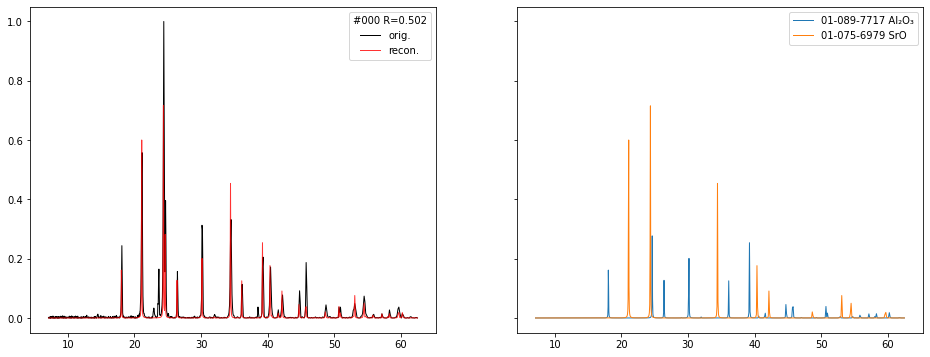

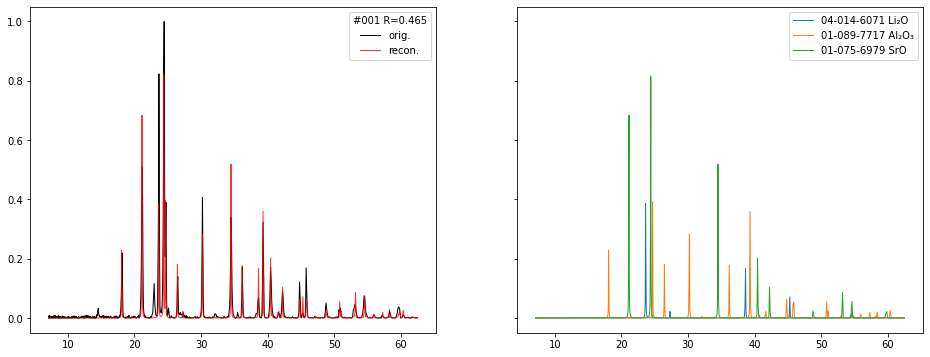

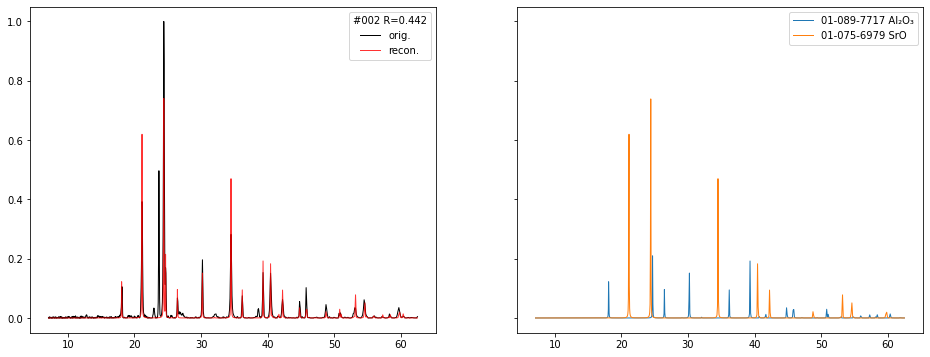

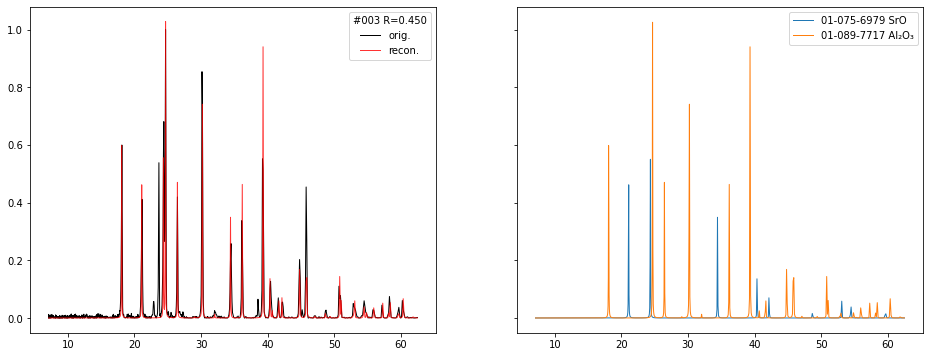

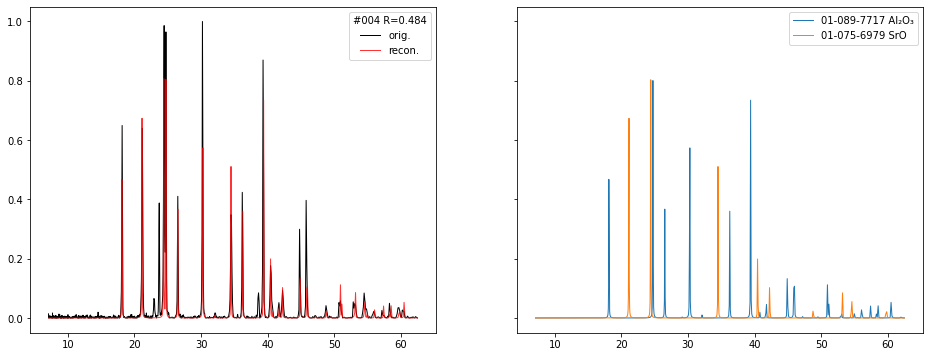

...

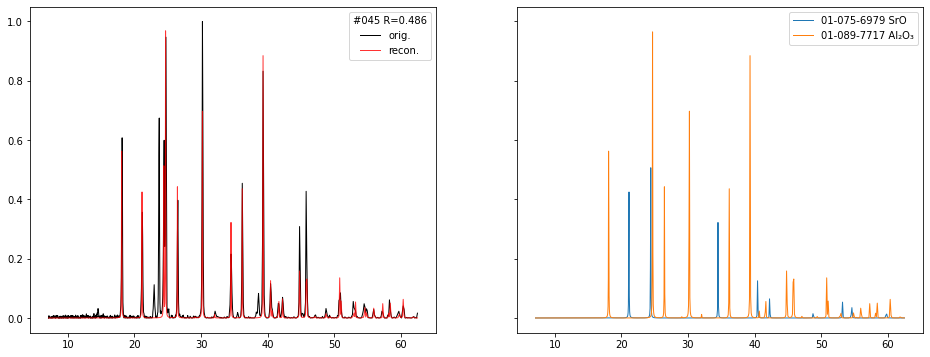

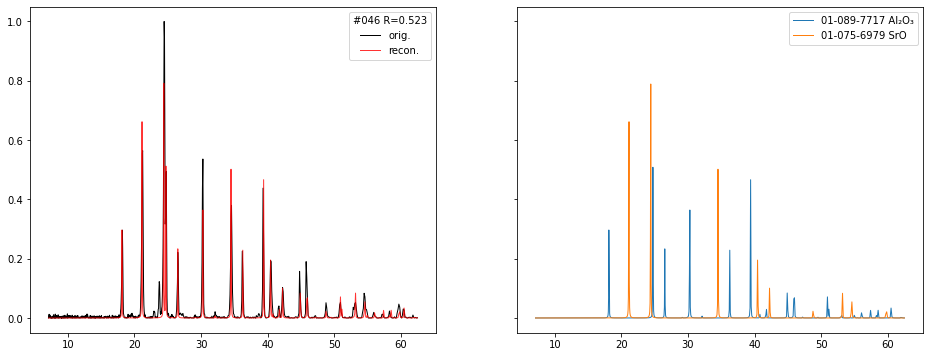

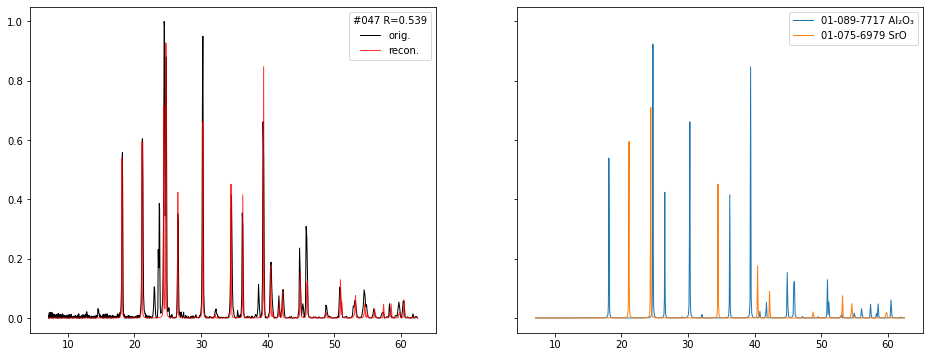

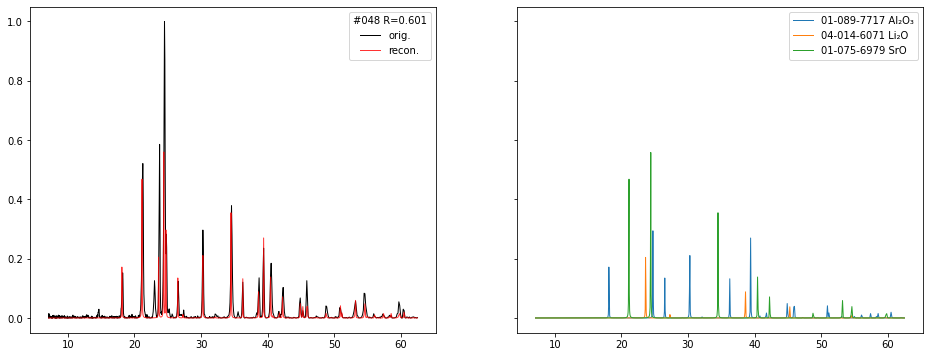

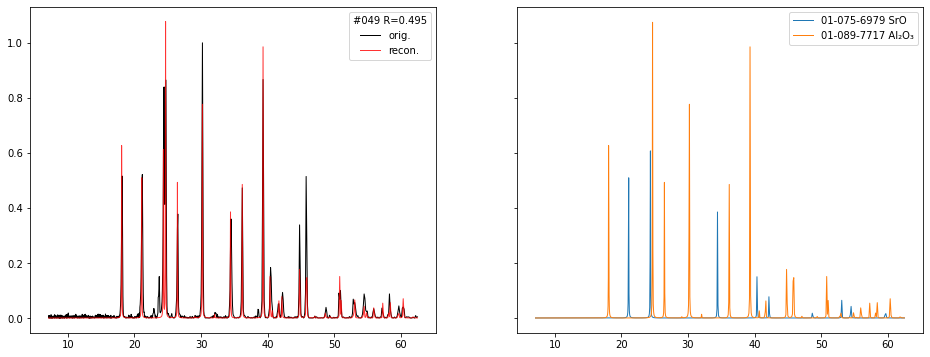

In [5]:
samples = []
for i in range(instance_data.sample_num):    
    solution = []
    for e in entries:
        phase = Phase.from_entry_and_instance_data(e, 1 / len(entries), instance_data)
        solution.append(phase)  
        
    sample = Sample(i, instance_data.log_q, instance_data.sample_xrd[i], instance_data.chemsys,
                    instance_data.sample_comp[i], oxide_system, instance_data.wavelength, max_q_shift, solution)
    sample.prune_candidates_based_on_composition(cutoff=0.005)
    sample.prune_candidate_based_on_xrd(plot=False, cutoff=0.015)
    sample.refine_all_fractions()    
    sample.update_solution(0.03, 0.2999, sample.max_q_shift)    
    sample = sample.optimize(num_epoch=500, print_prog=True,loss_weight=loss_weight)
    sample.update_solution(0.1, 0.2999, sample.max_q_shift)    
    sample.plot(perphase=True)
    samples.append(sample) 

In [7]:
for sample in samples:
    sample.update_solution(0.12,0.2999, sample.max_q_shift)    

In [8]:
Sample.solution_statistics(samples)

      entry_id        tot       max       min  count  names
0  01-089-7717  31.339196  1.000000  0.203257     50  Al2O3
1  01-075-6979  17.817318  0.796743  0.122677     45    SrO
2  04-014-6071   0.843486  0.178063  0.125943      6   Li2O


Sample: # 0
    Name     Entry_id  fraction  phase_fraction  shift  width
0    SrO  01-075-6979  0.582443        0.448326      0   0.03
1  Al2O3  01-089-7717  0.381044        0.248251      0   0.03
2   Li2O  04-014-6071  0.036513        0.303423      0   0.03
Current R = 0.49192021251607115
x tensor([[0.2654, 0.4262, 0.3084]], grad_fn=<SumBackward1>)
entropy tensor([1.0783], grad_fn=<NegBackward0>) tensor(1.0783, grad_fn=<MeanBackward0>)
loss tensor(261.3570, grad_fn=<DivBackward0>) tensor(1.0783, grad_fn=<MeanBackward0>) tensor(0.1241, grad_fn=<MseLossBackward0>)
x tensor([[0.2698, 0.3994, 0.3308]], grad_fn=<SumBackward1>)
entropy tensor([1.0860], grad_fn=<NegBackward0>) tensor(1.0860, grad_fn=<MeanBackward0>)
loss tensor(232.5398, grad_fn=<DivBackward0>) tensor(1.0860, grad_fn=<MeanBackward0>) tensor(0.1399, grad_fn=<MseLossBackward0>)
x tensor([[0.2698, 0.3606, 0.3696]], grad_fn=<SumBackward1>)
entropy tensor([1.0891], grad_fn=<NegBackward0>) tensor(1.0891, grad_fn=<MeanBackward0>)


x tensor([[0.4947, 0.2487, 0.2566]], grad_fn=<SumBackward1>)
entropy tensor([1.0433], grad_fn=<NegBackward0>) tensor(1.0433, grad_fn=<MeanBackward0>)
loss tensor(103.6927, grad_fn=<DivBackward0>) tensor(1.0433, grad_fn=<MeanBackward0>) tensor(0.2910, grad_fn=<MseLossBackward0>)
x tensor([[0.4930, 0.2459, 0.2611]], grad_fn=<SumBackward1>)
entropy tensor([1.0442], grad_fn=<NegBackward0>) tensor(1.0442, grad_fn=<MeanBackward0>)
loss tensor(102.9079, grad_fn=<DivBackward0>) tensor(1.0442, grad_fn=<MeanBackward0>) tensor(0.2899, grad_fn=<MseLossBackward0>)
x tensor([[0.4919, 0.2423, 0.2658]], grad_fn=<SumBackward1>)
entropy tensor([1.0447], grad_fn=<NegBackward0>) tensor(1.0447, grad_fn=<MeanBackward0>)
loss tensor(102.1351, grad_fn=<DivBackward0>) tensor(1.0447, grad_fn=<MeanBackward0>) tensor(0.2895, grad_fn=<MseLossBackward0>)
x tensor([[0.4908, 0.2376, 0.2716]], grad_fn=<SumBackward1>)
entropy tensor([1.0448], grad_fn=<NegBackward0>) tensor(1.0448, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.4965, 0.2278, 0.2757]], grad_fn=<SumBackward1>)
entropy tensor([1.0399], grad_fn=<NegBackward0>) tensor(1.0399, grad_fn=<MeanBackward0>)
loss tensor(97.7959, grad_fn=<DivBackward0>) tensor(1.0399, grad_fn=<MeanBackward0>) tensor(0.2957, grad_fn=<MseLossBackward0>)
x tensor([[0.4980, 0.2259, 0.2760]], grad_fn=<SumBackward1>)
entropy tensor([1.0386], grad_fn=<NegBackward0>) tensor(1.0386, grad_fn=<MeanBackward0>)
loss tensor(97.7967, grad_fn=<DivBackward0>) tensor(1.0386, grad_fn=<MeanBackward0>) tensor(0.2973, grad_fn=<MseLossBackward0>)
x tensor([[0.4995, 0.2240, 0.2765]], grad_fn=<SumBackward1>)
entropy tensor([1.0373], grad_fn=<NegBackward0>) tensor(1.0373, grad_fn=<MeanBackward0>)
loss tensor(97.7977, grad_fn=<DivBackward0>) tensor(1.0373, grad_fn=<MeanBackward0>) tensor(0.2988, grad_fn=<MseLossBackward0>)
x tensor([[0.5009, 0.2221, 0.2770]], grad_fn=<SumBackward1>)
entropy tensor([1.0361], grad_fn=<NegBackward0>) tensor(1.0361, grad_fn=<MeanBackward0>)
loss tensor(97.7

x tensor([[0.4973, 0.2235, 0.2793]], grad_fn=<SumBackward1>)
entropy tensor([1.0385], grad_fn=<NegBackward0>) tensor(1.0385, grad_fn=<MeanBackward0>)
loss tensor(97.7663, grad_fn=<DivBackward0>) tensor(1.0385, grad_fn=<MeanBackward0>) tensor(0.2972, grad_fn=<MseLossBackward0>)
x tensor([[0.4974, 0.2231, 0.2795]], grad_fn=<SumBackward1>)
entropy tensor([1.0383], grad_fn=<NegBackward0>) tensor(1.0383, grad_fn=<MeanBackward0>)
loss tensor(97.7660, grad_fn=<DivBackward0>) tensor(1.0383, grad_fn=<MeanBackward0>) tensor(0.2974, grad_fn=<MseLossBackward0>)
x tensor([[0.4977, 0.2226, 0.2797]], grad_fn=<SumBackward1>)
entropy tensor([1.0381], grad_fn=<NegBackward0>) tensor(1.0381, grad_fn=<MeanBackward0>)
loss tensor(97.7657, grad_fn=<DivBackward0>) tensor(1.0381, grad_fn=<MeanBackward0>) tensor(0.2976, grad_fn=<MseLossBackward0>)
x tensor([[0.4980, 0.2222, 0.2798]], grad_fn=<SumBackward1>)
entropy tensor([1.0378], grad_fn=<NegBackward0>) tensor(1.0378, grad_fn=<MeanBackward0>)
loss tensor(97.7

loss tensor(97.7643, grad_fn=<DivBackward0>) tensor(1.0367, grad_fn=<MeanBackward0>) tensor(0.2993, grad_fn=<MseLossBackward0>)
x tensor([[0.4995, 0.2213, 0.2792]], grad_fn=<SumBackward1>)
entropy tensor([1.0367], grad_fn=<NegBackward0>) tensor(1.0367, grad_fn=<MeanBackward0>)
loss tensor(97.7643, grad_fn=<DivBackward0>) tensor(1.0367, grad_fn=<MeanBackward0>) tensor(0.2993, grad_fn=<MseLossBackward0>)
x tensor([[0.4995, 0.2213, 0.2792]], grad_fn=<SumBackward1>)
entropy tensor([1.0367], grad_fn=<NegBackward0>) tensor(1.0367, grad_fn=<MeanBackward0>)
loss tensor(97.7643, grad_fn=<DivBackward0>) tensor(1.0367, grad_fn=<MeanBackward0>) tensor(0.2993, grad_fn=<MseLossBackward0>)
x tensor([[0.4995, 0.2213, 0.2792]], grad_fn=<SumBackward1>)
entropy tensor([1.0367], grad_fn=<NegBackward0>) tensor(1.0367, grad_fn=<MeanBackward0>)
loss tensor(97.7643, grad_fn=<DivBackward0>) tensor(1.0367, grad_fn=<MeanBackward0>) tensor(0.2993, grad_fn=<MseLossBackward0>)
x tensor([[0.4995, 0.2213, 0.2792]], g

loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0366], grad_fn=<NegBackward0>) tensor(1.0366, grad_fn=<MeanBackward0>)
loss tensor(97.7642, grad_fn=<DivBackward0>) tensor(1.0366, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0366], grad_fn=<NegBackward0>) tensor(1.0366, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0366, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0366], grad_fn=<NegBackward0>) tensor(1.0366, grad_fn=<MeanBackward0>)
loss tensor(97.7642, grad_fn=<DivBackward0>) tensor(1.0366, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], g

x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7642, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7

loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], g

entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBack

entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBack

x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7

x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7

x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7

x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7

x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7641, grad_fn=<DivBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>) tensor(0.2995, grad_fn=<MseLossBackward0>)
x tensor([[0.4998, 0.2213, 0.2789]], grad_fn=<SumBackward1>)
entropy tensor([1.0365], grad_fn=<NegBackward0>) tensor(1.0365, grad_fn=<MeanBackward0>)
loss tensor(97.7

x tensor([[0.6035, 0.1993, 0.1972]], grad_fn=<SumBackward1>)
entropy tensor([0.9464], grad_fn=<NegBackward0>) tensor(0.9464, grad_fn=<MeanBackward0>)
loss tensor(221.5753, grad_fn=<DivBackward0>) tensor(0.9464, grad_fn=<MeanBackward0>) tensor(0.3392, grad_fn=<MseLossBackward0>)
x tensor([[0.6113, 0.1875, 0.2012]], grad_fn=<SumBackward1>)
entropy tensor([0.9373], grad_fn=<NegBackward0>) tensor(0.9373, grad_fn=<MeanBackward0>)
loss tensor(218.0179, grad_fn=<DivBackward0>) tensor(0.9373, grad_fn=<MeanBackward0>) tensor(0.3416, grad_fn=<MseLossBackward0>)
x tensor([[0.6221, 0.1757, 0.2022]], grad_fn=<SumBackward1>)
entropy tensor([0.9240], grad_fn=<NegBackward0>) tensor(0.9240, grad_fn=<MeanBackward0>)
loss tensor(214.7621, grad_fn=<DivBackward0>) tensor(0.9240, grad_fn=<MeanBackward0>) tensor(0.3506, grad_fn=<MseLossBackward0>)
x tensor([[0.6370, 0.1631, 0.1999]], grad_fn=<SumBackward1>)
entropy tensor([0.9049], grad_fn=<NegBackward0>) tensor(0.9049, grad_fn=<MeanBackward0>)
loss tensor(2

entropy tensor([0.6069], grad_fn=<NegBackward0>) tensor(0.6069, grad_fn=<MeanBackward0>)
loss tensor(174.8091, grad_fn=<DivBackward0>) tensor(0.6069, grad_fn=<MeanBackward0>) tensor(0.3382, grad_fn=<MseLossBackward0>)
x tensor([[0.7037, 0.0000, 0.2963]], grad_fn=<SumBackward1>)
entropy tensor([0.6077], grad_fn=<NegBackward0>) tensor(0.6077, grad_fn=<MeanBackward0>)
loss tensor(174.7594, grad_fn=<DivBackward0>) tensor(0.6077, grad_fn=<MeanBackward0>) tensor(0.3367, grad_fn=<MseLossBackward0>)
x tensor([[0.7027, 0.0000, 0.2973]], grad_fn=<SumBackward1>)
entropy tensor([0.6086], grad_fn=<NegBackward0>) tensor(0.6086, grad_fn=<MeanBackward0>)
loss tensor(174.7376, grad_fn=<DivBackward0>) tensor(0.6086, grad_fn=<MeanBackward0>) tensor(0.3351, grad_fn=<MseLossBackward0>)
x tensor([[0.6991, 0.0000, 0.3009]], grad_fn=<SumBackward1>)
entropy tensor([0.6116], grad_fn=<NegBackward0>) tensor(0.6116, grad_fn=<MeanBackward0>)
loss tensor(174.7800, grad_fn=<DivBackward0>) tensor(0.6116, grad_fn=<Mean

entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4270, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6841, 0.0000, 0.3159]], grad_fn=<SumBackward1>)
entropy tensor([0.6238], grad_fn=<NegBackward0>) tensor(0.6238, grad_fn=<MeanBackward0>)
loss tensor(174.4273, grad_fn=<DivBackward0>) tensor(0.6238, grad_fn=<MeanBackward0>) tensor(0.3067, grad_fn=<MseLossBackward0>)
x tensor([[0.6838, 0.0000, 0.3162]], grad_fn=<SumBackward1>)
entropy tensor([0.6240], grad_fn=<NegBackward0>) tensor(0.6240, grad_fn=<MeanBackward0>)
loss tensor(174.4275, grad_fn=<DivBackward0>) tensor(0.6240, grad_fn=<MeanBackward0>) tensor(0.3064, grad_fn=<MseLossBackward0>)
x tensor([[0.6836, 0.0000, 0.3164]], grad_fn=<SumBackward1>)
entropy tensor([0.6241], grad_fn=<NegBackward0>) tensor(0.6241, grad_fn=<MeanBackward0>)
loss tensor(174.4277, grad_fn=<DivBackward0>) tensor(0.6241, grad_fn=<Mean

entropy tensor([0.6233], grad_fn=<NegBackward0>) tensor(0.6233, grad_fn=<MeanBackward0>)
loss tensor(174.4245, grad_fn=<DivBackward0>) tensor(0.6233, grad_fn=<MeanBackward0>) tensor(0.3076, grad_fn=<MseLossBackward0>)
x tensor([[0.6846, 0.0000, 0.3154]], grad_fn=<SumBackward1>)
entropy tensor([0.6233], grad_fn=<NegBackward0>) tensor(0.6233, grad_fn=<MeanBackward0>)
loss tensor(174.4245, grad_fn=<DivBackward0>) tensor(0.6233, grad_fn=<MeanBackward0>) tensor(0.3076, grad_fn=<MseLossBackward0>)
x tensor([[0.6846, 0.0000, 0.3154]], grad_fn=<SumBackward1>)
entropy tensor([0.6234], grad_fn=<NegBackward0>) tensor(0.6234, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6234, grad_fn=<MeanBackward0>) tensor(0.3075, grad_fn=<MseLossBackward0>)
x tensor([[0.6846, 0.0000, 0.3154]], grad_fn=<SumBackward1>)
entropy tensor([0.6234], grad_fn=<NegBackward0>) tensor(0.6234, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6234, grad_fn=<Mean

entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4247, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3070, grad_fn=<MseLossBackward0>)
x tensor([[0.6842, 0.0000, 0.3158]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4247, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3070, grad_fn=<MseLossBackward0>)
x tensor([[0.6842, 0.0000, 0.3158]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4247, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3070, grad_fn=<MseLossBackward0>)
x tensor([[0.6842, 0.0000, 0.3158]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4247, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<Mean

entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<Mean

x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]

loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]

x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(174.4246, grad_fn=<DivBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>) tensor(0.3071, grad_fn=<MseLossBackward0>)
x tensor([[0.6843, 0.0000, 0.3157]], grad_fn=<SumBackward1>)
entropy tensor([0.6236], grad_fn=<NegBackward0>) tensor(0.6236, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.6690, 0.0259, 0.3051]], grad_fn=<SumBackward1>)
entropy tensor([0.7257], grad_fn=<NegBackward0>) tensor(0.7257, grad_fn=<MeanBackward0>)
loss tensor(250.3920, grad_fn=<DivBackward0>) tensor(0.7257, grad_fn=<MeanBackward0>) tensor(0.2343, grad_fn=<MseLossBackward0>)
x tensor([[0.6752, 0.0163, 0.3085]], grad_fn=<SumBackward1>)
entropy tensor([0.6950], grad_fn=<NegBackward0>) tensor(0.6950, grad_fn=<MeanBackward0>)
loss tensor(245.5739, grad_fn=<DivBackward0>) tensor(0.6950, grad_fn=<MeanBackward0>) tensor(0.2381, grad_fn=<MseLossBackward0>)
x tensor([[0.6803, 0.0096, 0.3101]], grad_fn=<SumBackward1>)
entropy tensor([0.6697], grad_fn=<NegBackward0>) tensor(0.6697, grad_fn=<MeanBackward0>)
loss tensor(240.5886, grad_fn=<DivBackward0>) tensor(0.6697, grad_fn=<MeanBackward0>) tensor(0.2417, grad_fn=<MseLossBackward0>)
x tensor([[0.6841, 0.0020, 0.3139]], grad_fn=<SumBackward1>)
entropy tensor([0.6360], grad_fn=<NegBackward0>) tensor(0.6360, grad_fn=<MeanBackward0>)
loss tensor(2

entropy tensor([0.5092], grad_fn=<NegBackward0>) tensor(0.5092, grad_fn=<MeanBackward0>)
loss tensor(193.0701, grad_fn=<DivBackward0>) tensor(0.5092, grad_fn=<MeanBackward0>) tensor(0.4015, grad_fn=<MseLossBackward0>)
x tensor([[0.7935, 0.0000, 0.2065]], grad_fn=<SumBackward1>)
entropy tensor([0.5093], grad_fn=<NegBackward0>) tensor(0.5093, grad_fn=<MeanBackward0>)
loss tensor(193.0692, grad_fn=<DivBackward0>) tensor(0.5093, grad_fn=<MeanBackward0>) tensor(0.4014, grad_fn=<MseLossBackward0>)
x tensor([[0.7934, 0.0000, 0.2066]], grad_fn=<SumBackward1>)
entropy tensor([0.5095], grad_fn=<NegBackward0>) tensor(0.5095, grad_fn=<MeanBackward0>)
loss tensor(193.0692, grad_fn=<DivBackward0>) tensor(0.5095, grad_fn=<MeanBackward0>) tensor(0.4011, grad_fn=<MseLossBackward0>)
x tensor([[0.7930, 0.0000, 0.2070]], grad_fn=<SumBackward1>)
entropy tensor([0.5100], grad_fn=<NegBackward0>) tensor(0.5100, grad_fn=<MeanBackward0>)
loss tensor(193.0676, grad_fn=<DivBackward0>) tensor(0.5100, grad_fn=<Mean

loss tensor(193.0635, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0635, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3910, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5164], grad_fn=<NegBackward0>) tensor(0.5164, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5164, grad_fn=<MeanBackward0>) tensor(0.3910, grad_fn=<MseLossBackward0>)
x tensor([[0.7882, 0.0000, 0.2118]], grad_fn=<SumBackward1>)
entropy tensor([0.5164], grad_fn=<NegBackward0>) tensor(0.5164, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5164, grad_fn=<MeanBackward0>) tensor(0.3911, grad_fn=<MseLossBackward0>)
x tensor([[0.7882, 0.0000, 0.2118]

entropy tensor([0.5166], grad_fn=<NegBackward0>) tensor(0.5166, grad_fn=<MeanBackward0>)
loss tensor(193.0635, grad_fn=<DivBackward0>) tensor(0.5166, grad_fn=<MeanBackward0>) tensor(0.3908, grad_fn=<MseLossBackward0>)
x tensor([[0.7880, 0.0000, 0.2120]], grad_fn=<SumBackward1>)
entropy tensor([0.5166], grad_fn=<NegBackward0>) tensor(0.5166, grad_fn=<MeanBackward0>)
loss tensor(193.0635, grad_fn=<DivBackward0>) tensor(0.5166, grad_fn=<MeanBackward0>) tensor(0.3908, grad_fn=<MseLossBackward0>)
x tensor([[0.7880, 0.0000, 0.2120]], grad_fn=<SumBackward1>)
entropy tensor([0.5166], grad_fn=<NegBackward0>) tensor(0.5166, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5166, grad_fn=<MeanBackward0>) tensor(0.3908, grad_fn=<MseLossBackward0>)
x tensor([[0.7880, 0.0000, 0.2120]], grad_fn=<SumBackward1>)
entropy tensor([0.5166], grad_fn=<NegBackward0>) tensor(0.5166, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5166, grad_fn=<Mean

x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]

loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]

entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<Mean

x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(193.0634, grad_fn=<DivBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>) tensor(0.3909, grad_fn=<MseLossBackward0>)
x tensor([[0.7881, 0.0000, 0.2119]], grad_fn=<SumBackward1>)
entropy tensor([0.5165], grad_fn=<NegBackward0>) tensor(0.5165, grad_fn=<MeanBackward0>)
loss tensor(1

Sample: # 2
    Name     Entry_id  fraction  phase_fraction     shift     width
0    SrO  01-075-6979  0.640053        0.417741  0.002292  0.063623
1  Al2O3  01-089-7717  0.300903        0.166224  0.002659  0.102598
2   Li2O  04-014-6071  0.059044        0.416035  0.001654  0.033491
Current R = 0.2314091770394718
Sample: # 3
    Name     Entry_id  fraction  phase_fraction  shift  width
0  Al2O3  01-089-7717  0.687663        0.420800      0   0.03
1    SrO  01-075-6979  0.262440        0.189738      0   0.03
2   Li2O  04-014-6071  0.049898        0.389463      0   0.03
Current R = 0.48410916937783516
x tensor([[0.4809, 0.1559, 0.3632]], grad_fn=<SumBackward1>)
entropy tensor([1.0097], grad_fn=<NegBackward0>) tensor(1.0097, grad_fn=<MeanBackward0>)
loss tensor(172.4423, grad_fn=<DivBackward0>) tensor(1.0097, grad_fn=<MeanBackward0>) tensor(0.2130, grad_fn=<MseLossBackward0>)
x tensor([[0.4122, 0.2427, 0.3451]], grad_fn=<SumBackward1>)
entropy tensor([1.0761], grad_fn=<NegBackward0>) tens

loss tensor(57.9923, grad_fn=<DivBackward0>) tensor(0.7842, grad_fn=<MeanBackward0>) tensor(0.0537, grad_fn=<MseLossBackward0>)
x tensor([[0.7088, 0.1990, 0.0923]], grad_fn=<SumBackward1>)
entropy tensor([0.7851], grad_fn=<NegBackward0>) tensor(0.7851, grad_fn=<MeanBackward0>)
loss tensor(57.9939, grad_fn=<DivBackward0>) tensor(0.7851, grad_fn=<MeanBackward0>) tensor(0.0547, grad_fn=<MseLossBackward0>)
x tensor([[0.7081, 0.2001, 0.0918]], grad_fn=<SumBackward1>)
entropy tensor([0.7855], grad_fn=<NegBackward0>) tensor(0.7855, grad_fn=<MeanBackward0>)
loss tensor(57.9962, grad_fn=<DivBackward0>) tensor(0.7855, grad_fn=<MeanBackward0>) tensor(0.0556, grad_fn=<MseLossBackward0>)
x tensor([[0.7079, 0.2008, 0.0913]], grad_fn=<SumBackward1>)
entropy tensor([0.7854], grad_fn=<NegBackward0>) tensor(0.7854, grad_fn=<MeanBackward0>)
loss tensor(57.9987, grad_fn=<DivBackward0>) tensor(0.7854, grad_fn=<MeanBackward0>) tensor(0.0562, grad_fn=<MseLossBackward0>)
x tensor([[0.7081, 0.2011, 0.0908]], g

x tensor([[0.7138, 0.1931, 0.0931]], grad_fn=<SumBackward1>)
entropy tensor([0.7792], grad_fn=<NegBackward0>) tensor(0.7792, grad_fn=<MeanBackward0>)
loss tensor(57.9856, grad_fn=<DivBackward0>) tensor(0.7792, grad_fn=<MeanBackward0>) tensor(0.0509, grad_fn=<MseLossBackward0>)
x tensor([[0.7139, 0.1931, 0.0930]], grad_fn=<SumBackward1>)
entropy tensor([0.7791], grad_fn=<NegBackward0>) tensor(0.7791, grad_fn=<MeanBackward0>)
loss tensor(57.9856, grad_fn=<DivBackward0>) tensor(0.7791, grad_fn=<MeanBackward0>) tensor(0.0510, grad_fn=<MseLossBackward0>)
x tensor([[0.7139, 0.1930, 0.0931]], grad_fn=<SumBackward1>)
entropy tensor([0.7791], grad_fn=<NegBackward0>) tensor(0.7791, grad_fn=<MeanBackward0>)
loss tensor(57.9855, grad_fn=<DivBackward0>) tensor(0.7791, grad_fn=<MeanBackward0>) tensor(0.0509, grad_fn=<MseLossBackward0>)
x tensor([[0.7139, 0.1930, 0.0931]], grad_fn=<SumBackward1>)
entropy tensor([0.7792], grad_fn=<NegBackward0>) tensor(0.7792, grad_fn=<MeanBackward0>)
loss tensor(57.9

x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0504, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0504, grad_fn=<MseLossBackward0>)
x tensor([[0.7135, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0504, grad_fn=<MseLossBackward0>)
x tensor([[0.7135, 0.1926, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9

loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], g

x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9

x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9

x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9

x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9

loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], g

x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9

x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9852, grad_fn=<DivBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>) tensor(0.0505, grad_fn=<MseLossBackward0>)
x tensor([[0.7134, 0.1927, 0.0939]], grad_fn=<SumBackward1>)
entropy tensor([0.7803], grad_fn=<NegBackward0>) tensor(0.7803, grad_fn=<MeanBackward0>)
loss tensor(57.9

x tensor([[0.3266, 0.5103, 0.1631]], grad_fn=<SumBackward1>)
entropy tensor([1.0046], grad_fn=<NegBackward0>) tensor(1.0046, grad_fn=<MeanBackward0>)
loss tensor(368.1403, grad_fn=<DivBackward0>) tensor(1.0046, grad_fn=<MeanBackward0>) tensor(0.2303, grad_fn=<MseLossBackward0>)
x tensor([[0.3372, 0.5129, 0.1500]], grad_fn=<SumBackward1>)
entropy tensor([0.9936], grad_fn=<NegBackward0>) tensor(0.9936, grad_fn=<MeanBackward0>)
loss tensor(363.2917, grad_fn=<DivBackward0>) tensor(0.9936, grad_fn=<MeanBackward0>) tensor(0.2473, grad_fn=<MseLossBackward0>)
x tensor([[0.3447, 0.5170, 0.1383]], grad_fn=<SumBackward1>)
entropy tensor([0.9818], grad_fn=<NegBackward0>) tensor(0.9818, grad_fn=<MeanBackward0>)
loss tensor(358.2447, grad_fn=<DivBackward0>) tensor(0.9818, grad_fn=<MeanBackward0>) tensor(0.2656, grad_fn=<MseLossBackward0>)
x tensor([[0.3510, 0.5216, 0.1274]], grad_fn=<SumBackward1>)
entropy tensor([0.9695], grad_fn=<NegBackward0>) tensor(0.9695, grad_fn=<MeanBackward0>)
loss tensor(3

x tensor([[0.6029, 0.3971, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6718], grad_fn=<NegBackward0>) tensor(0.6718, grad_fn=<MeanBackward0>)
loss tensor(327.8226, grad_fn=<DivBackward0>) tensor(0.6718, grad_fn=<MeanBackward0>) tensor(0.5197, grad_fn=<MseLossBackward0>)
x tensor([[0.5997, 0.4003, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6731], grad_fn=<NegBackward0>) tensor(0.6731, grad_fn=<MeanBackward0>)
loss tensor(327.8081, grad_fn=<DivBackward0>) tensor(0.6731, grad_fn=<MeanBackward0>) tensor(0.5214, grad_fn=<MseLossBackward0>)
x tensor([[0.5968, 0.4032, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6743], grad_fn=<NegBackward0>) tensor(0.6743, grad_fn=<MeanBackward0>)
loss tensor(327.7964, grad_fn=<DivBackward0>) tensor(0.6743, grad_fn=<MeanBackward0>) tensor(0.5230, grad_fn=<MseLossBackward0>)
x tensor([[0.5941, 0.4059, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6754], grad_fn=<NegBackward0>) tensor(0.6754, grad_fn=<MeanBackward0>)
loss tensor(3

x tensor([[0.5912, 0.4088, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6764], grad_fn=<NegBackward0>) tensor(0.6764, grad_fn=<MeanBackward0>)
loss tensor(327.7607, grad_fn=<DivBackward0>) tensor(0.6764, grad_fn=<MeanBackward0>) tensor(0.5260, grad_fn=<MseLossBackward0>)
x tensor([[0.5914, 0.4086, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6764], grad_fn=<NegBackward0>) tensor(0.6764, grad_fn=<MeanBackward0>)
loss tensor(327.7608, grad_fn=<DivBackward0>) tensor(0.6764, grad_fn=<MeanBackward0>) tensor(0.5260, grad_fn=<MseLossBackward0>)
x tensor([[0.5915, 0.4085, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6763], grad_fn=<NegBackward0>) tensor(0.6763, grad_fn=<MeanBackward0>)
loss tensor(327.7608, grad_fn=<DivBackward0>) tensor(0.6763, grad_fn=<MeanBackward0>) tensor(0.5259, grad_fn=<MseLossBackward0>)
x tensor([[0.5915, 0.4085, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6763], grad_fn=<NegBackward0>) tensor(0.6763, grad_fn=<MeanBackward0>)
loss tensor(3

x tensor([[0.5893, 0.4107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6771], grad_fn=<NegBackward0>) tensor(0.6771, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6771, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5893, 0.4107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6771], grad_fn=<NegBackward0>) tensor(0.6771, grad_fn=<MeanBackward0>)
loss tensor(327.7593, grad_fn=<DivBackward0>) tensor(0.6771, grad_fn=<MeanBackward0>) tensor(0.5271, grad_fn=<MseLossBackward0>)
x tensor([[0.5893, 0.4107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6771], grad_fn=<NegBackward0>) tensor(0.6771, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6771, grad_fn=<MeanBackward0>) tensor(0.5271, grad_fn=<MseLossBackward0>)
x tensor([[0.5893, 0.4107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6771], grad_fn=<NegBackward0>) tensor(0.6771, grad_fn=<MeanBackward0>)
loss tensor(3

x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7593, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(3

loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]

loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]

x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(3

x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(3

entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<Mean

loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]

x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(327.7592, grad_fn=<DivBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>) tensor(0.5272, grad_fn=<MseLossBackward0>)
x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6772], grad_fn=<NegBackward0>) tensor(0.6772, grad_fn=<MeanBackward0>)
loss tensor(3

Sample: # 4
    Name     Entry_id  fraction  phase_fraction     shift     width
0  Al2O3  01-089-7717  0.553840        0.384779  0.002913  0.052033
1    SrO  01-075-6979  0.415192        0.340801  0.003638  0.107789
2   Li2O  04-014-6071  0.030967        0.274420  0.005461  0.018995
Current R = 0.24485725141675982
Sample: # 5
    Name     Entry_id  fraction  phase_fraction  shift  width
0    SrO  01-075-6979  0.582443        0.448326      0   0.03
1  Al2O3  01-089-7717  0.381044        0.248251      0   0.03
2   Li2O  04-014-6071  0.036513        0.303423      0   0.03
Current R = 0.4919202125160711
x tensor([[0.3283, 0.1792, 0.4925]], grad_fn=<SumBackward1>)
entropy tensor([1.0225], grad_fn=<NegBackward0>) tensor(1.0225, grad_fn=<MeanBackward0>)
loss tensor(249.2597, grad_fn=<DivBackward0>) tensor(1.0225, grad_fn=<MeanBackward0>) tensor(0.2833, grad_fn=<MseLossBackward0>)
x tensor([[0.3076, 0.2561, 0.4364]], grad_fn=<SumBackward1>)
entropy tensor([1.0734], grad_fn=<NegBackward0>) tens

loss tensor(82.4077, grad_fn=<DivBackward0>) tensor(0.8947, grad_fn=<MeanBackward0>) tensor(0.3734, grad_fn=<MseLossBackward0>)
x tensor([[0.6323, 0.2380, 0.1297]], grad_fn=<SumBackward1>)
entropy tensor([0.8964], grad_fn=<NegBackward0>) tensor(0.8964, grad_fn=<MeanBackward0>)
loss tensor(82.4126, grad_fn=<DivBackward0>) tensor(0.8964, grad_fn=<MeanBackward0>) tensor(0.3714, grad_fn=<MseLossBackward0>)
x tensor([[0.6315, 0.2383, 0.1302]], grad_fn=<SumBackward1>)
entropy tensor([0.8975], grad_fn=<NegBackward0>) tensor(0.8975, grad_fn=<MeanBackward0>)
loss tensor(82.4169, grad_fn=<DivBackward0>) tensor(0.8975, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.6310, 0.2386, 0.1304]], grad_fn=<SumBackward1>)
entropy tensor([0.8981], grad_fn=<NegBackward0>) tensor(0.8981, grad_fn=<MeanBackward0>)
loss tensor(82.4197, grad_fn=<DivBackward0>) tensor(0.8981, grad_fn=<MeanBackward0>) tensor(0.3695, grad_fn=<MseLossBackward0>)
x tensor([[0.6309, 0.2388, 0.1303]], g

loss tensor(82.3643, grad_fn=<DivBackward0>) tensor(0.8777, grad_fn=<MeanBackward0>) tensor(0.3931, grad_fn=<MseLossBackward0>)
x tensor([[0.6436, 0.2378, 0.1186]], grad_fn=<SumBackward1>)
entropy tensor([0.8781], grad_fn=<NegBackward0>) tensor(0.8781, grad_fn=<MeanBackward0>)
loss tensor(82.3646, grad_fn=<DivBackward0>) tensor(0.8781, grad_fn=<MeanBackward0>) tensor(0.3927, grad_fn=<MseLossBackward0>)
x tensor([[0.6434, 0.2379, 0.1187]], grad_fn=<SumBackward1>)
entropy tensor([0.8783], grad_fn=<NegBackward0>) tensor(0.8783, grad_fn=<MeanBackward0>)
loss tensor(82.3648, grad_fn=<DivBackward0>) tensor(0.8783, grad_fn=<MeanBackward0>) tensor(0.3924, grad_fn=<MseLossBackward0>)
x tensor([[0.6433, 0.2380, 0.1187]], grad_fn=<SumBackward1>)
entropy tensor([0.8784], grad_fn=<NegBackward0>) tensor(0.8784, grad_fn=<MeanBackward0>)
loss tensor(82.3648, grad_fn=<DivBackward0>) tensor(0.8784, grad_fn=<MeanBackward0>) tensor(0.3923, grad_fn=<MseLossBackward0>)
x tensor([[0.6433, 0.2380, 0.1187]], g

loss tensor(82.3626, grad_fn=<DivBackward0>) tensor(0.8752, grad_fn=<MeanBackward0>) tensor(0.3961, grad_fn=<MseLossBackward0>)
x tensor([[0.6456, 0.2372, 0.1173]], grad_fn=<SumBackward1>)
entropy tensor([0.8752], grad_fn=<NegBackward0>) tensor(0.8752, grad_fn=<MeanBackward0>)
loss tensor(82.3626, grad_fn=<DivBackward0>) tensor(0.8752, grad_fn=<MeanBackward0>) tensor(0.3961, grad_fn=<MseLossBackward0>)
x tensor([[0.6456, 0.2371, 0.1173]], grad_fn=<SumBackward1>)
entropy tensor([0.8751], grad_fn=<NegBackward0>) tensor(0.8751, grad_fn=<MeanBackward0>)
loss tensor(82.3626, grad_fn=<DivBackward0>) tensor(0.8751, grad_fn=<MeanBackward0>) tensor(0.3962, grad_fn=<MseLossBackward0>)
x tensor([[0.6456, 0.2371, 0.1173]], grad_fn=<SumBackward1>)
entropy tensor([0.8751], grad_fn=<NegBackward0>) tensor(0.8751, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8751, grad_fn=<MeanBackward0>) tensor(0.3962, grad_fn=<MseLossBackward0>)
x tensor([[0.6456, 0.2371, 0.1173]], g

x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3

x tensor([[0.6456, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6456, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6456, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6456, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3

x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3

x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3

x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3

x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3

x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3

x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3

x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3625, grad_fn=<DivBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>) tensor(0.3963, grad_fn=<MseLossBackward0>)
x tensor([[0.6457, 0.2371, 0.1172]], grad_fn=<SumBackward1>)
entropy tensor([0.8750], grad_fn=<NegBackward0>) tensor(0.8750, grad_fn=<MeanBackward0>)
loss tensor(82.3

x tensor([[0.5604, 0.2932, 0.1464]], grad_fn=<SumBackward1>)
entropy tensor([0.9656], grad_fn=<NegBackward0>) tensor(0.9656, grad_fn=<MeanBackward0>)
loss tensor(288.6120, grad_fn=<DivBackward0>) tensor(0.9656, grad_fn=<MeanBackward0>) tensor(0.3151, grad_fn=<MseLossBackward0>)
x tensor([[0.5914, 0.2843, 0.1243]], grad_fn=<SumBackward1>)
entropy tensor([0.9274], grad_fn=<NegBackward0>) tensor(0.9274, grad_fn=<MeanBackward0>)
loss tensor(282.9846, grad_fn=<DivBackward0>) tensor(0.9274, grad_fn=<MeanBackward0>) tensor(0.3791, grad_fn=<MseLossBackward0>)
x tensor([[0.6179, 0.2697, 0.1124]], grad_fn=<SumBackward1>)
entropy tensor([0.8965], grad_fn=<NegBackward0>) tensor(0.8965, grad_fn=<MeanBackward0>)
loss tensor(278.3696, grad_fn=<DivBackward0>) tensor(0.8965, grad_fn=<MeanBackward0>) tensor(0.4273, grad_fn=<MseLossBackward0>)
x tensor([[0.6394, 0.2595, 0.1011]], grad_fn=<SumBackward1>)
entropy tensor([0.8677], grad_fn=<NegBackward0>) tensor(0.8677, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.9978, 0.0022, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0158], grad_fn=<NegBackward0>) tensor(0.0158, grad_fn=<MeanBackward0>)
loss tensor(230.8902, grad_fn=<DivBackward0>) tensor(0.0158, grad_fn=<MeanBackward0>) tensor(1.2613, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(230.3684, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(230.1790, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5392, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5390, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5386, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5

loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_f

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1

loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_

loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5

loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_

loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tens

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5292, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2646, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(229.5

loss tensor(88.9033, grad_fn=<DivBackward0>) tensor(0.9453, grad_fn=<MeanBackward0>) tensor(0.2064, grad_fn=<MseLossBackward0>)
x tensor([[0.5113, 0.3842, 0.1045]], grad_fn=<SumBackward1>)
entropy tensor([0.9465], grad_fn=<NegBackward0>) tensor(0.9465, grad_fn=<MeanBackward0>)
loss tensor(86.3691, grad_fn=<DivBackward0>) tensor(0.9465, grad_fn=<MeanBackward0>) tensor(0.1934, grad_fn=<MseLossBackward0>)
x tensor([[0.5177, 0.3780, 0.1043]], grad_fn=<SumBackward1>)
entropy tensor([0.9443], grad_fn=<NegBackward0>) tensor(0.9443, grad_fn=<MeanBackward0>)
loss tensor(83.5001, grad_fn=<DivBackward0>) tensor(0.9443, grad_fn=<MeanBackward0>) tensor(0.1869, grad_fn=<MseLossBackward0>)
x tensor([[0.5265, 0.3726, 0.1010]], grad_fn=<SumBackward1>)
entropy tensor([0.9371], grad_fn=<NegBackward0>) tensor(0.9371, grad_fn=<MeanBackward0>)
loss tensor(80.3155, grad_fn=<DivBackward0>) tensor(0.9371, grad_fn=<MeanBackward0>) tensor(0.1825, grad_fn=<MseLossBackward0>)
x tensor([[0.5415, 0.3562, 0.1023]], g

loss tensor(55.4874, grad_fn=<DivBackward0>) tensor(0.8944, grad_fn=<MeanBackward0>) tensor(0.1827, grad_fn=<MseLossBackward0>)
x tensor([[0.5586, 0.3608, 0.0805]], grad_fn=<SumBackward1>)
entropy tensor([0.8959], grad_fn=<NegBackward0>) tensor(0.8959, grad_fn=<MeanBackward0>)
loss tensor(55.4633, grad_fn=<DivBackward0>) tensor(0.8959, grad_fn=<MeanBackward0>) tensor(0.1808, grad_fn=<MseLossBackward0>)
x tensor([[0.5598, 0.3588, 0.0814]], grad_fn=<SumBackward1>)
entropy tensor([0.8968], grad_fn=<NegBackward0>) tensor(0.8968, grad_fn=<MeanBackward0>)
loss tensor(55.4335, grad_fn=<DivBackward0>) tensor(0.8968, grad_fn=<MeanBackward0>) tensor(0.1781, grad_fn=<MseLossBackward0>)
x tensor([[0.5618, 0.3561, 0.0821]], grad_fn=<SumBackward1>)
entropy tensor([0.8969], grad_fn=<NegBackward0>) tensor(0.8969, grad_fn=<MeanBackward0>)
loss tensor(55.4011, grad_fn=<DivBackward0>) tensor(0.8969, grad_fn=<MeanBackward0>) tensor(0.1750, grad_fn=<MseLossBackward0>)
x tensor([[0.5645, 0.3530, 0.0826]], g

x tensor([[0.5807, 0.3336, 0.0857]], grad_fn=<SumBackward1>)
entropy tensor([0.8924], grad_fn=<NegBackward0>) tensor(0.8924, grad_fn=<MeanBackward0>)
loss tensor(55.2758, grad_fn=<DivBackward0>) tensor(0.8924, grad_fn=<MeanBackward0>) tensor(0.1508, grad_fn=<MseLossBackward0>)
x tensor([[0.5809, 0.3337, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8919], grad_fn=<NegBackward0>) tensor(0.8919, grad_fn=<MeanBackward0>)
loss tensor(55.2756, grad_fn=<DivBackward0>) tensor(0.8919, grad_fn=<MeanBackward0>) tensor(0.1511, grad_fn=<MseLossBackward0>)
x tensor([[0.5810, 0.3339, 0.0851]], grad_fn=<SumBackward1>)
entropy tensor([0.8915], grad_fn=<NegBackward0>) tensor(0.8915, grad_fn=<MeanBackward0>)
loss tensor(55.2755, grad_fn=<DivBackward0>) tensor(0.8915, grad_fn=<MeanBackward0>) tensor(0.1514, grad_fn=<MseLossBackward0>)
x tensor([[0.5810, 0.3340, 0.0849]], grad_fn=<SumBackward1>)
entropy tensor([0.8912], grad_fn=<NegBackward0>) tensor(0.8912, grad_fn=<MeanBackward0>)
loss tensor(55.2

x tensor([[0.5807, 0.3335, 0.0858]], grad_fn=<SumBackward1>)
entropy tensor([0.8925], grad_fn=<NegBackward0>) tensor(0.8925, grad_fn=<MeanBackward0>)
loss tensor(55.2752, grad_fn=<DivBackward0>) tensor(0.8925, grad_fn=<MeanBackward0>) tensor(0.1506, grad_fn=<MseLossBackward0>)
x tensor([[0.5807, 0.3336, 0.0857]], grad_fn=<SumBackward1>)
entropy tensor([0.8925], grad_fn=<NegBackward0>) tensor(0.8925, grad_fn=<MeanBackward0>)
loss tensor(55.2752, grad_fn=<DivBackward0>) tensor(0.8925, grad_fn=<MeanBackward0>) tensor(0.1508, grad_fn=<MseLossBackward0>)
x tensor([[0.5806, 0.3337, 0.0857]], grad_fn=<SumBackward1>)
entropy tensor([0.8924], grad_fn=<NegBackward0>) tensor(0.8924, grad_fn=<MeanBackward0>)
loss tensor(55.2751, grad_fn=<DivBackward0>) tensor(0.8924, grad_fn=<MeanBackward0>) tensor(0.1509, grad_fn=<MseLossBackward0>)
x tensor([[0.5806, 0.3338, 0.0856]], grad_fn=<SumBackward1>)
entropy tensor([0.8923], grad_fn=<NegBackward0>) tensor(0.8923, grad_fn=<MeanBackward0>)
loss tensor(55.2

x tensor([[0.5803, 0.3342, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8923], grad_fn=<NegBackward0>) tensor(0.8923, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8923, grad_fn=<MeanBackward0>) tensor(0.1516, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3342, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8923], grad_fn=<NegBackward0>) tensor(0.8923, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8923, grad_fn=<MeanBackward0>) tensor(0.1516, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3342, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8923], grad_fn=<NegBackward0>) tensor(0.8923, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8923, grad_fn=<MeanBackward0>) tensor(0.1516, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3342, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8923], grad_fn=<NegBackward0>) tensor(0.8923, grad_fn=<MeanBackward0>)
loss tensor(55.2

x tensor([[0.5804, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1516, grad_fn=<MseLossBackward0>)
x tensor([[0.5804, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1516, grad_fn=<MseLossBackward0>)
x tensor([[0.5804, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1516, grad_fn=<MseLossBackward0>)
x tensor([[0.5804, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2

x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2

x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2

x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2

loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], g

entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBack

x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2

x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2747, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2747, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2

x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2

x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2748, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2747, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2747, grad_fn=<DivBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>) tensor(0.1517, grad_fn=<MseLossBackward0>)
x tensor([[0.5803, 0.3343, 0.0854]], grad_fn=<SumBackward1>)
entropy tensor([0.8922], grad_fn=<NegBackward0>) tensor(0.8922, grad_fn=<MeanBackward0>)
loss tensor(55.2

x tensor([[0.6024, 0.3759, 0.0217]], grad_fn=<SumBackward1>)
entropy tensor([0.7564], grad_fn=<NegBackward0>) tensor(0.7564, grad_fn=<MeanBackward0>)
loss tensor(352.0384, grad_fn=<DivBackward0>) tensor(0.7564, grad_fn=<MeanBackward0>) tensor(0.3109, grad_fn=<MseLossBackward0>)
x tensor([[0.6512, 0.3418, 0.0070]], grad_fn=<SumBackward1>)
entropy tensor([0.6810], grad_fn=<NegBackward0>) tensor(0.6810, grad_fn=<MeanBackward0>)
loss tensor(344.9001, grad_fn=<DivBackward0>) tensor(0.6810, grad_fn=<MeanBackward0>) tensor(0.3001, grad_fn=<MseLossBackward0>)
x tensor([[0.7011, 0.2989, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6100], grad_fn=<NegBackward0>) tensor(0.6100, grad_fn=<MeanBackward0>)
loss tensor(338.0092, grad_fn=<DivBackward0>) tensor(0.6100, grad_fn=<MeanBackward0>) tensor(0.2728, grad_fn=<MseLossBackward0>)
x tensor([[0.7550, 0.2442, 0.0008]], grad_fn=<SumBackward1>)
entropy tensor([0.5621], grad_fn=<NegBackward0>) tensor(0.5621, grad_fn=<MeanBackward0>)
loss tensor(3

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(304.7505, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(304.4661, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(304.1452, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(303.8

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6810, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6772, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6745, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackw

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6716, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6717, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6718, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackw

x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, g

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackw

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6

loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_

x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6

loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, g

loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, g

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(302.6714, grad_fn=<DivBackward0>) tensor(1.1921e-07, g

x tensor([[0.8169, 0.1831, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4760], grad_fn=<NegBackward0>) tensor(0.4760, grad_fn=<MeanBackward0>)
loss tensor(208.6514, grad_fn=<DivBackward0>) tensor(0.4760, grad_fn=<MeanBackward0>) tensor(0.2654, grad_fn=<MseLossBackward0>)
x tensor([[0.8090, 0.1910, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4877], grad_fn=<NegBackward0>) tensor(0.4877, grad_fn=<MeanBackward0>)
loss tensor(208.5080, grad_fn=<DivBackward0>) tensor(0.4877, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8026, 0.1974, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4968], grad_fn=<NegBackward0>) tensor(0.4968, grad_fn=<MeanBackward0>)
loss tensor(208.3902, grad_fn=<DivBackward0>) tensor(0.4968, grad_fn=<MeanBackward0>) tensor(0.2680, grad_fn=<MseLossBackward0>)
x tensor([[0.7978, 0.2022, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.5035], grad_fn=<NegBackward0>) tensor(0.5035, grad_fn=<MeanBackward0>)
loss tensor(2

loss tensor(208.0147, grad_fn=<DivBackward0>) tensor(0.4880, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8110, 0.1890, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4848], grad_fn=<NegBackward0>) tensor(0.4848, grad_fn=<MeanBackward0>)
loss tensor(208.0126, grad_fn=<DivBackward0>) tensor(0.4848, grad_fn=<MeanBackward0>) tensor(0.2663, grad_fn=<MseLossBackward0>)
x tensor([[0.8129, 0.1871, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4820], grad_fn=<NegBackward0>) tensor(0.4820, grad_fn=<MeanBackward0>)
loss tensor(208.0119, grad_fn=<DivBackward0>) tensor(0.4820, grad_fn=<MeanBackward0>) tensor(0.2660, grad_fn=<MseLossBackward0>)
x tensor([[0.8145, 0.1855, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4796], grad_fn=<NegBackward0>) tensor(0.4796, grad_fn=<MeanBackward0>)
loss tensor(208.0121, grad_fn=<DivBackward0>) tensor(0.4796, grad_fn=<MeanBackward0>) tensor(0.2658, grad_fn=<MseLossBackward0>)
x tensor([[0.8157, 0.1843, 0.0000]

loss tensor(208.0017, grad_fn=<DivBackward0>) tensor(0.4881, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8084, 0.1916, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4885], grad_fn=<NegBackward0>) tensor(0.4885, grad_fn=<MeanBackward0>)
loss tensor(208.0018, grad_fn=<DivBackward0>) tensor(0.4885, grad_fn=<MeanBackward0>) tensor(0.2668, grad_fn=<MseLossBackward0>)
x tensor([[0.8081, 0.1919, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4889], grad_fn=<NegBackward0>) tensor(0.4889, grad_fn=<MeanBackward0>)
loss tensor(208.0018, grad_fn=<DivBackward0>) tensor(0.4889, grad_fn=<MeanBackward0>) tensor(0.2668, grad_fn=<MseLossBackward0>)
x tensor([[0.8079, 0.1921, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4893], grad_fn=<NegBackward0>) tensor(0.4893, grad_fn=<MeanBackward0>)
loss tensor(208.0019, grad_fn=<DivBackward0>) tensor(0.4893, grad_fn=<MeanBackward0>) tensor(0.2669, grad_fn=<MseLossBackward0>)
x tensor([[0.8077, 0.1923, 0.0000]

x tensor([[0.8088, 0.1912, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4879], grad_fn=<NegBackward0>) tensor(0.4879, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4879, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8089, 0.1911, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4879], grad_fn=<NegBackward0>) tensor(0.4879, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4879, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8089, 0.1911, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4879], grad_fn=<NegBackward0>) tensor(0.4879, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4879, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8089, 0.1911, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4879], grad_fn=<NegBackward0>) tensor(0.4879, grad_fn=<MeanBackward0>)
loss tensor(2

entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0010, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0010, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1913, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<Mean

entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0010, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0010, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<Mean

entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0010, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0010, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<Mean

x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(2

loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]

x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(208.0011, grad_fn=<DivBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>) tensor(0.2667, grad_fn=<MseLossBackward0>)
x tensor([[0.8086, 0.1914, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4882], grad_fn=<NegBackward0>) tensor(0.4882, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.1547, 0.4145, 0.4308]], grad_fn=<SumBackward1>)
entropy tensor([1.0165], grad_fn=<NegBackward0>) tensor(1.0165, grad_fn=<MeanBackward0>)
loss tensor(134.8524, grad_fn=<DivBackward0>) tensor(1.0165, grad_fn=<MeanBackward0>) tensor(0.1759, grad_fn=<MseLossBackward0>)
x tensor([[0.1716, 0.4135, 0.4149]], grad_fn=<SumBackward1>)
entropy tensor([1.0326], grad_fn=<NegBackward0>) tensor(1.0326, grad_fn=<MeanBackward0>)
loss tensor(131.4885, grad_fn=<DivBackward0>) tensor(1.0326, grad_fn=<MeanBackward0>) tensor(0.1652, grad_fn=<MseLossBackward0>)
x tensor([[0.1888, 0.4139, 0.3974]], grad_fn=<SumBackward1>)
entropy tensor([1.0466], grad_fn=<NegBackward0>) tensor(1.0466, grad_fn=<MeanBackward0>)
loss tensor(128.0408, grad_fn=<DivBackward0>) tensor(1.0466, grad_fn=<MeanBackward0>) tensor(0.1539, grad_fn=<MseLossBackward0>)
x tensor([[0.2060, 0.4165, 0.3775]], grad_fn=<SumBackward1>)
entropy tensor([1.0580], grad_fn=<NegBackward0>) tensor(1.0580, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.6660, 0.3018, 0.0322]], grad_fn=<SumBackward1>)
entropy tensor([0.7429], grad_fn=<NegBackward0>) tensor(0.7429, grad_fn=<MeanBackward0>)
loss tensor(83.8461, grad_fn=<DivBackward0>) tensor(0.7429, grad_fn=<MeanBackward0>) tensor(0.0038, grad_fn=<MseLossBackward0>)
x tensor([[0.6696, 0.3010, 0.0295]], grad_fn=<SumBackward1>)
entropy tensor([0.7338], grad_fn=<NegBackward0>) tensor(0.7338, grad_fn=<MeanBackward0>)
loss tensor(83.5912, grad_fn=<DivBackward0>) tensor(0.7338, grad_fn=<MeanBackward0>) tensor(0.0039, grad_fn=<MseLossBackward0>)
x tensor([[0.6740, 0.3010, 0.0250]], grad_fn=<SumBackward1>)
entropy tensor([0.7196], grad_fn=<NegBackward0>) tensor(0.7196, grad_fn=<MeanBackward0>)
loss tensor(83.3372, grad_fn=<DivBackward0>) tensor(0.7196, grad_fn=<MeanBackward0>) tensor(0.0040, grad_fn=<MseLossBackward0>)
x tensor([[0.6789, 0.3022, 0.0189]], grad_fn=<SumBackward1>)
entropy tensor([0.6997], grad_fn=<NegBackward0>) tensor(0.6997, grad_fn=<MeanBackward0>)
loss tensor(83.1

x tensor([[0.6681, 0.3081, 0.0238]], grad_fn=<SumBackward1>)
entropy tensor([0.7211], grad_fn=<NegBackward0>) tensor(0.7211, grad_fn=<MeanBackward0>)
loss tensor(82.4973, grad_fn=<DivBackward0>) tensor(0.7211, grad_fn=<MeanBackward0>) tensor(0.0027, grad_fn=<MseLossBackward0>)
x tensor([[0.6668, 0.3096, 0.0236]], grad_fn=<SumBackward1>)
entropy tensor([0.7217], grad_fn=<NegBackward0>) tensor(0.7217, grad_fn=<MeanBackward0>)
loss tensor(82.4964, grad_fn=<DivBackward0>) tensor(0.7217, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6656, 0.3110, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7220], grad_fn=<NegBackward0>) tensor(0.7220, grad_fn=<MeanBackward0>)
loss tensor(82.4971, grad_fn=<DivBackward0>) tensor(0.7220, grad_fn=<MeanBackward0>) tensor(0.0023, grad_fn=<MseLossBackward0>)
x tensor([[0.6648, 0.3121, 0.0232]], grad_fn=<SumBackward1>)
entropy tensor([0.7221], grad_fn=<NegBackward0>) tensor(0.7221, grad_fn=<MeanBackward0>)
loss tensor(82.4

x tensor([[0.6662, 0.3099, 0.0240]], grad_fn=<SumBackward1>)
entropy tensor([0.7231], grad_fn=<NegBackward0>) tensor(0.7231, grad_fn=<MeanBackward0>)
loss tensor(82.4962, grad_fn=<DivBackward0>) tensor(0.7231, grad_fn=<MeanBackward0>) tensor(0.0024, grad_fn=<MseLossBackward0>)
x tensor([[0.6662, 0.3099, 0.0238]], grad_fn=<SumBackward1>)
entropy tensor([0.7227], grad_fn=<NegBackward0>) tensor(0.7227, grad_fn=<MeanBackward0>)
loss tensor(82.4961, grad_fn=<DivBackward0>) tensor(0.7227, grad_fn=<MeanBackward0>) tensor(0.0024, grad_fn=<MseLossBackward0>)
x tensor([[0.6664, 0.3099, 0.0237]], grad_fn=<SumBackward1>)
entropy tensor([0.7221], grad_fn=<NegBackward0>) tensor(0.7221, grad_fn=<MeanBackward0>)
loss tensor(82.4960, grad_fn=<DivBackward0>) tensor(0.7221, grad_fn=<MeanBackward0>) tensor(0.0024, grad_fn=<MseLossBackward0>)
x tensor([[0.6666, 0.3099, 0.0235]], grad_fn=<SumBackward1>)
entropy tensor([0.7214], grad_fn=<NegBackward0>) tensor(0.7214, grad_fn=<MeanBackward0>)
loss tensor(82.4

x tensor([[0.6672, 0.3096, 0.0233]], grad_fn=<SumBackward1>)
entropy tensor([0.7205], grad_fn=<NegBackward0>) tensor(0.7205, grad_fn=<MeanBackward0>)
loss tensor(82.4956, grad_fn=<DivBackward0>) tensor(0.7205, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6672, 0.3096, 0.0233]], grad_fn=<SumBackward1>)
entropy tensor([0.7205], grad_fn=<NegBackward0>) tensor(0.7205, grad_fn=<MeanBackward0>)
loss tensor(82.4955, grad_fn=<DivBackward0>) tensor(0.7205, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6671, 0.3096, 0.0233]], grad_fn=<SumBackward1>)
entropy tensor([0.7206], grad_fn=<NegBackward0>) tensor(0.7206, grad_fn=<MeanBackward0>)
loss tensor(82.4956, grad_fn=<DivBackward0>) tensor(0.7206, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6671, 0.3096, 0.0233]], grad_fn=<SumBackward1>)
entropy tensor([0.7207], grad_fn=<NegBackward0>) tensor(0.7207, grad_fn=<MeanBackward0>)
loss tensor(82.4

x tensor([[0.6670, 0.3097, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4956, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3097, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4955, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4956, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4

x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4955, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4955, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4956, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4

loss tensor(82.4956, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4955, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4955, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4955, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], g

loss tensor(82.4956, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4955, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4956, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4956, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], g

entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4955, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4956, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4956, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4955, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBack

loss tensor(82.4955, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4956, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4956, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4956, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], g

entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4955, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4955, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4955, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4955, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBack

x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4956, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4956, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4956, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4

loss tensor(82.4956, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4956, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4956, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], grad_fn=<SumBackward1>)
entropy tensor([0.7209], grad_fn=<NegBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>)
loss tensor(82.4956, grad_fn=<DivBackward0>) tensor(0.7209, grad_fn=<MeanBackward0>) tensor(0.0025, grad_fn=<MseLossBackward0>)
x tensor([[0.6670, 0.3096, 0.0234]], g

entropy tensor([0.4475], grad_fn=<NegBackward0>) tensor(0.4475, grad_fn=<MeanBackward0>)
loss tensor(284.5401, grad_fn=<DivBackward0>) tensor(0.4475, grad_fn=<MeanBackward0>) tensor(0.1302, grad_fn=<MseLossBackward0>)
x tensor([[0.8824, 0.1176, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3620], grad_fn=<NegBackward0>) tensor(0.3620, grad_fn=<MeanBackward0>)
loss tensor(282.5862, grad_fn=<DivBackward0>) tensor(0.3620, grad_fn=<MeanBackward0>) tensor(0.1219, grad_fn=<MseLossBackward0>)
x tensor([[0.9039, 0.0946, 0.0014]], grad_fn=<SumBackward1>)
entropy tensor([0.3238], grad_fn=<NegBackward0>) tensor(0.3238, grad_fn=<MeanBackward0>)
loss tensor(281.7406, grad_fn=<DivBackward0>) tensor(0.3238, grad_fn=<MeanBackward0>) tensor(0.1202, grad_fn=<MseLossBackward0>)
x tensor([[0.9232, 0.0768, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2710], grad_fn=<NegBackward0>) tensor(0.2710, grad_fn=<MeanBackward0>)
loss tensor(281.2722, grad_fn=<DivBackward0>) tensor(0.2710, grad_fn=<Mean

x tensor([[0.9260, 0.0740, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2638], grad_fn=<NegBackward0>) tensor(0.2638, grad_fn=<MeanBackward0>)
loss tensor(281.1081, grad_fn=<DivBackward0>) tensor(0.2638, grad_fn=<MeanBackward0>) tensor(0.1301, grad_fn=<MseLossBackward0>)
x tensor([[0.9288, 0.0712, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2568], grad_fn=<NegBackward0>) tensor(0.2568, grad_fn=<MeanBackward0>)
loss tensor(281.1175, grad_fn=<DivBackward0>) tensor(0.2568, grad_fn=<MeanBackward0>) tensor(0.1311, grad_fn=<MseLossBackward0>)
x tensor([[0.9306, 0.0694, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2521], grad_fn=<NegBackward0>) tensor(0.2521, grad_fn=<MeanBackward0>)
loss tensor(281.1252, grad_fn=<DivBackward0>) tensor(0.2521, grad_fn=<MeanBackward0>) tensor(0.1319, grad_fn=<MseLossBackward0>)
x tensor([[0.9314, 0.0686, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2499], grad_fn=<NegBackward0>) tensor(0.2499, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.9214, 0.0786, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2753], grad_fn=<NegBackward0>) tensor(0.2753, grad_fn=<MeanBackward0>)
loss tensor(281.0988, grad_fn=<DivBackward0>) tensor(0.2753, grad_fn=<MeanBackward0>) tensor(0.1284, grad_fn=<MseLossBackward0>)
x tensor([[0.9208, 0.0792, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2768], grad_fn=<NegBackward0>) tensor(0.2768, grad_fn=<MeanBackward0>)
loss tensor(281.0982, grad_fn=<DivBackward0>) tensor(0.2768, grad_fn=<MeanBackward0>) tensor(0.1282, grad_fn=<MseLossBackward0>)
x tensor([[0.9201, 0.0799, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2786], grad_fn=<NegBackward0>) tensor(0.2786, grad_fn=<MeanBackward0>)
loss tensor(281.0977, grad_fn=<DivBackward0>) tensor(0.2786, grad_fn=<MeanBackward0>) tensor(0.1279, grad_fn=<MseLossBackward0>)
x tensor([[0.9193, 0.0807, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2806], grad_fn=<NegBackward0>) tensor(0.2806, grad_fn=<MeanBackward0>)
loss tensor(2

entropy tensor([0.2830], grad_fn=<NegBackward0>) tensor(0.2830, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2830, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9183, 0.0817, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2829], grad_fn=<NegBackward0>) tensor(0.2829, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2829, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9183, 0.0817, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2829], grad_fn=<NegBackward0>) tensor(0.2829, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2829, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9183, 0.0817, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2828], grad_fn=<NegBackward0>) tensor(0.2828, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2828, grad_fn=<Mean

x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2832], grad_fn=<NegBackward0>) tensor(0.2832, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2832, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2832], grad_fn=<NegBackward0>) tensor(0.2832, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2832, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2832], grad_fn=<NegBackward0>) tensor(0.2832, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2832, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2832], grad_fn=<NegBackward0>) tensor(0.2832, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(2

loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2831], grad_fn=<NegBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>)
loss tensor(281.0972, grad_fn=<DivBackward0>) tensor(0.2831, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.9182, 0.0818, 0.0000]

x tensor([[0.3735, 0.4656, 0.1609]], grad_fn=<SumBackward1>)
entropy tensor([1.0177], grad_fn=<NegBackward0>) tensor(1.0177, grad_fn=<MeanBackward0>)
loss tensor(146.9571, grad_fn=<DivBackward0>) tensor(1.0177, grad_fn=<MeanBackward0>) tensor(0.3362, grad_fn=<MseLossBackward0>)
x tensor([[0.3714, 0.4704, 0.1582]], grad_fn=<SumBackward1>)
entropy tensor([1.0143], grad_fn=<NegBackward0>) tensor(1.0143, grad_fn=<MeanBackward0>)
loss tensor(144.4827, grad_fn=<DivBackward0>) tensor(1.0143, grad_fn=<MeanBackward0>) tensor(0.3405, grad_fn=<MseLossBackward0>)
x tensor([[0.3727, 0.4712, 0.1562]], grad_fn=<SumBackward1>)
entropy tensor([1.0124], grad_fn=<NegBackward0>) tensor(1.0124, grad_fn=<MeanBackward0>)
loss tensor(142.4167, grad_fn=<DivBackward0>) tensor(1.0124, grad_fn=<MeanBackward0>) tensor(0.3403, grad_fn=<MseLossBackward0>)
x tensor([[0.3708, 0.4727, 0.1565]], grad_fn=<SumBackward1>)
entropy tensor([1.0124], grad_fn=<NegBackward0>) tensor(1.0124, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.3611, 0.5703, 0.0686]], grad_fn=<SumBackward1>)
entropy tensor([0.8720], grad_fn=<NegBackward0>) tensor(0.8720, grad_fn=<MeanBackward0>)
loss tensor(116.2258, grad_fn=<DivBackward0>) tensor(0.8720, grad_fn=<MeanBackward0>) tensor(0.4672, grad_fn=<MseLossBackward0>)
x tensor([[0.3602, 0.5682, 0.0716]], grad_fn=<SumBackward1>)
entropy tensor([0.8778], grad_fn=<NegBackward0>) tensor(0.8778, grad_fn=<MeanBackward0>)
loss tensor(116.2253, grad_fn=<DivBackward0>) tensor(0.8778, grad_fn=<MeanBackward0>) tensor(0.4627, grad_fn=<MseLossBackward0>)
x tensor([[0.3595, 0.5664, 0.0741]], grad_fn=<SumBackward1>)
entropy tensor([0.8825], grad_fn=<NegBackward0>) tensor(0.8825, grad_fn=<MeanBackward0>)
loss tensor(116.2303, grad_fn=<DivBackward0>) tensor(0.8825, grad_fn=<MeanBackward0>) tensor(0.4591, grad_fn=<MseLossBackward0>)
x tensor([[0.3590, 0.5652, 0.0758]], grad_fn=<SumBackward1>)
entropy tensor([0.8858], grad_fn=<NegBackward0>) tensor(0.8858, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.3617, 0.5682, 0.0701]], grad_fn=<SumBackward1>)
entropy tensor([0.8754], grad_fn=<NegBackward0>) tensor(0.8754, grad_fn=<MeanBackward0>)
loss tensor(116.2207, grad_fn=<DivBackward0>) tensor(0.8754, grad_fn=<MeanBackward0>) tensor(0.4633, grad_fn=<MseLossBackward0>)
x tensor([[0.3615, 0.5686, 0.0699]], grad_fn=<SumBackward1>)
entropy tensor([0.8749], grad_fn=<NegBackward0>) tensor(0.8749, grad_fn=<MeanBackward0>)
loss tensor(116.2199, grad_fn=<DivBackward0>) tensor(0.8749, grad_fn=<MeanBackward0>) tensor(0.4640, grad_fn=<MseLossBackward0>)
x tensor([[0.3614, 0.5690, 0.0696]], grad_fn=<SumBackward1>)
entropy tensor([0.8742], grad_fn=<NegBackward0>) tensor(0.8742, grad_fn=<MeanBackward0>)
loss tensor(116.2190, grad_fn=<DivBackward0>) tensor(0.8742, grad_fn=<MeanBackward0>) tensor(0.4648, grad_fn=<MseLossBackward0>)
x tensor([[0.3613, 0.5695, 0.0693]], grad_fn=<SumBackward1>)
entropy tensor([0.8734], grad_fn=<NegBackward0>) tensor(0.8734, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.3623, 0.5700, 0.0676]], grad_fn=<SumBackward1>)
entropy tensor([0.8704], grad_fn=<NegBackward0>) tensor(0.8704, grad_fn=<MeanBackward0>)
loss tensor(116.2167, grad_fn=<DivBackward0>) tensor(0.8704, grad_fn=<MeanBackward0>) tensor(0.4672, grad_fn=<MseLossBackward0>)
x tensor([[0.3623, 0.5700, 0.0677]], grad_fn=<SumBackward1>)
entropy tensor([0.8704], grad_fn=<NegBackward0>) tensor(0.8704, grad_fn=<MeanBackward0>)
loss tensor(116.2167, grad_fn=<DivBackward0>) tensor(0.8704, grad_fn=<MeanBackward0>) tensor(0.4673, grad_fn=<MseLossBackward0>)
x tensor([[0.3623, 0.5700, 0.0677]], grad_fn=<SumBackward1>)
entropy tensor([0.8705], grad_fn=<NegBackward0>) tensor(0.8705, grad_fn=<MeanBackward0>)
loss tensor(116.2167, grad_fn=<DivBackward0>) tensor(0.8705, grad_fn=<MeanBackward0>) tensor(0.4672, grad_fn=<MseLossBackward0>)
x tensor([[0.3622, 0.5700, 0.0678]], grad_fn=<SumBackward1>)
entropy tensor([0.8706], grad_fn=<NegBackward0>) tensor(0.8706, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.8714], grad_fn=<NegBackward0>) tensor(0.8714, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8714, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3625, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8714], grad_fn=<NegBackward0>) tensor(0.8714, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8714, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3625, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8713], grad_fn=<NegBackward0>) tensor(0.8713, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8713, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3625, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8713], grad_fn=<NegBackward0>) tensor(0.8713, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8713, grad_fn=<Mean

x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4663, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4663, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]

x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]

loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]

x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(116.2169, grad_fn=<DivBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>) tensor(0.4662, grad_fn=<MseLossBackward0>)
x tensor([[0.3626, 0.5695, 0.0680]], grad_fn=<SumBackward1>)
entropy tensor([0.8712], grad_fn=<NegBackward0>) tensor(0.8712, grad_fn=<MeanBackward0>)
loss tensor(1

Sample: # 12
    Name     Entry_id  fraction  phase_fraction     shift     width
0  Al2O3  01-089-7717  0.532413        0.322941  0.002216  0.057532
1    SrO  01-075-6979  0.418874        0.300181  0.002191  0.074884
2   Li2O  04-014-6071  0.048713        0.376878  0.002491  0.065039
Current R = 0.16416974572843432
Sample: # 13
    Name     Entry_id  fraction  phase_fraction  shift  width
0    SrO  01-075-6979  0.464038        0.298205      0   0.03
1  Al2O3  01-089-7717  0.471795        0.256619      0   0.03
2   Li2O  04-014-6071  0.064167        0.445176      0   0.03
Current R = 0.57200770037614
x tensor([[0.3857, 0.3191, 0.2952]], grad_fn=<SumBackward1>)
entropy tensor([1.0921], grad_fn=<NegBackward0>) tensor(1.0921, grad_fn=<MeanBackward0>)
loss tensor(234.1532, grad_fn=<DivBackward0>) tensor(1.0921, grad_fn=<MeanBackward0>) tensor(0.2138, grad_fn=<MseLossBackward0>)
x tensor([[0.3489, 0.3171, 0.3340]], grad_fn=<SumBackward1>)
entropy tensor([1.0979], grad_fn=<NegBackward0>) tens

loss tensor(107.0597, grad_fn=<DivBackward0>) tensor(0.8623, grad_fn=<MeanBackward0>) tensor(0.3768, grad_fn=<MseLossBackward0>)
x tensor([[0.5313, 0.4123, 0.0564]], grad_fn=<SumBackward1>)
entropy tensor([0.8635], grad_fn=<NegBackward0>) tensor(0.8635, grad_fn=<MeanBackward0>)
loss tensor(106.9892, grad_fn=<DivBackward0>) tensor(0.8635, grad_fn=<MeanBackward0>) tensor(0.3805, grad_fn=<MseLossBackward0>)
x tensor([[0.5357, 0.4063, 0.0580]], grad_fn=<SumBackward1>)
entropy tensor([0.8655], grad_fn=<NegBackward0>) tensor(0.8655, grad_fn=<MeanBackward0>)
loss tensor(106.9273, grad_fn=<DivBackward0>) tensor(0.8655, grad_fn=<MeanBackward0>) tensor(0.3841, grad_fn=<MseLossBackward0>)
x tensor([[0.5402, 0.3998, 0.0599]], grad_fn=<SumBackward1>)
entropy tensor([0.8679], grad_fn=<NegBackward0>) tensor(0.8679, grad_fn=<MeanBackward0>)
loss tensor(106.8709, grad_fn=<DivBackward0>) tensor(0.8679, grad_fn=<MeanBackward0>) tensor(0.3876, grad_fn=<MseLossBackward0>)
x tensor([[0.5441, 0.3936, 0.0623]

loss tensor(106.7466, grad_fn=<DivBackward0>) tensor(0.8897, grad_fn=<MeanBackward0>) tensor(0.3544, grad_fn=<MseLossBackward0>)
x tensor([[0.5231, 0.4066, 0.0702]], grad_fn=<SumBackward1>)
entropy tensor([0.8914], grad_fn=<NegBackward0>) tensor(0.8914, grad_fn=<MeanBackward0>)
loss tensor(106.7443, grad_fn=<DivBackward0>) tensor(0.8914, grad_fn=<MeanBackward0>) tensor(0.3530, grad_fn=<MseLossBackward0>)
x tensor([[0.5230, 0.4058, 0.0712]], grad_fn=<SumBackward1>)
entropy tensor([0.8931], grad_fn=<NegBackward0>) tensor(0.8931, grad_fn=<MeanBackward0>)
loss tensor(106.7420, grad_fn=<DivBackward0>) tensor(0.8931, grad_fn=<MeanBackward0>) tensor(0.3518, grad_fn=<MseLossBackward0>)
x tensor([[0.5231, 0.4048, 0.0722]], grad_fn=<SumBackward1>)
entropy tensor([0.8948], grad_fn=<NegBackward0>) tensor(0.8948, grad_fn=<MeanBackward0>)
loss tensor(106.7400, grad_fn=<DivBackward0>) tensor(0.8948, grad_fn=<MeanBackward0>) tensor(0.3508, grad_fn=<MseLossBackward0>)
x tensor([[0.5232, 0.4037, 0.0731]

x tensor([[0.5306, 0.3970, 0.0724]], grad_fn=<SumBackward1>)
entropy tensor([0.8932], grad_fn=<NegBackward0>) tensor(0.8932, grad_fn=<MeanBackward0>)
loss tensor(106.7258, grad_fn=<DivBackward0>) tensor(0.8932, grad_fn=<MeanBackward0>) tensor(0.3601, grad_fn=<MseLossBackward0>)
x tensor([[0.5303, 0.3971, 0.0726]], grad_fn=<SumBackward1>)
entropy tensor([0.8935], grad_fn=<NegBackward0>) tensor(0.8935, grad_fn=<MeanBackward0>)
loss tensor(106.7261, grad_fn=<DivBackward0>) tensor(0.8935, grad_fn=<MeanBackward0>) tensor(0.3596, grad_fn=<MseLossBackward0>)
x tensor([[0.5301, 0.3972, 0.0727]], grad_fn=<SumBackward1>)
entropy tensor([0.8938], grad_fn=<NegBackward0>) tensor(0.8938, grad_fn=<MeanBackward0>)
loss tensor(106.7263, grad_fn=<DivBackward0>) tensor(0.8938, grad_fn=<MeanBackward0>) tensor(0.3591, grad_fn=<MseLossBackward0>)
x tensor([[0.5299, 0.3974, 0.0728]], grad_fn=<SumBackward1>)
entropy tensor([0.8940], grad_fn=<NegBackward0>) tensor(0.8940, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.5307, 0.3969, 0.0724]], grad_fn=<SumBackward1>)
entropy tensor([0.8931], grad_fn=<NegBackward0>) tensor(0.8931, grad_fn=<MeanBackward0>)
loss tensor(106.7255, grad_fn=<DivBackward0>) tensor(0.8931, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3969, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7255, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3604, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8929], grad_fn=<NegBackward0>) tensor(0.8929, grad_fn=<MeanBackward0>)
loss tensor(106.7255, grad_fn=<DivBackward0>) tensor(0.8929, grad_fn=<MeanBackward0>) tensor(0.3604, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3971, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8929], grad_fn=<NegBackward0>) tensor(0.8929, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8929], grad_fn=<NegBackward0>) tensor(0.8929, grad_fn=<MeanBackward0>)
loss tensor(106.7255, grad_fn=<DivBackward0>) tensor(0.8929, grad_fn=<MeanBackward0>) tensor(0.3604, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8929], grad_fn=<NegBackward0>) tensor(0.8929, grad_fn=<MeanBackward0>)
loss tensor(106.7255, grad_fn=<DivBackward0>) tensor(0.8929, grad_fn=<MeanBackward0>) tensor(0.3604, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8929], grad_fn=<NegBackward0>) tensor(0.8929, grad_fn=<MeanBackward0>)
loss tensor(106.7255, grad_fn=<DivBackward0>) tensor(0.8929, grad_fn=<MeanBackward0>) tensor(0.3604, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8929], grad_fn=<NegBackward0>) tensor(0.8929, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7255, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7255, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7255, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7255, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<Mean

x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7255, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7255, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7256, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7256, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7256, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7256, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7255, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7255, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7255, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7256, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7255, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7256, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7256, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7256, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7256, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7256, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7255, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7255, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7255, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7255, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7256, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7256, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7256, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(106.7256, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.3603, grad_fn=<MseLossBackward0>)
x tensor([[0.5307, 0.3970, 0.0723]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.5865, 0.1726, 0.2409]], grad_fn=<SumBackward1>)
entropy tensor([0.9590], grad_fn=<NegBackward0>) tensor(0.9590, grad_fn=<MeanBackward0>)
loss tensor(347.1239, grad_fn=<DivBackward0>) tensor(0.9590, grad_fn=<MeanBackward0>) tensor(0.2655, grad_fn=<MseLossBackward0>)
x tensor([[0.6121, 0.1624, 0.2255]], grad_fn=<SumBackward1>)
entropy tensor([0.9316], grad_fn=<NegBackward0>) tensor(0.9316, grad_fn=<MeanBackward0>)
loss tensor(341.7549, grad_fn=<DivBackward0>) tensor(0.9316, grad_fn=<MeanBackward0>) tensor(0.2978, grad_fn=<MseLossBackward0>)
x tensor([[0.6394, 0.1514, 0.2092]], grad_fn=<SumBackward1>)
entropy tensor([0.8991], grad_fn=<NegBackward0>) tensor(0.8991, grad_fn=<MeanBackward0>)
loss tensor(335.2126, grad_fn=<DivBackward0>) tensor(0.8991, grad_fn=<MeanBackward0>) tensor(0.3358, grad_fn=<MseLossBackward0>)
x tensor([[0.6689, 0.1432, 0.1878]], grad_fn=<SumBackward1>)
entropy tensor([0.8614], grad_fn=<NegBackward0>) tensor(0.8614, grad_fn=<MeanBackward0>)
loss tensor(3

x tensor([[0.9765, 0.0000, 0.0235]], grad_fn=<SumBackward1>)
entropy tensor([0.1115], grad_fn=<NegBackward0>) tensor(0.1115, grad_fn=<MeanBackward0>)
loss tensor(263.2712, grad_fn=<DivBackward0>) tensor(0.1115, grad_fn=<MeanBackward0>) tensor(1.1388, grad_fn=<MseLossBackward0>)
x tensor([[0.9800, 0.0000, 0.0200]], grad_fn=<SumBackward1>)
entropy tensor([0.0979], grad_fn=<NegBackward0>) tensor(0.0979, grad_fn=<MeanBackward0>)
loss tensor(263.2044, grad_fn=<DivBackward0>) tensor(0.0979, grad_fn=<MeanBackward0>) tensor(1.1577, grad_fn=<MseLossBackward0>)
x tensor([[0.9819, 0.0000, 0.0181]], grad_fn=<SumBackward1>)
entropy tensor([0.0906], grad_fn=<NegBackward0>) tensor(0.0906, grad_fn=<MeanBackward0>)
loss tensor(263.1414, grad_fn=<DivBackward0>) tensor(0.0906, grad_fn=<MeanBackward0>) tensor(1.1675, grad_fn=<MseLossBackward0>)
x tensor([[0.9821, 0.0000, 0.0179]], grad_fn=<SumBackward1>)
entropy tensor([0.0896], grad_fn=<NegBackward0>) tensor(0.0896, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.9582, 0.0000, 0.0418]], grad_fn=<SumBackward1>)
entropy tensor([0.1738], grad_fn=<NegBackward0>) tensor(0.1738, grad_fn=<MeanBackward0>)
loss tensor(262.8393, grad_fn=<DivBackward0>) tensor(0.1738, grad_fn=<MeanBackward0>) tensor(1.0474, grad_fn=<MseLossBackward0>)
x tensor([[0.9588, 0.0000, 0.0412]], grad_fn=<SumBackward1>)
entropy tensor([0.1718], grad_fn=<NegBackward0>) tensor(0.1718, grad_fn=<MeanBackward0>)
loss tensor(262.8383, grad_fn=<DivBackward0>) tensor(0.1718, grad_fn=<MeanBackward0>) tensor(1.0503, grad_fn=<MseLossBackward0>)
x tensor([[0.9591, 0.0000, 0.0409]], grad_fn=<SumBackward1>)
entropy tensor([0.1708], grad_fn=<NegBackward0>) tensor(0.1708, grad_fn=<MeanBackward0>)
loss tensor(262.8381, grad_fn=<DivBackward0>) tensor(0.1708, grad_fn=<MeanBackward0>) tensor(1.0519, grad_fn=<MseLossBackward0>)
x tensor([[0.9592, 0.0000, 0.0408]], grad_fn=<SumBackward1>)
entropy tensor([0.1706], grad_fn=<NegBackward0>) tensor(0.1706, grad_fn=<MeanBackward0>)
loss tensor(2

loss tensor(262.8377, grad_fn=<DivBackward0>) tensor(0.1847, grad_fn=<MeanBackward0>) tensor(1.0305, grad_fn=<MseLossBackward0>)
x tensor([[0.9547, 0.0000, 0.0453]], grad_fn=<SumBackward1>)
entropy tensor([0.1845], grad_fn=<NegBackward0>) tensor(0.1845, grad_fn=<MeanBackward0>)
loss tensor(262.8376, grad_fn=<DivBackward0>) tensor(0.1845, grad_fn=<MeanBackward0>) tensor(1.0308, grad_fn=<MseLossBackward0>)
x tensor([[0.9547, 0.0000, 0.0453]], grad_fn=<SumBackward1>)
entropy tensor([0.1846], grad_fn=<NegBackward0>) tensor(0.1846, grad_fn=<MeanBackward0>)
loss tensor(262.8377, grad_fn=<DivBackward0>) tensor(0.1846, grad_fn=<MeanBackward0>) tensor(1.0308, grad_fn=<MseLossBackward0>)
x tensor([[0.9546, 0.0000, 0.0454]], grad_fn=<SumBackward1>)
entropy tensor([0.1848], grad_fn=<NegBackward0>) tensor(0.1848, grad_fn=<MeanBackward0>)
loss tensor(262.8378, grad_fn=<DivBackward0>) tensor(0.1848, grad_fn=<MeanBackward0>) tensor(1.0304, grad_fn=<MseLossBackward0>)
x tensor([[0.9545, 0.0000, 0.0455]

loss tensor(262.8389, grad_fn=<DivBackward0>) tensor(0.1879, grad_fn=<MeanBackward0>) tensor(1.0256, grad_fn=<MseLossBackward0>)
x tensor([[0.9535, 0.0000, 0.0465]], grad_fn=<SumBackward1>)
entropy tensor([0.1880], grad_fn=<NegBackward0>) tensor(0.1880, grad_fn=<MeanBackward0>)
loss tensor(262.8390, grad_fn=<DivBackward0>) tensor(0.1880, grad_fn=<MeanBackward0>) tensor(1.0255, grad_fn=<MseLossBackward0>)
x tensor([[0.9535, 0.0000, 0.0465]], grad_fn=<SumBackward1>)
entropy tensor([0.1881], grad_fn=<NegBackward0>) tensor(0.1881, grad_fn=<MeanBackward0>)
loss tensor(262.8390, grad_fn=<DivBackward0>) tensor(0.1881, grad_fn=<MeanBackward0>) tensor(1.0252, grad_fn=<MseLossBackward0>)
x tensor([[0.9534, 0.0000, 0.0466]], grad_fn=<SumBackward1>)
entropy tensor([0.1883], grad_fn=<NegBackward0>) tensor(0.1883, grad_fn=<MeanBackward0>)
loss tensor(262.8391, grad_fn=<DivBackward0>) tensor(0.1883, grad_fn=<MeanBackward0>) tensor(1.0250, grad_fn=<MseLossBackward0>)
x tensor([[0.9534, 0.0000, 0.0466]

x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1887], grad_fn=<NegBackward0>) tensor(0.1887, grad_fn=<MeanBackward0>)
loss tensor(262.8393, grad_fn=<DivBackward0>) tensor(0.1887, grad_fn=<MeanBackward0>) tensor(1.0244, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1887], grad_fn=<NegBackward0>) tensor(0.1887, grad_fn=<MeanBackward0>)
loss tensor(262.8393, grad_fn=<DivBackward0>) tensor(0.1887, grad_fn=<MeanBackward0>) tensor(1.0244, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1887], grad_fn=<NegBackward0>) tensor(0.1887, grad_fn=<MeanBackward0>)
loss tensor(262.8393, grad_fn=<DivBackward0>) tensor(0.1887, grad_fn=<MeanBackward0>) tensor(1.0244, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1887], grad_fn=<NegBackward0>) tensor(0.1887, grad_fn=<MeanBackward0>)
loss tensor(2

entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<Mean

entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<Mean

x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(2

entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<Mean

x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(2

loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]], grad_fn=<SumBackward1>)
entropy tensor([0.1886], grad_fn=<NegBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>)
loss tensor(262.8392, grad_fn=<DivBackward0>) tensor(0.1886, grad_fn=<MeanBackward0>) tensor(1.0245, grad_fn=<MseLossBackward0>)
x tensor([[0.9533, 0.0000, 0.0467]

Sample: # 14
    Name     Entry_id  fraction  phase_fraction     shift     width
0    SrO  01-075-6979  0.581537         0.43162  0.003567  0.066583
1  Al2O3  01-089-7717  0.377093         0.23689  0.003313  0.047703
2   Li2O  04-014-6071  0.041370         0.33149  0.005970  0.022943
Current R = 0.24479825200915947
Sample: # 15
    Name     Entry_id  fraction  phase_fraction  shift  width
0    SrO  01-075-6979  0.527207        0.365477      0   0.03
1  Al2O3  01-089-7717  0.421017        0.247032      0   0.03
2   Li2O  04-014-6071  0.051775        0.387491      0   0.03
Current R = 0.5286903498561585
x tensor([[0.1835, 0.3577, 0.4588]], grad_fn=<SumBackward1>)
entropy tensor([1.0363], grad_fn=<NegBackward0>) tensor(1.0363, grad_fn=<MeanBackward0>)
loss tensor(215.4776, grad_fn=<DivBackward0>) tensor(1.0363, grad_fn=<MeanBackward0>) tensor(0.0753, grad_fn=<MseLossBackward0>)
x tensor([[0.2649, 0.3204, 0.4147]], grad_fn=<SumBackward1>)
entropy tensor([1.0816], grad_fn=<NegBackward0>) te

x tensor([[0.6817, 0.1995, 0.1188]], grad_fn=<SumBackward1>)
entropy tensor([0.8358], grad_fn=<NegBackward0>) tensor(0.8358, grad_fn=<MeanBackward0>)
loss tensor(75.8817, grad_fn=<DivBackward0>) tensor(0.8358, grad_fn=<MeanBackward0>) tensor(0.4848, grad_fn=<MseLossBackward0>)
x tensor([[0.6819, 0.2012, 0.1169]], grad_fn=<SumBackward1>)
entropy tensor([0.8346], grad_fn=<NegBackward0>) tensor(0.8346, grad_fn=<MeanBackward0>)
loss tensor(75.8796, grad_fn=<DivBackward0>) tensor(0.8346, grad_fn=<MeanBackward0>) tensor(0.4879, grad_fn=<MseLossBackward0>)
x tensor([[0.6820, 0.2025, 0.1155]], grad_fn=<SumBackward1>)
entropy tensor([0.8337], grad_fn=<NegBackward0>) tensor(0.8337, grad_fn=<MeanBackward0>)
loss tensor(75.8833, grad_fn=<DivBackward0>) tensor(0.8337, grad_fn=<MeanBackward0>) tensor(0.4903, grad_fn=<MseLossBackward0>)
x tensor([[0.6819, 0.2034, 0.1147]], grad_fn=<SumBackward1>)
entropy tensor([0.8334], grad_fn=<NegBackward0>) tensor(0.8334, grad_fn=<MeanBackward0>)
loss tensor(75.8

entropy tensor([0.8434], grad_fn=<NegBackward0>) tensor(0.8434, grad_fn=<MeanBackward0>)
loss tensor(75.8505, grad_fn=<DivBackward0>) tensor(0.8434, grad_fn=<MeanBackward0>) tensor(0.4668, grad_fn=<MseLossBackward0>)
x tensor([[0.6796, 0.1918, 0.1285]], grad_fn=<SumBackward1>)
entropy tensor([0.8429], grad_fn=<NegBackward0>) tensor(0.8429, grad_fn=<MeanBackward0>)
loss tensor(75.8502, grad_fn=<DivBackward0>) tensor(0.8429, grad_fn=<MeanBackward0>) tensor(0.4675, grad_fn=<MseLossBackward0>)
x tensor([[0.6799, 0.1918, 0.1283]], grad_fn=<SumBackward1>)
entropy tensor([0.8424], grad_fn=<NegBackward0>) tensor(0.8424, grad_fn=<MeanBackward0>)
loss tensor(75.8498, grad_fn=<DivBackward0>) tensor(0.8424, grad_fn=<MeanBackward0>) tensor(0.4682, grad_fn=<MseLossBackward0>)
x tensor([[0.6802, 0.1918, 0.1281]], grad_fn=<SumBackward1>)
entropy tensor([0.8420], grad_fn=<NegBackward0>) tensor(0.8420, grad_fn=<MeanBackward0>)
loss tensor(75.8494, grad_fn=<DivBackward0>) tensor(0.8420, grad_fn=<MeanBack

entropy tensor([0.8426], grad_fn=<NegBackward0>) tensor(0.8426, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8426, grad_fn=<MeanBackward0>) tensor(0.4697, grad_fn=<MseLossBackward0>)
x tensor([[0.6793, 0.1940, 0.1267]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8438, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4699, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1939, 0.1267]], grad_fn=<SumBackward1>)
entropy tensor([0.8424], grad_fn=<NegBackward0>) tensor(0.8424, grad_fn=<MeanBackward0>)
loss tensor(75.8438, grad_fn=<DivBackward0>) tensor(0.8424, grad_fn=<MeanBackward0>) tensor(0.4700, grad_fn=<MseLossBackward0>)
x tensor([[0.6795, 0.1939, 0.1267]], grad_fn=<SumBackward1>)
entropy tensor([0.8424], grad_fn=<NegBackward0>) tensor(0.8424, grad_fn=<MeanBackward0>)
loss tensor(75.8438, grad_fn=<DivBackward0>) tensor(0.8424, grad_fn=<MeanBack

x tensor([[0.6794, 0.1937, 0.1269]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4697, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1937, 0.1269]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4697, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1937, 0.1269]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4697, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1937, 0.1269]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8

loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8426], grad_fn=<NegBackward0>) tensor(0.8426, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8426, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8426], grad_fn=<NegBackward0>) tensor(0.8426, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8426, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8426], grad_fn=<NegBackward0>) tensor(0.8426, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8426, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], g

x tensor([[0.6794, 0.1935, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8426], grad_fn=<NegBackward0>) tensor(0.8426, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8426, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8426], grad_fn=<NegBackward0>) tensor(0.8426, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8426, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8426], grad_fn=<NegBackward0>) tensor(0.8426, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8426, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8426], grad_fn=<NegBackward0>) tensor(0.8426, grad_fn=<MeanBackward0>)
loss tensor(75.8

x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8

x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8

x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8

x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8

x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8

x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8

x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8

x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8

loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], grad_fn=<SumBackward1>)
entropy tensor([0.8425], grad_fn=<NegBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>)
loss tensor(75.8439, grad_fn=<DivBackward0>) tensor(0.8425, grad_fn=<MeanBackward0>) tensor(0.4695, grad_fn=<MseLossBackward0>)
x tensor([[0.6794, 0.1936, 0.1270]], g

x tensor([[0.7390, 0.1432, 0.1178]], grad_fn=<SumBackward1>)
entropy tensor([0.7538], grad_fn=<NegBackward0>) tensor(0.7538, grad_fn=<MeanBackward0>)
loss tensor(240.4812, grad_fn=<DivBackward0>) tensor(0.7538, grad_fn=<MeanBackward0>) tensor(0.5694, grad_fn=<MseLossBackward0>)
x tensor([[0.7396, 0.1449, 0.1154]], grad_fn=<SumBackward1>)
entropy tensor([0.7522], grad_fn=<NegBackward0>) tensor(0.7522, grad_fn=<MeanBackward0>)
loss tensor(239.4380, grad_fn=<DivBackward0>) tensor(0.7522, grad_fn=<MeanBackward0>) tensor(0.5731, grad_fn=<MseLossBackward0>)
x tensor([[0.7403, 0.1463, 0.1133]], grad_fn=<SumBackward1>)
entropy tensor([0.7506], grad_fn=<NegBackward0>) tensor(0.7506, grad_fn=<MeanBackward0>)
loss tensor(238.3917, grad_fn=<DivBackward0>) tensor(0.7506, grad_fn=<MeanBackward0>) tensor(0.5766, grad_fn=<MseLossBackward0>)
x tensor([[0.7429, 0.1461, 0.1110]], grad_fn=<SumBackward1>)
entropy tensor([0.7458], grad_fn=<NegBackward0>) tensor(0.7458, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.8928, 0.1072, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3407], grad_fn=<NegBackward0>) tensor(0.3407, grad_fn=<MeanBackward0>)
loss tensor(227.2905, grad_fn=<DivBackward0>) tensor(0.3407, grad_fn=<MeanBackward0>) tensor(1.0575, grad_fn=<MseLossBackward0>)
x tensor([[0.8897, 0.1103, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3471], grad_fn=<NegBackward0>) tensor(0.3471, grad_fn=<MeanBackward0>)
loss tensor(227.2857, grad_fn=<DivBackward0>) tensor(0.3471, grad_fn=<MeanBackward0>) tensor(1.0524, grad_fn=<MseLossBackward0>)
x tensor([[0.8878, 0.1122, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3511], grad_fn=<NegBackward0>) tensor(0.3511, grad_fn=<MeanBackward0>)
loss tensor(227.2808, grad_fn=<DivBackward0>) tensor(0.3511, grad_fn=<MeanBackward0>) tensor(1.0491, grad_fn=<MseLossBackward0>)
x tensor([[0.8860, 0.1140, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3548], grad_fn=<NegBackward0>) tensor(0.3548, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3493], grad_fn=<NegBackward0>) tensor(0.3493, grad_fn=<MeanBackward0>)
loss tensor(227.2755, grad_fn=<DivBackward0>) tensor(0.3493, grad_fn=<MeanBackward0>) tensor(1.0506, grad_fn=<MseLossBackward0>)
x tensor([[0.8884, 0.1116, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3499], grad_fn=<NegBackward0>) tensor(0.3499, grad_fn=<MeanBackward0>)
loss tensor(227.2740, grad_fn=<DivBackward0>) tensor(0.3499, grad_fn=<MeanBackward0>) tensor(1.0501, grad_fn=<MseLossBackward0>)
x tensor([[0.8881, 0.1119, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3505], grad_fn=<NegBackward0>) tensor(0.3505, grad_fn=<MeanBackward0>)
loss tensor(227.2727, grad_fn=<DivBackward0>) tensor(0.3505, grad_fn=<MeanBackward0>) tensor(1.0496, grad_fn=<MseLossBackward0>)
x tensor([[0.8878, 0.1122, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3510], grad_fn=<NegBackward0>) tensor(0.3510, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.8897, 0.1103, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3472], grad_fn=<NegBackward0>) tensor(0.3472, grad_fn=<MeanBackward0>)
loss tensor(227.2675, grad_fn=<DivBackward0>) tensor(0.3472, grad_fn=<MeanBackward0>) tensor(1.0523, grad_fn=<MseLossBackward0>)
x tensor([[0.8895, 0.1105, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3475], grad_fn=<NegBackward0>) tensor(0.3475, grad_fn=<MeanBackward0>)
loss tensor(227.2676, grad_fn=<DivBackward0>) tensor(0.3475, grad_fn=<MeanBackward0>) tensor(1.0521, grad_fn=<MseLossBackward0>)
x tensor([[0.8894, 0.1106, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3478], grad_fn=<NegBackward0>) tensor(0.3478, grad_fn=<MeanBackward0>)
loss tensor(227.2676, grad_fn=<DivBackward0>) tensor(0.3478, grad_fn=<MeanBackward0>) tensor(1.0518, grad_fn=<MseLossBackward0>)
x tensor([[0.8892, 0.1108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3481], grad_fn=<NegBackward0>) tensor(0.3481, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.8889, 0.1111, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3489], grad_fn=<NegBackward0>) tensor(0.3489, grad_fn=<MeanBackward0>)
loss tensor(227.2678, grad_fn=<DivBackward0>) tensor(0.3489, grad_fn=<MeanBackward0>) tensor(1.0509, grad_fn=<MseLossBackward0>)
x tensor([[0.8889, 0.1111, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3489], grad_fn=<NegBackward0>) tensor(0.3489, grad_fn=<MeanBackward0>)
loss tensor(227.2678, grad_fn=<DivBackward0>) tensor(0.3489, grad_fn=<MeanBackward0>) tensor(1.0509, grad_fn=<MseLossBackward0>)
x tensor([[0.8889, 0.1111, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3489], grad_fn=<NegBackward0>) tensor(0.3489, grad_fn=<MeanBackward0>)
loss tensor(227.2678, grad_fn=<DivBackward0>) tensor(0.3489, grad_fn=<MeanBackward0>) tensor(1.0509, grad_fn=<MseLossBackward0>)
x tensor([[0.8889, 0.1111, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3489], grad_fn=<NegBackward0>) tensor(0.3489, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.8888, 0.1112, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2678, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0508, grad_fn=<MseLossBackward0>)
x tensor([[0.8888, 0.1112, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2678, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0508, grad_fn=<MseLossBackward0>)
x tensor([[0.8888, 0.1112, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2678, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(2

loss tensor(227.2679, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8888, 0.1112, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2678, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8888, 0.1112, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2679, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8888, 0.1112, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2679, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8888, 0.1112, 0.0000]

loss tensor(227.2679, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2678, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2679, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2679, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]

x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2679, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2679, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2679, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2679, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2679, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2678, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2678, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2678, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2678, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2678, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2679, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2679, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(2

entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2679, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2679, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2679, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2679, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<Mean

x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2679, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2679, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2678, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(2

loss tensor(227.2678, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2678, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2678, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3491], grad_fn=<NegBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>)
loss tensor(227.2678, grad_fn=<DivBackward0>) tensor(0.3491, grad_fn=<MeanBackward0>) tensor(1.0507, grad_fn=<MseLossBackward0>)
x tensor([[0.8887, 0.1113, 0.0000]

x tensor([[0.6601, 0.1870, 0.1529]], grad_fn=<SumBackward1>)
entropy tensor([0.8748], grad_fn=<NegBackward0>) tensor(0.8748, grad_fn=<MeanBackward0>)
loss tensor(306.9762, grad_fn=<DivBackward0>) tensor(0.8748, grad_fn=<MeanBackward0>) tensor(0.4671, grad_fn=<MseLossBackward0>)
x tensor([[0.6953, 0.1574, 0.1473]], grad_fn=<SumBackward1>)
entropy tensor([0.8258], grad_fn=<NegBackward0>) tensor(0.8258, grad_fn=<MeanBackward0>)
loss tensor(301.7550, grad_fn=<DivBackward0>) tensor(0.8258, grad_fn=<MeanBackward0>) tensor(0.5174, grad_fn=<MseLossBackward0>)
x tensor([[0.7248, 0.1348, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7791], grad_fn=<NegBackward0>) tensor(0.7791, grad_fn=<MeanBackward0>)
loss tensor(297.5582, grad_fn=<DivBackward0>) tensor(0.7791, grad_fn=<MeanBackward0>) tensor(0.5639, grad_fn=<MseLossBackward0>)
x tensor([[0.7537, 0.1128, 0.1335]], grad_fn=<SumBackward1>)
entropy tensor([0.7281], grad_fn=<NegBackward0>) tensor(0.7281, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.7616, 0.1315, 0.1069]], grad_fn=<SumBackward1>)
entropy tensor([0.7131], grad_fn=<NegBackward0>) tensor(0.7131, grad_fn=<MeanBackward0>)
loss tensor(240.7726, grad_fn=<DivBackward0>) tensor(0.7131, grad_fn=<MeanBackward0>) tensor(0.6666, grad_fn=<MseLossBackward0>)
x tensor([[0.7640, 0.1318, 0.1043]], grad_fn=<SumBackward1>)
entropy tensor([0.7085], grad_fn=<NegBackward0>) tensor(0.7085, grad_fn=<MeanBackward0>)
loss tensor(240.5458, grad_fn=<DivBackward0>) tensor(0.7085, grad_fn=<MeanBackward0>) tensor(0.6746, grad_fn=<MseLossBackward0>)
x tensor([[0.7660, 0.1326, 0.1014]], grad_fn=<SumBackward1>)
entropy tensor([0.7041], grad_fn=<NegBackward0>) tensor(0.7041, grad_fn=<MeanBackward0>)
loss tensor(240.3013, grad_fn=<DivBackward0>) tensor(0.7041, grad_fn=<MeanBackward0>) tensor(0.6830, grad_fn=<MseLossBackward0>)
x tensor([[0.7685, 0.1336, 0.0980]], grad_fn=<SumBackward1>)
entropy tensor([0.6988], grad_fn=<NegBackward0>) tensor(0.6988, grad_fn=<MeanBackward0>)
loss tensor(2

loss tensor(237.6051, grad_fn=<DivBackward0>) tensor(0.6781, grad_fn=<MeanBackward0>) tensor(0.7292, grad_fn=<MseLossBackward0>)
x tensor([[0.7777, 0.1366, 0.0857]], grad_fn=<SumBackward1>)
entropy tensor([0.6780], grad_fn=<NegBackward0>) tensor(0.6780, grad_fn=<MeanBackward0>)
loss tensor(237.6098, grad_fn=<DivBackward0>) tensor(0.6780, grad_fn=<MeanBackward0>) tensor(0.7310, grad_fn=<MseLossBackward0>)
x tensor([[0.7771, 0.1376, 0.0852]], grad_fn=<SumBackward1>)
entropy tensor([0.6788], grad_fn=<NegBackward0>) tensor(0.6788, grad_fn=<MeanBackward0>)
loss tensor(237.6129, grad_fn=<DivBackward0>) tensor(0.6788, grad_fn=<MeanBackward0>) tensor(0.7312, grad_fn=<MseLossBackward0>)
x tensor([[0.7763, 0.1384, 0.0853]], grad_fn=<SumBackward1>)
entropy tensor([0.6803], grad_fn=<NegBackward0>) tensor(0.6803, grad_fn=<MeanBackward0>)
loss tensor(237.6143, grad_fn=<DivBackward0>) tensor(0.6803, grad_fn=<MeanBackward0>) tensor(0.7299, grad_fn=<MseLossBackward0>)
x tensor([[0.7753, 0.1389, 0.0858]

entropy tensor([0.6851], grad_fn=<NegBackward0>) tensor(0.6851, grad_fn=<MeanBackward0>)
loss tensor(237.5901, grad_fn=<DivBackward0>) tensor(0.6851, grad_fn=<MeanBackward0>) tensor(0.7171, grad_fn=<MseLossBackward0>)
x tensor([[0.7745, 0.1341, 0.0914]], grad_fn=<SumBackward1>)
entropy tensor([0.6861], grad_fn=<NegBackward0>) tensor(0.6861, grad_fn=<MeanBackward0>)
loss tensor(237.5902, grad_fn=<DivBackward0>) tensor(0.6861, grad_fn=<MeanBackward0>) tensor(0.7145, grad_fn=<MseLossBackward0>)
x tensor([[0.7742, 0.1334, 0.0924]], grad_fn=<SumBackward1>)
entropy tensor([0.6868], grad_fn=<NegBackward0>) tensor(0.6868, grad_fn=<MeanBackward0>)
loss tensor(237.5906, grad_fn=<DivBackward0>) tensor(0.6868, grad_fn=<MeanBackward0>) tensor(0.7122, grad_fn=<MseLossBackward0>)
x tensor([[0.7742, 0.1326, 0.0933]], grad_fn=<SumBackward1>)
entropy tensor([0.6873], grad_fn=<NegBackward0>) tensor(0.6873, grad_fn=<MeanBackward0>)
loss tensor(237.5914, grad_fn=<DivBackward0>) tensor(0.6873, grad_fn=<Mean

loss tensor(237.5895, grad_fn=<DivBackward0>) tensor(0.6858, grad_fn=<MeanBackward0>) tensor(0.7123, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1324, 0.0927]], grad_fn=<SumBackward1>)
entropy tensor([0.6858], grad_fn=<NegBackward0>) tensor(0.6858, grad_fn=<MeanBackward0>)
loss tensor(237.5894, grad_fn=<DivBackward0>) tensor(0.6858, grad_fn=<MeanBackward0>) tensor(0.7125, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1326, 0.0925]], grad_fn=<SumBackward1>)
entropy tensor([0.6858], grad_fn=<NegBackward0>) tensor(0.6858, grad_fn=<MeanBackward0>)
loss tensor(237.5892, grad_fn=<DivBackward0>) tensor(0.6858, grad_fn=<MeanBackward0>) tensor(0.7128, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1328, 0.0923]], grad_fn=<SumBackward1>)
entropy tensor([0.6857], grad_fn=<NegBackward0>) tensor(0.6857, grad_fn=<MeanBackward0>)
loss tensor(237.5891, grad_fn=<DivBackward0>) tensor(0.6857, grad_fn=<MeanBackward0>) tensor(0.7132, grad_fn=<MseLossBackward0>)
x tensor([[0.7748, 0.1330, 0.0921]

entropy tensor([0.6855], grad_fn=<NegBackward0>) tensor(0.6855, grad_fn=<MeanBackward0>)
loss tensor(237.5888, grad_fn=<DivBackward0>) tensor(0.6855, grad_fn=<MeanBackward0>) tensor(0.7139, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1330, 0.0921]], grad_fn=<SumBackward1>)
entropy tensor([0.6855], grad_fn=<NegBackward0>) tensor(0.6855, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6855, grad_fn=<MeanBackward0>) tensor(0.7138, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0921]], grad_fn=<SumBackward1>)
entropy tensor([0.6855], grad_fn=<NegBackward0>) tensor(0.6855, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6855, grad_fn=<MeanBackward0>) tensor(0.7137, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<Mean

x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0921]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0921]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(2

loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]

entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<Mean

x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(2

entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<Mean

loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]

x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(237.5889, grad_fn=<DivBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>) tensor(0.7136, grad_fn=<MseLossBackward0>)
x tensor([[0.7749, 0.1329, 0.0922]], grad_fn=<SumBackward1>)
entropy tensor([0.6856], grad_fn=<NegBackward0>) tensor(0.6856, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.6001, 0.2881, 0.1117]], grad_fn=<SumBackward1>)
entropy tensor([0.9098], grad_fn=<NegBackward0>) tensor(0.9098, grad_fn=<MeanBackward0>)
loss tensor(237.9743, grad_fn=<DivBackward0>) tensor(0.9098, grad_fn=<MeanBackward0>) tensor(0.0860, grad_fn=<MseLossBackward0>)
x tensor([[0.6097, 0.2883, 0.1019]], grad_fn=<SumBackward1>)
entropy tensor([0.8930], grad_fn=<NegBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>)
loss tensor(234.0865, grad_fn=<DivBackward0>) tensor(0.8930, grad_fn=<MeanBackward0>) tensor(0.0922, grad_fn=<MseLossBackward0>)
x tensor([[0.6195, 0.2877, 0.0929]], grad_fn=<SumBackward1>)
entropy tensor([0.8758], grad_fn=<NegBackward0>) tensor(0.8758, grad_fn=<MeanBackward0>)
loss tensor(230.0703, grad_fn=<DivBackward0>) tensor(0.8758, grad_fn=<MeanBackward0>) tensor(0.0987, grad_fn=<MseLossBackward0>)
x tensor([[0.6318, 0.2860, 0.0822]], grad_fn=<SumBackward1>)
entropy tensor([0.8535], grad_fn=<NegBackward0>) tensor(0.8535, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.8477, 0.1523, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4267], grad_fn=<NegBackward0>) tensor(0.4267, grad_fn=<MeanBackward0>)
loss tensor(178.0877, grad_fn=<DivBackward0>) tensor(0.4267, grad_fn=<MeanBackward0>) tensor(0.2505, grad_fn=<MseLossBackward0>)
x tensor([[0.8546, 0.1454, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4147], grad_fn=<NegBackward0>) tensor(0.4147, grad_fn=<MeanBackward0>)
loss tensor(178.0495, grad_fn=<DivBackward0>) tensor(0.4147, grad_fn=<MeanBackward0>) tensor(0.2531, grad_fn=<MseLossBackward0>)
x tensor([[0.8609, 0.1391, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4033], grad_fn=<NegBackward0>) tensor(0.4033, grad_fn=<MeanBackward0>)
loss tensor(178.0240, grad_fn=<DivBackward0>) tensor(0.4033, grad_fn=<MeanBackward0>) tensor(0.2559, grad_fn=<MseLossBackward0>)
x tensor([[0.8666, 0.1334, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3929], grad_fn=<NegBackward0>) tensor(0.3929, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.4060], grad_fn=<NegBackward0>) tensor(0.4060, grad_fn=<MeanBackward0>)
loss tensor(177.5992, grad_fn=<DivBackward0>) tensor(0.4060, grad_fn=<MeanBackward0>) tensor(0.2552, grad_fn=<MseLossBackward0>)
x tensor([[0.8602, 0.1398, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4047], grad_fn=<NegBackward0>) tensor(0.4047, grad_fn=<MeanBackward0>)
loss tensor(177.5987, grad_fn=<DivBackward0>) tensor(0.4047, grad_fn=<MeanBackward0>) tensor(0.2555, grad_fn=<MseLossBackward0>)
x tensor([[0.8609, 0.1391, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4033], grad_fn=<NegBackward0>) tensor(0.4033, grad_fn=<MeanBackward0>)
loss tensor(177.5987, grad_fn=<DivBackward0>) tensor(0.4033, grad_fn=<MeanBackward0>) tensor(0.2559, grad_fn=<MseLossBackward0>)
x tensor([[0.8616, 0.1384, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4020], grad_fn=<NegBackward0>) tensor(0.4020, grad_fn=<MeanBackward0>)
loss tensor(177.5989, grad_fn=<DivBackward0>) tensor(0.4020, grad_fn=<Mean

x tensor([[0.8654, 0.1346, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3951], grad_fn=<NegBackward0>) tensor(0.3951, grad_fn=<MeanBackward0>)
loss tensor(177.5995, grad_fn=<DivBackward0>) tensor(0.3951, grad_fn=<MeanBackward0>) tensor(0.2580, grad_fn=<MseLossBackward0>)
x tensor([[0.8654, 0.1346, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3951], grad_fn=<NegBackward0>) tensor(0.3951, grad_fn=<MeanBackward0>)
loss tensor(177.5995, grad_fn=<DivBackward0>) tensor(0.3951, grad_fn=<MeanBackward0>) tensor(0.2580, grad_fn=<MseLossBackward0>)
x tensor([[0.8652, 0.1348, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3954], grad_fn=<NegBackward0>) tensor(0.3954, grad_fn=<MeanBackward0>)
loss tensor(177.5994, grad_fn=<DivBackward0>) tensor(0.3954, grad_fn=<MeanBackward0>) tensor(0.2579, grad_fn=<MseLossBackward0>)
x tensor([[8.6477e-01, 1.3508e-01, 1.4349e-04]], grad_fn=<SumBackward1>)
entropy tensor([0.3973], grad_fn=<NegBackward0>) tensor(0.3973, grad_fn=<MeanBackward0>)
l

loss tensor(177.5982, grad_fn=<DivBackward0>) tensor(0.4004, grad_fn=<MeanBackward0>) tensor(0.2566, grad_fn=<MseLossBackward0>)
x tensor([[0.8625, 0.1375, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4004], grad_fn=<NegBackward0>) tensor(0.4004, grad_fn=<MeanBackward0>)
loss tensor(177.5979, grad_fn=<DivBackward0>) tensor(0.4004, grad_fn=<MeanBackward0>) tensor(0.2566, grad_fn=<MseLossBackward0>)
x tensor([[0.8625, 0.1375, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4004], grad_fn=<NegBackward0>) tensor(0.4004, grad_fn=<MeanBackward0>)
loss tensor(177.5978, grad_fn=<DivBackward0>) tensor(0.4004, grad_fn=<MeanBackward0>) tensor(0.2566, grad_fn=<MseLossBackward0>)
x tensor([[0.8624, 0.1376, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4005], grad_fn=<NegBackward0>) tensor(0.4005, grad_fn=<MeanBackward0>)
loss tensor(177.5977, grad_fn=<DivBackward0>) tensor(0.4005, grad_fn=<MeanBackward0>) tensor(0.2566, grad_fn=<MseLossBackward0>)
x tensor([[0.8624, 0.1376, 0.0000]

x tensor([[0.8620, 0.1380, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4014], grad_fn=<NegBackward0>) tensor(0.4014, grad_fn=<MeanBackward0>)
loss tensor(177.5976, grad_fn=<DivBackward0>) tensor(0.4014, grad_fn=<MeanBackward0>) tensor(0.2564, grad_fn=<MseLossBackward0>)
x tensor([[0.8620, 0.1380, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4014], grad_fn=<NegBackward0>) tensor(0.4014, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4014, grad_fn=<MeanBackward0>) tensor(0.2564, grad_fn=<MseLossBackward0>)
x tensor([[0.8619, 0.1381, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4014], grad_fn=<NegBackward0>) tensor(0.4014, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4014, grad_fn=<MeanBackward0>) tensor(0.2564, grad_fn=<MseLossBackward0>)
x tensor([[0.8619, 0.1381, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4014], grad_fn=<NegBackward0>) tensor(0.4014, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4017], grad_fn=<NegBackward0>) tensor(0.4017, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5976, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5976, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]

x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<Mean

entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<Mean

x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(177.5975, grad_fn=<DivBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>) tensor(0.2563, grad_fn=<MseLossBackward0>)
x tensor([[0.8618, 0.1382, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.4016], grad_fn=<NegBackward0>) tensor(0.4016, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.9643], grad_fn=<NegBackward0>) tensor(0.9643, grad_fn=<MeanBackward0>)
loss tensor(603.3341, grad_fn=<DivBackward0>) tensor(0.9643, grad_fn=<MeanBackward0>) tensor(0.3108, grad_fn=<MseLossBackward0>)
x tensor([[0.5683, 0.3061, 0.1256]], grad_fn=<SumBackward1>)
entropy tensor([0.9441], grad_fn=<NegBackward0>) tensor(0.9441, grad_fn=<MeanBackward0>)
loss tensor(599.1427, grad_fn=<DivBackward0>) tensor(0.9441, grad_fn=<MeanBackward0>) tensor(0.3431, grad_fn=<MseLossBackward0>)
x tensor([[0.5888, 0.2901, 0.1211]], grad_fn=<SumBackward1>)
entropy tensor([0.9265], grad_fn=<NegBackward0>) tensor(0.9265, grad_fn=<MeanBackward0>)
loss tensor(595.8262, grad_fn=<DivBackward0>) tensor(0.9265, grad_fn=<MeanBackward0>) tensor(0.3713, grad_fn=<MseLossBackward0>)
x tensor([[0.6117, 0.2691, 0.1192]], grad_fn=<SumBackward1>)
entropy tensor([0.9074], grad_fn=<NegBackward0>) tensor(0.9074, grad_fn=<MeanBackward0>)
loss tensor(592.1062, grad_fn=<DivBackward0>) tensor(0.9074, grad_fn=<Mean

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.3495, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.3170, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.2861, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.2

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, g

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1168, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1

loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1168, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1168, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1168, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1168, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1168, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1

x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921

x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921

x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921

x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921

x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921

loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(530.1169, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2400, grad_fn=<MseLossBackwa

x tensor([[0.5265, 0.2998, 0.1737]], grad_fn=<SumBackward1>)
entropy tensor([1.0030], grad_fn=<NegBackward0>) tensor(1.0030, grad_fn=<MeanBackward0>)
loss tensor(166.1713, grad_fn=<DivBackward0>) tensor(1.0030, grad_fn=<MeanBackward0>) tensor(0.3222, grad_fn=<MseLossBackward0>)
x tensor([[0.5384, 0.2847, 0.1770]], grad_fn=<SumBackward1>)
entropy tensor([0.9975], grad_fn=<NegBackward0>) tensor(0.9975, grad_fn=<MeanBackward0>)
loss tensor(164.5514, grad_fn=<DivBackward0>) tensor(0.9975, grad_fn=<MeanBackward0>) tensor(0.3332, grad_fn=<MseLossBackward0>)
x tensor([[0.5483, 0.2741, 0.1776]], grad_fn=<SumBackward1>)
entropy tensor([0.9912], grad_fn=<NegBackward0>) tensor(0.9912, grad_fn=<MeanBackward0>)
loss tensor(163.0229, grad_fn=<DivBackward0>) tensor(0.9912, grad_fn=<MeanBackward0>) tensor(0.3438, grad_fn=<MseLossBackward0>)
x tensor([[0.5639, 0.2598, 0.1763]], grad_fn=<SumBackward1>)
entropy tensor([0.9792], grad_fn=<NegBackward0>) tensor(0.9792, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(125.8718, grad_fn=<DivBackward0>) tensor(0.7812, grad_fn=<MeanBackward0>) tensor(0.6724, grad_fn=<MseLossBackward0>)
x tensor([[0.6389, 0.3189, 0.0423]], grad_fn=<SumBackward1>)
entropy tensor([0.7844], grad_fn=<NegBackward0>) tensor(0.7844, grad_fn=<MeanBackward0>)
loss tensor(125.3084, grad_fn=<DivBackward0>) tensor(0.7844, grad_fn=<MeanBackward0>) tensor(0.6639, grad_fn=<MseLossBackward0>)
x tensor([[0.6301, 0.3261, 0.0438]], grad_fn=<SumBackward1>)
entropy tensor([0.7934], grad_fn=<NegBackward0>) tensor(0.7934, grad_fn=<MeanBackward0>)
loss tensor(124.7868, grad_fn=<DivBackward0>) tensor(0.7934, grad_fn=<MeanBackward0>) tensor(0.6475, grad_fn=<MseLossBackward0>)
x tensor([[0.6219, 0.3324, 0.0457]], grad_fn=<SumBackward1>)
entropy tensor([0.8026], grad_fn=<NegBackward0>) tensor(0.8026, grad_fn=<MeanBackward0>)
loss tensor(124.3662, grad_fn=<DivBackward0>) tensor(0.8026, grad_fn=<MeanBackward0>) tensor(0.6307, grad_fn=<MseLossBackward0>)
x tensor([[0.6142, 0.3382, 0.0476]

entropy tensor([0.8281], grad_fn=<NegBackward0>) tensor(0.8281, grad_fn=<MeanBackward0>)
loss tensor(118.4371, grad_fn=<DivBackward0>) tensor(0.8281, grad_fn=<MeanBackward0>) tensor(0.5517, grad_fn=<MseLossBackward0>)
x tensor([[0.5611, 0.3951, 0.0438]], grad_fn=<SumBackward1>)
entropy tensor([0.8281], grad_fn=<NegBackward0>) tensor(0.8281, grad_fn=<MeanBackward0>)
loss tensor(118.4375, grad_fn=<DivBackward0>) tensor(0.8281, grad_fn=<MeanBackward0>) tensor(0.5522, grad_fn=<MseLossBackward0>)
x tensor([[0.5617, 0.3944, 0.0439]], grad_fn=<SumBackward1>)
entropy tensor([0.8281], grad_fn=<NegBackward0>) tensor(0.8281, grad_fn=<MeanBackward0>)
loss tensor(118.4370, grad_fn=<DivBackward0>) tensor(0.8281, grad_fn=<MeanBackward0>) tensor(0.5527, grad_fn=<MseLossBackward0>)
x tensor([[0.5623, 0.3938, 0.0440]], grad_fn=<SumBackward1>)
entropy tensor([0.8281], grad_fn=<NegBackward0>) tensor(0.8281, grad_fn=<MeanBackward0>)
loss tensor(118.4359, grad_fn=<DivBackward0>) tensor(0.8281, grad_fn=<Mean

loss tensor(118.4242, grad_fn=<DivBackward0>) tensor(0.8231, grad_fn=<MeanBackward0>) tensor(0.5629, grad_fn=<MseLossBackward0>)
x tensor([[0.5667, 0.3909, 0.0425]], grad_fn=<SumBackward1>)
entropy tensor([0.8232], grad_fn=<NegBackward0>) tensor(0.8232, grad_fn=<MeanBackward0>)
loss tensor(118.4241, grad_fn=<DivBackward0>) tensor(0.8232, grad_fn=<MeanBackward0>) tensor(0.5628, grad_fn=<MseLossBackward0>)
x tensor([[0.5667, 0.3908, 0.0425]], grad_fn=<SumBackward1>)
entropy tensor([0.8233], grad_fn=<NegBackward0>) tensor(0.8233, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8233, grad_fn=<MeanBackward0>) tensor(0.5628, grad_fn=<MseLossBackward0>)
x tensor([[0.5667, 0.3907, 0.0426]], grad_fn=<SumBackward1>)
entropy tensor([0.8234], grad_fn=<NegBackward0>) tensor(0.8234, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8234, grad_fn=<MeanBackward0>) tensor(0.5627, grad_fn=<MseLossBackward0>)
x tensor([[0.5668, 0.3906, 0.0426]

x tensor([[0.5666, 0.3902, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8247], grad_fn=<NegBackward0>) tensor(0.8247, grad_fn=<MeanBackward0>)
loss tensor(118.4242, grad_fn=<DivBackward0>) tensor(0.8247, grad_fn=<MeanBackward0>) tensor(0.5612, grad_fn=<MseLossBackward0>)
x tensor([[0.5666, 0.3902, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8247], grad_fn=<NegBackward0>) tensor(0.8247, grad_fn=<MeanBackward0>)
loss tensor(118.4242, grad_fn=<DivBackward0>) tensor(0.8247, grad_fn=<MeanBackward0>) tensor(0.5611, grad_fn=<MseLossBackward0>)
x tensor([[0.5666, 0.3902, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8247], grad_fn=<NegBackward0>) tensor(0.8247, grad_fn=<MeanBackward0>)
loss tensor(118.4242, grad_fn=<DivBackward0>) tensor(0.8247, grad_fn=<MeanBackward0>) tensor(0.5611, grad_fn=<MseLossBackward0>)
x tensor([[0.5667, 0.3902, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8247], grad_fn=<NegBackward0>) tensor(0.8247, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.5669, 0.3900, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5669, 0.3900, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5669, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.5669, 0.3900, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5669, 0.3900, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5669, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5669, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5670, 0.3899, 0.0431]

x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<Mean

loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5670, 0.3899, 0.0431]

x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
x tensor([[0.5670, 0.3899, 0.0431]], grad_fn=<SumBackward1>)
entropy tensor([0.8245], grad_fn=<NegBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>)
loss tensor(118.4240, grad_fn=<DivBackward0>) tensor(0.8245, grad_fn=<MeanBackward0>) tensor(0.5616, grad_fn=<MseLossBackward0>)
Sample: # 20
    Name     Entry_id  fraction  phase_fraction     shift     width
0    SrO  01-075-6979  0.456125        0.306099  0.002404  0.071571
1  Al2O3  01-0

x tensor([[0.8838, 0.1162, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3592], grad_fn=<NegBackward0>) tensor(0.3592, grad_fn=<MeanBackward0>)
loss tensor(507.1382, grad_fn=<DivBackward0>) tensor(0.3592, grad_fn=<MeanBackward0>) tensor(0.4669, grad_fn=<MseLossBackward0>)
x tensor([[0.8791, 0.1194, 0.0015]], grad_fn=<SumBackward1>)
entropy tensor([0.3768], grad_fn=<NegBackward0>) tensor(0.3768, grad_fn=<MeanBackward0>)
loss tensor(507.2151, grad_fn=<DivBackward0>) tensor(0.3768, grad_fn=<MeanBackward0>) tensor(0.4561, grad_fn=<MseLossBackward0>)
x tensor([[0.8781, 0.1219, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3707], grad_fn=<NegBackward0>) tensor(0.3707, grad_fn=<MeanBackward0>)
loss tensor(507.0045, grad_fn=<DivBackward0>) tensor(0.3707, grad_fn=<MeanBackward0>) tensor(0.4622, grad_fn=<MseLossBackward0>)
x tensor([[0.8767, 0.1233, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3735], grad_fn=<NegBackward0>) tensor(0.3735, grad_fn=<MeanBackward0>)
loss tensor(5

entropy tensor([0.3598], grad_fn=<NegBackward0>) tensor(0.3598, grad_fn=<MeanBackward0>)
loss tensor(506.8063, grad_fn=<DivBackward0>) tensor(0.3598, grad_fn=<MeanBackward0>) tensor(0.4667, grad_fn=<MseLossBackward0>)
x tensor([[0.8855, 0.1145, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3557], grad_fn=<NegBackward0>) tensor(0.3557, grad_fn=<MeanBackward0>)
loss tensor(506.8040, grad_fn=<DivBackward0>) tensor(0.3557, grad_fn=<MeanBackward0>) tensor(0.4684, grad_fn=<MseLossBackward0>)
x tensor([[0.8876, 0.1124, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3515], grad_fn=<NegBackward0>) tensor(0.3515, grad_fn=<MeanBackward0>)
loss tensor(506.8022, grad_fn=<DivBackward0>) tensor(0.3515, grad_fn=<MeanBackward0>) tensor(0.4702, grad_fn=<MseLossBackward0>)
x tensor([[0.8896, 0.1104, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3472], grad_fn=<NegBackward0>) tensor(0.3472, grad_fn=<MeanBackward0>)
loss tensor(506.8011, grad_fn=<DivBackward0>) tensor(0.3472, grad_fn=<Mean

x tensor([[0.8904, 0.1096, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3457], grad_fn=<NegBackward0>) tensor(0.3457, grad_fn=<MeanBackward0>)
loss tensor(506.8004, grad_fn=<DivBackward0>) tensor(0.3457, grad_fn=<MeanBackward0>) tensor(0.4726, grad_fn=<MseLossBackward0>)
x tensor([[0.8902, 0.1098, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3460], grad_fn=<NegBackward0>) tensor(0.3460, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3460, grad_fn=<MeanBackward0>) tensor(0.4725, grad_fn=<MseLossBackward0>)
x tensor([[0.8900, 0.1100, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3465], grad_fn=<NegBackward0>) tensor(0.3465, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3465, grad_fn=<MeanBackward0>) tensor(0.4723, grad_fn=<MseLossBackward0>)
x tensor([[0.8898, 0.1102, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3470], grad_fn=<NegBackward0>) tensor(0.3470, grad_fn=<MeanBackward0>)
loss tensor(5

x tensor([[0.8891, 0.1109, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3484], grad_fn=<NegBackward0>) tensor(0.3484, grad_fn=<MeanBackward0>)
loss tensor(506.8004, grad_fn=<DivBackward0>) tensor(0.3484, grad_fn=<MeanBackward0>) tensor(0.4715, grad_fn=<MseLossBackward0>)
x tensor([[0.8891, 0.1109, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3484], grad_fn=<NegBackward0>) tensor(0.3484, grad_fn=<MeanBackward0>)
loss tensor(506.8004, grad_fn=<DivBackward0>) tensor(0.3484, grad_fn=<MeanBackward0>) tensor(0.4715, grad_fn=<MseLossBackward0>)
x tensor([[0.8891, 0.1109, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3483], grad_fn=<NegBackward0>) tensor(0.3483, grad_fn=<MeanBackward0>)
loss tensor(506.8004, grad_fn=<DivBackward0>) tensor(0.3483, grad_fn=<MeanBackward0>) tensor(0.4715, grad_fn=<MseLossBackward0>)
x tensor([[0.8892, 0.1108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3482], grad_fn=<NegBackward0>) tensor(0.3482, grad_fn=<MeanBackward0>)
loss tensor(5

entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<Mean

x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(5

x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8004, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(5

x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(5

entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8004, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<Mean

entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<Mean

loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]

x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(5

x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(5

x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(506.8003, grad_fn=<DivBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>) tensor(0.4717, grad_fn=<MseLossBackward0>)
x tensor([[0.8893, 0.1107, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.3479], grad_fn=<NegBackward0>) tensor(0.3479, grad_fn=<MeanBackward0>)
loss tensor(5

x tensor([[0.4536, 0.3790, 0.1674]], grad_fn=<SumBackward1>)
entropy tensor([1.0255], grad_fn=<NegBackward0>) tensor(1.0255, grad_fn=<MeanBackward0>)
loss tensor(562.7308, grad_fn=<DivBackward0>) tensor(1.0255, grad_fn=<MeanBackward0>) tensor(0.1941, grad_fn=<MseLossBackward0>)
x tensor([[0.4602, 0.3845, 0.1554]], grad_fn=<SumBackward1>)
entropy tensor([1.0139], grad_fn=<NegBackward0>) tensor(1.0139, grad_fn=<MeanBackward0>)
loss tensor(560.6752, grad_fn=<DivBackward0>) tensor(1.0139, grad_fn=<MeanBackward0>) tensor(0.2089, grad_fn=<MseLossBackward0>)
x tensor([[0.4691, 0.3905, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.9979], grad_fn=<NegBackward0>) tensor(0.9979, grad_fn=<MeanBackward0>)
loss tensor(558.3488, grad_fn=<DivBackward0>) tensor(0.9979, grad_fn=<MeanBackward0>) tensor(0.2288, grad_fn=<MseLossBackward0>)
x tensor([[0.4795, 0.3975, 0.1230]], grad_fn=<SumBackward1>)
entropy tensor([0.9770], grad_fn=<NegBackward0>) tensor(0.9770, grad_fn=<MeanBackward0>)
loss tensor(5

x tensor([[0.6079, 0.3921, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6697], grad_fn=<NegBackward0>) tensor(0.6697, grad_fn=<MeanBackward0>)
loss tensor(523.5175, grad_fn=<DivBackward0>) tensor(0.6697, grad_fn=<MeanBackward0>) tensor(0.5467, grad_fn=<MseLossBackward0>)
x tensor([[0.6120, 0.3880, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6679], grad_fn=<NegBackward0>) tensor(0.6679, grad_fn=<MeanBackward0>)
loss tensor(523.3151, grad_fn=<DivBackward0>) tensor(0.6679, grad_fn=<MeanBackward0>) tensor(0.5432, grad_fn=<MseLossBackward0>)
x tensor([[0.6151, 0.3849, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6664], grad_fn=<NegBackward0>) tensor(0.6664, grad_fn=<MeanBackward0>)
loss tensor(523.2134, grad_fn=<DivBackward0>) tensor(0.6664, grad_fn=<MeanBackward0>) tensor(0.5404, grad_fn=<MseLossBackward0>)
x tensor([[0.6178, 0.3822, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6652], grad_fn=<NegBackward0>) tensor(0.6652, grad_fn=<MeanBackward0>)
loss tensor(5

x tensor([[0.7095, 0.2905, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6026], grad_fn=<NegBackward0>) tensor(0.6026, grad_fn=<MeanBackward0>)
loss tensor(521.0335, grad_fn=<DivBackward0>) tensor(0.6026, grad_fn=<MeanBackward0>) tensor(0.4771, grad_fn=<MseLossBackward0>)
x tensor([[0.7104, 0.2896, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6018], grad_fn=<NegBackward0>) tensor(0.6018, grad_fn=<MeanBackward0>)
loss tensor(521.0269, grad_fn=<DivBackward0>) tensor(0.6018, grad_fn=<MeanBackward0>) tensor(0.4767, grad_fn=<MseLossBackward0>)
x tensor([[0.7111, 0.2889, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6011], grad_fn=<NegBackward0>) tensor(0.6011, grad_fn=<MeanBackward0>)
loss tensor(521.0635, grad_fn=<DivBackward0>) tensor(0.6011, grad_fn=<MeanBackward0>) tensor(0.4764, grad_fn=<MseLossBackward0>)
x tensor([[0.7108, 0.2892, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6014], grad_fn=<NegBackward0>) tensor(0.6014, grad_fn=<MeanBackward0>)
loss tensor(5

x tensor([[0.6966, 0.3034, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6137], grad_fn=<NegBackward0>) tensor(0.6137, grad_fn=<MeanBackward0>)
loss tensor(520.9866, grad_fn=<DivBackward0>) tensor(0.6137, grad_fn=<MeanBackward0>) tensor(0.4835, grad_fn=<MseLossBackward0>)
x tensor([[0.6973, 0.3027, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6131], grad_fn=<NegBackward0>) tensor(0.6131, grad_fn=<MeanBackward0>)
loss tensor(520.9865, grad_fn=<DivBackward0>) tensor(0.6131, grad_fn=<MeanBackward0>) tensor(0.4831, grad_fn=<MseLossBackward0>)
x tensor([[0.6979, 0.3021, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6126], grad_fn=<NegBackward0>) tensor(0.6126, grad_fn=<MeanBackward0>)
loss tensor(520.9863, grad_fn=<DivBackward0>) tensor(0.6126, grad_fn=<MeanBackward0>) tensor(0.4828, grad_fn=<MseLossBackward0>)
x tensor([[0.6986, 0.3014, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6121], grad_fn=<NegBackward0>) tensor(0.6121, grad_fn=<MeanBackward0>)
loss tensor(5

x tensor([[0.6986, 0.3014, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6120], grad_fn=<NegBackward0>) tensor(0.6120, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6120, grad_fn=<MeanBackward0>) tensor(0.4825, grad_fn=<MseLossBackward0>)
x tensor([[0.6985, 0.3015, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6121], grad_fn=<NegBackward0>) tensor(0.6121, grad_fn=<MeanBackward0>)
loss tensor(520.9860, grad_fn=<DivBackward0>) tensor(0.6121, grad_fn=<MeanBackward0>) tensor(0.4825, grad_fn=<MseLossBackward0>)
x tensor([[0.6984, 0.3016, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6122], grad_fn=<NegBackward0>) tensor(0.6122, grad_fn=<MeanBackward0>)
loss tensor(520.9860, grad_fn=<DivBackward0>) tensor(0.6122, grad_fn=<MeanBackward0>) tensor(0.4825, grad_fn=<MseLossBackward0>)
x tensor([[0.6984, 0.3016, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6122], grad_fn=<NegBackward0>) tensor(0.6122, grad_fn=<MeanBackward0>)
loss tensor(5

x tensor([[0.6995, 0.3005, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6113], grad_fn=<NegBackward0>) tensor(0.6113, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6113, grad_fn=<MeanBackward0>) tensor(0.4820, grad_fn=<MseLossBackward0>)
x tensor([[0.6995, 0.3005, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6113], grad_fn=<NegBackward0>) tensor(0.6113, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6113, grad_fn=<MeanBackward0>) tensor(0.4820, grad_fn=<MseLossBackward0>)
x tensor([[0.6994, 0.3006, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6113], grad_fn=<NegBackward0>) tensor(0.6113, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6113, grad_fn=<MeanBackward0>) tensor(0.4820, grad_fn=<MseLossBackward0>)
x tensor([[0.6994, 0.3006, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6114], grad_fn=<NegBackward0>) tensor(0.6114, grad_fn=<MeanBackward0>)
loss tensor(5

x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9862, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(5

x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9862, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(5

x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(5

x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(5

entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<Mean

loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]

entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<Mean

x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(5

entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<Mean

x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
x tensor([[0.6992, 0.3008, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6115], grad_fn=<NegBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>)
loss tensor(520.9861, grad_fn=<DivBackward0>) tensor(0.6115, grad_fn=<MeanBackward0>) tensor(0.4821, grad_fn=<MseLossBackward0>)
Sample: # 22
    Name     Entry_id  fraction  phase_fraction     shift     width
0    SrO  01-075-6979  0.464673        0.361258  0.004467  0.071154
1  Al2O3  01-0

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(663.1760, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(663.0118, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[9.9963e-01, 3.7211e-04, 0.0000e+00]], grad_fn=<SumBackward1>)
entropy tensor([0.0033], grad_fn=<NegBackward0>) tensor(0.0033, grad_fn=<MeanBackward0>)
loss tensor(662.9201, grad_fn=<DivBackward0>) tensor(0.0033, grad_fn=<MeanBackward0>) tensor(1.4197, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.5822, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.5222, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.4655, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2223, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2214, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2211, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2213, grad_fn=<DivBackward0>) tensor(1.1921e-07, g

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2212, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2212, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2211, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2208, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2208, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2208, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackw

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2208, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2208, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2

loss tensor(660.2208, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2208, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2208, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2

loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(660.2209, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.4202, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_

x tensor([[0.3375, 0.5783, 0.0842]], grad_fn=<SumBackward1>)
entropy tensor([0.8916], grad_fn=<NegBackward0>) tensor(0.8916, grad_fn=<MeanBackward0>)
loss tensor(295.9276, grad_fn=<DivBackward0>) tensor(0.8916, grad_fn=<MeanBackward0>) tensor(0.4629, grad_fn=<MseLossBackward0>)
x tensor([[0.3274, 0.5893, 0.0833]], grad_fn=<SumBackward1>)
entropy tensor([0.8842], grad_fn=<NegBackward0>) tensor(0.8842, grad_fn=<MeanBackward0>)
loss tensor(293.2153, grad_fn=<DivBackward0>) tensor(0.8842, grad_fn=<MeanBackward0>) tensor(0.4795, grad_fn=<MseLossBackward0>)
x tensor([[0.3239, 0.6030, 0.0730]], grad_fn=<SumBackward1>)
entropy tensor([0.8613], grad_fn=<NegBackward0>) tensor(0.8613, grad_fn=<MeanBackward0>)
loss tensor(290.1220, grad_fn=<DivBackward0>) tensor(0.8613, grad_fn=<MeanBackward0>) tensor(0.5111, grad_fn=<MseLossBackward0>)
x tensor([[0.3204, 0.6106, 0.0690]], grad_fn=<SumBackward1>)
entropy tensor([0.8503], grad_fn=<NegBackward0>) tensor(0.8503, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.6353, 0.3647, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6561], grad_fn=<NegBackward0>) tensor(0.6561, grad_fn=<MeanBackward0>)
loss tensor(271.3251, grad_fn=<DivBackward0>) tensor(0.6561, grad_fn=<MeanBackward0>) tensor(0.3229, grad_fn=<MseLossBackward0>)
x tensor([[0.6361, 0.3639, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6556], grad_fn=<NegBackward0>) tensor(0.6556, grad_fn=<MeanBackward0>)
loss tensor(271.3313, grad_fn=<DivBackward0>) tensor(0.6556, grad_fn=<MeanBackward0>) tensor(0.3220, grad_fn=<MseLossBackward0>)
x tensor([[0.6361, 0.3639, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6556], grad_fn=<NegBackward0>) tensor(0.6556, grad_fn=<MeanBackward0>)
loss tensor(271.3335, grad_fn=<DivBackward0>) tensor(0.6556, grad_fn=<MeanBackward0>) tensor(0.3221, grad_fn=<MseLossBackward0>)
x tensor([[0.6321, 0.3679, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6578], grad_fn=<NegBackward0>) tensor(0.6578, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.5956, 0.4044, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6748], grad_fn=<NegBackward0>) tensor(0.6748, grad_fn=<MeanBackward0>)
loss tensor(270.9297, grad_fn=<DivBackward0>) tensor(0.6748, grad_fn=<MeanBackward0>) tensor(0.3664, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(270.9330, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[0.6002, 0.3998, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6729], grad_fn=<NegBackward0>) tensor(0.6729, grad_fn=<MeanBackward0>)
loss tensor(270.9372, grad_fn=<DivBackward0>) tensor(0.6729, grad_fn=<MeanBackward0>) tensor(0.3611, grad_fn=<MseLossBackward0>)
x tensor([[0.6018, 0.3982, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6723], grad_fn=<NegBackward0>) tensor(0.6723, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.5932, 0.4068, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6757], grad_fn=<NegBackward0>) tensor(0.6757, grad_fn=<MeanBackward0>)
loss tensor(270.9265, grad_fn=<DivBackward0>) tensor(0.6757, grad_fn=<MeanBackward0>) tensor(0.3692, grad_fn=<MseLossBackward0>)
x tensor([[0.5933, 0.4067, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6756], grad_fn=<NegBackward0>) tensor(0.6756, grad_fn=<MeanBackward0>)
loss tensor(270.9266, grad_fn=<DivBackward0>) tensor(0.6756, grad_fn=<MeanBackward0>) tensor(0.3690, grad_fn=<MseLossBackward0>)
x tensor([[0.5934, 0.4066, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6756], grad_fn=<NegBackward0>) tensor(0.6756, grad_fn=<MeanBackward0>)
loss tensor(270.9265, grad_fn=<DivBackward0>) tensor(0.6756, grad_fn=<MeanBackward0>) tensor(0.3690, grad_fn=<MseLossBackward0>)
x tensor([[0.5933, 0.4067, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6756], grad_fn=<NegBackward0>) tensor(0.6756, grad_fn=<MeanBackward0>)
loss tensor(2

loss tensor(270.9254, grad_fn=<DivBackward0>) tensor(0.6759, grad_fn=<MeanBackward0>) tensor(0.3697, grad_fn=<MseLossBackward0>)
x tensor([[0.5926, 0.4074, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6759], grad_fn=<NegBackward0>) tensor(0.6759, grad_fn=<MeanBackward0>)
loss tensor(270.9253, grad_fn=<DivBackward0>) tensor(0.6759, grad_fn=<MeanBackward0>) tensor(0.3699, grad_fn=<MseLossBackward0>)
x tensor([[0.5925, 0.4075, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6759], grad_fn=<NegBackward0>) tensor(0.6759, grad_fn=<MeanBackward0>)
loss tensor(270.9253, grad_fn=<DivBackward0>) tensor(0.6759, grad_fn=<MeanBackward0>) tensor(0.3700, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9252, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5923, 0.4077, 0.0000]

x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9252, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9252, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9252, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(2

entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9252, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3700, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9253, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3700, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9252, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3700, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9253, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<Mean

loss tensor(270.9253, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9252, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9252, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9252, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]

x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9252, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9252, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9252, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(2

entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9252, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9253, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9252, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9252, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<Mean

entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9253, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9253, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9253, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9253, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<Mean

entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9252, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9252, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9252, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9253, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<Mean

x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9252, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9252, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9252, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(2

loss tensor(270.9252, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9253, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9253, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9253, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]

entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9253, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9253, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9253, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>) tensor(0.3701, grad_fn=<MseLossBackward0>)
x tensor([[0.5924, 0.4076, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6760], grad_fn=<NegBackward0>) tensor(0.6760, grad_fn=<MeanBackward0>)
loss tensor(270.9253, grad_fn=<DivBackward0>) tensor(0.6760, grad_fn=<Mean

loss tensor(496.4086, grad_fn=<DivBackward0>) tensor(0.9728, grad_fn=<MeanBackward0>) tensor(0.2908, grad_fn=<MseLossBackward0>)
x tensor([[0.5968, 0.2123, 0.1910]], grad_fn=<SumBackward1>)
entropy tensor([0.9532], grad_fn=<NegBackward0>) tensor(0.9532, grad_fn=<MeanBackward0>)
loss tensor(492.9790, grad_fn=<DivBackward0>) tensor(0.9532, grad_fn=<MeanBackward0>) tensor(0.3151, grad_fn=<MseLossBackward0>)
x tensor([[0.6214, 0.1927, 0.1858]], grad_fn=<SumBackward1>)
entropy tensor([0.9257], grad_fn=<NegBackward0>) tensor(0.9257, grad_fn=<MeanBackward0>)
loss tensor(489.1123, grad_fn=<DivBackward0>) tensor(0.9257, grad_fn=<MeanBackward0>) tensor(0.3440, grad_fn=<MseLossBackward0>)
x tensor([[0.6472, 0.1690, 0.1838]], grad_fn=<SumBackward1>)
entropy tensor([0.8934], grad_fn=<NegBackward0>) tensor(0.8934, grad_fn=<MeanBackward0>)
loss tensor(484.8064, grad_fn=<DivBackward0>) tensor(0.8934, grad_fn=<MeanBackward0>) tensor(0.3708, grad_fn=<MseLossBackward0>)
x tensor([[0.6719, 0.1462, 0.1819]

loss tensor(430.4153, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[0.9963, 0.0037, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0244], grad_fn=<NegBackward0>) tensor(0.0244, grad_fn=<MeanBackward0>)
loss tensor(430.5211, grad_fn=<DivBackward0>) tensor(0.0244, grad_fn=<MeanBackward0>) tensor(1.3102, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(429.4937, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[9.9919e-01, 0.0000e+00, 8.0595e-04]], grad_fn=<SumBackward1>)
entropy tensor([0.0065], grad_fn=<NegBackward0>) tensor(0.0065, grad_fn=<MeanBackward0>)
loss tensor(429.1625, grad_fn=<DivBackward0>) tensor(0.0065, grad_fn=<MeanBackward0>) tensor(1.3105, grad_fn=<MseLossBackward0>)
x tensor([[9.9973e

x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(424.0061, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(423.9563, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(423.9057, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.8863, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.8713, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.8555, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.8

x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.5404, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.5338, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.5275, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

loss tensor(422.4831, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4812, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4795, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4778, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1.0000,

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4629, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4629, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4628, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4628, grad_fn=<DivBackward0>) tensor(1

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4626, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4626, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4626, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4626, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4625, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4626, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4626, grad_fn=<DivBackward0>) tensor(1

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4625, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4625, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4626, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4626, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4625, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4626, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4625, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4625, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4625, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4625, grad_fn=<DivBackward0>) tensor(1.1921e-07, g

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4625, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4625, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4625, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4

loss tensor(422.4625, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4625, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4625, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4625, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4625, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4625, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4625, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3155, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(422.4

entropy tensor([1.0373], grad_fn=<NegBackward0>) tensor(1.0373, grad_fn=<MeanBackward0>)
loss tensor(225.4416, grad_fn=<DivBackward0>) tensor(1.0373, grad_fn=<MeanBackward0>) tensor(0.2035, grad_fn=<MseLossBackward0>)
x tensor([[0.4465, 0.3908, 0.1627]], grad_fn=<SumBackward1>)
entropy tensor([1.0226], grad_fn=<NegBackward0>) tensor(1.0226, grad_fn=<MeanBackward0>)
loss tensor(222.9710, grad_fn=<DivBackward0>) tensor(1.0226, grad_fn=<MeanBackward0>) tensor(0.2020, grad_fn=<MseLossBackward0>)
x tensor([[0.4678, 0.3787, 0.1535]], grad_fn=<SumBackward1>)
entropy tensor([1.0108], grad_fn=<NegBackward0>) tensor(1.0108, grad_fn=<MeanBackward0>)
loss tensor(220.6667, grad_fn=<DivBackward0>) tensor(1.0108, grad_fn=<MeanBackward0>) tensor(0.1936, grad_fn=<MseLossBackward0>)
x tensor([[0.4867, 0.3652, 0.1481]], grad_fn=<SumBackward1>)
entropy tensor([1.0012], grad_fn=<NegBackward0>) tensor(1.0012, grad_fn=<MeanBackward0>)
loss tensor(218.8624, grad_fn=<DivBackward0>) tensor(1.0012, grad_fn=<Mean

x tensor([[0.8950, 0.0115, 0.0935]], grad_fn=<SumBackward1>)
entropy tensor([0.3721], grad_fn=<NegBackward0>) tensor(0.3721, grad_fn=<MeanBackward0>)
loss tensor(189.8603, grad_fn=<DivBackward0>) tensor(0.3721, grad_fn=<MeanBackward0>) tensor(0.0966, grad_fn=<MseLossBackward0>)
x tensor([[0.8939, 0.0110, 0.0951]], grad_fn=<SumBackward1>)
entropy tensor([0.3735], grad_fn=<NegBackward0>) tensor(0.3735, grad_fn=<MeanBackward0>)
loss tensor(189.7065, grad_fn=<DivBackward0>) tensor(0.3735, grad_fn=<MeanBackward0>) tensor(0.0939, grad_fn=<MseLossBackward0>)
x tensor([[0.8917, 0.0113, 0.0970]], grad_fn=<SumBackward1>)
entropy tensor([0.3793], grad_fn=<NegBackward0>) tensor(0.3793, grad_fn=<MeanBackward0>)
loss tensor(189.5591, grad_fn=<DivBackward0>) tensor(0.3793, grad_fn=<MeanBackward0>) tensor(0.0902, grad_fn=<MseLossBackward0>)
x tensor([[0.8864, 0.0139, 0.0998]], grad_fn=<SumBackward1>)
entropy tensor([0.3962], grad_fn=<NegBackward0>) tensor(0.3962, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(188.4127, grad_fn=<DivBackward0>) tensor(0.5225, grad_fn=<MeanBackward0>) tensor(0.0694, grad_fn=<MseLossBackward0>)
x tensor([[0.8483, 0.0508, 0.1009]], grad_fn=<SumBackward1>)
entropy tensor([0.5224], grad_fn=<NegBackward0>) tensor(0.5224, grad_fn=<MeanBackward0>)
loss tensor(188.4096, grad_fn=<DivBackward0>) tensor(0.5224, grad_fn=<MeanBackward0>) tensor(0.0687, grad_fn=<MseLossBackward0>)
x tensor([[0.8482, 0.0505, 0.1013]], grad_fn=<SumBackward1>)
entropy tensor([0.5224], grad_fn=<NegBackward0>) tensor(0.5224, grad_fn=<MeanBackward0>)
loss tensor(188.4070, grad_fn=<DivBackward0>) tensor(0.5224, grad_fn=<MeanBackward0>) tensor(0.0682, grad_fn=<MseLossBackward0>)
x tensor([[0.8480, 0.0505, 0.1015]], grad_fn=<SumBackward1>)
entropy tensor([0.5228], grad_fn=<NegBackward0>) tensor(0.5228, grad_fn=<MeanBackward0>)
loss tensor(188.4047, grad_fn=<DivBackward0>) tensor(0.5228, grad_fn=<MeanBackward0>) tensor(0.0679, grad_fn=<MseLossBackward0>)
x tensor([[0.8478, 0.0506, 0.1016]

x tensor([[0.8489, 0.0516, 0.0994]], grad_fn=<SumBackward1>)
entropy tensor([0.5215], grad_fn=<NegBackward0>) tensor(0.5215, grad_fn=<MeanBackward0>)
loss tensor(188.3972, grad_fn=<DivBackward0>) tensor(0.5215, grad_fn=<MeanBackward0>) tensor(0.0708, grad_fn=<MseLossBackward0>)
x tensor([[0.8490, 0.0516, 0.0994]], grad_fn=<SumBackward1>)
entropy tensor([0.5213], grad_fn=<NegBackward0>) tensor(0.5213, grad_fn=<MeanBackward0>)
loss tensor(188.3969, grad_fn=<DivBackward0>) tensor(0.5213, grad_fn=<MeanBackward0>) tensor(0.0709, grad_fn=<MseLossBackward0>)
x tensor([[0.8491, 0.0515, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5211], grad_fn=<NegBackward0>) tensor(0.5211, grad_fn=<MeanBackward0>)
loss tensor(188.3965, grad_fn=<DivBackward0>) tensor(0.5211, grad_fn=<MeanBackward0>) tensor(0.0710, grad_fn=<MseLossBackward0>)
x tensor([[0.8493, 0.0515, 0.0992]], grad_fn=<SumBackward1>)
entropy tensor([0.5207], grad_fn=<NegBackward0>) tensor(0.5207, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.8503, 0.0505, 0.0992]], grad_fn=<SumBackward1>)
entropy tensor([0.5180], grad_fn=<NegBackward0>) tensor(0.5180, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5180, grad_fn=<MeanBackward0>) tensor(0.0714, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0505, 0.0992]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0715, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0505, 0.0992]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0715, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0505, 0.0992]], grad_fn=<SumBackward1>)
entropy tensor([0.5178], grad_fn=<NegBackward0>) tensor(0.5178, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5181, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8502, 0.0505, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5181], grad_fn=<NegBackward0>) tensor(0.5181, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5181, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8502, 0.0505, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5180], grad_fn=<NegBackward0>) tensor(0.5180, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5180, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8502, 0.0505, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5180], grad_fn=<NegBackward0>) tensor(0.5180, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5180, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8502, 0.0505, 0.0993]

x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<Mean

x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<Mean

loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]

loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]

x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
x tensor([[0.8503, 0.0504, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5179], grad_fn=<NegBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>)
loss tensor(188.3954, grad_fn=<DivBackward0>) tensor(0.5179, grad_fn=<MeanBackward0>) tensor(0.0713, grad_fn=<MseLossBackward0>)
Sample: # 26
    Name     Entry_id  fraction  phase_fraction     shift     width
0  Al2O3  01-089-7717  0.658752        0.296086  0.002866  0.058204
1    SrO  01-075-6979  0.240766        0.127854  0.003477  0.070227
2   Li2O  04-014-6071  0.100482        0.576060  0.003372  0.051829
Current R = 0.23358154780142631
Sample: # 27
    Name     Entry_id  fraction  phase_fraction  shift  width
0    SrO  01-075-6979  0.409503        0.176505   

x tensor([[0.4125, 0.1778, 0.4097]], grad_fn=<SumBackward1>)
entropy tensor([1.0379], grad_fn=<NegBackward0>) tensor(1.0379, grad_fn=<MeanBackward0>)
loss tensor(47.2108, grad_fn=<DivBackward0>) tensor(1.0379, grad_fn=<MeanBackward0>) tensor(0.1006, grad_fn=<MseLossBackward0>)
x tensor([[0.4128, 0.1764, 0.4108]], grad_fn=<SumBackward1>)
entropy tensor([1.0368], grad_fn=<NegBackward0>) tensor(1.0368, grad_fn=<MeanBackward0>)
loss tensor(47.1950, grad_fn=<DivBackward0>) tensor(1.0368, grad_fn=<MeanBackward0>) tensor(0.1006, grad_fn=<MseLossBackward0>)
x tensor([[0.4128, 0.1748, 0.4124]], grad_fn=<SumBackward1>)
entropy tensor([1.0354], grad_fn=<NegBackward0>) tensor(1.0354, grad_fn=<MeanBackward0>)
loss tensor(47.1797, grad_fn=<DivBackward0>) tensor(1.0354, grad_fn=<MeanBackward0>) tensor(0.1004, grad_fn=<MseLossBackward0>)
x tensor([[0.4125, 0.1731, 0.4144]], grad_fn=<SumBackward1>)
entropy tensor([1.0340], grad_fn=<NegBackward0>) tensor(1.0340, grad_fn=<MeanBackward0>)
loss tensor(47.1

x tensor([[0.4154, 0.1679, 0.4168]], grad_fn=<SumBackward1>)
entropy tensor([1.0293], grad_fn=<NegBackward0>) tensor(1.0293, grad_fn=<MeanBackward0>)
loss tensor(47.1423, grad_fn=<DivBackward0>) tensor(1.0293, grad_fn=<MeanBackward0>) tensor(0.1011, grad_fn=<MseLossBackward0>)
x tensor([[0.4153, 0.1679, 0.4168]], grad_fn=<SumBackward1>)
entropy tensor([1.0293], grad_fn=<NegBackward0>) tensor(1.0293, grad_fn=<MeanBackward0>)
loss tensor(47.1423, grad_fn=<DivBackward0>) tensor(1.0293, grad_fn=<MeanBackward0>) tensor(0.1010, grad_fn=<MseLossBackward0>)
x tensor([[0.4153, 0.1678, 0.4168]], grad_fn=<SumBackward1>)
entropy tensor([1.0292], grad_fn=<NegBackward0>) tensor(1.0292, grad_fn=<MeanBackward0>)
loss tensor(47.1422, grad_fn=<DivBackward0>) tensor(1.0292, grad_fn=<MeanBackward0>) tensor(0.1010, grad_fn=<MseLossBackward0>)
x tensor([[0.4154, 0.1677, 0.4168]], grad_fn=<SumBackward1>)
entropy tensor([1.0292], grad_fn=<NegBackward0>) tensor(1.0292, grad_fn=<MeanBackward0>)
loss tensor(47.1

entropy tensor([1.0279], grad_fn=<NegBackward0>) tensor(1.0279, grad_fn=<MeanBackward0>)
loss tensor(47.1404, grad_fn=<DivBackward0>) tensor(1.0279, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4164, 0.1664, 0.4171]], grad_fn=<SumBackward1>)
entropy tensor([1.0279], grad_fn=<NegBackward0>) tensor(1.0279, grad_fn=<MeanBackward0>)
loss tensor(47.1404, grad_fn=<DivBackward0>) tensor(1.0279, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4164, 0.1664, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0280], grad_fn=<NegBackward0>) tensor(1.0280, grad_fn=<MeanBackward0>)
loss tensor(47.1404, grad_fn=<DivBackward0>) tensor(1.0280, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4164, 0.1664, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0280], grad_fn=<NegBackward0>) tensor(1.0280, grad_fn=<MeanBackward0>)
loss tensor(47.1404, grad_fn=<DivBackward0>) tensor(1.0280, grad_fn=<MeanBack

x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0279], grad_fn=<NegBackward0>) tensor(1.0279, grad_fn=<MeanBackward0>)
loss tensor(47.1

x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1

loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], g

entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBack

entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBack

entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBack

x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1

entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBack

x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1

x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1

x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1403, grad_fn=<DivBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>) tensor(0.1016, grad_fn=<MseLossBackward0>)
x tensor([[0.4165, 0.1663, 0.4172]], grad_fn=<SumBackward1>)
entropy tensor([1.0278], grad_fn=<NegBackward0>) tensor(1.0278, grad_fn=<MeanBackward0>)
loss tensor(47.1

entropy tensor([0.7185], grad_fn=<NegBackward0>) tensor(0.7185, grad_fn=<MeanBackward0>)
loss tensor(50.5476, grad_fn=<DivBackward0>) tensor(0.7185, grad_fn=<MeanBackward0>) tensor(0.0597, grad_fn=<MseLossBackward0>)
x tensor([[0.7884, 0.1342, 0.0774]], grad_fn=<SumBackward1>)
entropy tensor([0.6550], grad_fn=<NegBackward0>) tensor(0.6550, grad_fn=<MeanBackward0>)
loss tensor(46.4866, grad_fn=<DivBackward0>) tensor(0.6550, grad_fn=<MeanBackward0>) tensor(0.0374, grad_fn=<MseLossBackward0>)
x tensor([[0.8215, 0.1095, 0.0690]], grad_fn=<SumBackward1>)
entropy tensor([0.5881], grad_fn=<NegBackward0>) tensor(0.5881, grad_fn=<MeanBackward0>)
loss tensor(42.9978, grad_fn=<DivBackward0>) tensor(0.5881, grad_fn=<MeanBackward0>) tensor(0.0271, grad_fn=<MseLossBackward0>)
x tensor([[0.8590, 0.0844, 0.0566]], grad_fn=<SumBackward1>)
entropy tensor([0.5018], grad_fn=<NegBackward0>) tensor(0.5018, grad_fn=<MeanBackward0>)
loss tensor(39.8361, grad_fn=<DivBackward0>) tensor(0.5018, grad_fn=<MeanBack

x tensor([[0.9429, 0.0000, 0.0571]], grad_fn=<SumBackward1>)
entropy tensor([0.2190], grad_fn=<NegBackward0>) tensor(0.2190, grad_fn=<MeanBackward0>)
loss tensor(30.3658, grad_fn=<DivBackward0>) tensor(0.2190, grad_fn=<MeanBackward0>) tensor(0.0296, grad_fn=<MseLossBackward0>)
x tensor([[0.9405, 0.0000, 0.0595]], grad_fn=<SumBackward1>)
entropy tensor([0.2257], grad_fn=<NegBackward0>) tensor(0.2257, grad_fn=<MeanBackward0>)
loss tensor(30.3567, grad_fn=<DivBackward0>) tensor(0.2257, grad_fn=<MeanBackward0>) tensor(0.0267, grad_fn=<MseLossBackward0>)
x tensor([[0.9380, 0.0000, 0.0620]], grad_fn=<SumBackward1>)
entropy tensor([0.2323], grad_fn=<NegBackward0>) tensor(0.2323, grad_fn=<MeanBackward0>)
loss tensor(30.3539, grad_fn=<DivBackward0>) tensor(0.2323, grad_fn=<MeanBackward0>) tensor(0.0240, grad_fn=<MseLossBackward0>)
x tensor([[0.9359, 0.0000, 0.0641]], grad_fn=<SumBackward1>)
entropy tensor([0.2382], grad_fn=<NegBackward0>) tensor(0.2382, grad_fn=<MeanBackward0>)
loss tensor(30.3

loss tensor(30.3352, grad_fn=<DivBackward0>) tensor(0.2307, grad_fn=<MeanBackward0>) tensor(0.0247, grad_fn=<MseLossBackward0>)
x tensor([[0.9390, 0.0000, 0.0610]], grad_fn=<SumBackward1>)
entropy tensor([0.2298], grad_fn=<NegBackward0>) tensor(0.2298, grad_fn=<MeanBackward0>)
loss tensor(30.3355, grad_fn=<DivBackward0>) tensor(0.2298, grad_fn=<MeanBackward0>) tensor(0.0250, grad_fn=<MseLossBackward0>)
x tensor([[0.9391, 0.0000, 0.0609]], grad_fn=<SumBackward1>)
entropy tensor([0.2294], grad_fn=<NegBackward0>) tensor(0.2294, grad_fn=<MeanBackward0>)
loss tensor(30.3355, grad_fn=<DivBackward0>) tensor(0.2294, grad_fn=<MeanBackward0>) tensor(0.0252, grad_fn=<MseLossBackward0>)
x tensor([[0.9391, 0.0000, 0.0609]], grad_fn=<SumBackward1>)
entropy tensor([0.2296], grad_fn=<NegBackward0>) tensor(0.2296, grad_fn=<MeanBackward0>)
loss tensor(30.3353, grad_fn=<DivBackward0>) tensor(0.2296, grad_fn=<MeanBackward0>) tensor(0.0251, grad_fn=<MseLossBackward0>)
x tensor([[0.9388, 0.0000, 0.0612]], g

entropy tensor([0.2341], grad_fn=<NegBackward0>) tensor(0.2341, grad_fn=<MeanBackward0>)
loss tensor(30.3341, grad_fn=<DivBackward0>) tensor(0.2341, grad_fn=<MeanBackward0>) tensor(0.0233, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2338], grad_fn=<NegBackward0>) tensor(0.2338, grad_fn=<MeanBackward0>)
loss tensor(30.3341, grad_fn=<DivBackward0>) tensor(0.2338, grad_fn=<MeanBackward0>) tensor(0.0234, grad_fn=<MseLossBackward0>)
x tensor([[0.9376, 0.0000, 0.0624]], grad_fn=<SumBackward1>)
entropy tensor([0.2335], grad_fn=<NegBackward0>) tensor(0.2335, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2335, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9377, 0.0000, 0.0623]], grad_fn=<SumBackward1>)
entropy tensor([0.2333], grad_fn=<NegBackward0>) tensor(0.2333, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2333, grad_fn=<MeanBack

x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2338], grad_fn=<NegBackward0>) tensor(0.2338, grad_fn=<MeanBackward0>)
loss tensor(30.3341, grad_fn=<DivBackward0>) tensor(0.2338, grad_fn=<MeanBackward0>) tensor(0.0234, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9376, 0.0000, 0.0624]], grad_fn=<SumBackward1>)
entropy tensor([0.2336], grad_fn=<NegBackward0>) tensor(0.2336, grad_fn=<MeanBackward0>)
loss tensor(30.3

entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBack

x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3

x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3

x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3

x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3

x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3

x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3

x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3

entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBack

entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>) tensor(0.0235, grad_fn=<MseLossBackward0>)
x tensor([[0.9375, 0.0000, 0.0625]], grad_fn=<SumBackward1>)
entropy tensor([0.2337], grad_fn=<NegBackward0>) tensor(0.2337, grad_fn=<MeanBackward0>)
loss tensor(30.3340, grad_fn=<DivBackward0>) tensor(0.2337, grad_fn=<MeanBack

Sample: # 28
    Name     Entry_id  fraction  phase_fraction     shift     width
0  Al2O3  01-089-7717  0.850176        0.545981 -0.000756  0.051721
1    SrO  01-075-6979  0.104033        0.078934 -0.001026  0.066868
2   Li2O  04-014-6071  0.045791        0.375084 -0.000689  0.026603
Current R = 0.12164502732580791
Sample: # 29
    Name     Entry_id  fraction  phase_fraction  shift  width
0  Al2O3  01-089-7717  0.797002        0.498384      0   0.03
1    SrO  01-075-6979  0.154410        0.114079      0   0.03
2   Li2O  04-014-6071  0.048587        0.387537      0   0.03
Current R = 0.5007187972739476
x tensor([[0.3619, 0.2481, 0.3900]], grad_fn=<SumBackward1>)
entropy tensor([1.0809], grad_fn=<NegBackward0>) tensor(1.0809, grad_fn=<MeanBackward0>)
loss tensor(224.2666, grad_fn=<DivBackward0>) tensor(1.0809, grad_fn=<MeanBackward0>) tensor(0.2745, grad_fn=<MseLossBackward0>)
x tensor([[0.3852, 0.2820, 0.3328]], grad_fn=<SumBackward1>)
entropy tensor([1.0906], grad_fn=<NegBackward0>) te

x tensor([[0.9973, 0.0027, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0185], grad_fn=<NegBackward0>) tensor(0.0185, grad_fn=<MeanBackward0>)
loss tensor(71.1980, grad_fn=<DivBackward0>) tensor(0.0185, grad_fn=<MeanBackward0>) tensor(0.2949, grad_fn=<MseLossBackward0>)
x tensor([[0.9980, 0.0020, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0146], grad_fn=<NegBackward0>) tensor(0.0146, grad_fn=<MeanBackward0>)
loss tensor(71.1889, grad_fn=<DivBackward0>) tensor(0.0146, grad_fn=<MeanBackward0>) tensor(0.2958, grad_fn=<MseLossBackward0>)
x tensor([[0.9981, 0.0019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0141], grad_fn=<NegBackward0>) tensor(0.0141, grad_fn=<MeanBackward0>)
loss tensor(71.1880, grad_fn=<DivBackward0>) tensor(0.0141, grad_fn=<MeanBackward0>) tensor(0.2959, grad_fn=<MseLossBackward0>)
x tensor([[0.9977, 0.0023, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0163], grad_fn=<NegBackward0>) tensor(0.0163, grad_fn=<MeanBackward0>)
loss tensor(71.1

x tensor([[0.9908, 0.0092, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0523], grad_fn=<NegBackward0>) tensor(0.0523, grad_fn=<MeanBackward0>)
loss tensor(71.1617, grad_fn=<DivBackward0>) tensor(0.0523, grad_fn=<MeanBackward0>) tensor(0.2865, grad_fn=<MseLossBackward0>)
x tensor([[0.9905, 0.0095, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0535], grad_fn=<NegBackward0>) tensor(0.0535, grad_fn=<MeanBackward0>)
loss tensor(71.1628, grad_fn=<DivBackward0>) tensor(0.0535, grad_fn=<MeanBackward0>) tensor(0.2862, grad_fn=<MseLossBackward0>)
x tensor([[0.9904, 0.0096, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0540], grad_fn=<NegBackward0>) tensor(0.0540, grad_fn=<MeanBackward0>)
loss tensor(71.1637, grad_fn=<DivBackward0>) tensor(0.0540, grad_fn=<MeanBackward0>) tensor(0.2861, grad_fn=<MseLossBackward0>)
x tensor([[0.9904, 0.0096, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0539], grad_fn=<NegBackward0>) tensor(0.0539, grad_fn=<MeanBackward0>)
loss tensor(71.1

loss tensor(71.1575, grad_fn=<DivBackward0>) tensor(0.0438, grad_fn=<MeanBackward0>) tensor(0.2887, grad_fn=<MseLossBackward0>)
x tensor([[0.9926, 0.0074, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0437], grad_fn=<NegBackward0>) tensor(0.0437, grad_fn=<MeanBackward0>)
loss tensor(71.1575, grad_fn=<DivBackward0>) tensor(0.0437, grad_fn=<MeanBackward0>) tensor(0.2888, grad_fn=<MseLossBackward0>)
x tensor([[0.9926, 0.0074, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0435], grad_fn=<NegBackward0>) tensor(0.0435, grad_fn=<MeanBackward0>)
loss tensor(71.1575, grad_fn=<DivBackward0>) tensor(0.0435, grad_fn=<MeanBackward0>) tensor(0.2888, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0434], grad_fn=<NegBackward0>) tensor(0.0434, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0434, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], g

loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0434, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0434], grad_fn=<NegBackward0>) tensor(0.0434, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0434, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0434], grad_fn=<NegBackward0>) tensor(0.0434, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0434, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0434], grad_fn=<NegBackward0>) tensor(0.0434, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0434, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], g

x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1

loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], g

x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1

x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1

x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1

x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1

loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], g

entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>) tensor(0.2889, grad_fn=<MseLossBackward0>)
x tensor([[0.9927, 0.0073, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.0433], grad_fn=<NegBackward0>) tensor(0.0433, grad_fn=<MeanBackward0>)
loss tensor(71.1574, grad_fn=<DivBackward0>) tensor(0.0433, grad_fn=<MeanBack

loss tensor(60.8105, grad_fn=<DivBackward0>) tensor(0.8182, grad_fn=<MeanBackward0>) tensor(0.1136, grad_fn=<MseLossBackward0>)
x tensor([[0.7196, 0.2177, 0.0626]], grad_fn=<SumBackward1>)
entropy tensor([0.7422], grad_fn=<NegBackward0>) tensor(0.7422, grad_fn=<MeanBackward0>)
loss tensor(54.7518, grad_fn=<DivBackward0>) tensor(0.7422, grad_fn=<MeanBackward0>) tensor(0.1217, grad_fn=<MseLossBackward0>)
x tensor([[0.7579, 0.2019, 0.0401]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(49.3926, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.1410, grad_fn=<MseLossBackward0>)
x tensor([[0.7921, 0.1851, 0.0228]], grad_fn=<SumBackward1>)
entropy tensor([0.5831], grad_fn=<NegBackward0>) tensor(0.5831, grad_fn=<MeanBackward0>)
loss tensor(44.7660, grad_fn=<DivBackward0>) tensor(0.5831, grad_fn=<MeanBackward0>) tensor(0.1647, grad_fn=<MseLossBackward0>)
x tensor([[0.8316, 0.1599, 0.0085]], g

x tensor([[0.9502, 0.0000, 0.0498]], grad_fn=<SumBackward1>)
entropy tensor([0.1979], grad_fn=<NegBackward0>) tensor(0.1979, grad_fn=<MeanBackward0>)
loss tensor(26.4926, grad_fn=<DivBackward0>) tensor(0.1979, grad_fn=<MeanBackward0>) tensor(0.1131, grad_fn=<MseLossBackward0>)
x tensor([[0.9501, 0.0000, 0.0499]], grad_fn=<SumBackward1>)
entropy tensor([0.1982], grad_fn=<NegBackward0>) tensor(0.1982, grad_fn=<MeanBackward0>)
loss tensor(26.4929, grad_fn=<DivBackward0>) tensor(0.1982, grad_fn=<MeanBackward0>) tensor(0.1128, grad_fn=<MseLossBackward0>)
x tensor([[0.9499, 0.0000, 0.0501]], grad_fn=<SumBackward1>)
entropy tensor([0.1989], grad_fn=<NegBackward0>) tensor(0.1989, grad_fn=<MeanBackward0>)
loss tensor(26.4933, grad_fn=<DivBackward0>) tensor(0.1989, grad_fn=<MeanBackward0>) tensor(0.1123, grad_fn=<MseLossBackward0>)
x tensor([[0.9496, 0.0000, 0.0504]], grad_fn=<SumBackward1>)
entropy tensor([0.1998], grad_fn=<NegBackward0>) tensor(0.1998, grad_fn=<MeanBackward0>)
loss tensor(26.4

x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2005], grad_fn=<NegBackward0>) tensor(0.2005, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2005, grad_fn=<MeanBackward0>) tensor(0.1109, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2005], grad_fn=<NegBackward0>) tensor(0.2005, grad_fn=<MeanBackward0>)
loss tensor(26.4926, grad_fn=<DivBackward0>) tensor(0.2005, grad_fn=<MeanBackward0>) tensor(0.1109, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2005], grad_fn=<NegBackward0>) tensor(0.2005, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2005, grad_fn=<MeanBackward0>) tensor(0.1108, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2006], grad_fn=<NegBackward0>) tensor(0.2006, grad_fn=<MeanBackward0>)
loss tensor(26.4

loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], g

x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4

x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4

x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4

x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4

x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4

loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], g

entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBack

x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4

loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], grad_fn=<SumBackward1>)
entropy tensor([0.2007], grad_fn=<NegBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>)
loss tensor(26.4927, grad_fn=<DivBackward0>) tensor(0.2007, grad_fn=<MeanBackward0>) tensor(0.1107, grad_fn=<MseLossBackward0>)
x tensor([[0.9493, 0.0000, 0.0507]], g

x tensor([[0.2822, 0.6939, 0.0238]], grad_fn=<SumBackward1>)
entropy tensor([0.6996], grad_fn=<NegBackward0>) tensor(0.6996, grad_fn=<MeanBackward0>)
loss tensor(150.4466, grad_fn=<DivBackward0>) tensor(0.6996, grad_fn=<MeanBackward0>) tensor(0.7348, grad_fn=<MseLossBackward0>)
x tensor([[0.2827, 0.6937, 0.0236]], grad_fn=<SumBackward1>)
entropy tensor([0.6993], grad_fn=<NegBackward0>) tensor(0.6993, grad_fn=<MeanBackward0>)
loss tensor(150.0657, grad_fn=<DivBackward0>) tensor(0.6993, grad_fn=<MeanBackward0>) tensor(0.7347, grad_fn=<MseLossBackward0>)
x tensor([[0.2843, 0.6930, 0.0226]], grad_fn=<SumBackward1>)
entropy tensor([0.6975], grad_fn=<NegBackward0>) tensor(0.6975, grad_fn=<MeanBackward0>)
loss tensor(149.7925, grad_fn=<DivBackward0>) tensor(0.6975, grad_fn=<MeanBackward0>) tensor(0.7351, grad_fn=<MseLossBackward0>)
x tensor([[0.2863, 0.6914, 0.0223]], grad_fn=<SumBackward1>)
entropy tensor([0.6981], grad_fn=<NegBackward0>) tensor(0.6981, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.4354, 0.5646, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6848], grad_fn=<NegBackward0>) tensor(0.6848, grad_fn=<MeanBackward0>)
loss tensor(123.6258, grad_fn=<DivBackward0>) tensor(0.6848, grad_fn=<MeanBackward0>) tensor(0.5523, grad_fn=<MseLossBackward0>)
x tensor([[0.4354, 0.5646, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6848], grad_fn=<NegBackward0>) tensor(0.6848, grad_fn=<MeanBackward0>)
loss tensor(122.1777, grad_fn=<DivBackward0>) tensor(0.6848, grad_fn=<MeanBackward0>) tensor(0.5523, grad_fn=<MseLossBackward0>)
x tensor([[0.4351, 0.5649, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6847], grad_fn=<NegBackward0>) tensor(0.6847, grad_fn=<MeanBackward0>)
loss tensor(120.6285, grad_fn=<DivBackward0>) tensor(0.6847, grad_fn=<MeanBackward0>) tensor(0.5528, grad_fn=<MseLossBackward0>)
x tensor([[0.4373, 0.5627, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6853], grad_fn=<NegBackward0>) tensor(0.6853, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.6044, 0.3956, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6712], grad_fn=<NegBackward0>) tensor(0.6712, grad_fn=<MeanBackward0>)
loss tensor(103.0667, grad_fn=<DivBackward0>) tensor(0.6712, grad_fn=<MeanBackward0>) tensor(0.3000, grad_fn=<MseLossBackward0>)
x tensor([[0.6034, 0.3966, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6716], grad_fn=<NegBackward0>) tensor(0.6716, grad_fn=<MeanBackward0>)
loss tensor(103.0686, grad_fn=<DivBackward0>) tensor(0.6716, grad_fn=<MeanBackward0>) tensor(0.3012, grad_fn=<MseLossBackward0>)
x tensor([[0.6020, 0.3980, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6722], grad_fn=<NegBackward0>) tensor(0.6722, grad_fn=<MeanBackward0>)
loss tensor(103.0721, grad_fn=<DivBackward0>) tensor(0.6722, grad_fn=<MeanBackward0>) tensor(0.3031, grad_fn=<MseLossBackward0>)
x tensor([[0.6001, 0.3999, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6730], grad_fn=<NegBackward0>) tensor(0.6730, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.5994, 0.4006, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6733], grad_fn=<NegBackward0>) tensor(0.6733, grad_fn=<MeanBackward0>)
loss tensor(103.0563, grad_fn=<DivBackward0>) tensor(0.6733, grad_fn=<MeanBackward0>) tensor(0.3064, grad_fn=<MseLossBackward0>)
x tensor([[0.5993, 0.4007, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6733], grad_fn=<NegBackward0>) tensor(0.6733, grad_fn=<MeanBackward0>)
loss tensor(103.0560, grad_fn=<DivBackward0>) tensor(0.6733, grad_fn=<MeanBackward0>) tensor(0.3066, grad_fn=<MseLossBackward0>)
x tensor([[0.5991, 0.4009, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6734], grad_fn=<NegBackward0>) tensor(0.6734, grad_fn=<MeanBackward0>)
loss tensor(103.0557, grad_fn=<DivBackward0>) tensor(0.6734, grad_fn=<MeanBackward0>) tensor(0.3067, grad_fn=<MseLossBackward0>)
x tensor([[0.5990, 0.4010, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6734], grad_fn=<NegBackward0>) tensor(0.6734, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.5982, 0.4018, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6737], grad_fn=<NegBackward0>) tensor(0.6737, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6737, grad_fn=<MeanBackward0>) tensor(0.3080, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0545, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3082, grad_fn=<MseLossBackward0>)
x tensor([[0.5980, 0.4020, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3082, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3082, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3082, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]

x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<Mean

entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<Mean

entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<Mean

x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6738], grad_fn=<NegBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>)
loss tensor(103.0546, grad_fn=<DivBackward0>) tensor(0.6738, grad_fn=<MeanBackward0>) tensor(0.3081, grad_fn=<MseLossBackward0>)
x tensor([[0.5981, 0.4019, 0.0000]

Sample: # 31
    Name     Entry_id  fraction  phase_fraction     shift     width
0  Al2O3  01-089-7717  0.601772        0.470851  0.002153  0.058628
1    SrO  01-075-6979  0.380448        0.351699  0.002019  0.071742
2   Li2O  04-014-6071  0.017780        0.177450  0.001501  0.033492
Current R = 0.1603641523861142
Sample: # 32
    Name     Entry_id  fraction  phase_fraction  shift  width
0  Al2O3  01-089-7717  0.829880        0.476245      0   0.03
1    SrO  01-075-6979  0.108629        0.073652      0   0.03
2   Li2O  04-014-6071  0.061491        0.450103      0   0.03
Current R = 0.6596982405015837
x tensor([[0.2764, 0.4239, 0.2996]], grad_fn=<SumBackward1>)
entropy tensor([1.0804], grad_fn=<NegBackward0>) tensor(1.0804, grad_fn=<MeanBackward0>)
loss tensor(345.5494, grad_fn=<DivBackward0>) tensor(1.0804, grad_fn=<MeanBackward0>) tensor(0.2753, grad_fn=<MseLossBackward0>)
x tensor([[0.3863, 0.3979, 0.2158]], grad_fn=<SumBackward1>)
entropy tensor([1.0650], grad_fn=<NegBackward0>) ten

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.7569, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.7632, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.7638, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6936, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6941, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6945, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6926, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6926, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6927, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, g

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6926, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, g

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6926, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, g

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4208, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(206.6925, grad_fn=<DivBackward0>) tensor(1.1921e-07, g

Sample: # 32
    Name     Entry_id  fraction  phase_fraction     shift     width
0  Al2O3  01-089-7717  0.830561        0.449807  0.002686  0.061328
1    SrO  01-075-6979  0.098957        0.063318  0.003145  0.069999
2   Li2O  04-014-6071  0.070482        0.486875  0.003510  0.044873
Current R = 0.23007594560877503
Sample: # 33
    Name     Entry_id  fraction  phase_fraction  shift  width
0    SrO  01-075-6979  0.426050        0.194875      0   0.03
1  Al2O3  01-089-7717  0.445861        0.172612      0   0.03
2   Li2O  04-014-6071  0.128089        0.632512      0   0.03
Current R = 0.34008194125925867
x tensor([[0.2768, 0.3747, 0.3485]], grad_fn=<SumBackward1>)
entropy tensor([1.0907], grad_fn=<NegBackward0>) tensor(1.0907, grad_fn=<MeanBackward0>)
loss tensor(120.4543, grad_fn=<DivBackward0>) tensor(1.0907, grad_fn=<MeanBackward0>) tensor(0.0441, grad_fn=<MseLossBackward0>)
x tensor([[0.3333, 0.2860, 0.3806]], grad_fn=<SumBackward1>)
entropy tensor([1.0919], grad_fn=<NegBackward0>) t

x tensor([[0.5012, 0.2941, 0.2047]], grad_fn=<SumBackward1>)
entropy tensor([1.0308], grad_fn=<NegBackward0>) tensor(1.0308, grad_fn=<MeanBackward0>)
loss tensor(21.6084, grad_fn=<DivBackward0>) tensor(1.0308, grad_fn=<MeanBackward0>) tensor(0.2343, grad_fn=<MseLossBackward0>)
x tensor([[0.5019, 0.2919, 0.2062]], grad_fn=<SumBackward1>)
entropy tensor([1.0310], grad_fn=<NegBackward0>) tensor(1.0310, grad_fn=<MeanBackward0>)
loss tensor(21.5930, grad_fn=<DivBackward0>) tensor(1.0310, grad_fn=<MeanBackward0>) tensor(0.2336, grad_fn=<MseLossBackward0>)
x tensor([[0.5025, 0.2901, 0.2074]], grad_fn=<SumBackward1>)
entropy tensor([1.0311], grad_fn=<NegBackward0>) tensor(1.0311, grad_fn=<MeanBackward0>)
loss tensor(21.5780, grad_fn=<DivBackward0>) tensor(1.0311, grad_fn=<MeanBackward0>) tensor(0.2330, grad_fn=<MseLossBackward0>)
x tensor([[0.5027, 0.2888, 0.2085]], grad_fn=<SumBackward1>)
entropy tensor([1.0313], grad_fn=<NegBackward0>) tensor(1.0313, grad_fn=<MeanBackward0>)
loss tensor(21.5

x tensor([[0.4915, 0.2981, 0.2104]], grad_fn=<SumBackward1>)
entropy tensor([1.0379], grad_fn=<NegBackward0>) tensor(1.0379, grad_fn=<MeanBackward0>)
loss tensor(21.4780, grad_fn=<DivBackward0>) tensor(1.0379, grad_fn=<MeanBackward0>) tensor(0.2213, grad_fn=<MseLossBackward0>)
x tensor([[0.4921, 0.2975, 0.2104]], grad_fn=<SumBackward1>)
entropy tensor([1.0376], grad_fn=<NegBackward0>) tensor(1.0376, grad_fn=<MeanBackward0>)
loss tensor(21.4777, grad_fn=<DivBackward0>) tensor(1.0376, grad_fn=<MeanBackward0>) tensor(0.2218, grad_fn=<MseLossBackward0>)
x tensor([[0.4926, 0.2970, 0.2103]], grad_fn=<SumBackward1>)
entropy tensor([1.0373], grad_fn=<NegBackward0>) tensor(1.0373, grad_fn=<MeanBackward0>)
loss tensor(21.4776, grad_fn=<DivBackward0>) tensor(1.0373, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4932, 0.2967, 0.2102]], grad_fn=<SumBackward1>)
entropy tensor([1.0370], grad_fn=<NegBackward0>) tensor(1.0370, grad_fn=<MeanBackward0>)
loss tensor(21.4

loss tensor(21.4767, grad_fn=<DivBackward0>) tensor(1.0377, grad_fn=<MeanBackward0>) tensor(0.2217, grad_fn=<MseLossBackward0>)
x tensor([[0.4917, 0.2981, 0.2102]], grad_fn=<SumBackward1>)
entropy tensor([1.0377], grad_fn=<NegBackward0>) tensor(1.0377, grad_fn=<MeanBackward0>)
loss tensor(21.4766, grad_fn=<DivBackward0>) tensor(1.0377, grad_fn=<MeanBackward0>) tensor(0.2217, grad_fn=<MseLossBackward0>)
x tensor([[0.4917, 0.2982, 0.2102]], grad_fn=<SumBackward1>)
entropy tensor([1.0377], grad_fn=<NegBackward0>) tensor(1.0377, grad_fn=<MeanBackward0>)
loss tensor(21.4766, grad_fn=<DivBackward0>) tensor(1.0377, grad_fn=<MeanBackward0>) tensor(0.2217, grad_fn=<MseLossBackward0>)
x tensor([[0.4916, 0.2982, 0.2101]], grad_fn=<SumBackward1>)
entropy tensor([1.0377], grad_fn=<NegBackward0>) tensor(1.0377, grad_fn=<MeanBackward0>)
loss tensor(21.4765, grad_fn=<DivBackward0>) tensor(1.0377, grad_fn=<MeanBackward0>) tensor(0.2217, grad_fn=<MseLossBackward0>)
x tensor([[0.4916, 0.2983, 0.2100]], g

entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4763, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2222, grad_fn=<MseLossBackward0>)
x tensor([[0.4919, 0.2984, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4763, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2223, grad_fn=<MseLossBackward0>)
x tensor([[0.4919, 0.2984, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4763, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2223, grad_fn=<MseLossBackward0>)
x tensor([[0.4919, 0.2984, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBack

loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], g

x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4

x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4

loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], g

x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4

entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBack

entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBack

x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4

x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4

x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4

entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>) tensor(0.2224, grad_fn=<MseLossBackward0>)
x tensor([[0.4920, 0.2983, 0.2097]], grad_fn=<SumBackward1>)
entropy tensor([1.0374], grad_fn=<NegBackward0>) tensor(1.0374, grad_fn=<MeanBackward0>)
loss tensor(21.4762, grad_fn=<DivBackward0>) tensor(1.0374, grad_fn=<MeanBack

entropy tensor([0.3146], grad_fn=<NegBackward0>) tensor(0.3146, grad_fn=<MeanBackward0>)
loss tensor(23.7778, grad_fn=<DivBackward0>) tensor(0.3146, grad_fn=<MeanBackward0>) tensor(0.2778, grad_fn=<MseLossBackward0>)
x tensor([[0.9129, 0.0871, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2958], grad_fn=<NegBackward0>) tensor(0.2958, grad_fn=<MeanBackward0>)
loss tensor(23.5758, grad_fn=<DivBackward0>) tensor(0.2958, grad_fn=<MeanBackward0>) tensor(0.2819, grad_fn=<MseLossBackward0>)
x tensor([[0.9192, 0.0808, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2806], grad_fn=<NegBackward0>) tensor(0.2806, grad_fn=<MeanBackward0>)
loss tensor(23.5065, grad_fn=<DivBackward0>) tensor(0.2806, grad_fn=<MeanBackward0>) tensor(0.2856, grad_fn=<MseLossBackward0>)
x tensor([[0.9242, 0.0758, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2684], grad_fn=<NegBackward0>) tensor(0.2684, grad_fn=<MeanBackward0>)
loss tensor(23.4723, grad_fn=<DivBackward0>) tensor(0.2684, grad_fn=<MeanBack

x tensor([[0.9120, 0.0880, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2980], grad_fn=<NegBackward0>) tensor(0.2980, grad_fn=<MeanBackward0>)
loss tensor(23.3068, grad_fn=<DivBackward0>) tensor(0.2980, grad_fn=<MeanBackward0>) tensor(0.2814, grad_fn=<MseLossBackward0>)
x tensor([[0.9122, 0.0878, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2974], grad_fn=<NegBackward0>) tensor(0.2974, grad_fn=<MeanBackward0>)
loss tensor(23.3067, grad_fn=<DivBackward0>) tensor(0.2974, grad_fn=<MeanBackward0>) tensor(0.2816, grad_fn=<MseLossBackward0>)
x tensor([[0.9125, 0.0875, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2968], grad_fn=<NegBackward0>) tensor(0.2968, grad_fn=<MeanBackward0>)
loss tensor(23.3066, grad_fn=<DivBackward0>) tensor(0.2968, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9127, 0.0873, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2961], grad_fn=<NegBackward0>) tensor(0.2961, grad_fn=<MeanBackward0>)
loss tensor(23.3

x tensor([[0.9123, 0.0877, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2971], grad_fn=<NegBackward0>) tensor(0.2971, grad_fn=<MeanBackward0>)
loss tensor(23.3066, grad_fn=<DivBackward0>) tensor(0.2971, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9123, 0.0877, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2971], grad_fn=<NegBackward0>) tensor(0.2971, grad_fn=<MeanBackward0>)
loss tensor(23.3066, grad_fn=<DivBackward0>) tensor(0.2971, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2970], grad_fn=<NegBackward0>) tensor(0.2970, grad_fn=<MeanBackward0>)
loss tensor(23.3066, grad_fn=<DivBackward0>) tensor(0.2970, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3

loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], g

loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], g

entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3066, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBack

x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3

x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3

x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3

x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3

x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3

x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3065, grad_fn=<DivBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>) tensor(0.2817, grad_fn=<MseLossBackward0>)
x tensor([[0.9124, 0.0876, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2969], grad_fn=<NegBackward0>) tensor(0.2969, grad_fn=<MeanBackward0>)
loss tensor(23.3

x tensor([[0.4005, 0.4461, 0.1535]], grad_fn=<SumBackward1>)
entropy tensor([1.0142], grad_fn=<NegBackward0>) tensor(1.0142, grad_fn=<MeanBackward0>)
loss tensor(260.4647, grad_fn=<DivBackward0>) tensor(1.0142, grad_fn=<MeanBackward0>) tensor(0.2521, grad_fn=<MseLossBackward0>)
x tensor([[0.4005, 0.4531, 0.1463]], grad_fn=<SumBackward1>)
entropy tensor([1.0064], grad_fn=<NegBackward0>) tensor(1.0064, grad_fn=<MeanBackward0>)
loss tensor(256.3218, grad_fn=<DivBackward0>) tensor(1.0064, grad_fn=<MeanBackward0>) tensor(0.2614, grad_fn=<MseLossBackward0>)
x tensor([[0.4081, 0.4574, 0.1344]], grad_fn=<SumBackward1>)
entropy tensor([0.9933], grad_fn=<NegBackward0>) tensor(0.9933, grad_fn=<MeanBackward0>)
loss tensor(252.7511, grad_fn=<DivBackward0>) tensor(0.9933, grad_fn=<MeanBackward0>) tensor(0.2700, grad_fn=<MseLossBackward0>)
x tensor([[0.4184, 0.4591, 0.1225]], grad_fn=<SumBackward1>)
entropy tensor([0.9792], grad_fn=<NegBackward0>) tensor(0.9792, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.5892, 0.4108, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6771], grad_fn=<NegBackward0>) tensor(0.6771, grad_fn=<MeanBackward0>)
loss tensor(198.8869, grad_fn=<DivBackward0>) tensor(0.6771, grad_fn=<MeanBackward0>) tensor(0.3877, grad_fn=<MseLossBackward0>)
x tensor([[0.5926, 0.4074, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6759], grad_fn=<NegBackward0>) tensor(0.6759, grad_fn=<MeanBackward0>)
loss tensor(198.7234, grad_fn=<DivBackward0>) tensor(0.6759, grad_fn=<MeanBackward0>) tensor(0.3838, grad_fn=<MseLossBackward0>)
x tensor([[0.5956, 0.4044, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6747], grad_fn=<NegBackward0>) tensor(0.6747, grad_fn=<MeanBackward0>)
loss tensor(198.6248, grad_fn=<DivBackward0>) tensor(0.6747, grad_fn=<MeanBackward0>) tensor(0.3804, grad_fn=<MseLossBackward0>)
x tensor([[0.5985, 0.4015, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6736], grad_fn=<NegBackward0>) tensor(0.6736, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.6293, 0.3707, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6593], grad_fn=<NegBackward0>) tensor(0.6593, grad_fn=<MeanBackward0>)
loss tensor(197.2837, grad_fn=<DivBackward0>) tensor(0.6593, grad_fn=<MeanBackward0>) tensor(0.3444, grad_fn=<MseLossBackward0>)
x tensor([[0.6287, 0.3713, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6596], grad_fn=<NegBackward0>) tensor(0.6596, grad_fn=<MeanBackward0>)
loss tensor(197.2664, grad_fn=<DivBackward0>) tensor(0.6596, grad_fn=<MeanBackward0>) tensor(0.3450, grad_fn=<MseLossBackward0>)
x tensor([[0.6280, 0.3720, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6600], grad_fn=<NegBackward0>) tensor(0.6600, grad_fn=<MeanBackward0>)
loss tensor(197.2496, grad_fn=<DivBackward0>) tensor(0.6600, grad_fn=<MeanBackward0>) tensor(0.3457, grad_fn=<MseLossBackward0>)
x tensor([[0.6271, 0.3729, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6605], grad_fn=<NegBackward0>) tensor(0.6605, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(197.0942, grad_fn=<DivBackward0>) tensor(0.6668, grad_fn=<MeanBackward0>) tensor(0.3600, grad_fn=<MseLossBackward0>)
x tensor([[0.6152, 0.3848, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6664], grad_fn=<NegBackward0>) tensor(0.6664, grad_fn=<MeanBackward0>)
loss tensor(197.0922, grad_fn=<DivBackward0>) tensor(0.6664, grad_fn=<MeanBackward0>) tensor(0.3590, grad_fn=<MseLossBackward0>)
x tensor([[0.6163, 0.3837, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6658], grad_fn=<NegBackward0>) tensor(0.6658, grad_fn=<MeanBackward0>)
loss tensor(197.0900, grad_fn=<DivBackward0>) tensor(0.6658, grad_fn=<MeanBackward0>) tensor(0.3578, grad_fn=<MseLossBackward0>)
x tensor([[0.6176, 0.3824, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6652], grad_fn=<NegBackward0>) tensor(0.6652, grad_fn=<MeanBackward0>)
loss tensor(197.0880, grad_fn=<DivBackward0>) tensor(0.6652, grad_fn=<MeanBackward0>) tensor(0.3565, grad_fn=<MseLossBackward0>)
x tensor([[0.6189, 0.3811, 0.0000]

x tensor([[0.6221, 0.3779, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6630], grad_fn=<NegBackward0>) tensor(0.6630, grad_fn=<MeanBackward0>)
loss tensor(197.0812, grad_fn=<DivBackward0>) tensor(0.6630, grad_fn=<MeanBackward0>) tensor(0.3517, grad_fn=<MseLossBackward0>)
x tensor([[0.6222, 0.3778, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6630], grad_fn=<NegBackward0>) tensor(0.6630, grad_fn=<MeanBackward0>)
loss tensor(197.0812, grad_fn=<DivBackward0>) tensor(0.6630, grad_fn=<MeanBackward0>) tensor(0.3516, grad_fn=<MseLossBackward0>)
x tensor([[0.6224, 0.3776, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6629], grad_fn=<NegBackward0>) tensor(0.6629, grad_fn=<MeanBackward0>)
loss tensor(197.0811, grad_fn=<DivBackward0>) tensor(0.6629, grad_fn=<MeanBackward0>) tensor(0.3514, grad_fn=<MseLossBackward0>)
x tensor([[0.6226, 0.3774, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6628], grad_fn=<NegBackward0>) tensor(0.6628, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.6235, 0.3765, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6623], grad_fn=<NegBackward0>) tensor(0.6623, grad_fn=<MeanBackward0>)
loss tensor(197.0812, grad_fn=<DivBackward0>) tensor(0.6623, grad_fn=<MeanBackward0>) tensor(0.3503, grad_fn=<MseLossBackward0>)
x tensor([[0.6235, 0.3765, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6623], grad_fn=<NegBackward0>) tensor(0.6623, grad_fn=<MeanBackward0>)
loss tensor(197.0812, grad_fn=<DivBackward0>) tensor(0.6623, grad_fn=<MeanBackward0>) tensor(0.3503, grad_fn=<MseLossBackward0>)
x tensor([[0.6235, 0.3765, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6623], grad_fn=<NegBackward0>) tensor(0.6623, grad_fn=<MeanBackward0>)
loss tensor(197.0812, grad_fn=<DivBackward0>) tensor(0.6623, grad_fn=<MeanBackward0>) tensor(0.3503, grad_fn=<MseLossBackward0>)
x tensor([[0.6236, 0.3764, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6623], grad_fn=<NegBackward0>) tensor(0.6623, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.6237, 0.3763, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<Mean

x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(197.0812, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]

loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]

x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<Mean

x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
x tensor([[0.6238, 0.3762, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6622], grad_fn=<NegBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>)
loss tensor(197.0813, grad_fn=<DivBackward0>) tensor(0.6622, grad_fn=<MeanBackward0>) tensor(0.3500, grad_fn=<MseLossBackward0>)
Sample: # 35
    Name     Entry_id  fraction  phase_fraction     shift     width
0  Al2O3  01-089-7717  0.581705        0.395044  0.002802  0.044369
1    SrO  01-075-6979  0.384027        0.308126  0.002829  0.065222
2   Li2O  04-014-6071  0.034267        0.296830  0.003437  0.024586
Current R = 0.20370066636676

entropy tensor([0.0140], grad_fn=<NegBackward0>) tensor(0.0140, grad_fn=<MeanBackward0>)
loss tensor(194.3549, grad_fn=<DivBackward0>) tensor(0.0140, grad_fn=<MeanBackward0>) tensor(0.3607, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1714, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1620, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1543, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<Mean

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1434, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1437, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1438, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, g

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, g

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1

loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_

loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1

loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1418, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3635, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(194.1

x tensor([[0.8060, 0.0700, 0.1240]], grad_fn=<SumBackward1>)
entropy tensor([0.6187], grad_fn=<NegBackward0>) tensor(0.6187, grad_fn=<MeanBackward0>)
loss tensor(356.1227, grad_fn=<DivBackward0>) tensor(0.6187, grad_fn=<MeanBackward0>) tensor(0.6187, grad_fn=<MseLossBackward0>)
x tensor([[0.8336, 0.0568, 0.1095]], grad_fn=<SumBackward1>)
entropy tensor([0.5569], grad_fn=<NegBackward0>) tensor(0.5569, grad_fn=<MeanBackward0>)
loss tensor(348.0744, grad_fn=<DivBackward0>) tensor(0.5569, grad_fn=<MeanBackward0>) tensor(0.6843, grad_fn=<MseLossBackward0>)
x tensor([[0.8526, 0.0481, 0.0993]], grad_fn=<SumBackward1>)
entropy tensor([0.5114], grad_fn=<NegBackward0>) tensor(0.5114, grad_fn=<MeanBackward0>)
loss tensor(339.9564, grad_fn=<DivBackward0>) tensor(0.5114, grad_fn=<MeanBackward0>) tensor(0.7327, grad_fn=<MseLossBackward0>)
x tensor([[0.8651, 0.0398, 0.0952]], grad_fn=<SumBackward1>)
entropy tensor([0.4775], grad_fn=<NegBackward0>) tensor(0.4775, grad_fn=<MeanBackward0>)
loss tensor(3

x tensor([[9.9906e-01, 0.0000e+00, 9.3686e-04]], grad_fn=<SumBackward1>)
entropy tensor([0.0075], grad_fn=<NegBackward0>) tensor(0.0075, grad_fn=<MeanBackward0>)
loss tensor(283.6049, grad_fn=<DivBackward0>) tensor(0.0075, grad_fn=<MeanBackward0>) tensor(1.2835, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(283.3655, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(283.2891, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackw

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.9389, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.9258, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.9139, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.9033, grad_fn=<DivBackward0>) tensor(1

x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8575, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8572, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8569, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8542, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8543, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8542, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackw

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8542, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8542, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tens

loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0.,

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, g

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8

loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_

loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_

loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(281.8541, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.2894, grad_fn=<MseLossBackward0>)
Sample: # 37
    Name     Entry_id  fraction  phase_fraction     shift     width
0    SrO  01-075-6979  0.788078        0.592784  0.003101  0.064631
1  Al2O3  01-089-7717  0.175537        0.111756  0.002424  0.050558
2   Li2O  04-014-6071  0.036384        0.295459  0.005864  0.010774
Current R = 0.21908635200826349
Sample: # 38
    Name     Entry_id  fraction  phase_fraction  shift  width
0    SrO  01-075-6979  0.693262        0.477596   

x tensor([[9.9908e-01, 0.0000e+00, 9.2150e-04]], grad_fn=<SumBackward1>)
entropy tensor([0.0074], grad_fn=<NegBackward0>) tensor(0.0074, grad_fn=<MeanBackward0>)
loss tensor(877.4674, grad_fn=<DivBackward0>) tensor(0.0074, grad_fn=<MeanBackward0>) tensor(1.1824, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(876.8726, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[9.9986e-01, 0.0000e+00, 1.3965e-04]], grad_fn=<SumBackward1>)
entropy tensor([0.0014], grad_fn=<NegBackward0>) tensor(0.0014, grad_fn=<MeanBackward0>)
loss tensor(876.5472, grad_fn=<DivBackward0>) tensor(0.0014, grad_fn=<MeanBackward0>) tensor(1.1869, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackw

loss tensor(871.3652, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(871.2953, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(871.2272, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(871.1618, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_

loss tensor(870.7527, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7535, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7547, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7559, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0

loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0

x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7551, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7540, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7531, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackw

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7525, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7524, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7524, grad_fn=<DivBackward0>) tensor(1.1921e-07, g

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, g

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7522, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7

x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackw

x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921

x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921

x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(870.7523, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.1877, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921

entropy tensor([1.0084], grad_fn=<NegBackward0>) tensor(1.0084, grad_fn=<MeanBackward0>)
loss tensor(173.8099, grad_fn=<DivBackward0>) tensor(1.0084, grad_fn=<MeanBackward0>) tensor(0.3050, grad_fn=<MseLossBackward0>)
x tensor([[0.5370, 0.2617, 0.2013]], grad_fn=<SumBackward1>)
entropy tensor([1.0074], grad_fn=<NegBackward0>) tensor(1.0074, grad_fn=<MeanBackward0>)
loss tensor(171.3205, grad_fn=<DivBackward0>) tensor(1.0074, grad_fn=<MeanBackward0>) tensor(0.3069, grad_fn=<MseLossBackward0>)
x tensor([[0.5390, 0.2613, 0.1997]], grad_fn=<SumBackward1>)
entropy tensor([1.0055], grad_fn=<NegBackward0>) tensor(1.0055, grad_fn=<MeanBackward0>)
loss tensor(169.5931, grad_fn=<DivBackward0>) tensor(1.0055, grad_fn=<MeanBackward0>) tensor(0.3105, grad_fn=<MseLossBackward0>)
x tensor([[0.5446, 0.2566, 0.1988]], grad_fn=<SumBackward1>)
entropy tensor([1.0011], grad_fn=<NegBackward0>) tensor(1.0011, grad_fn=<MeanBackward0>)
loss tensor(167.6249, grad_fn=<DivBackward0>) tensor(1.0011, grad_fn=<Mean

x tensor([[0.7064, 0.1240, 0.1696]], grad_fn=<SumBackward1>)
entropy tensor([0.8053], grad_fn=<NegBackward0>) tensor(0.8053, grad_fn=<MeanBackward0>)
loss tensor(137.0293, grad_fn=<DivBackward0>) tensor(0.8053, grad_fn=<MeanBackward0>) tensor(0.5203, grad_fn=<MseLossBackward0>)
x tensor([[0.7084, 0.1235, 0.1681]], grad_fn=<SumBackward1>)
entropy tensor([0.8023], grad_fn=<NegBackward0>) tensor(0.8023, grad_fn=<MeanBackward0>)
loss tensor(136.9159, grad_fn=<DivBackward0>) tensor(0.8023, grad_fn=<MeanBackward0>) tensor(0.5250, grad_fn=<MseLossBackward0>)
x tensor([[0.7105, 0.1234, 0.1661]], grad_fn=<SumBackward1>)
entropy tensor([0.7992], grad_fn=<NegBackward0>) tensor(0.7992, grad_fn=<MeanBackward0>)
loss tensor(136.8000, grad_fn=<DivBackward0>) tensor(0.7992, grad_fn=<MeanBackward0>) tensor(0.5310, grad_fn=<MseLossBackward0>)
x tensor([[0.7126, 0.1237, 0.1636]], grad_fn=<SumBackward1>)
entropy tensor([0.7962], grad_fn=<NegBackward0>) tensor(0.7962, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.7121, 0.1539, 0.1340]], grad_fn=<SumBackward1>)
entropy tensor([0.7991], grad_fn=<NegBackward0>) tensor(0.7991, grad_fn=<MeanBackward0>)
loss tensor(136.1415, grad_fn=<DivBackward0>) tensor(0.7991, grad_fn=<MeanBackward0>) tensor(0.5949, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1537, 0.1346]], grad_fn=<SumBackward1>)
entropy tensor([0.7999], grad_fn=<NegBackward0>) tensor(0.7999, grad_fn=<MeanBackward0>)
loss tensor(136.1418, grad_fn=<DivBackward0>) tensor(0.7999, grad_fn=<MeanBackward0>) tensor(0.5930, grad_fn=<MseLossBackward0>)
x tensor([[0.7113, 0.1535, 0.1352]], grad_fn=<SumBackward1>)
entropy tensor([0.8006], grad_fn=<NegBackward0>) tensor(0.8006, grad_fn=<MeanBackward0>)
loss tensor(136.1422, grad_fn=<DivBackward0>) tensor(0.8006, grad_fn=<MeanBackward0>) tensor(0.5914, grad_fn=<MseLossBackward0>)
x tensor([[0.7110, 0.1534, 0.1356]], grad_fn=<SumBackward1>)
entropy tensor([0.8011], grad_fn=<NegBackward0>) tensor(0.8011, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(136.1357, grad_fn=<DivBackward0>) tensor(0.8004, grad_fn=<MeanBackward0>) tensor(0.5917, grad_fn=<MseLossBackward0>)
x tensor([[0.7114, 0.1536, 0.1351]], grad_fn=<SumBackward1>)
entropy tensor([0.8004], grad_fn=<NegBackward0>) tensor(0.8004, grad_fn=<MeanBackward0>)
loss tensor(136.1357, grad_fn=<DivBackward0>) tensor(0.8004, grad_fn=<MeanBackward0>) tensor(0.5918, grad_fn=<MseLossBackward0>)
x tensor([[0.7114, 0.1535, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8003], grad_fn=<NegBackward0>) tensor(0.8003, grad_fn=<MeanBackward0>)
loss tensor(136.1357, grad_fn=<DivBackward0>) tensor(0.8003, grad_fn=<MeanBackward0>) tensor(0.5919, grad_fn=<MseLossBackward0>)
x tensor([[0.7115, 0.1535, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8002], grad_fn=<NegBackward0>) tensor(0.8002, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8002, grad_fn=<MeanBackward0>) tensor(0.5920, grad_fn=<MseLossBackward0>)
x tensor([[0.7115, 0.1535, 0.1350]

x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8000], grad_fn=<NegBackward0>) tensor(0.8000, grad_fn=<MeanBackward0>)
loss tensor(136.1355, grad_fn=<DivBackward0>) tensor(0.8000, grad_fn=<MeanBackward0>) tensor(0.5922, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8000], grad_fn=<NegBackward0>) tensor(0.8000, grad_fn=<MeanBackward0>)
loss tensor(136.1355, grad_fn=<DivBackward0>) tensor(0.8000, grad_fn=<MeanBackward0>) tensor(0.5923, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8000], grad_fn=<NegBackward0>) tensor(0.8000, grad_fn=<MeanBackward0>)
loss tensor(136.1355, grad_fn=<DivBackward0>) tensor(0.8000, grad_fn=<MeanBackward0>) tensor(0.5923, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8000], grad_fn=<NegBackward0>) tensor(0.8000, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]

x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<Mean

x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(136.1356, grad_fn=<DivBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>) tensor(0.5921, grad_fn=<MseLossBackward0>)
x tensor([[0.7116, 0.1534, 0.1350]], grad_fn=<SumBackward1>)
entropy tensor([0.8001], grad_fn=<NegBackward0>) tensor(0.8001, grad_fn=<MeanBackward0>)
loss tensor(1

Sample: # 39
    Name     Entry_id  fraction  phase_fraction     shift     width
0    SrO  01-075-6979  0.480824        0.224825  0.002857  0.078989
1  Al2O3  01-089-7717  0.396718        0.157006  0.002649  0.059974
2   Li2O  04-014-6071  0.122458        0.618168  0.003459  0.052463
Current R = 0.22609492004090936
Sample: # 40
    Name     Entry_id  fraction  phase_fraction  shift  width
0  Al2O3  01-089-7717  0.620108        0.464572      0   0.03
1    SrO  01-075-6979  0.356922        0.315924      0   0.03
2   Li2O  04-014-6071  0.022971        0.219504      0   0.03
Current R = 0.43335159912758026
x tensor([[0.4664, 0.3046, 0.2290]], grad_fn=<SumBackward1>)
entropy tensor([1.0554], grad_fn=<NegBackward0>) tensor(1.0554, grad_fn=<MeanBackward0>)
loss tensor(178.9053, grad_fn=<DivBackward0>) tensor(1.0554, grad_fn=<MeanBackward0>) tensor(0.1424, grad_fn=<MseLossBackward0>)
x tensor([[0.4526, 0.3964, 0.1510]], grad_fn=<SumBackward1>)
entropy tensor([1.0110], grad_fn=<NegBackward0>) t

x tensor([[0.5250, 0.4750, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6919], grad_fn=<NegBackward0>) tensor(0.6919, grad_fn=<MeanBackward0>)
loss tensor(58.6381, grad_fn=<DivBackward0>) tensor(0.6919, grad_fn=<MeanBackward0>) tensor(0.4443, grad_fn=<MseLossBackward0>)
x tensor([[0.5246, 0.4754, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6919], grad_fn=<NegBackward0>) tensor(0.6919, grad_fn=<MeanBackward0>)
loss tensor(58.6260, grad_fn=<DivBackward0>) tensor(0.6919, grad_fn=<MeanBackward0>) tensor(0.4448, grad_fn=<MseLossBackward0>)
x tensor([[0.5245, 0.4755, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6919], grad_fn=<NegBackward0>) tensor(0.6919, grad_fn=<MeanBackward0>)
loss tensor(58.6139, grad_fn=<DivBackward0>) tensor(0.6919, grad_fn=<MeanBackward0>) tensor(0.4449, grad_fn=<MseLossBackward0>)
x tensor([[0.5247, 0.4753, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6919], grad_fn=<NegBackward0>) tensor(0.6919, grad_fn=<MeanBackward0>)
loss tensor(58.6

loss tensor(58.5701, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4406, grad_fn=<MseLossBackward0>)
x tensor([[0.5280, 0.4720, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5694, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4403, grad_fn=<MseLossBackward0>)
x tensor([[0.5283, 0.4717, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6915], grad_fn=<NegBackward0>) tensor(0.6915, grad_fn=<MeanBackward0>)
loss tensor(58.5689, grad_fn=<DivBackward0>) tensor(0.6915, grad_fn=<MeanBackward0>) tensor(0.4400, grad_fn=<MseLossBackward0>)
x tensor([[0.5285, 0.4715, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6915], grad_fn=<NegBackward0>) tensor(0.6915, grad_fn=<MeanBackward0>)
loss tensor(58.5687, grad_fn=<DivBackward0>) tensor(0.6915, grad_fn=<MeanBackward0>) tensor(0.4397, grad_fn=<MseLossBackward0>)
x tensor([[0.5287, 0.4713, 0.0000]], g

x tensor([[0.5284, 0.4716, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6915], grad_fn=<NegBackward0>) tensor(0.6915, grad_fn=<MeanBackward0>)
loss tensor(58.5684, grad_fn=<DivBackward0>) tensor(0.6915, grad_fn=<MeanBackward0>) tensor(0.4398, grad_fn=<MseLossBackward0>)
x tensor([[0.5284, 0.4716, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6915], grad_fn=<NegBackward0>) tensor(0.6915, grad_fn=<MeanBackward0>)
loss tensor(58.5683, grad_fn=<DivBackward0>) tensor(0.6915, grad_fn=<MeanBackward0>) tensor(0.4398, grad_fn=<MseLossBackward0>)
x tensor([[0.5283, 0.4717, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6915], grad_fn=<NegBackward0>) tensor(0.6915, grad_fn=<MeanBackward0>)
loss tensor(58.5683, grad_fn=<DivBackward0>) tensor(0.6915, grad_fn=<MeanBackward0>) tensor(0.4399, grad_fn=<MseLossBackward0>)
x tensor([[0.5283, 0.4717, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6915], grad_fn=<NegBackward0>) tensor(0.6915, grad_fn=<MeanBackward0>)
loss tensor(58.5

loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4402, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4402, grad_fn=<MseLossBackward0>)
x tensor([[0.5280, 0.4720, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5681, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4402, grad_fn=<MseLossBackward0>)
x tensor([[0.5280, 0.4720, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5681, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4403, grad_fn=<MseLossBackward0>)
x tensor([[0.5280, 0.4720, 0.0000]], g

entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBack

x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5

x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5

loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], g

x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5

loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], g

x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5

entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBack

x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5

x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5

loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6916], grad_fn=<NegBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>)
loss tensor(58.5682, grad_fn=<DivBackward0>) tensor(0.6916, grad_fn=<MeanBackward0>) tensor(0.4401, grad_fn=<MseLossBackward0>)
x tensor([[0.5281, 0.4719, 0.0000]], g

loss tensor(428.1198, grad_fn=<DivBackward0>) tensor(0.6467, grad_fn=<MeanBackward0>) tensor(0.0033, grad_fn=<MseLossBackward0>)
x tensor([[0.6514, 0.0000, 0.3486]], grad_fn=<SumBackward1>)
entropy tensor([0.6466], grad_fn=<NegBackward0>) tensor(0.6466, grad_fn=<MeanBackward0>)
loss tensor(428.0999, grad_fn=<DivBackward0>) tensor(0.6466, grad_fn=<MeanBackward0>) tensor(0.0033, grad_fn=<MseLossBackward0>)
x tensor([[0.6520, 0.0000, 0.3480]], grad_fn=<SumBackward1>)
entropy tensor([0.6462], grad_fn=<NegBackward0>) tensor(0.6462, grad_fn=<MeanBackward0>)
loss tensor(428.0868, grad_fn=<DivBackward0>) tensor(0.6462, grad_fn=<MeanBackward0>) tensor(0.0032, grad_fn=<MseLossBackward0>)
x tensor([[0.6529, 0.0000, 0.3471]], grad_fn=<SumBackward1>)
entropy tensor([0.6456], grad_fn=<NegBackward0>) tensor(0.6456, grad_fn=<MeanBackward0>)
loss tensor(428.0790, grad_fn=<DivBackward0>) tensor(0.6456, grad_fn=<MeanBackward0>) tensor(0.0031, grad_fn=<MseLossBackward0>)
x tensor([[0.6541, 0.0000, 0.3459]

x tensor([[0.6692, 0.0000, 0.3308]], grad_fn=<SumBackward1>)
entropy tensor([0.6348], grad_fn=<NegBackward0>) tensor(0.6348, grad_fn=<MeanBackward0>)
loss tensor(428.0473, grad_fn=<DivBackward0>) tensor(0.6348, grad_fn=<MeanBackward0>) tensor(0.0013, grad_fn=<MseLossBackward0>)
x tensor([[0.6693, 0.0000, 0.3307]], grad_fn=<SumBackward1>)
entropy tensor([0.6347], grad_fn=<NegBackward0>) tensor(0.6347, grad_fn=<MeanBackward0>)
loss tensor(428.0475, grad_fn=<DivBackward0>) tensor(0.6347, grad_fn=<MeanBackward0>) tensor(0.0013, grad_fn=<MseLossBackward0>)
x tensor([[0.6692, 0.0000, 0.3308]], grad_fn=<SumBackward1>)
entropy tensor([0.6348], grad_fn=<NegBackward0>) tensor(0.6348, grad_fn=<MeanBackward0>)
loss tensor(428.0477, grad_fn=<DivBackward0>) tensor(0.6348, grad_fn=<MeanBackward0>) tensor(0.0013, grad_fn=<MseLossBackward0>)
x tensor([[0.6689, 0.0000, 0.3311]], grad_fn=<SumBackward1>)
entropy tensor([0.6350], grad_fn=<NegBackward0>) tensor(0.6350, grad_fn=<MeanBackward0>)
loss tensor(4

entropy tensor([0.6358], grad_fn=<NegBackward0>) tensor(0.6358, grad_fn=<MeanBackward0>)
loss tensor(428.0467, grad_fn=<DivBackward0>) tensor(0.6358, grad_fn=<MeanBackward0>) tensor(0.0014, grad_fn=<MseLossBackward0>)
x tensor([[0.6677, 0.0000, 0.3323]], grad_fn=<SumBackward1>)
entropy tensor([0.6358], grad_fn=<NegBackward0>) tensor(0.6358, grad_fn=<MeanBackward0>)
loss tensor(428.0468, grad_fn=<DivBackward0>) tensor(0.6358, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6677, 0.0000, 0.3323]], grad_fn=<SumBackward1>)
entropy tensor([0.6358], grad_fn=<NegBackward0>) tensor(0.6358, grad_fn=<MeanBackward0>)
loss tensor(428.0468, grad_fn=<DivBackward0>) tensor(0.6358, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6677, 0.0000, 0.3323]], grad_fn=<SumBackward1>)
entropy tensor([0.6358], grad_fn=<NegBackward0>) tensor(0.6358, grad_fn=<MeanBackward0>)
loss tensor(428.0468, grad_fn=<DivBackward0>) tensor(0.6358, grad_fn=<Mean

x tensor([[0.6675, 0.0000, 0.3325]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0466, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6675, 0.0000, 0.3325]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0466, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6675, 0.0000, 0.3325]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6675, 0.0000, 0.3325]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(4

x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0466, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(4

x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0466, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(4

loss tensor(428.0466, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0466, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]

x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(4

loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]

entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<Mean

entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<Mean

entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<Mean

x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(4

x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(428.0465, grad_fn=<DivBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>) tensor(0.0015, grad_fn=<MseLossBackward0>)
x tensor([[0.6676, 0.0000, 0.3324]], grad_fn=<SumBackward1>)
entropy tensor([0.6359], grad_fn=<NegBackward0>) tensor(0.6359, grad_fn=<MeanBackward0>)
loss tensor(4

Sample: # 41
    Name     Entry_id  fraction  phase_fraction     shift     width
0  Al2O3  01-089-7717  0.677088        0.297360  0.003225  0.055738
1    SrO  01-075-6979  0.217639        0.112927  0.003745  0.056492
2   Li2O  04-014-6071  0.105273        0.589712  0.003545  0.029722
Current R = 0.3002150667356417
Sample: # 42
    Name     Entry_id  fraction  phase_fraction  shift  width
0  Al2O3  01-089-7717  0.598947        0.240374      0   0.03
1    SrO  01-075-6979  0.278451        0.132030      0   0.03
2   Li2O  04-014-6071  0.122602        0.627597      0   0.03
Current R = 0.8020003470365398
x tensor([[0.3747, 0.2800, 0.3453]], grad_fn=<SumBackward1>)
entropy tensor([1.0914], grad_fn=<NegBackward0>) tensor(1.0914, grad_fn=<MeanBackward0>)
loss tensor(765.6907, grad_fn=<DivBackward0>) tensor(1.0914, grad_fn=<MeanBackward0>) tensor(0.1542, grad_fn=<MseLossBackward0>)
x tensor([[0.2699, 0.2992, 0.4310]], grad_fn=<SumBackward1>)
entropy tensor([1.0773], grad_fn=<NegBackward0>) ten

loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0

x tensor([[9.9983e-01, 1.7429e-04, 0.0000e+00]], grad_fn=<SumBackward1>)
entropy tensor([0.0017], grad_fn=<NegBackward0>) tensor(0.0017, grad_fn=<MeanBackward0>)
loss tensor(639.8694, grad_fn=<DivBackward0>) tensor(0.0017, grad_fn=<MeanBackward0>) tensor(0.4514, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, g

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, g

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8493, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.4517, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(639.8

loss tensor(188.2655, grad_fn=<DivBackward0>) tensor(0.9148, grad_fn=<MeanBackward0>) tensor(0.3578, grad_fn=<MseLossBackward0>)
x tensor([[0.6257, 0.2338, 0.1405]], grad_fn=<SumBackward1>)
entropy tensor([0.9089], grad_fn=<NegBackward0>) tensor(0.9089, grad_fn=<MeanBackward0>)
loss tensor(184.3867, grad_fn=<DivBackward0>) tensor(0.9089, grad_fn=<MeanBackward0>) tensor(0.3648, grad_fn=<MseLossBackward0>)
x tensor([[0.6302, 0.2299, 0.1399]], grad_fn=<SumBackward1>)
entropy tensor([0.9042], grad_fn=<NegBackward0>) tensor(0.9042, grad_fn=<MeanBackward0>)
loss tensor(180.7768, grad_fn=<DivBackward0>) tensor(0.9042, grad_fn=<MeanBackward0>) tensor(0.3704, grad_fn=<MseLossBackward0>)
x tensor([[0.6312, 0.2320, 0.1368]], grad_fn=<SumBackward1>)
entropy tensor([0.9015], grad_fn=<NegBackward0>) tensor(0.9015, grad_fn=<MeanBackward0>)
loss tensor(178.0152, grad_fn=<DivBackward0>) tensor(0.9015, grad_fn=<MeanBackward0>) tensor(0.3737, grad_fn=<MseLossBackward0>)
x tensor([[0.6335, 0.2347, 0.1319]

x tensor([[0.8741, 0.0482, 0.0777]], grad_fn=<SumBackward1>)
entropy tensor([0.4623], grad_fn=<NegBackward0>) tensor(0.4623, grad_fn=<MeanBackward0>)
loss tensor(125.7655, grad_fn=<DivBackward0>) tensor(0.4623, grad_fn=<MeanBackward0>) tensor(0.7689, grad_fn=<MseLossBackward0>)
x tensor([[0.8765, 0.0466, 0.0768]], grad_fn=<SumBackward1>)
entropy tensor([0.4556], grad_fn=<NegBackward0>) tensor(0.4556, grad_fn=<MeanBackward0>)
loss tensor(125.7343, grad_fn=<DivBackward0>) tensor(0.4556, grad_fn=<MeanBackward0>) tensor(0.7742, grad_fn=<MseLossBackward0>)
x tensor([[0.8784, 0.0457, 0.0759]], grad_fn=<SumBackward1>)
entropy tensor([0.4507], grad_fn=<NegBackward0>) tensor(0.4507, grad_fn=<MeanBackward0>)
loss tensor(125.7132, grad_fn=<DivBackward0>) tensor(0.4507, grad_fn=<MeanBackward0>) tensor(0.7786, grad_fn=<MseLossBackward0>)
x tensor([[0.8795, 0.0455, 0.0750]], grad_fn=<SumBackward1>)
entropy tensor([0.4478], grad_fn=<NegBackward0>) tensor(0.4478, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.8538, 0.0769, 0.0693]], grad_fn=<SumBackward1>)
entropy tensor([0.5173], grad_fn=<NegBackward0>) tensor(0.5173, grad_fn=<MeanBackward0>)
loss tensor(125.3169, grad_fn=<DivBackward0>) tensor(0.5173, grad_fn=<MeanBackward0>) tensor(0.7544, grad_fn=<MseLossBackward0>)
x tensor([[0.8548, 0.0762, 0.0690]], grad_fn=<SumBackward1>)
entropy tensor([0.5149], grad_fn=<NegBackward0>) tensor(0.5149, grad_fn=<MeanBackward0>)
loss tensor(125.2804, grad_fn=<DivBackward0>) tensor(0.5149, grad_fn=<MeanBackward0>) tensor(0.7565, grad_fn=<MseLossBackward0>)
x tensor([[0.8553, 0.0755, 0.0692]], grad_fn=<SumBackward1>)
entropy tensor([0.5136], grad_fn=<NegBackward0>) tensor(0.5136, grad_fn=<MeanBackward0>)
loss tensor(125.2768, grad_fn=<DivBackward0>) tensor(0.5136, grad_fn=<MeanBackward0>) tensor(0.7569, grad_fn=<MseLossBackward0>)
x tensor([[0.8556, 0.0748, 0.0695]], grad_fn=<SumBackward1>)
entropy tensor([0.5128], grad_fn=<NegBackward0>) tensor(0.5128, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.5236], grad_fn=<NegBackward0>) tensor(0.5236, grad_fn=<MeanBackward0>)
loss tensor(125.2666, grad_fn=<DivBackward0>) tensor(0.5236, grad_fn=<MeanBackward0>) tensor(0.7421, grad_fn=<MseLossBackward0>)
x tensor([[0.8510, 0.0746, 0.0743]], grad_fn=<SumBackward1>)
entropy tensor([0.5242], grad_fn=<NegBackward0>) tensor(0.5242, grad_fn=<MeanBackward0>)
loss tensor(125.2666, grad_fn=<DivBackward0>) tensor(0.5242, grad_fn=<MeanBackward0>) tensor(0.7411, grad_fn=<MseLossBackward0>)
x tensor([[0.8508, 0.0745, 0.0747]], grad_fn=<SumBackward1>)
entropy tensor([0.5248], grad_fn=<NegBackward0>) tensor(0.5248, grad_fn=<MeanBackward0>)
loss tensor(125.2667, grad_fn=<DivBackward0>) tensor(0.5248, grad_fn=<MeanBackward0>) tensor(0.7402, grad_fn=<MseLossBackward0>)
x tensor([[0.8506, 0.0744, 0.0750]], grad_fn=<SumBackward1>)
entropy tensor([0.5252], grad_fn=<NegBackward0>) tensor(0.5252, grad_fn=<MeanBackward0>)
loss tensor(125.2669, grad_fn=<DivBackward0>) tensor(0.5252, grad_fn=<Mean

loss tensor(125.2659, grad_fn=<DivBackward0>) tensor(0.5225, grad_fn=<MeanBackward0>) tensor(0.7415, grad_fn=<MseLossBackward0>)
x tensor([[0.8517, 0.0736, 0.0747]], grad_fn=<SumBackward1>)
entropy tensor([0.5224], grad_fn=<NegBackward0>) tensor(0.5224, grad_fn=<MeanBackward0>)
loss tensor(125.2659, grad_fn=<DivBackward0>) tensor(0.5224, grad_fn=<MeanBackward0>) tensor(0.7416, grad_fn=<MseLossBackward0>)
x tensor([[0.8518, 0.0736, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5224], grad_fn=<NegBackward0>) tensor(0.5224, grad_fn=<MeanBackward0>)
loss tensor(125.2658, grad_fn=<DivBackward0>) tensor(0.5224, grad_fn=<MeanBackward0>) tensor(0.7417, grad_fn=<MseLossBackward0>)
x tensor([[0.8518, 0.0736, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5223], grad_fn=<NegBackward0>) tensor(0.5223, grad_fn=<MeanBackward0>)
loss tensor(125.2658, grad_fn=<DivBackward0>) tensor(0.5223, grad_fn=<MeanBackward0>) tensor(0.7419, grad_fn=<MseLossBackward0>)
x tensor([[0.8518, 0.0736, 0.0745]

entropy tensor([0.5219], grad_fn=<NegBackward0>) tensor(0.5219, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5219, grad_fn=<MeanBackward0>) tensor(0.7422, grad_fn=<MseLossBackward0>)
x tensor([[0.8520, 0.0735, 0.0745]], grad_fn=<SumBackward1>)
entropy tensor([0.5219], grad_fn=<NegBackward0>) tensor(0.5219, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5219, grad_fn=<MeanBackward0>) tensor(0.7421, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5220], grad_fn=<NegBackward0>) tensor(0.5220, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5220, grad_fn=<MeanBackward0>) tensor(0.7421, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5220], grad_fn=<NegBackward0>) tensor(0.5220, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5220, grad_fn=<Mean

x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5220], grad_fn=<NegBackward0>) tensor(0.5220, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5220, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5220], grad_fn=<NegBackward0>) tensor(0.5220, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]

entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<Mean

x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]

entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<Mean

loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]], grad_fn=<SumBackward1>)
entropy tensor([0.5221], grad_fn=<NegBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>)
loss tensor(125.2657, grad_fn=<DivBackward0>) tensor(0.5221, grad_fn=<MeanBackward0>) tensor(0.7420, grad_fn=<MseLossBackward0>)
x tensor([[0.8519, 0.0735, 0.0746]

x tensor([[0.6191, 0.2655, 0.1154]], grad_fn=<SumBackward1>)
entropy tensor([0.8982], grad_fn=<NegBackward0>) tensor(0.8982, grad_fn=<MeanBackward0>)
loss tensor(581.6163, grad_fn=<DivBackward0>) tensor(0.8982, grad_fn=<MeanBackward0>) tensor(0.1115, grad_fn=<MseLossBackward0>)
x tensor([[0.6264, 0.2708, 0.1028]], grad_fn=<SumBackward1>)
entropy tensor([0.8806], grad_fn=<NegBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>)
loss tensor(578.3146, grad_fn=<DivBackward0>) tensor(0.8806, grad_fn=<MeanBackward0>) tensor(0.1215, grad_fn=<MseLossBackward0>)
x tensor([[0.6299, 0.2736, 0.0965]], grad_fn=<SumBackward1>)
entropy tensor([0.8714], grad_fn=<NegBackward0>) tensor(0.8714, grad_fn=<MeanBackward0>)
loss tensor(575.5932, grad_fn=<DivBackward0>) tensor(0.8714, grad_fn=<MeanBackward0>) tensor(0.1274, grad_fn=<MseLossBackward0>)
x tensor([[0.6372, 0.2791, 0.0837]], grad_fn=<SumBackward1>)
entropy tensor([0.8510], grad_fn=<NegBackward0>) tensor(0.8510, grad_fn=<MeanBackward0>)
loss tensor(5

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1

loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, g

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, g

loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_

loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1471, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(0.3352, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(509.1

x tensor([[0.2835, 0.5271, 0.1894]], grad_fn=<SumBackward1>)
entropy tensor([1.0100], grad_fn=<NegBackward0>) tensor(1.0100, grad_fn=<MeanBackward0>)
loss tensor(308.5263, grad_fn=<DivBackward0>) tensor(1.0100, grad_fn=<MeanBackward0>) tensor(0.3132, grad_fn=<MseLossBackward0>)
x tensor([[0.2796, 0.5333, 0.1870]], grad_fn=<SumBackward1>)
entropy tensor([1.0051], grad_fn=<NegBackward0>) tensor(1.0051, grad_fn=<MeanBackward0>)
loss tensor(305.7863, grad_fn=<DivBackward0>) tensor(1.0051, grad_fn=<MeanBackward0>) tensor(0.3206, grad_fn=<MseLossBackward0>)
x tensor([[0.2734, 0.5350, 0.1916]], grad_fn=<SumBackward1>)
entropy tensor([1.0057], grad_fn=<NegBackward0>) tensor(1.0057, grad_fn=<MeanBackward0>)
loss tensor(303.2764, grad_fn=<DivBackward0>) tensor(1.0057, grad_fn=<MeanBackward0>) tensor(0.3216, grad_fn=<MseLossBackward0>)
x tensor([[0.2750, 0.5326, 0.1924]], grad_fn=<SumBackward1>)
entropy tensor([1.0076], grad_fn=<NegBackward0>) tensor(1.0076, grad_fn=<MeanBackward0>)
loss tensor(3

x tensor([[0.7244, 0.1410, 0.1346]], grad_fn=<SumBackward1>)
entropy tensor([0.7798], grad_fn=<NegBackward0>) tensor(0.7798, grad_fn=<MeanBackward0>)
loss tensor(257.8347, grad_fn=<DivBackward0>) tensor(0.7798, grad_fn=<MeanBackward0>) tensor(0.0207, grad_fn=<MseLossBackward0>)
x tensor([[0.7227, 0.1401, 0.1372]], grad_fn=<SumBackward1>)
entropy tensor([0.7826], grad_fn=<NegBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>)
loss tensor(257.8301, grad_fn=<DivBackward0>) tensor(0.7826, grad_fn=<MeanBackward0>) tensor(0.0194, grad_fn=<MseLossBackward0>)
x tensor([[0.7213, 0.1390, 0.1398]], grad_fn=<SumBackward1>)
entropy tensor([0.7850], grad_fn=<NegBackward0>) tensor(0.7850, grad_fn=<MeanBackward0>)
loss tensor(257.8282, grad_fn=<DivBackward0>) tensor(0.7850, grad_fn=<MeanBackward0>) tensor(0.0181, grad_fn=<MseLossBackward0>)
x tensor([[0.7203, 0.1377, 0.1421]], grad_fn=<SumBackward1>)
entropy tensor([0.7866], grad_fn=<NegBackward0>) tensor(0.7866, grad_fn=<MeanBackward0>)
loss tensor(2

entropy tensor([0.7761], grad_fn=<NegBackward0>) tensor(0.7761, grad_fn=<MeanBackward0>)
loss tensor(257.8234, grad_fn=<DivBackward0>) tensor(0.7761, grad_fn=<MeanBackward0>) tensor(0.0174, grad_fn=<MseLossBackward0>)
x tensor([[0.7266, 0.1342, 0.1393]], grad_fn=<SumBackward1>)
entropy tensor([0.7761], grad_fn=<NegBackward0>) tensor(0.7761, grad_fn=<MeanBackward0>)
loss tensor(257.8232, grad_fn=<DivBackward0>) tensor(0.7761, grad_fn=<MeanBackward0>) tensor(0.0172, grad_fn=<MseLossBackward0>)
x tensor([[0.7264, 0.1338, 0.1398]], grad_fn=<SumBackward1>)
entropy tensor([0.7763], grad_fn=<NegBackward0>) tensor(0.7763, grad_fn=<MeanBackward0>)
loss tensor(257.8232, grad_fn=<DivBackward0>) tensor(0.7763, grad_fn=<MeanBackward0>) tensor(0.0169, grad_fn=<MseLossBackward0>)
x tensor([[0.7262, 0.1335, 0.1403]], grad_fn=<SumBackward1>)
entropy tensor([0.7767], grad_fn=<NegBackward0>) tensor(0.7767, grad_fn=<MeanBackward0>)
loss tensor(257.8232, grad_fn=<DivBackward0>) tensor(0.7767, grad_fn=<Mean

x tensor([[0.7261, 0.1332, 0.1406]], grad_fn=<SumBackward1>)
entropy tensor([0.7768], grad_fn=<NegBackward0>) tensor(0.7768, grad_fn=<MeanBackward0>)
loss tensor(257.8232, grad_fn=<DivBackward0>) tensor(0.7768, grad_fn=<MeanBackward0>) tensor(0.0164, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1332, 0.1407]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8232, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0164, grad_fn=<MseLossBackward0>)
x tensor([[0.7260, 0.1333, 0.1407]], grad_fn=<SumBackward1>)
entropy tensor([0.7770], grad_fn=<NegBackward0>) tensor(0.7770, grad_fn=<MeanBackward0>)
loss tensor(257.8232, grad_fn=<DivBackward0>) tensor(0.7770, grad_fn=<MeanBackward0>) tensor(0.0164, grad_fn=<MseLossBackward0>)
x tensor([[0.7260, 0.1333, 0.1407]], grad_fn=<SumBackward1>)
entropy tensor([0.7770], grad_fn=<NegBackward0>) tensor(0.7770, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.7260, 0.1335, 0.1405]], grad_fn=<SumBackward1>)
entropy tensor([0.7770], grad_fn=<NegBackward0>) tensor(0.7770, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7770, grad_fn=<MeanBackward0>) tensor(0.0165, grad_fn=<MseLossBackward0>)
x tensor([[0.7260, 0.1335, 0.1405]], grad_fn=<SumBackward1>)
entropy tensor([0.7770], grad_fn=<NegBackward0>) tensor(0.7770, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7770, grad_fn=<MeanBackward0>) tensor(0.0165, grad_fn=<MseLossBackward0>)
x tensor([[0.7260, 0.1335, 0.1405]], grad_fn=<SumBackward1>)
entropy tensor([0.7770], grad_fn=<NegBackward0>) tensor(0.7770, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7770, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7260, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7770], grad_fn=<NegBackward0>) tensor(0.7770, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(2

loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0165, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1405]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0165, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1405]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0165, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]

loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]

x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8230, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(2

entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<Mean

loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]

entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<Mean

x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(257.8231, grad_fn=<DivBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>) tensor(0.0166, grad_fn=<MseLossBackward0>)
x tensor([[0.7261, 0.1335, 0.1404]], grad_fn=<SumBackward1>)
entropy tensor([0.7769], grad_fn=<NegBackward0>) tensor(0.7769, grad_fn=<MeanBackward0>)
loss tensor(2

loss tensor(292.7301, grad_fn=<DivBackward0>) tensor(0.6491, grad_fn=<MeanBackward0>) tensor(0.6247, grad_fn=<MseLossBackward0>)
x tensor([[0.6584, 0.3397, 0.0019]], grad_fn=<SumBackward1>)
entropy tensor([0.6536], grad_fn=<NegBackward0>) tensor(0.6536, grad_fn=<MeanBackward0>)
loss tensor(286.4453, grad_fn=<DivBackward0>) tensor(0.6536, grad_fn=<MeanBackward0>) tensor(0.6353, grad_fn=<MseLossBackward0>)
x tensor([[0.6634, 0.3302, 0.0064]], grad_fn=<SumBackward1>)
entropy tensor([0.6703], grad_fn=<NegBackward0>) tensor(0.6703, grad_fn=<MeanBackward0>)
loss tensor(280.7140, grad_fn=<DivBackward0>) tensor(0.6703, grad_fn=<MeanBackward0>) tensor(0.6298, grad_fn=<MseLossBackward0>)
x tensor([[0.6633, 0.3232, 0.0135]], grad_fn=<SumBackward1>)
entropy tensor([0.6953], grad_fn=<NegBackward0>) tensor(0.6953, grad_fn=<MeanBackward0>)
loss tensor(277.6305, grad_fn=<DivBackward0>) tensor(0.6953, grad_fn=<MeanBackward0>) tensor(0.6106, grad_fn=<MseLossBackward0>)
x tensor([[0.6758, 0.3153, 0.0090]

x tensor([[0.9631, 0.0369, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.1581], grad_fn=<NegBackward0>) tensor(0.1581, grad_fn=<MeanBackward0>)
loss tensor(240.2176, grad_fn=<DivBackward0>) tensor(0.1581, grad_fn=<MeanBackward0>) tensor(1.1217, grad_fn=<MseLossBackward0>)
x tensor([[0.9648, 0.0352, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.1522], grad_fn=<NegBackward0>) tensor(0.1522, grad_fn=<MeanBackward0>)
loss tensor(240.1807, grad_fn=<DivBackward0>) tensor(0.1522, grad_fn=<MeanBackward0>) tensor(1.1247, grad_fn=<MseLossBackward0>)
x tensor([[0.9650, 0.0340, 0.0010]], grad_fn=<SumBackward1>)
entropy tensor([0.1562], grad_fn=<NegBackward0>) tensor(0.1562, grad_fn=<MeanBackward0>)
loss tensor(240.2701, grad_fn=<DivBackward0>) tensor(0.1562, grad_fn=<MeanBackward0>) tensor(1.1216, grad_fn=<MseLossBackward0>)
x tensor([[0.9650, 0.0350, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.1516], grad_fn=<NegBackward0>) tensor(0.1516, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.9302, 0.0698, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2531], grad_fn=<NegBackward0>) tensor(0.2531, grad_fn=<MeanBackward0>)
loss tensor(239.8342, grad_fn=<DivBackward0>) tensor(0.2531, grad_fn=<MeanBackward0>) tensor(1.0672, grad_fn=<MseLossBackward0>)
x tensor([[0.9310, 0.0690, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2510], grad_fn=<NegBackward0>) tensor(0.2510, grad_fn=<MeanBackward0>)
loss tensor(239.8331, grad_fn=<DivBackward0>) tensor(0.2510, grad_fn=<MeanBackward0>) tensor(1.0685, grad_fn=<MseLossBackward0>)
x tensor([[0.9318, 0.0682, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2490], grad_fn=<NegBackward0>) tensor(0.2490, grad_fn=<MeanBackward0>)
loss tensor(239.8326, grad_fn=<DivBackward0>) tensor(0.2490, grad_fn=<MeanBackward0>) tensor(1.0697, grad_fn=<MseLossBackward0>)
x tensor([[0.9325, 0.0675, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2472], grad_fn=<NegBackward0>) tensor(0.2472, grad_fn=<MeanBackward0>)
loss tensor(2

x tensor([[0.9305, 0.0695, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2522], grad_fn=<NegBackward0>) tensor(0.2522, grad_fn=<MeanBackward0>)
loss tensor(239.8334, grad_fn=<DivBackward0>) tensor(0.2522, grad_fn=<MeanBackward0>) tensor(1.0677, grad_fn=<MseLossBackward0>)
x tensor([[0.9308, 0.0692, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2516], grad_fn=<NegBackward0>) tensor(0.2516, grad_fn=<MeanBackward0>)
loss tensor(239.8332, grad_fn=<DivBackward0>) tensor(0.2516, grad_fn=<MeanBackward0>) tensor(1.0681, grad_fn=<MseLossBackward0>)
x tensor([[0.9311, 0.0689, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2509], grad_fn=<NegBackward0>) tensor(0.2509, grad_fn=<MeanBackward0>)
loss tensor(239.8329, grad_fn=<DivBackward0>) tensor(0.2509, grad_fn=<MeanBackward0>) tensor(1.0686, grad_fn=<MseLossBackward0>)
x tensor([[0.9313, 0.0687, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2503], grad_fn=<NegBackward0>) tensor(0.2503, grad_fn=<MeanBackward0>)
loss tensor(2

loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2484, grad_fn=<MeanBackward0>) tensor(1.0702, grad_fn=<MseLossBackward0>)
x tensor([[0.9320, 0.0680, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2483], grad_fn=<NegBackward0>) tensor(0.2483, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2483, grad_fn=<MeanBackward0>) tensor(1.0702, grad_fn=<MseLossBackward0>)
x tensor([[0.9321, 0.0679, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2483], grad_fn=<NegBackward0>) tensor(0.2483, grad_fn=<MeanBackward0>)
loss tensor(239.8322, grad_fn=<DivBackward0>) tensor(0.2483, grad_fn=<MeanBackward0>) tensor(1.0702, grad_fn=<MseLossBackward0>)
x tensor([[0.9321, 0.0679, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2483], grad_fn=<NegBackward0>) tensor(0.2483, grad_fn=<MeanBackward0>)
loss tensor(239.8322, grad_fn=<DivBackward0>) tensor(0.2483, grad_fn=<MeanBackward0>) tensor(1.0702, grad_fn=<MseLossBackward0>)
x tensor([[0.9321, 0.0679, 0.0000]

x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9320, 0.0680, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9320, 0.0680, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9320, 0.0680, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(2

entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<Mean

entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<Mean

loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]

loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]

entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<Mean

x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(2

entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<Mean

entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<Mean

loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]

entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>) tensor(1.0700, grad_fn=<MseLossBackward0>)
x tensor([[0.9319, 0.0681, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.2486], grad_fn=<NegBackward0>) tensor(0.2486, grad_fn=<MeanBackward0>)
loss tensor(239.8323, grad_fn=<DivBackward0>) tensor(0.2486, grad_fn=<Mean

loss tensor(361.8425, grad_fn=<DivBackward0>) tensor(0.6766, grad_fn=<MeanBackward0>) tensor(0.4365, grad_fn=<MseLossBackward0>)
x tensor([[5.8940e-01, 4.1039e-01, 2.0319e-04]], grad_fn=<SumBackward1>)
entropy tensor([0.6788], grad_fn=<NegBackward0>) tensor(0.6788, grad_fn=<MeanBackward0>)
loss tensor(361.8554, grad_fn=<DivBackward0>) tensor(0.6788, grad_fn=<MeanBackward0>) tensor(0.4369, grad_fn=<MseLossBackward0>)
x tensor([[0.5876, 0.4124, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6777], grad_fn=<NegBackward0>) tensor(0.6777, grad_fn=<MeanBackward0>)
loss tensor(361.8336, grad_fn=<DivBackward0>) tensor(0.6777, grad_fn=<MeanBackward0>) tensor(0.4396, grad_fn=<MseLossBackward0>)
x tensor([[0.5859, 0.4141, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6783], grad_fn=<NegBackward0>) tensor(0.6783, grad_fn=<MeanBackward0>)
loss tensor(361.8303, grad_fn=<DivBackward0>) tensor(0.6783, grad_fn=<MeanBackward0>) tensor(0.4412, grad_fn=<MseLossBackward0>)
x tensor([[0.5845, 0.4

entropy tensor([0.6776], grad_fn=<NegBackward0>) tensor(0.6776, grad_fn=<MeanBackward0>)
loss tensor(361.8134, grad_fn=<DivBackward0>) tensor(0.6776, grad_fn=<MeanBackward0>) tensor(0.4393, grad_fn=<MseLossBackward0>)
x tensor([[0.5877, 0.4123, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6777], grad_fn=<NegBackward0>) tensor(0.6777, grad_fn=<MeanBackward0>)
loss tensor(361.8132, grad_fn=<DivBackward0>) tensor(0.6777, grad_fn=<MeanBackward0>) tensor(0.4395, grad_fn=<MseLossBackward0>)
x tensor([[0.5875, 0.4125, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6778], grad_fn=<NegBackward0>) tensor(0.6778, grad_fn=<MeanBackward0>)
loss tensor(361.8130, grad_fn=<DivBackward0>) tensor(0.6778, grad_fn=<MeanBackward0>) tensor(0.4397, grad_fn=<MseLossBackward0>)
x tensor([[0.5872, 0.4128, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6779], grad_fn=<NegBackward0>) tensor(0.6779, grad_fn=<MeanBackward0>)
loss tensor(361.8129, grad_fn=<DivBackward0>) tensor(0.6779, grad_fn=<Mean

x tensor([[0.5853, 0.4147, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4419, grad_fn=<MseLossBackward0>)
x tensor([[0.5853, 0.4147, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4419, grad_fn=<MseLossBackward0>)
x tensor([[0.5853, 0.4147, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4419, grad_fn=<MseLossBackward0>)
x tensor([[0.5854, 0.4146, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(3

x tensor([[0.5853, 0.4147, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4419, grad_fn=<MseLossBackward0>)
x tensor([[0.5853, 0.4147, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4419, grad_fn=<MseLossBackward0>)
x tensor([[0.5853, 0.4147, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4419, grad_fn=<MseLossBackward0>)
x tensor([[0.5853, 0.4147, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(3

x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8118, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5853, 0.4147, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8118, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4419, grad_fn=<MseLossBackward0>)
x tensor([[0.5853, 0.4147, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4419, grad_fn=<MseLossBackward0>)
x tensor([[0.5853, 0.4147, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(3

x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8118, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8118, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8118, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(3

loss tensor(361.8118, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8118, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8118, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8118, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]

loss tensor(361.8118, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8118, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8118, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8118, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]

x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(3

x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(3

x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(3

x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(3

x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(3

x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(361.8119, grad_fn=<DivBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>) tensor(0.4420, grad_fn=<MseLossBackward0>)
x tensor([[0.5852, 0.4148, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6785], grad_fn=<NegBackward0>) tensor(0.6785, grad_fn=<MeanBackward0>)
loss tensor(3

x tensor([[0.9905, 0.0000, 0.0095]], grad_fn=<SumBackward1>)
entropy tensor([0.0535], grad_fn=<NegBackward0>) tensor(0.0535, grad_fn=<MeanBackward0>)
loss tensor(471.0258, grad_fn=<DivBackward0>) tensor(0.0535, grad_fn=<MeanBackward0>) tensor(1.3171, grad_fn=<MseLossBackward0>)
x tensor([[0.9911, 0.0000, 0.0089]], grad_fn=<SumBackward1>)
entropy tensor([0.0509], grad_fn=<NegBackward0>) tensor(0.0509, grad_fn=<MeanBackward0>)
loss tensor(470.8995, grad_fn=<DivBackward0>) tensor(0.0509, grad_fn=<MeanBackward0>) tensor(1.3206, grad_fn=<MseLossBackward0>)
x tensor([[0.9901, 0.0000, 0.0099]], grad_fn=<SumBackward1>)
entropy tensor([0.0554], grad_fn=<NegBackward0>) tensor(0.0554, grad_fn=<MeanBackward0>)
loss tensor(470.8753, grad_fn=<DivBackward0>) tensor(0.0554, grad_fn=<MeanBackward0>) tensor(1.3146, grad_fn=<MseLossBackward0>)
x tensor([[0.9895, 0.0000, 0.0105]], grad_fn=<SumBackward1>)
entropy tensor([0.0582], grad_fn=<NegBackward0>) tensor(0.0582, grad_fn=<MeanBackward0>)
loss tensor(4

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.3791, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[9.9934e-01, 6.6071e-04, 0.0000e+00]], grad_fn=<SumBackward1>)
entropy tensor([0.0055], grad_fn=<NegBackward0>) tensor(0.0055, grad_fn=<MeanBackward0>)
loss tensor(462.4661, grad_fn=<DivBackward0>) tensor(0.0055, grad_fn=<MeanBackward0>) tensor(1.3756, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.3473, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackw

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2986, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2977, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2970, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2965, grad_fn=<DivBackward

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2952, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2952, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2952, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_f

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2950, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2950, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackw

loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1.0000,

x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2950, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2950, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss 

x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921

loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2

entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, g

x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackw

x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1.0000, 0.0000, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>)
loss tensor(462.2951, grad_fn=<DivBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackward0>) tensor(1.3766, grad_fn=<MseLossBackward0>)
x tensor([[1., 0., 0.]], grad_fn=<SumBackward1>)
entropy tensor([1.1921e-07], grad_fn=<NegBackward0>) tensor(1.1921e-07, grad_fn=<MeanBackw

x tensor([[0.5906, 0.4094, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6766], grad_fn=<NegBackward0>) tensor(0.6766, grad_fn=<MeanBackward0>)
loss tensor(112.4560, grad_fn=<DivBackward0>) tensor(0.6766, grad_fn=<MeanBackward0>) tensor(0.3162, grad_fn=<MseLossBackward0>)
x tensor([[6.0788e-01, 3.9203e-01, 8.4386e-05]], grad_fn=<SumBackward1>)
entropy tensor([0.6705], grad_fn=<NegBackward0>) tensor(0.6705, grad_fn=<MeanBackward0>)
loss tensor(111.9945, grad_fn=<DivBackward0>) tensor(0.6705, grad_fn=<MeanBackward0>) tensor(0.2910, grad_fn=<MseLossBackward0>)
x tensor([[0.6208, 0.3792, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6637], grad_fn=<NegBackward0>) tensor(0.6637, grad_fn=<MeanBackward0>)
loss tensor(111.6646, grad_fn=<DivBackward0>) tensor(0.6637, grad_fn=<MeanBackward0>) tensor(0.2731, grad_fn=<MseLossBackward0>)
x tensor([[0.6326, 0.3667, 0.0007]], grad_fn=<SumBackward1>)
entropy tensor([0.6625], grad_fn=<NegBackward0>) tensor(0.6625, grad_fn=<MeanBackward0>)
l

entropy tensor([0.6446], grad_fn=<NegBackward0>) tensor(0.6446, grad_fn=<MeanBackward0>)
loss tensor(108.6313, grad_fn=<DivBackward0>) tensor(0.6446, grad_fn=<MeanBackward0>) tensor(0.2283, grad_fn=<MseLossBackward0>)
x tensor([[0.6551, 0.3449, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6442], grad_fn=<NegBackward0>) tensor(0.6442, grad_fn=<MeanBackward0>)
loss tensor(108.6307, grad_fn=<DivBackward0>) tensor(0.6442, grad_fn=<MeanBackward0>) tensor(0.2276, grad_fn=<MseLossBackward0>)
x tensor([[0.6556, 0.3444, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6439], grad_fn=<NegBackward0>) tensor(0.6439, grad_fn=<MeanBackward0>)
loss tensor(108.6303, grad_fn=<DivBackward0>) tensor(0.6439, grad_fn=<MeanBackward0>) tensor(0.2268, grad_fn=<MseLossBackward0>)
x tensor([[0.6562, 0.3438, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6435], grad_fn=<NegBackward0>) tensor(0.6435, grad_fn=<MeanBackward0>)
loss tensor(108.6300, grad_fn=<DivBackward0>) tensor(0.6435, grad_fn=<Mean

x tensor([[0.6561, 0.3439, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6436], grad_fn=<NegBackward0>) tensor(0.6436, grad_fn=<MeanBackward0>)
loss tensor(108.6278, grad_fn=<DivBackward0>) tensor(0.6436, grad_fn=<MeanBackward0>) tensor(0.2262, grad_fn=<MseLossBackward0>)
x tensor([[0.6561, 0.3439, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6436], grad_fn=<NegBackward0>) tensor(0.6436, grad_fn=<MeanBackward0>)
loss tensor(108.6277, grad_fn=<DivBackward0>) tensor(0.6436, grad_fn=<MeanBackward0>) tensor(0.2263, grad_fn=<MseLossBackward0>)
x tensor([[0.6560, 0.3440, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6437], grad_fn=<NegBackward0>) tensor(0.6437, grad_fn=<MeanBackward0>)
loss tensor(108.6276, grad_fn=<DivBackward0>) tensor(0.6437, grad_fn=<MeanBackward0>) tensor(0.2264, grad_fn=<MseLossBackward0>)
x tensor([[0.6559, 0.3441, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6437], grad_fn=<NegBackward0>) tensor(0.6437, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2268, grad_fn=<MseLossBackward0>)
x tensor([[0.6557, 0.3443, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2268, grad_fn=<MseLossBackward0>)
x tensor([[0.6557, 0.3443, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6557, 0.3443, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<Mean

x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(1

loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]

x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<Mean

x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(1

entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<Mean

x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(1

x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(108.6274, grad_fn=<DivBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>) tensor(0.2267, grad_fn=<MseLossBackward0>)
x tensor([[0.6558, 0.3442, 0.0000]], grad_fn=<SumBackward1>)
entropy tensor([0.6438], grad_fn=<NegBackward0>) tensor(0.6438, grad_fn=<MeanBackward0>)
loss tensor(1

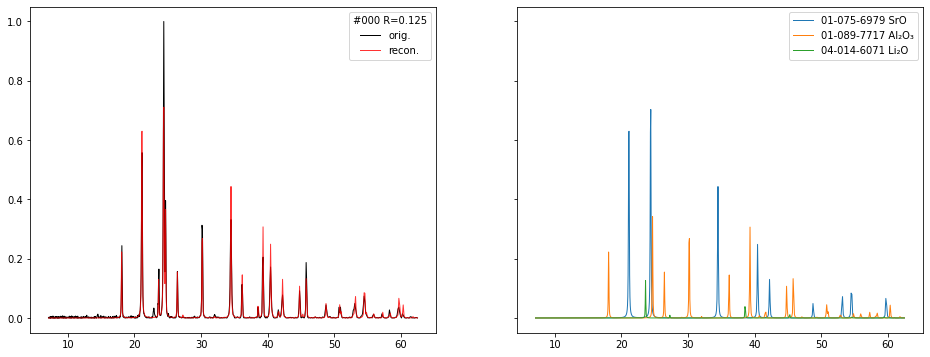

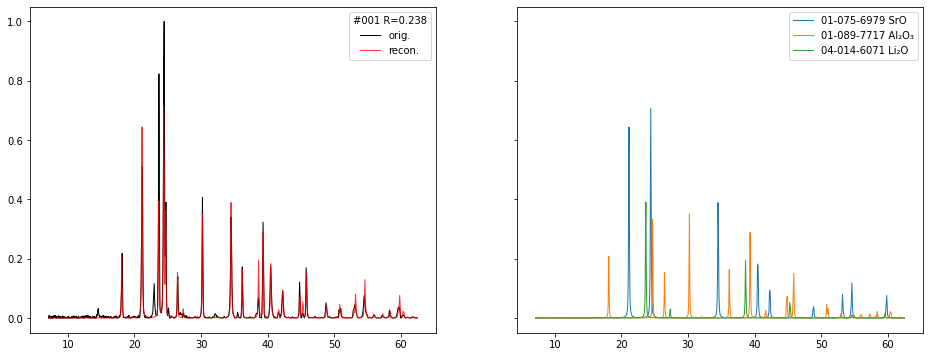

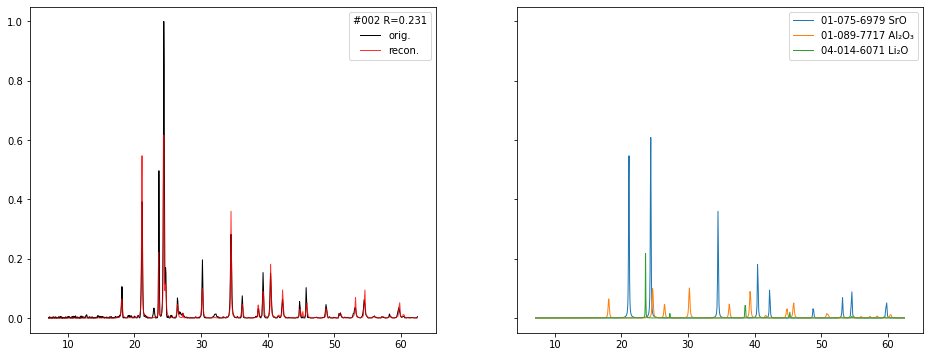

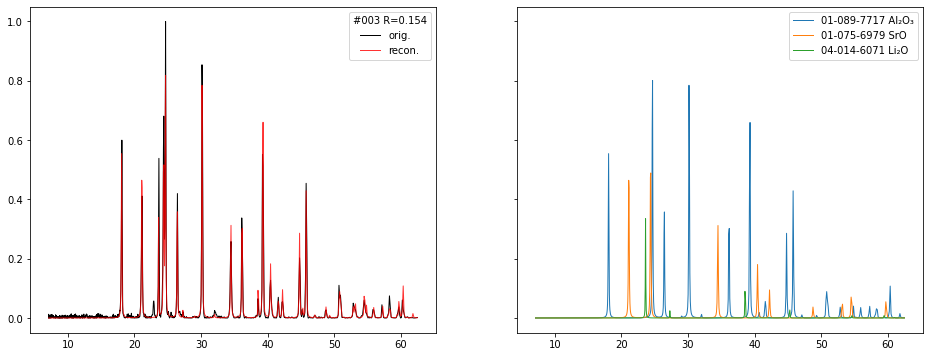

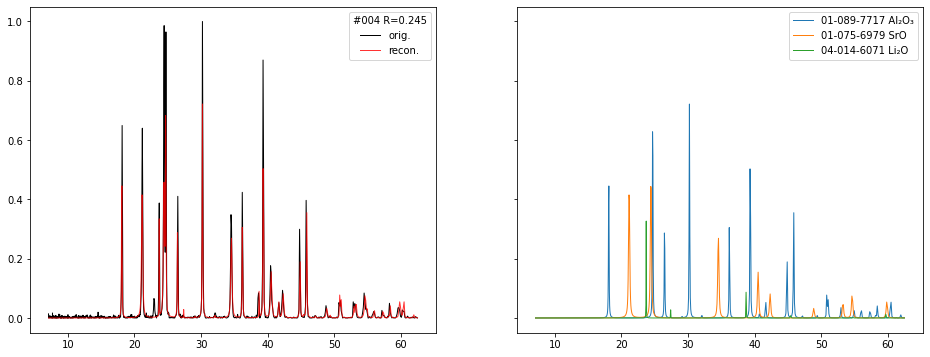

...

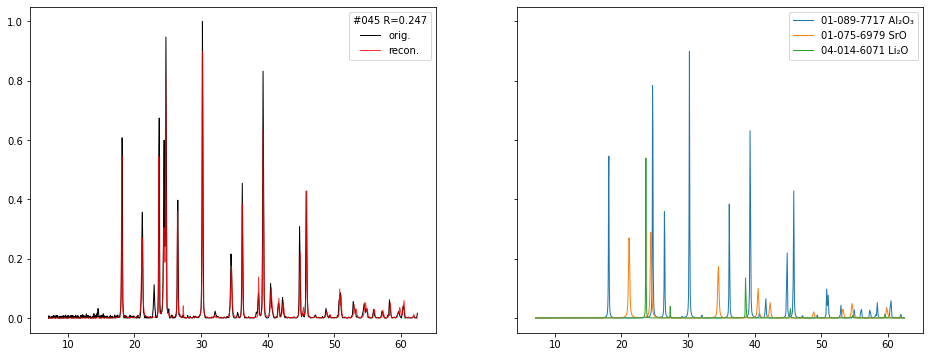

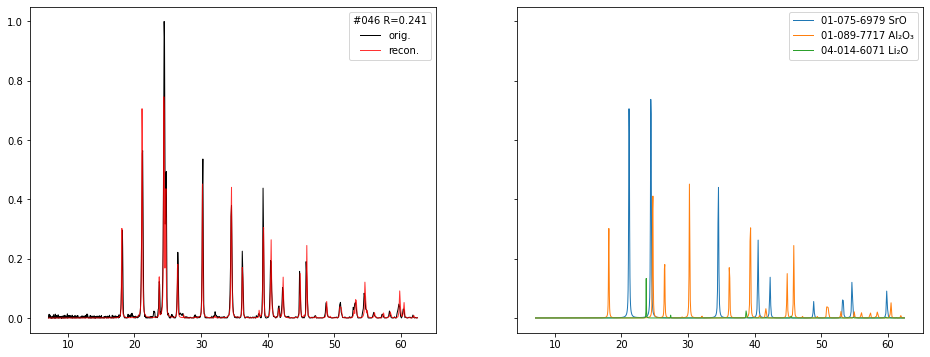

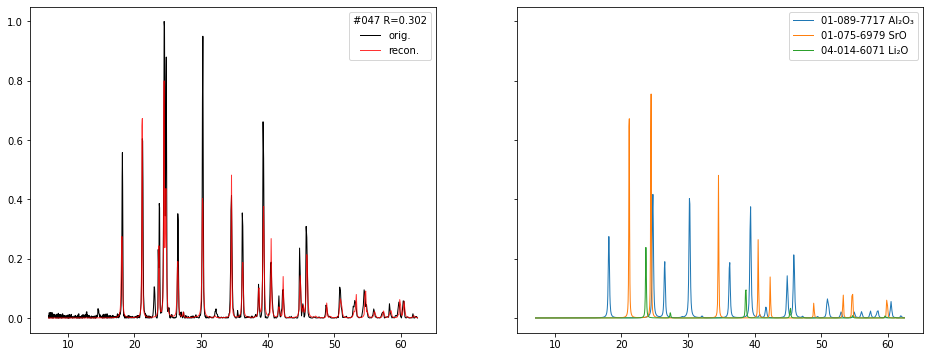

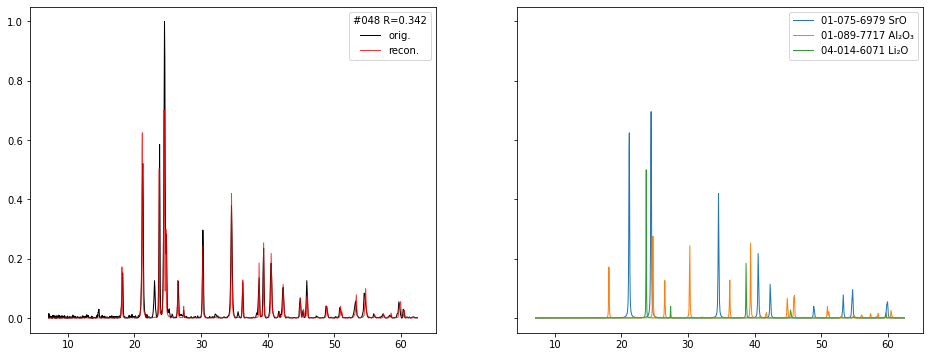

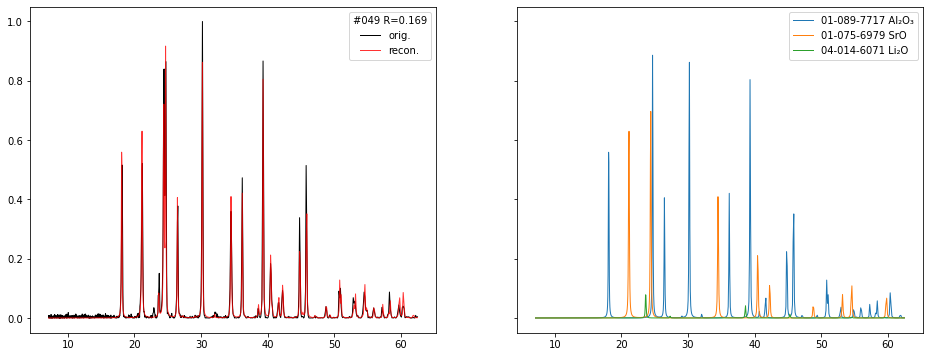

In [9]:
comp_dist = distance_matrix(instance_data.sample_comp, instance_data.sample_comp)
nn_list = {i: np.where((comp_dist[i] < 1) & (comp_dist[i] > 0))[0] for i in range(instance_data.sample_num)}
new_samples=deepcopy(samples)
samples_neighbor = []
for sample in new_samples:    
    if len(sample.phase_fractions)==0:
        sample.solution = new_samples[sample.sample_id-1].solution
    if len(sample.phase_fractions)>0:
        candidate_entries = []
        for i in nn_list[sample.sample_id]:
            candidate_entries += new_samples[i].entries
        candidate_entries = list(set(candidate_entries))
        solution = []
        for e in candidate_entries:
            phase = Phase.from_entry_and_instance_data(e, 1 / len(candidate_entries), instance_data)
            solution.append(phase)
    new_sample = deepcopy(sample)
    new_sample.solution = solution       
    new_sample.refine_all_fractions()
#     new_sample.refine_one_by_one()
    new_sample.print_solution()
    new_sample = new_sample.optimize(num_epoch=500, print_prog=False,loss_weight=loss_weight)   
    new_sample.update_solution(0.001, 0.2999, new_sample.max_q_shift)
    new_sample.refine_one_by_one()
    new_sample.refine_all_fractions()    
    new_sample.print_solution()
    new_sample.plot(perphase=True)
    samples_neighbor.append(new_sample)

In [11]:
for sample in samples_neighbor:    
    solution_file = f'solution/without_TextureAnalysis/samples{sample.sample_id}.json'
    with open(solution_file, 'w') as f:
        json.dump(samples_neighbor[sample.sample_id], f, cls=MontyEncoder)

In [23]:
samples = []
for i in range(instance_data.sample_num):
    solution_file = f'solution/without_TextureAnalysis/samples{i}.json'
    with open(solution_file) as f:
        sample = json.load(f, cls=MontyDecoder)
    if sample.sample_id !=i:
        print (i)    
    samples.append(sample)

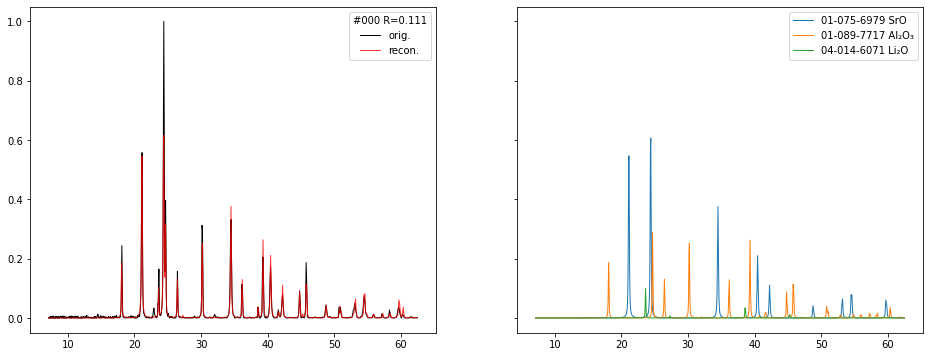

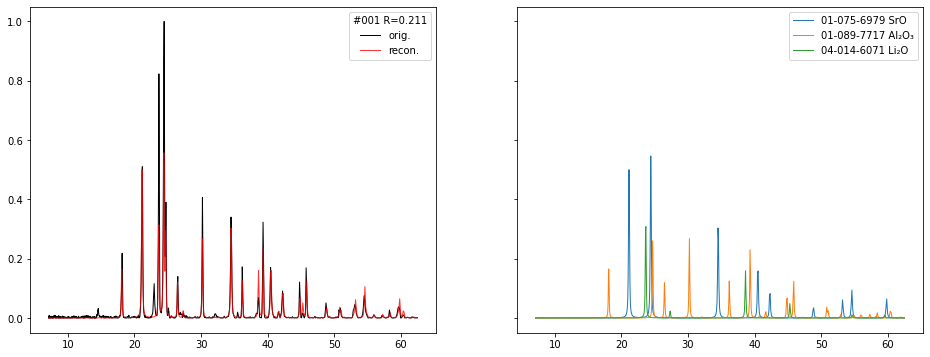

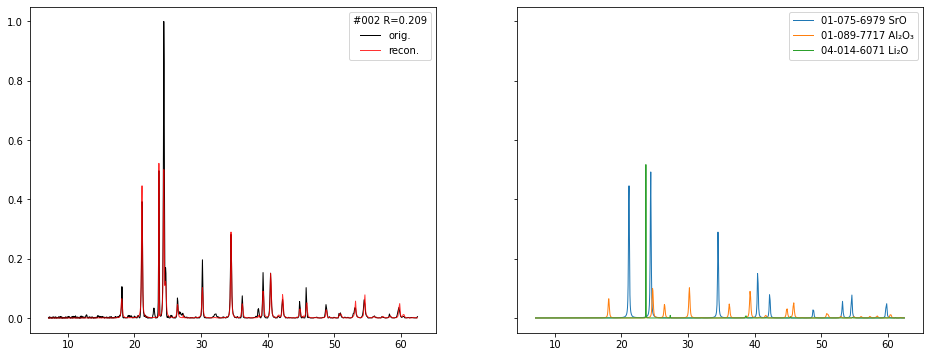

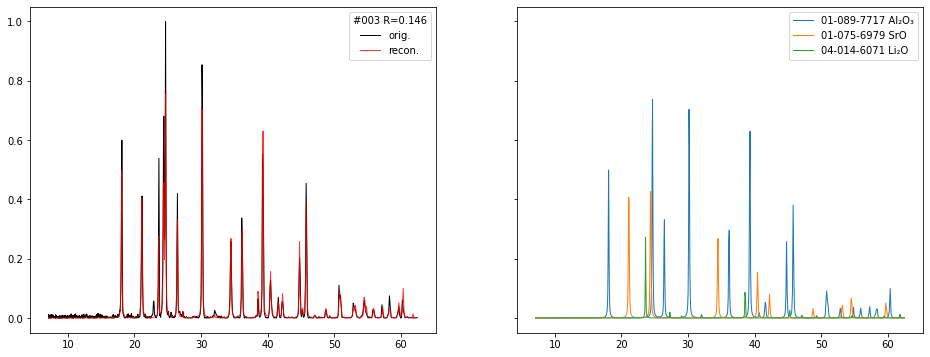

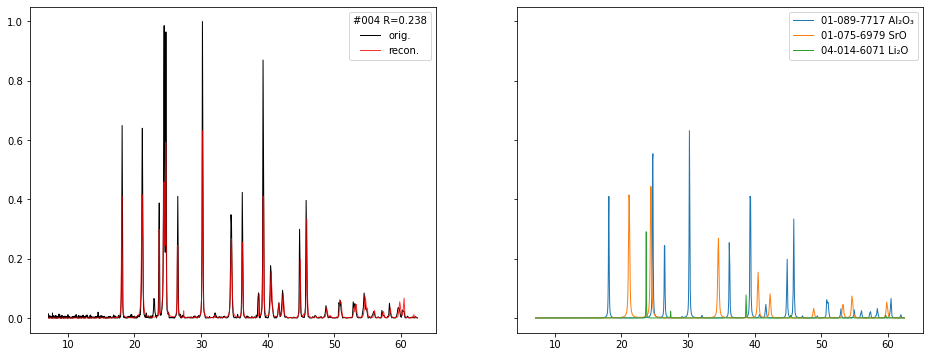

...

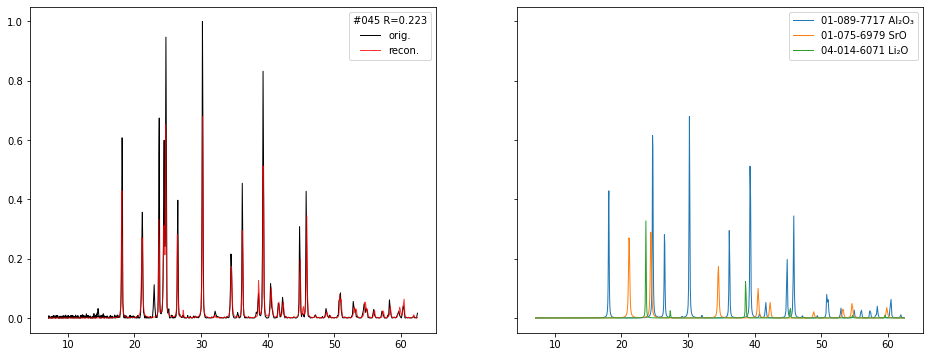

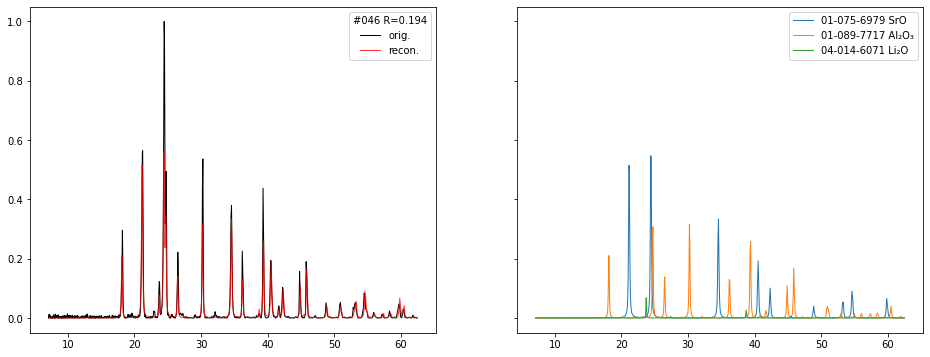

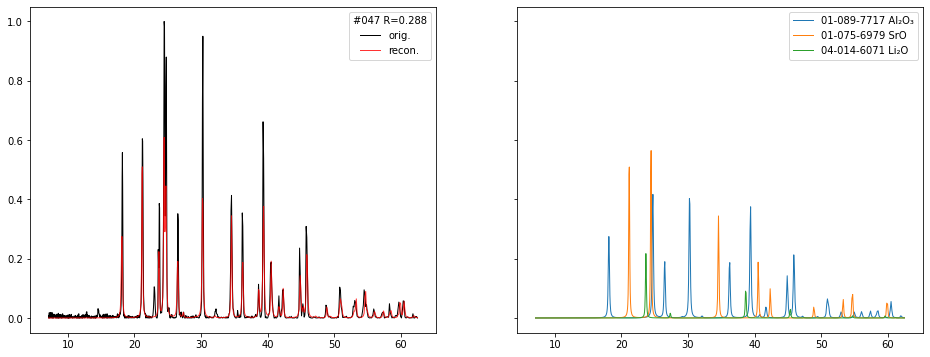

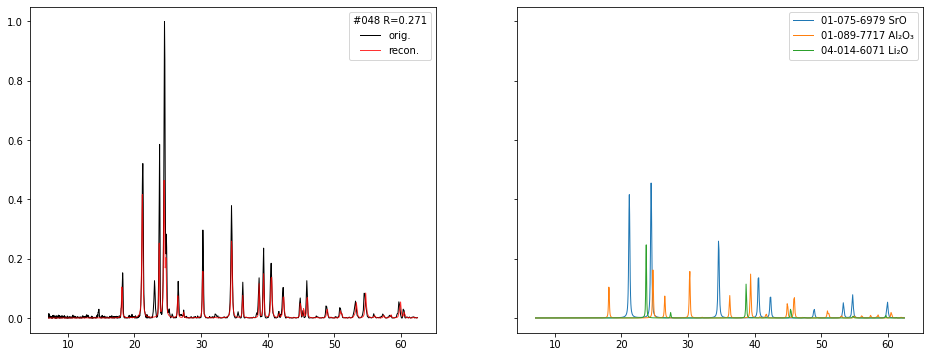

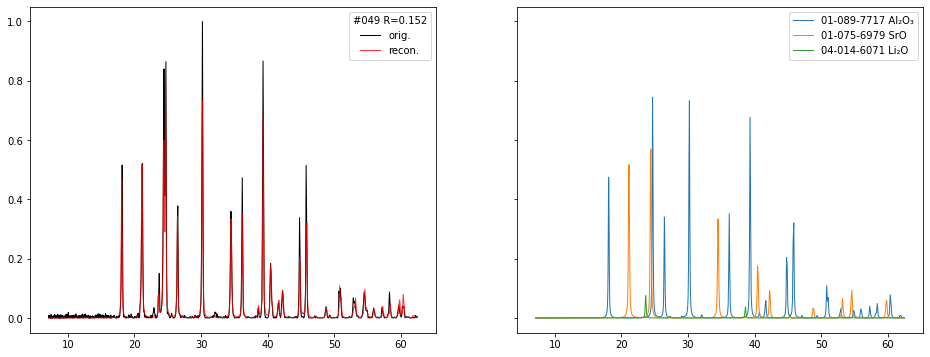

In [22]:
for sample in samples:    
    solution_file = f'solution/samples{sample.sample_id}.json'
    sample.refine_one_by_one()
    sample.plot(perphase=True)
    with open(solution_file, 'w') as f:
        json.dump(sample, f, cls=MontyEncoder)

In [3]:
samples = []
for i in range(instance_data.sample_num):
    solution_file = f'solution/with_TextureAnalysis/samples{i}.json'
    with open(solution_file) as f:
        sample = json.load(f, cls=MontyDecoder)
    if sample.sample_id !=i:
        print (i)    
    samples.append(sample)

In [4]:
Sample.solution_statistics(samples)

      entry_id       tot       max       min  height_tot  height_max  height_min  count  names
0  01-089-7717  0.538779  0.861273  0.161847    0.379328    0.641614    0.067108     50  Al2O3
1  01-075-6979  0.405544  0.761158  0.082892    0.408551    0.648340    0.098931     50    SrO
2  04-014-6071  0.055677  0.152784  0.012796    0.212122    0.462607    0.046342     50   Li2O
